In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('FAOSTAT_data_en_2-1-2025.csv')  

In [3]:
uniques = {x: df[x].nunique() for x in df.columns}
uniques

{'Domain Code': 1,
 'Domain': 1,
 'Area Code (M49)': 51,
 'Area': 51,
 'Element Code': 2,
 'Element': 2,
 'Item Code': 10,
 'Item': 10,
 'Year Code': 11,
 'Year': 11,
 'Unit': 1,
 'Value': 2230,
 'Flag': 1,
 'Flag Description': 1}

In [4]:
df.drop(columns = ['Domain Code', 'Domain', 'Unit', 'Flag', 'Flag Description'], inplace=True)

In [5]:
df.drop('Year Code', axis=1, inplace=True)

In [6]:
df.drop(columns = ['Area Code (M49)', 'Element Code', 'Item Code'], inplace=True)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3658 entries, 0 to 3657
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   Area     3658 non-null   object
 1   Element  3658 non-null   object
 2   Item     3658 non-null   object
 3   Year     3658 non-null   int64 
 4   Value    3658 non-null   int64 
dtypes: int64(2), object(3)
memory usage: 143.0+ KB


In [8]:
df.head()

,Area,Element,Item,Year,Value
0,Afghanistan,Energy consumption,Charcoal,2012,3510
1,Afghanistan,Energy consumption,Charcoal,2013,3611
2,Afghanistan,Energy consumption,Charcoal,2014,3715
3,Afghanistan,Energy consumption,Charcoal,2015,3822
4,Afghanistan,Energy consumption,Charcoal,2016,3936


In [9]:
df.shape

(3658, 5)

In [10]:
df[df['Area']=='Asia'].shape

(209, 5)

In [11]:
df = df[df['Area']!='Asia']

In [12]:
df['Item'].value_counts()

Item
Fuelwood                               1031
Charcoal                                855
Other vegetal material and residues     455
Bagasse                                 284
Biogases                                240
Biodiesel                               205
Animal waste                            154
Biogasoline                             148
Black liquor                             55
Other liquid biofuels                    22
Name: count, dtype: int64

In [13]:
df[(df['Item']=='Charcoal') & (df['Element']=='Energy production')]
df[(df['Item']=='Charcoal') & (df['Element']=='Energy consumption')]

,Area,Element,Item,Year,Value
0,Afghanistan,Energy consumption,Charcoal,2012,3510
1,Afghanistan,Energy consumption,Charcoal,2013,3611
2,Afghanistan,Energy consumption,Charcoal,2014,3715
3,Afghanistan,Energy consumption,Charcoal,2015,3822
4,Afghanistan,Energy consumption,Charcoal,2016,3936
...,...,...,...,...,...
3422,Yemen,Energy consumption,Charcoal,2018,2033
3423,Yemen,Energy consumption,Charcoal,2019,2080
3424,Yemen,Energy consumption,Charcoal,2020,2127
3425,Yemen,Energy consumption,Charcoal,2021,2198


In [14]:
df['Value'].describe()

count    3.449000e+03
mean     1.096213e+05
std      4.761873e+05
min      0.000000e+00
25%      2.660000e+02
50%      4.118000e+03
75%      4.583300e+04
max      6.323166e+06
Name: Value, dtype: float64

* Mean is quite larger than median which indicates that data is skewed towards right
* Max value is quite large which indicates presence of outliars

In [15]:
df['Value'].skew()

9.325117471750485

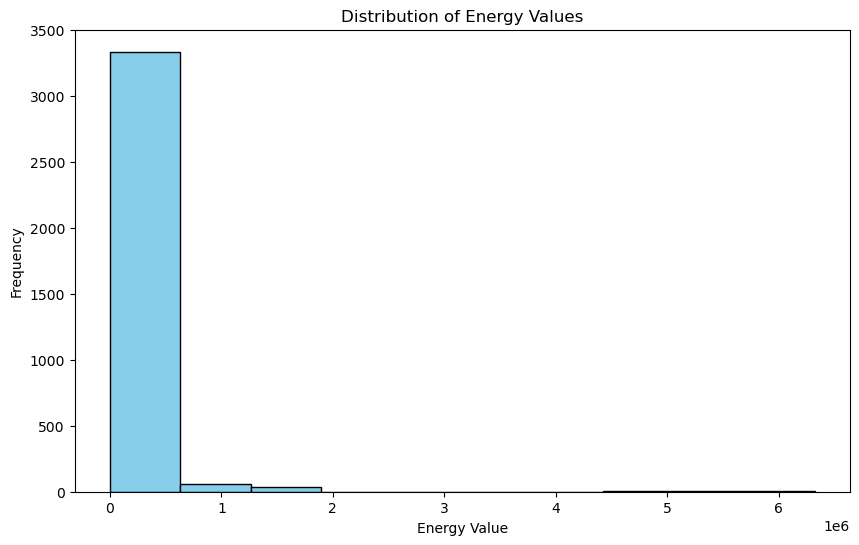

In [16]:
plt.figure(figsize=(10,6))
plt.hist(df['Value'], color='skyblue', edgecolor='black')
plt.title('Distribution of Energy Values')
plt.xlabel('Energy Value')
plt.ylabel('Frequency')
plt.show()

In [17]:
df['Log Value'] = np.log1p(df['Value'])
df['Log Value'].skew()

-0.2264792037169868

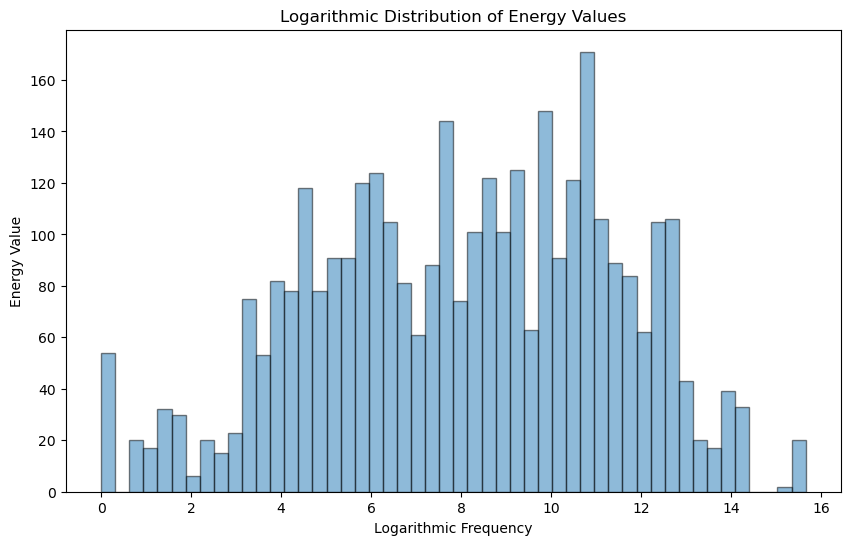

In [18]:
plt.figure(figsize=(10,6))
plt.hist(df['Log Value'], bins=50, alpha=0.5, edgecolor='black')
plt.xlabel('Logarithmic Frequency')
plt.ylabel('Energy Value')
plt.title('Logarithmic Distribution of Energy Values')
plt.show()

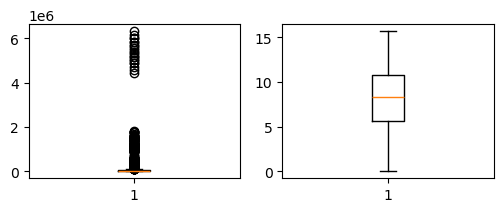

In [19]:
plt.figure(figsize=(6,2))

plt.subplot(1,2,1)
plt.boxplot(x=df['Value'])

plt.subplot(1,2,2)
plt.boxplot(x=df['Log Value'])

plt.show()

In [20]:
df['Log Value'].describe()

count    3449.000000
mean        8.044768
std         3.327796
min         0.000000
25%         5.587249
50%         8.323366
75%        10.732781
max        15.659731
Name: Log Value, dtype: float64

In [21]:
df.head()

,Area,Element,Item,Year,Value,Log Value
0,Afghanistan,Energy consumption,Charcoal,2012,3510,8.163656
1,Afghanistan,Energy consumption,Charcoal,2013,3611,8.192017
2,Afghanistan,Energy consumption,Charcoal,2014,3715,8.220403
3,Afghanistan,Energy consumption,Charcoal,2015,3822,8.248791
4,Afghanistan,Energy consumption,Charcoal,2016,3936,8.278174


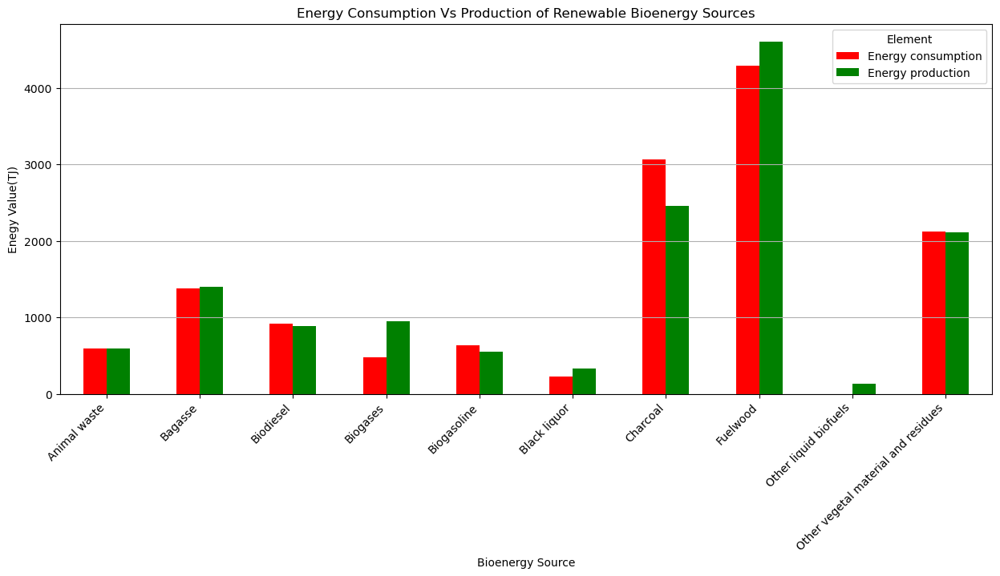

In [22]:
df_pivot_items = df.pivot_table(values='Log Value', index='Item', columns='Element', aggfunc='sum', fill_value=0)
df_pivot_items.plot(kind='bar', color=['r', 'g'], figsize=(15,6))
plt.xlabel('Bioenergy Source')
plt.ylabel('Enegy Value(TJ)')
plt.title('Energy Consumption Vs Production of Renewable Bioenergy Sources')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y')
plt.savefig('static/Consumption vs Production of Items/Energy Consumption Vs Production of Renewable Bioenergy Sources.png', bbox_inches='tight')
plt.show()

### Conclusions:
* Which renewable sources (Items) have the highest production & consumption?
    * Fuelwood has the highest Energy Consumption and the highest Energy Production(Production is more than Consumption)
    * Charcoal has the second highest Energy Consumption and Energy Production(Consumption is more than Production)
    * Other Vegetal material and residues have third highest Energy Consumption and Energy Production(Consumption is more than Production)
* Items where Energy Production is more than Energy Consumption:
    * Biogases has higher production than consumption
    * Bagasse and Fuelwood also has explainably higher production than consumption
* Items where Energy Consumption is more than Energy Production:
    * Charcoal has higher consumption than production
    * Biogasoline has higher consumption than production
    * Biodiesel has higher consumption than production
    * Other Vegetal material and residues have higher consumption than production

In [23]:
df_pivot_area = df.pivot_table(values='Log Value', index='Area', columns='Element', aggfunc='sum', fill_value=0)
df_filtered_c = df_pivot_area[df_pivot_area['Energy consumption'] >= df_pivot_area['Energy production']].reset_index()
df_filtered_p = df_pivot_area[df_pivot_area['Energy production'] >= df_pivot_area['Energy consumption']].reset_index()

In [24]:
df_filtered_c

Element,Area,Energy consumption,Energy production
0,Armenia,255.183320,168.403305
1,Bahrain,90.510178,85.226517
2,Bangladesh,582.723493,582.614240
3,Bhutan,206.270649,178.265797
4,Brunei Darussalam,83.719699,77.329321
5,"China, Hong Kong SAR",52.411651,0.000000
6,"China, Macao SAR",48.759982,0.000000
7,Cyprus,325.437394,268.124547
8,Israel,178.945131,130.064769
9,Kuwait,109.707534,107.136636


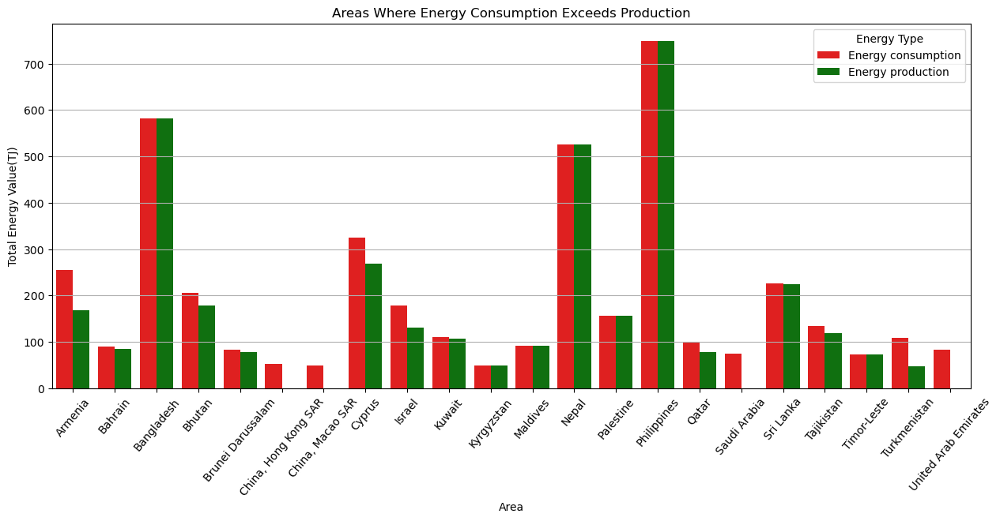

In [25]:
plt.figure(figsize=(15,6))

custom_palette = {'Energy consumption':'r', 'Energy production':'g'}

sns.barplot(df_filtered_c.melt(id_vars='Area', var_name='Element', value_name='Energy Value'), x='Area', y='Energy Value', hue='Element', palette=custom_palette)

plt.xticks(rotation=50)
plt.xlabel('Area')
plt.ylabel('Total Energy Value(TJ)')
plt.title('Areas Where Energy Consumption Exceeds Production')
plt.legend(title='Energy Type')
plt.grid(axis='y')
plt.savefig('static/Consumption vs Production of Items/Areas Where Energy Consumption Exceeds Production.png', bbox_inches='tight')
plt.show()

Conclusion:
* Countries where overconsumption exists:
    * Armenia
    * China, Hong Kong SAR
    * China, Macao SAR
    * Cyprus
    * Israel
    * Saudi Arabia
    * Turkmenistan
    * United Arab Emirates

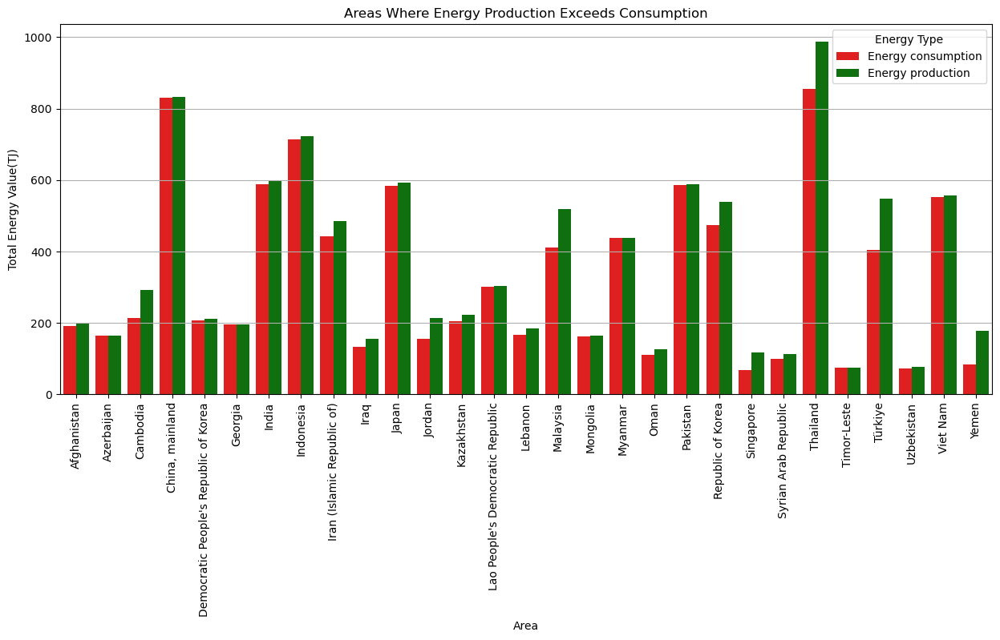

In [26]:
plt.figure(figsize=(15,6))

sns.barplot(df_filtered_p.melt(id_vars='Area', var_name='Element', value_name='Energy Value'), x='Area', y='Energy Value', hue='Element', palette=custom_palette)

plt.xticks(rotation=90)
plt.xlabel('Area')
plt.ylabel('Total Energy Value(TJ)')
plt.title('Areas Where Energy Production Exceeds Consumption')
plt.legend(title='Energy Type')
plt.grid(axis='y')
plt.savefig('static/Consumption vs Production of Items/Areas Where Energy Production Exceeds Consumption.png', bbox_inches='tight')
plt.show()

Conclusion
* Energy Surplus Regions
    * Cambodia
    * Iran(Islamic Republic)
    * Jordan
    * Malaysia
    * Republic of Korea
    * Singapore
    * Thailand
    * Turkiye
    * Yemen

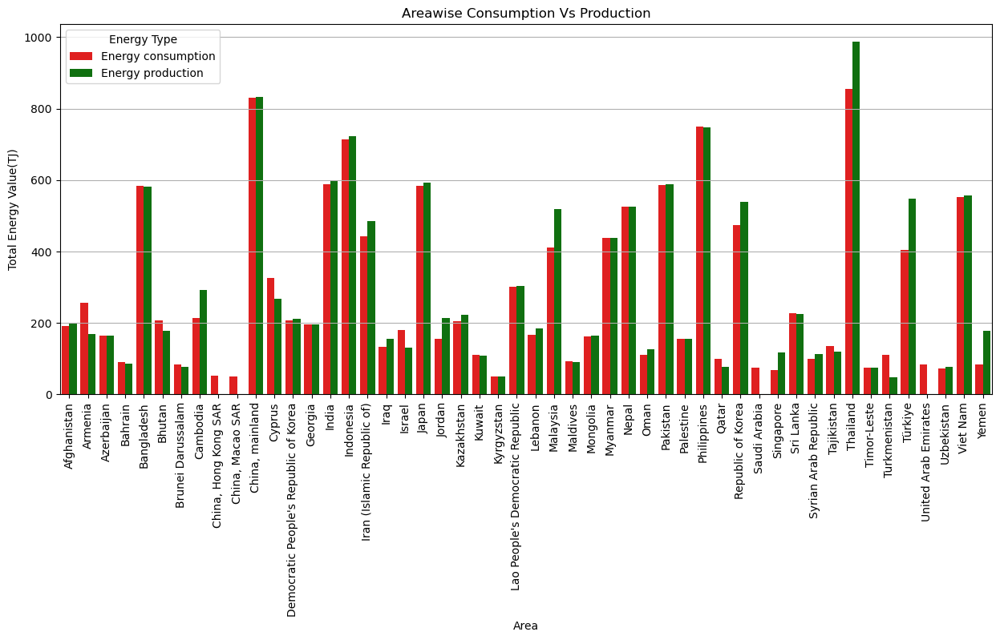

In [27]:
plt.figure(figsize=(15,6))

sns.barplot(df_pivot_area.reset_index().melt(id_vars='Area', var_name='Element', value_name='Energy Value'), x='Area', y='Energy Value', hue='Element', palette=custom_palette)

plt.xticks(rotation=90)
plt.xlabel('Area')
plt.ylabel('Total Energy Value(TJ)')
plt.title('Areawise Consumption Vs Production')
plt.legend(title='Energy Type')
plt.grid(axis='y')
plt.savefig('static/Consumption vs Production of Items/Areawise Consumption Vs Production.png', bbox_inches='tight')
plt.show()

Conclusion
* Countries with the most consumption and production
    1. India
    2. China, mainland
    3. Indonesia
    4. Thailand
    5. Pakistan
    6. Japan
    7. Turkiye
    8. Vietnam

In [28]:
df.head()

,Area,Element,Item,Year,Value,Log Value
0,Afghanistan,Energy consumption,Charcoal,2012,3510,8.163656
1,Afghanistan,Energy consumption,Charcoal,2013,3611,8.192017
2,Afghanistan,Energy consumption,Charcoal,2014,3715,8.220403
3,Afghanistan,Energy consumption,Charcoal,2015,3822,8.248791
4,Afghanistan,Energy consumption,Charcoal,2016,3936,8.278174


In [29]:
df.loc[df['Area']=='Viet Nam', 'Area'] = 'Vietnam'

In [30]:
df.loc[df['Area']=='Iran (Islamic Republic of)', 'Area'] = 'Iran'

In [31]:
df.loc[df['Area']=="Democratic People's Republic of Korea", 'Area'] = 'Korea' 

In [32]:
df.loc[df['Area']=='Türkiye', 'Area'] = 'Turkiye'

In [33]:
df.loc[df['Area']=='Republic of Korea', 'Area'] = 'Korea'

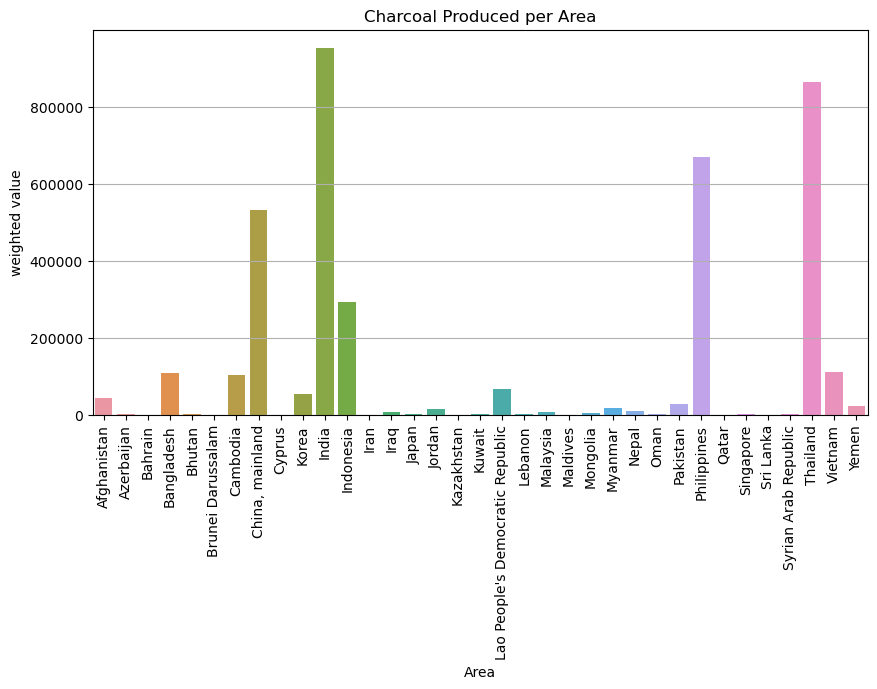

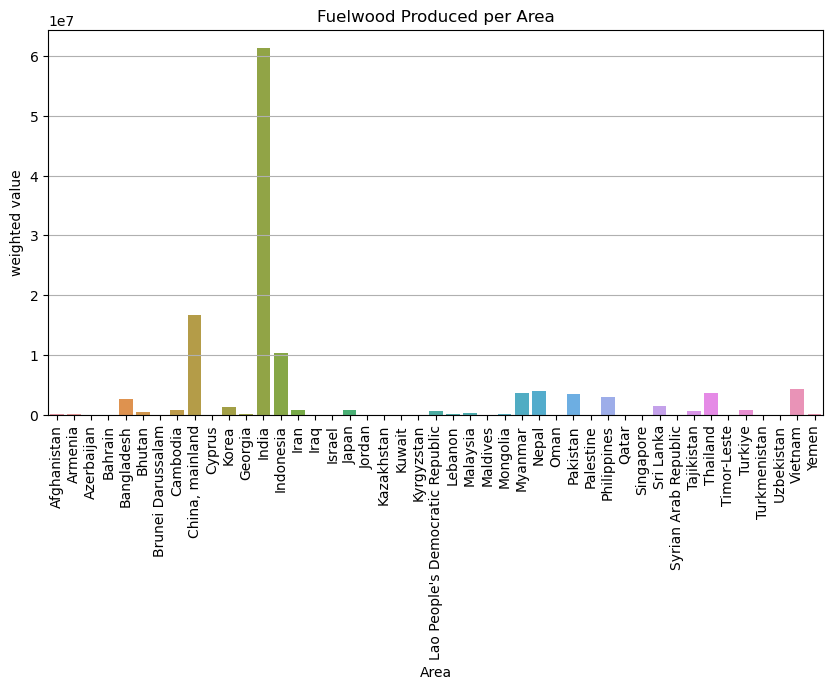

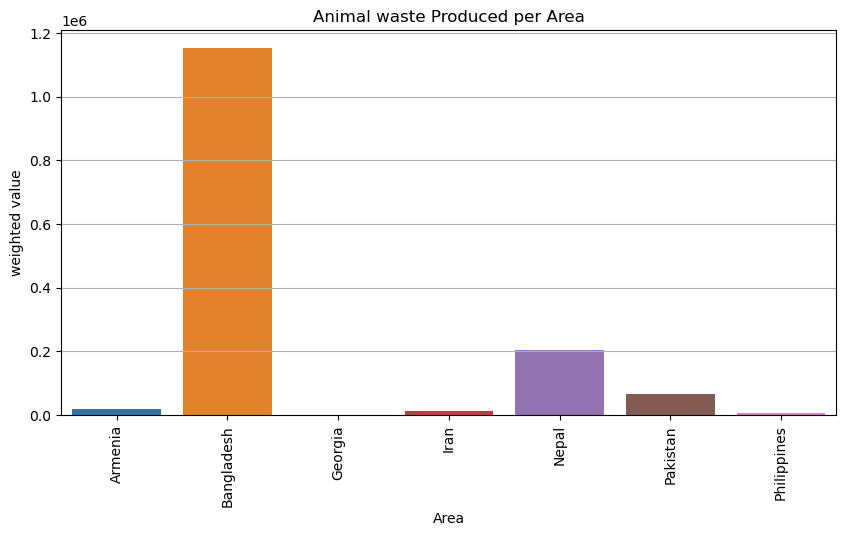

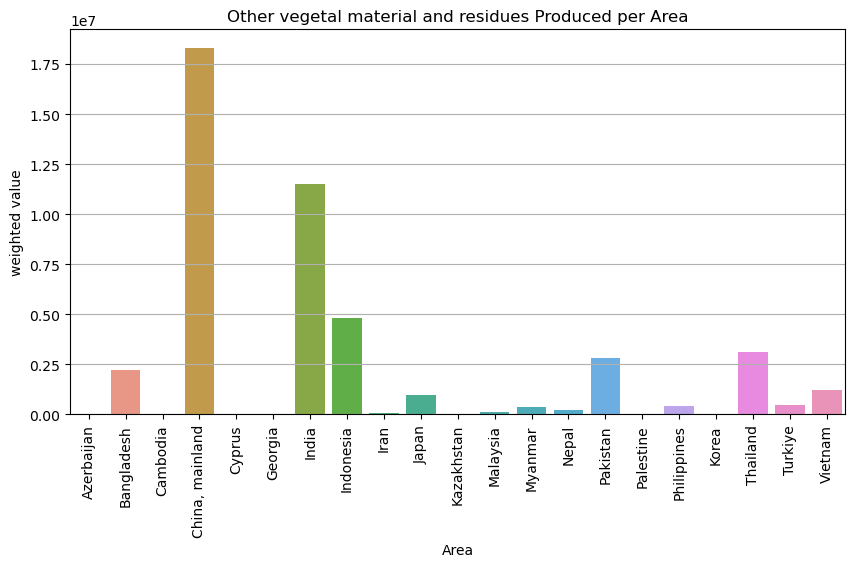

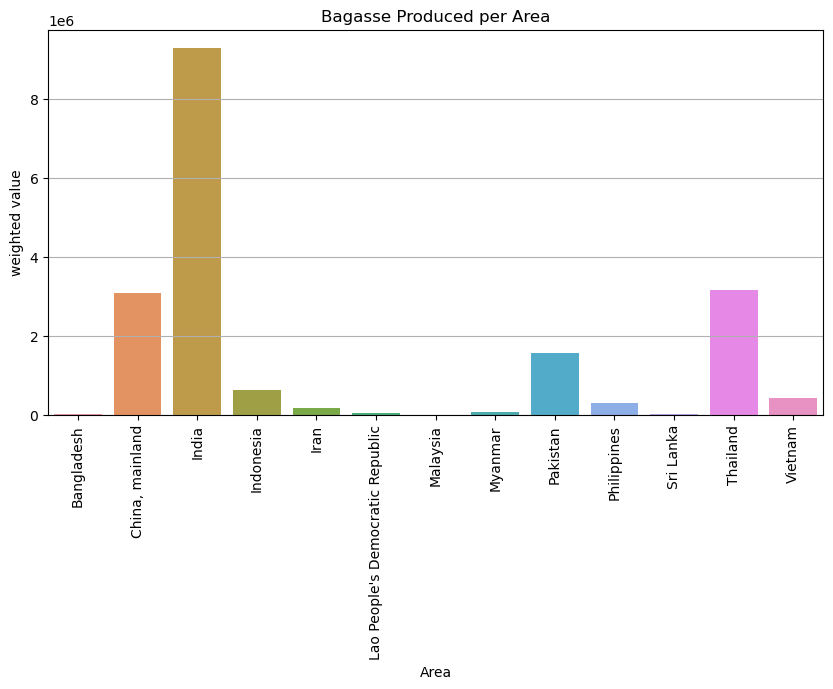

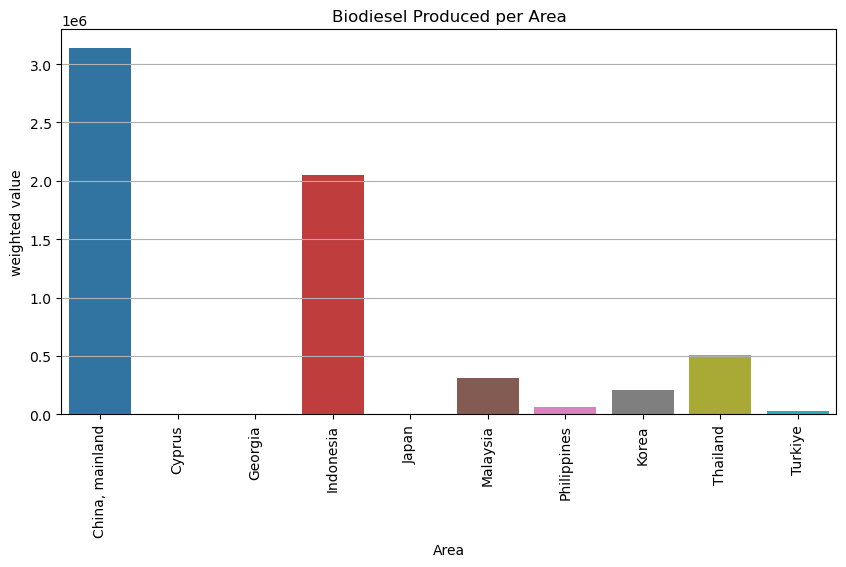

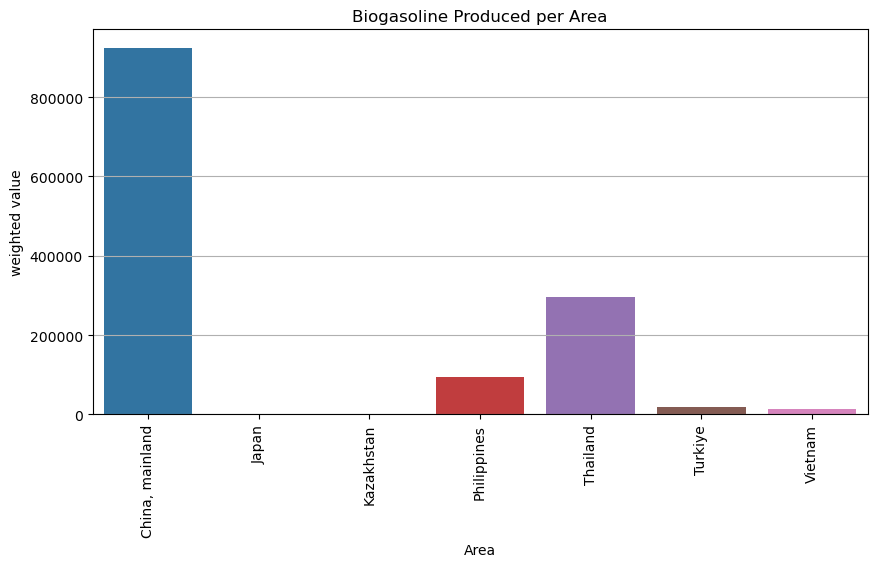

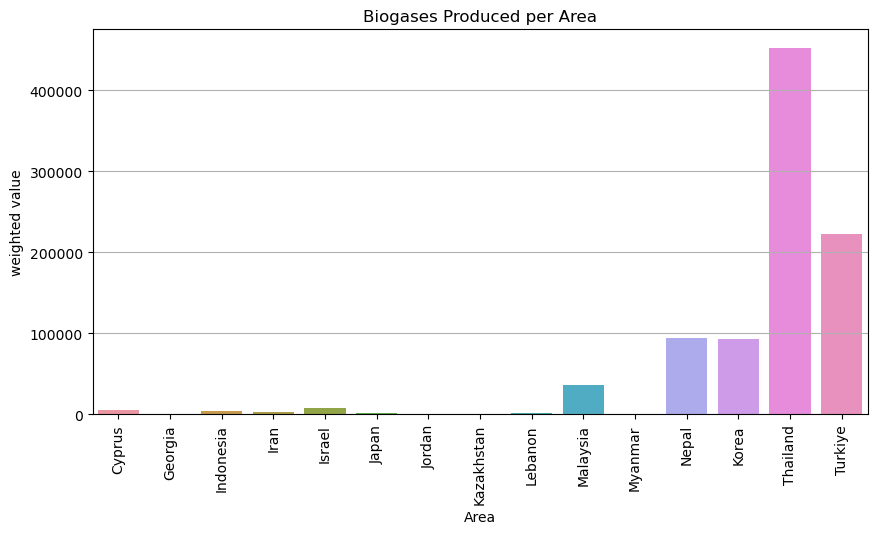

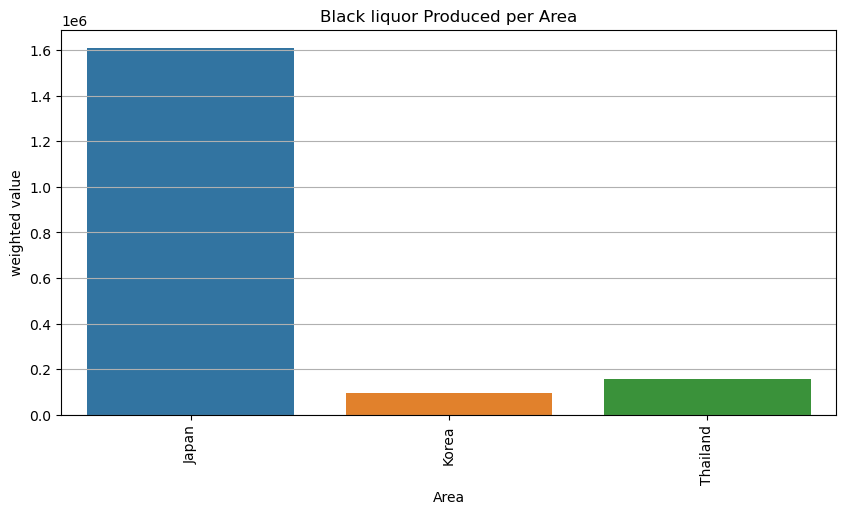

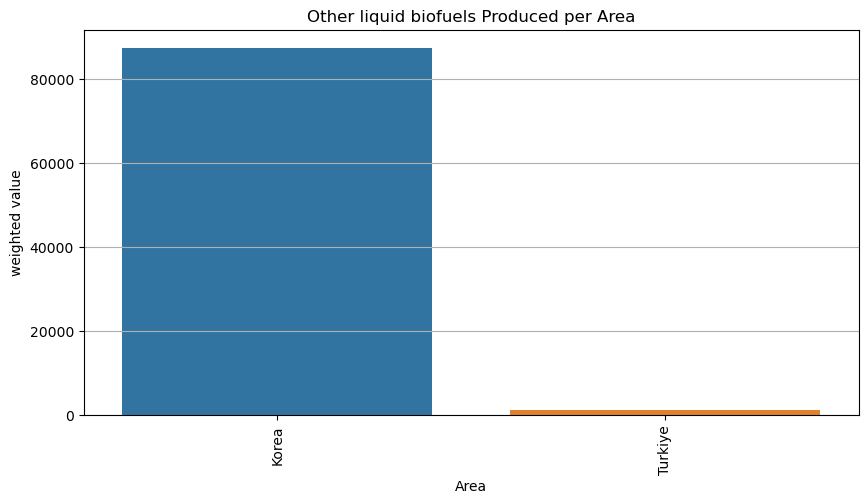

In [34]:
for i in df['Item'].unique():
    df_item = df[(df['Item'] == i) & (df['Element'] == 'Energy production')]  # Filter for each item

    if not df_item.empty:  # Only plot if data exists for that item
        df_item = df_item.copy()  # Ensure it's a copy
        df_item.loc[:, 'weighted value'] = df_item.groupby('Area')['Value'].transform('sum')
        plt.figure(figsize=(10, 5))
        sns.barplot(data=df_item, x='Area', y='weighted value')
        plt.title(f"{i} Produced per Area")  # Corrected title formatting
        plt.xticks(rotation=90)
        plt.grid(axis='y')
        plt.savefig(f'static/Item Produced Per Area/{i} Produced Per Area.png', bbox_inches='tight')
        plt.show()

Conclusion for Item Production per Area:(Top Producers)
* Charcoal
    1. India
    2. Thailand
    3. Phillipines
    4. China, mainland
    5. Indonesia
    6. Vietnam
    7. Cambodia
* Fuelwood
    1. India
    2. China, mainland
    3. Indonesia
    4. Vietnam
    5. Nepal
    6. Myanmar
    7. Pakistan
* Animal Waste
    1. Bangladesh
    2. Nepal
    3. Pakistan
    4. Iran
    5. Phillipines
* Other Vegetal Material and Residues
    1. China, mainland
    2. India
    3. Indonesia
    4. Thailand
    5. Pakistan
    6. Bangladesh
    7. Vietnam
    8. Japan
* Bagasse
    1. India
    2. China, mainland
    3. Thailand
    4. Pakistan
    5. Indonesia
    6. Vietnam
* Biodiesel
    1. China, mainland
    2. Indonesia
    3. Thailand
    4. Malaysia
* Biogasoline
    1. China, mainland
    2. Thailand
    3. Phillipines
    4. Turkiye
    5. Vietnam
* Biogases
    1. Thailand
    2. Turkiye
    3. Nepal
    4. Republic of Korea
    5. Malaysia
* Black Liquor
    1. Japan
    2. Thailand
    3. Republic of Korea
* Other Liquid Biofuels
    1. Republic of Korea
    2. Turkiye

In [35]:
df.head()

,Area,Element,Item,Year,Value,Log Value
0,Afghanistan,Energy consumption,Charcoal,2012,3510,8.163656
1,Afghanistan,Energy consumption,Charcoal,2013,3611,8.192017
2,Afghanistan,Energy consumption,Charcoal,2014,3715,8.220403
3,Afghanistan,Energy consumption,Charcoal,2015,3822,8.248791
4,Afghanistan,Energy consumption,Charcoal,2016,3936,8.278174


In [36]:
df_consumption = df[df['Element']=='Energy consumption']
df_production = df[df['Element']=='Energy production']

In [37]:
df_production['Area'].unique()

array(['Afghanistan', 'Armenia', 'Azerbaijan', 'Bahrain', 'Bangladesh',
       'Bhutan', 'Brunei Darussalam', 'Cambodia', 'China, mainland',
       'Cyprus', 'Korea', 'Georgia', 'India', 'Indonesia', 'Iran', 'Iraq',
       'Israel', 'Japan', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan',
       "Lao People's Democratic Republic", 'Lebanon', 'Malaysia',
       'Maldives', 'Mongolia', 'Myanmar', 'Nepal', 'Oman', 'Pakistan',
       'Palestine', 'Philippines', 'Qatar', 'Singapore', 'Sri Lanka',
       'Syrian Arab Republic', 'Tajikistan', 'Thailand', 'Timor-Leste',
       'Turkiye', 'Turkmenistan', 'Uzbekistan', 'Vietnam', 'Yemen'],
      dtype=object)

## <B>Yearly Charcoal Production in India</B>

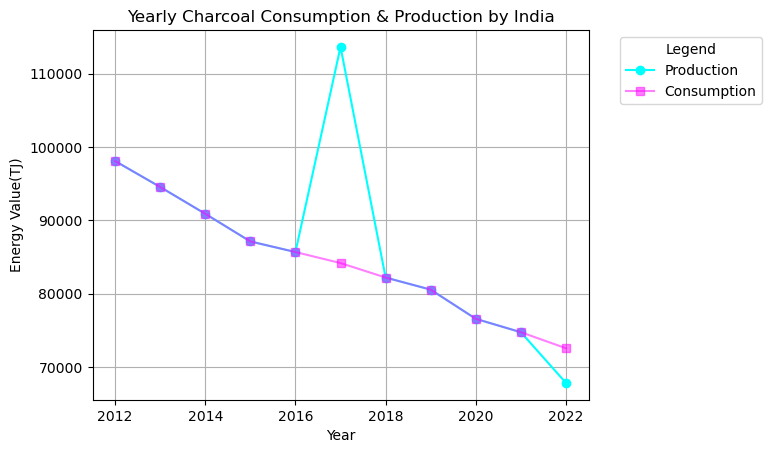

In [38]:
df_charcoal_india = df_production[(df_production['Area'] == 'India') & (df_production['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_charcoal_india_c = df_consumption[(df_consumption['Area'] == 'India') & (df_consumption['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

# df_charcoal_india = df_production[df_production['Area'].isin(['India'])].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')
# df_charcoal_india_c = df_consumption[df_consumption['Area'].isin(['India'])].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

plt.plot(df_charcoal_india.index, df_charcoal_india.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_charcoal_india_c.index, df_charcoal_india_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Charcoal Consumption & Production by India')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

<B>Rolling Statistics Test (Visual Inspection of Stationarity)

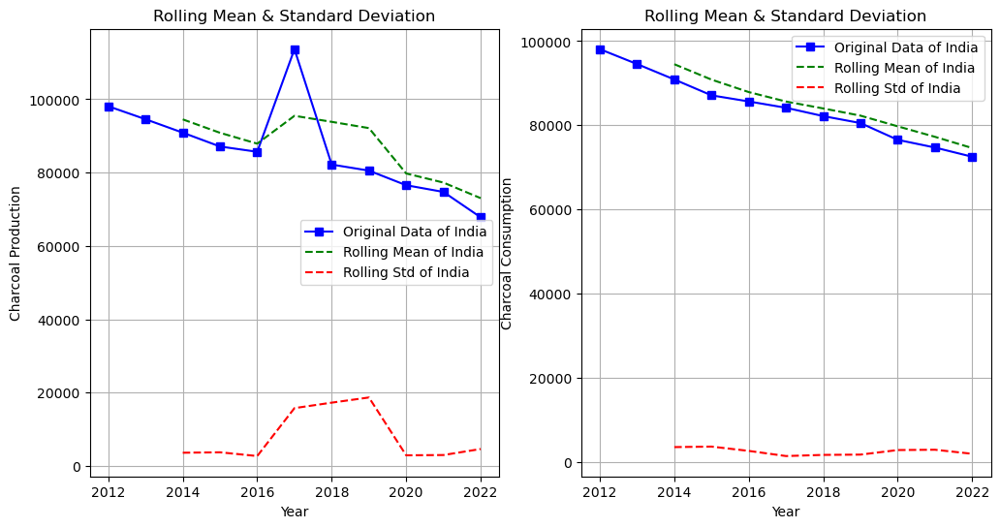

In [39]:
rolling_mean = df_charcoal_india.rolling(window=3).mean()
rolling_std = df_charcoal_india.rolling(window=3).std()
rolling_mean_c = df_charcoal_india_c.rolling(window=3).mean()
rolling_std_c = df_charcoal_india_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_charcoal_india, label='Original Data of India', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of India', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of India', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Charcoal Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_charcoal_india_c, label='Original Data of India', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of India', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of India', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Charcoal Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

Rolling mean is showing a trend and is not constant. Hence, the data is <B>NON STATIONARY</B>, although rolling std is almost constant.

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [40]:
from statsmodels.tsa.stattools import adfuller

In [41]:
adf_statistic = adfuller(df_charcoal_india['Value'])[0]
p_value = adfuller(df_charcoal_india['Value'])[1]
critical_points = adfuller(df_charcoal_india['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.7558177000521433
p-value: 0.40260691695128625
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Production to convert non stationary data to stationary</B>

In [42]:
df_charcoal_india['Differenced Production'] = df_charcoal_india['Value'].diff()
adf_statistic = adfuller(df_charcoal_india['Differenced Production'].dropna())[0]
p_value = adfuller(df_charcoal_india['Differenced Production'].dropna())[1]
critical_points = adfuller(df_charcoal_india['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.525250845322483
p-value: 0.0001769819354112496
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

In [43]:
df_charcoal_india['Differenced Production'].dropna()

Year
2013    -3540.0
2014    -3658.0
2015    -3776.0
2016    -1446.0
2017    27996.0
2018   -31477.0
2019    -1652.0
2020    -3983.0
2021    -1828.0
2022    -6919.0
Name: Differenced Production, dtype: float64

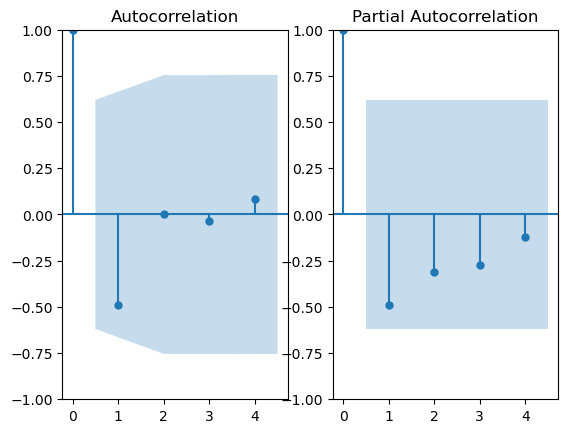

In [44]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
fig, ax = plt.subplots(1,2)
plot_acf(df_charcoal_india['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_charcoal_india['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

* differencing parameter d = 1
* AR---> p=[3] <via pacf plot>
* MA---> q=[1] <via acf plot>
* Possible parameters:
    1. (3,1,1)

In [45]:
from statsmodels.tsa.arima.model import ARIMA

In [46]:
arima_1 = ARIMA(df_charcoal_india['Value'], order=(3,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_india['Value'], order=(3,1,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_charcoal_india['Value'], order=(0,1,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 1)   Log Likelihood                -109.167
Date:                Tue, 25 Mar 2025   AIC                            228.334
Time:                        00:36:38   BIC                            229.847
Sample:                             0   HQIC                           226.675
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1017     14.894     -0.007      0.995     -29.293      29.090
ar.L2         -0.0529      2.033     -0.026      0.979      -4.038       3.932
ar.L3         -0.0436      1.290     -0.034      0.9

* Conclusion:<BR>
  The lowest AIC and BIC values are of parameter <b>(0,1,3)</b>

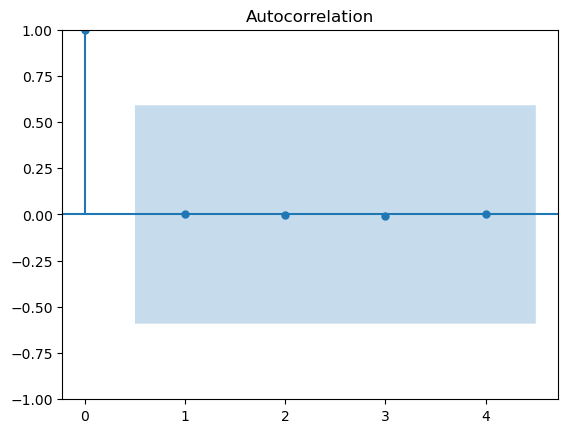

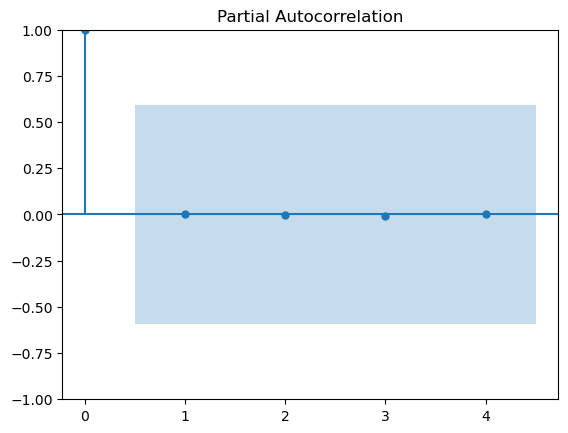

In [47]:
import statsmodels.api as sm

residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

In [48]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)
print(forecast_p)

11    68933.077861
12    69299.443692
13    69660.486099
14    69660.486099
15    69660.486099
16    69660.486099
17    69660.486099
18    69660.486099
19    69660.486099
20    69660.486099
Name: predicted_mean, dtype: float64


C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


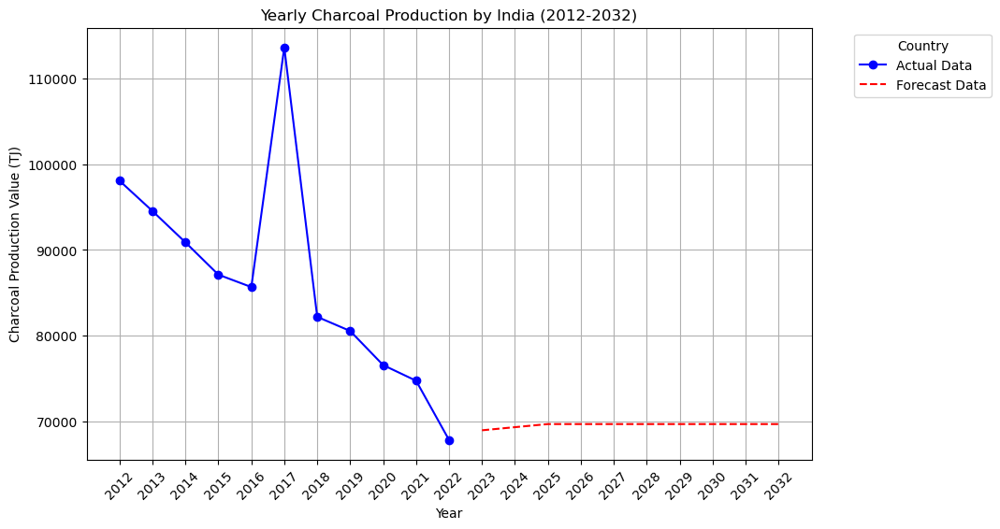

In [49]:
last_year = int(df_charcoal_india.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_india.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_india.index ,df_charcoal_india['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Charcoal Production Value (TJ)')
plt.title('Yearly Charcoal Production by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [50]:
adf_statistic = adfuller(df_charcoal_india_c['Value'])[0]
p_value = adfuller(df_charcoal_india_c['Value'])[1]
critical_points = adfuller(df_charcoal_india_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.5629881802767827
p-value: 0.502154250020355
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [51]:
df_charcoal_india_c['Differenced Consumption'] = df_charcoal_india_c['Value'].diff()

adf_statistic = adfuller(df_charcoal_india_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_charcoal_india_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_charcoal_india_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -8.248626715330893
p-value: 5.467119519907756e-13
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

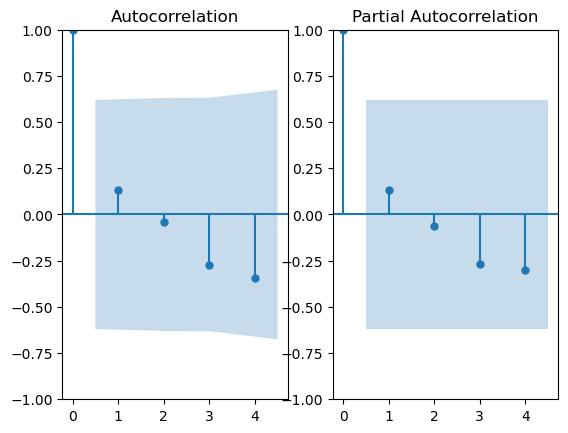

In [52]:
fig, ax = plt.subplots(1,2)
plot_acf(df_charcoal_india_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_charcoal_india_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [53]:
arima_1 = ARIMA(df_charcoal_india_c['Value'], order=(0,1,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_india_c['Value'], order=(1,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 1, 0)   Log Likelihood                 -93.351
Date:                Tue, 25 Mar 2025   AIC                            188.702
Time:                        00:36:41   BIC                            189.005
Sample:                             0   HQIC                           188.370
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2       7.45e+06   6.49e+06      1.148      0.251   -5.27e+06    2.02e+07
Ljung-Box (L1) (Q):                   0.24   Jarque-Bera (JB):                 1.38
Prob(Q):                              0.63   Pr

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

* Conclusion:<BR>
  The lowest AIC and BIC values are of parameter <b>(1,1,1)</b>

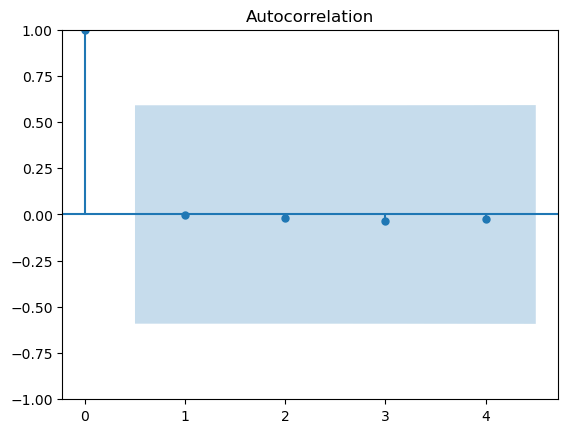

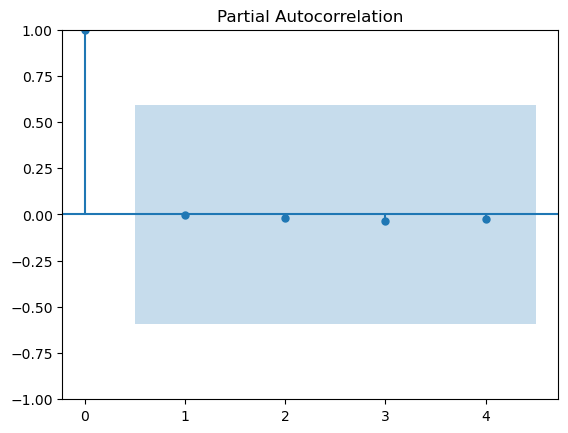

In [54]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

In [55]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)
print(forecast_c)

11    71814.471532
12    71182.862663
13    70632.256606
14    70152.264881
15    69733.831315
16    69369.061174
17    69051.072211
18    68773.864817
19    68532.208820
20    68321.544812
Name: predicted_mean, dtype: float64


C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


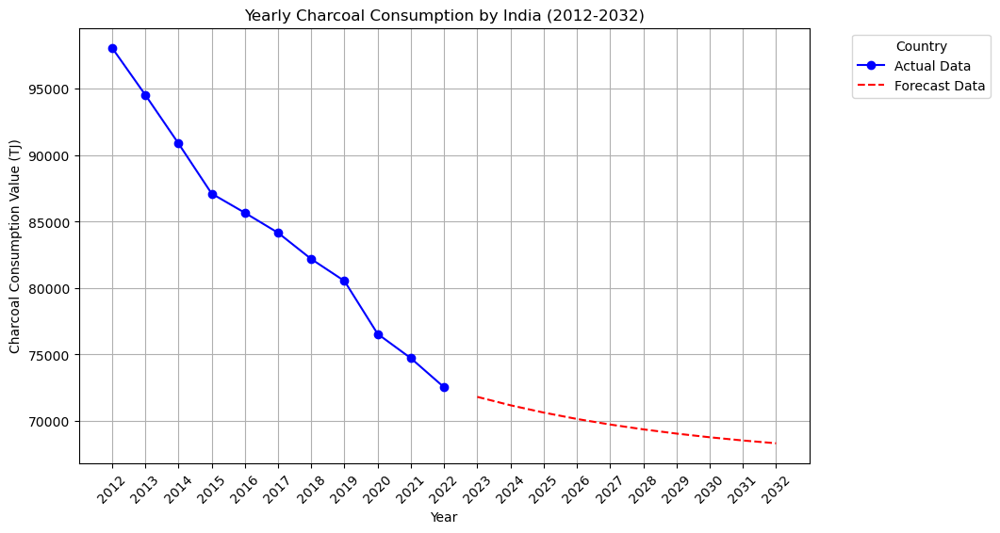

In [56]:
last_year = int(df_charcoal_india_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_india_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_india_c.index ,df_charcoal_india_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Charcoal Consumption Value (TJ)')
plt.title('Yearly Charcoal Consumption by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY CHARCOAL PRODUCTION AND CONSUMPTION IN INDIA FOREACST

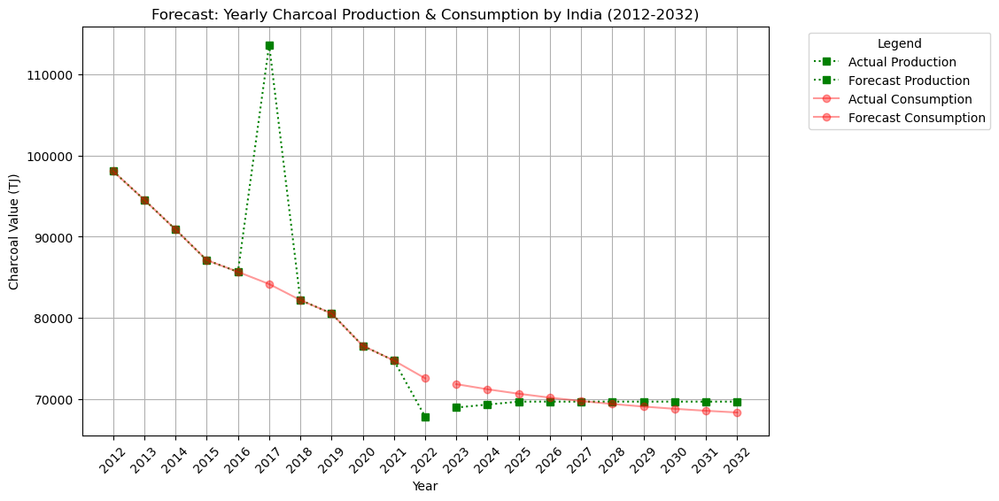

In [57]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_charcoal_india.index, df_charcoal_india['Value'],color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_charcoal_india_c.index, df_charcoal_india_c['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Charcoal Value (TJ)')
plt.title('Forecast: Yearly Charcoal Production & Consumption by India (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_charcoal_india.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Charcoal Forecast/Forecast of Yearly Charcoal Production & Consumption by India (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Charcoal Production in Thailand</B>

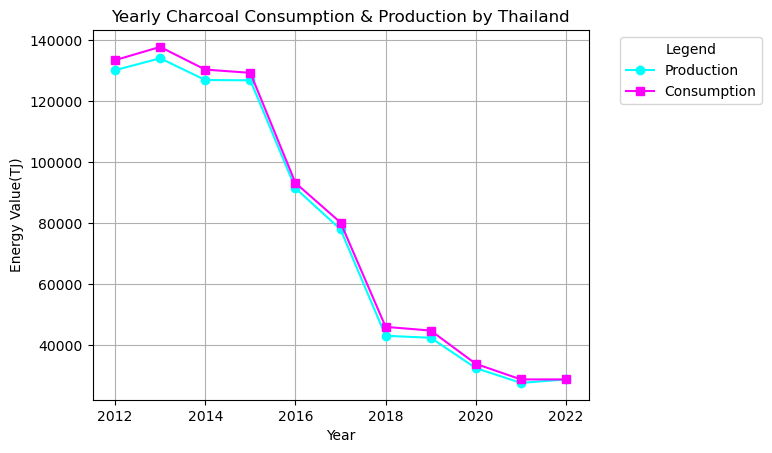

In [58]:
df_charcoal_thailand = df_production[(df_production['Area'] == 'Thailand') & (df_production['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_charcoal_thailand_c = df_consumption[(df_consumption['Area'] == 'Thailand') & (df_consumption['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

# df_charcoal_thailand = df_production[df_production['Area'].isin(['Thailand'])].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')
# df_charcoal_thailand_c = df_consumption[df_consumption['Area'].isin(['Thailand'])].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

plt.plot(df_charcoal_thailand.index, df_charcoal_thailand.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_charcoal_thailand_c.index, df_charcoal_thailand_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')
# df_charcoal_thailand.plot(figsize=(10, 6), marker='o', linestyle='-', label='Production')
# df_charcoal_thailand_c.plot(figsize=(10, 6), marker='s', linestyle='-', label='Consumption')
plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Charcoal Consumption & Production by Thailand')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

<B>Rolling Statistics Test (Visual Inspection of Stationarity)

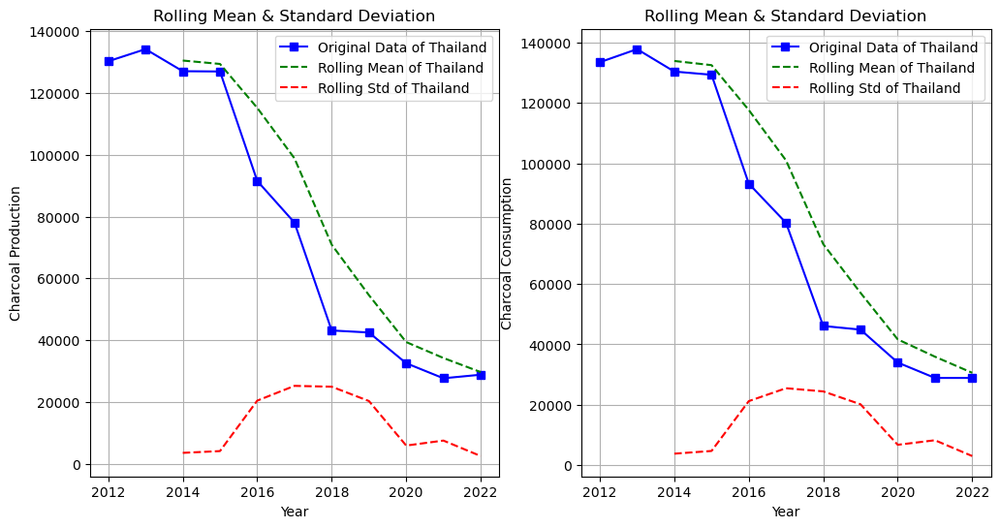

In [59]:
rolling_mean = df_charcoal_thailand.rolling(window=3).mean()
rolling_std = df_charcoal_thailand.rolling(window=3).std()
rolling_mean_c = df_charcoal_thailand_c.rolling(window=3).mean()
rolling_std_c = df_charcoal_thailand_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_charcoal_thailand, label='Original Data of Thailand', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Thailand', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Thailand', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Charcoal Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_charcoal_thailand_c, label='Original Data of Thailand', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Thailand', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Thailand', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Charcoal Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

Rolling mean and Rolling std is showing a trend and is not constant. Hence, the data is <B>NON STATIONARY</B>

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [60]:
adf_statistic = adfuller(df_charcoal_thailand['Value'])[0]
p_value = adfuller(df_charcoal_thailand['Value'])[1]
critical_points = adfuller(df_charcoal_thailand['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.9342133276756772
p-value: 0.3161411442397247
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


p_value is not << 0.05, Hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Production to convert non stationary data to stationary</B>

In [61]:
df_charcoal_thailand['Differenced Production'] = df_charcoal_thailand['Value'].diff()

adf_statistic = adfuller(df_charcoal_thailand['Differenced Production'].dropna())[0]
p_value = adfuller(df_charcoal_thailand['Differenced Production'].dropna())[1]
critical_points = adfuller(df_charcoal_thailand['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -7.211424715982254
p-value: 2.2296472965783155e-10
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF Plots

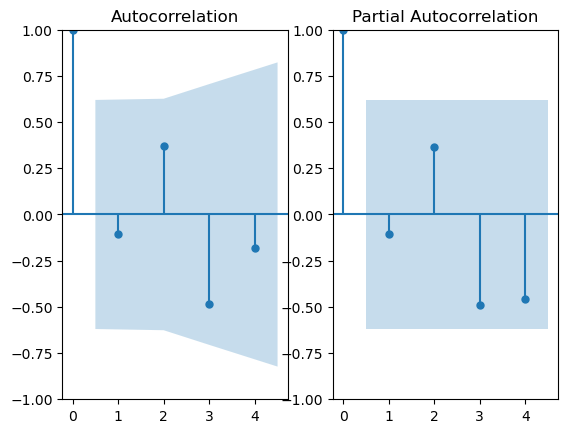

In [62]:
fig, ax = plt.subplots(1,2)
plot_acf(df_charcoal_thailand['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_charcoal_thailand['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [63]:
arima_1 = ARIMA(df_charcoal_thailand['Value'], order=(3,1,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_thailand['Value'], order=(3,1,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 2)   Log Likelihood             -261782.636
Date:                Tue, 25 Mar 2025   AIC                         523577.271
Time:                        00:36:45   BIC                         523579.087
Sample:                             0   HQIC                        523575.280
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9126   1.01e-05     -9e+04      0.000      -0.913      -0.913
ar.L2          0.7349   1.16e-05   6.36e+04      0.000       0.735       0.735
ar.L3          0.9344   8.06e-06   1.16e+05      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


* Conclusion:<BR>
  The lowest AIC and BIC values are of parameter <b>(3,1,3)</b>

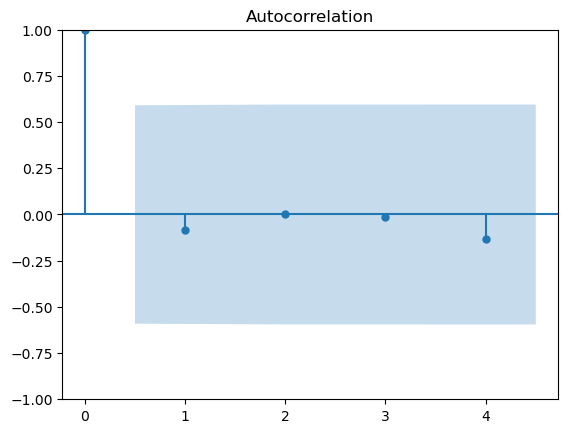

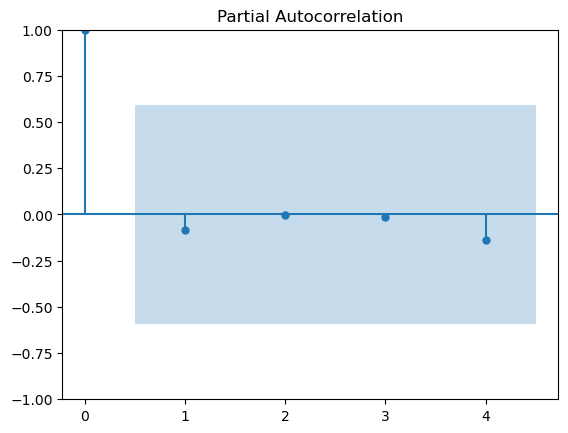

In [64]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

In [65]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)
forecast_p

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


11    42060.461029
12    57343.442050
13    70834.321297
14    79438.244168
15    80946.304487
16    75120.150568
17    63263.903216
18    48333.016060
19    33848.661668
20    23374.186627
Name: predicted_mean, dtype: float64

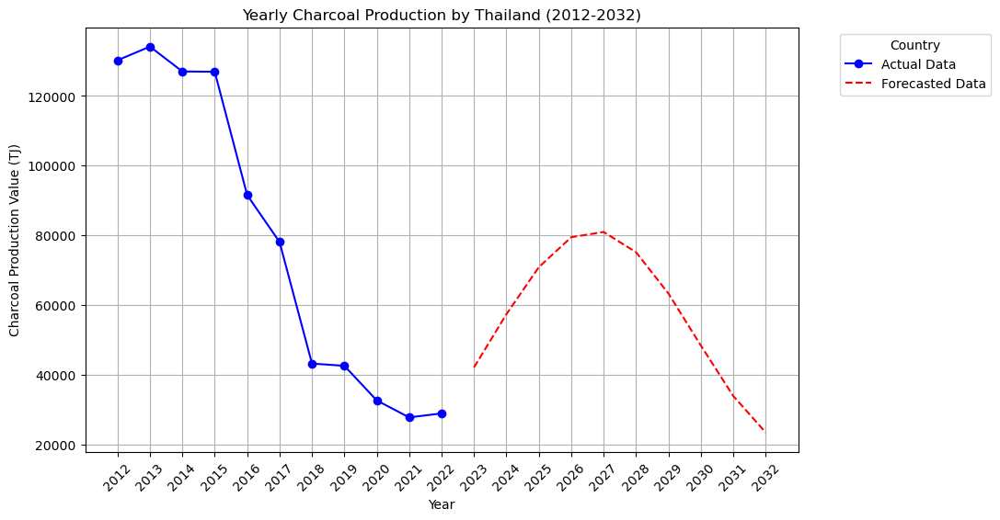

In [66]:
last_year = int(df_charcoal_thailand.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_thailand.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_thailand.index, df_charcoal_thailand['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_p, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Production Value (TJ)')
plt.title('Yearly Charcoal Production by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

## <B>Yearly Charcoal Consumption in Thailand</B>

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [67]:
adf_statistic = adfuller(df_charcoal_thailand_c['Value'])[0]
p_value = adfuller(df_charcoal_thailand_c['Value'])[1]
critical_points = adfuller(df_charcoal_thailand_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.0102416400641854
p-value: 0.28210063052941503
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [68]:
df_charcoal_thailand_c['Differenced Consumption'] = df_charcoal_thailand_c['Value'].diff()

adf_statistic = adfuller(df_charcoal_thailand_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_charcoal_thailand_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_charcoal_thailand_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.533482905598959
p-value: 1.7659699812868521e-06
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

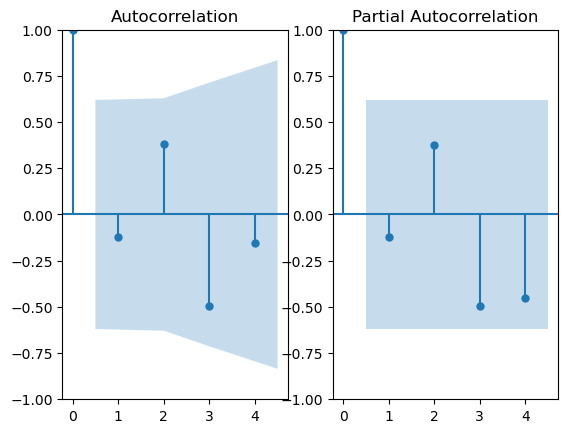

In [69]:
fig, ax = plt.subplots(1,2)
plot_acf(df_charcoal_thailand_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_charcoal_thailand_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [70]:
arima_1 = ARIMA(df_charcoal_thailand_c['Value'], order=(3,1,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_thailand_c['Value'], order=(3,1,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 2)   Log Likelihood             -258472.808
Date:                Tue, 25 Mar 2025   AIC                         516957.616
Time:                        00:36:47   BIC                         516959.432
Sample:                             0   HQIC                        516955.625
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0100   4.66e-06  -2.17e+05      0.000      -1.010      -1.010
ar.L2          0.8716   1.06e-05   8.25e+04      0.000       0.872       0.872
ar.L3          0.9490   4.47e-06   2.12e+05      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


* Conclusion:<BR>
  The lowest AIC and BIC values are of parameter <b>(3,1,3)</b>

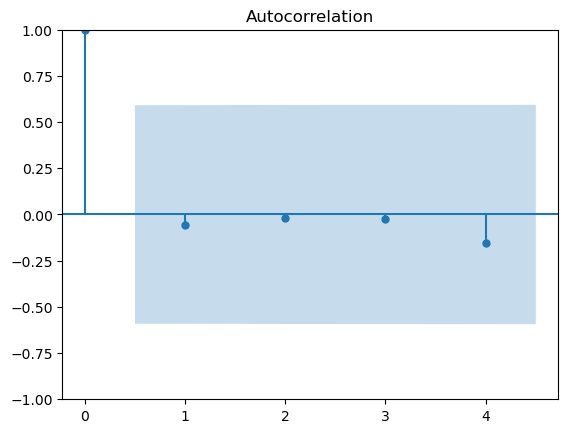

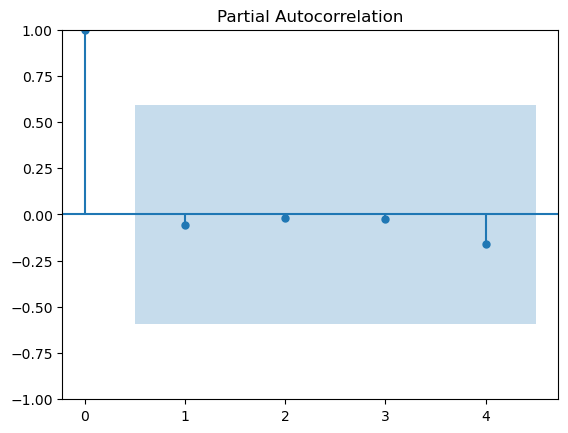

In [71]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

In [72]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)
forecast_c

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


11    42036.430380
12    55420.038206
13    66638.806005
14    71164.087748
15    68958.700547
16    59565.533117
17    46725.631027
18    33184.008069
19    23668.891686
20    20092.066727
Name: predicted_mean, dtype: float64

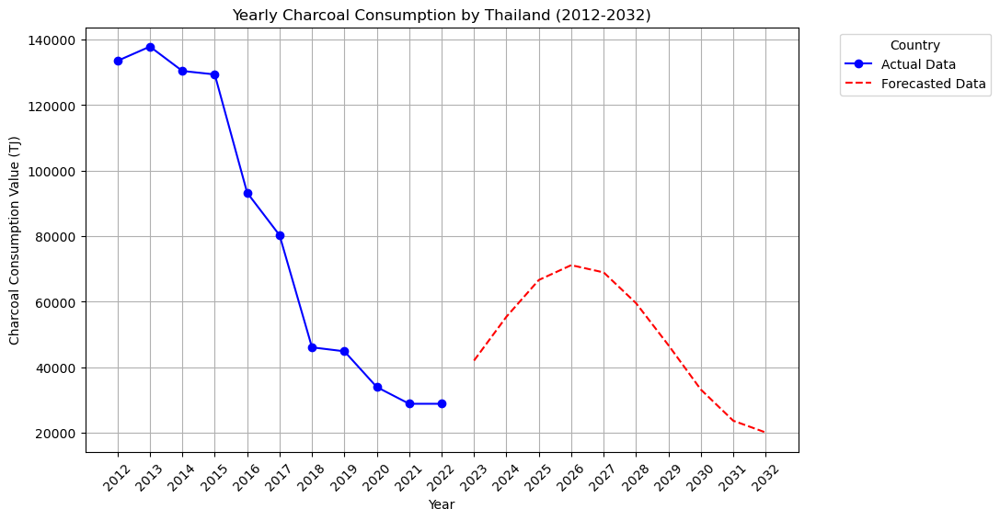

In [73]:
last_year = int(df_charcoal_thailand_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_thailand_c.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_thailand_c.index, df_charcoal_thailand_c['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_c, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Consumption Value (TJ)')
plt.title('Yearly Charcoal Consumption by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

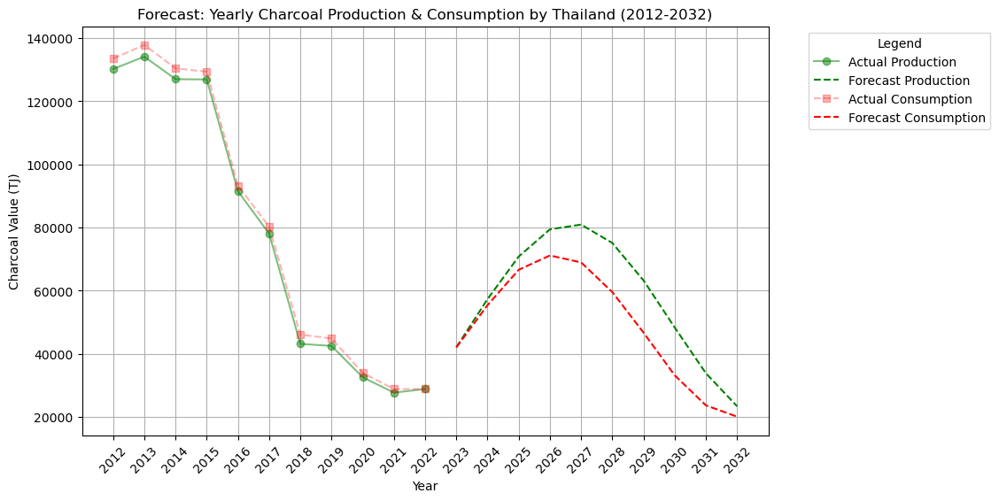

In [74]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_charcoal_thailand.index, df_charcoal_thailand['Value'], color='green', marker='o', linestyle='-', label='Actual Production', alpha=0.5)

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_charcoal_thailand_c.index, df_charcoal_thailand_c['Value'], color='red', marker='s', linestyle='--', label='Actual Consumption', alpha=0.3)

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Charcoal Value (TJ)')
plt.title('Forecast: Yearly Charcoal Production & Consumption by Thailand (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_charcoal_thailand.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Charcoal Forecast/Forecast of Yearly Charcoal Production & Consumption by Thailand (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Charcoal Production in Philippines</B>

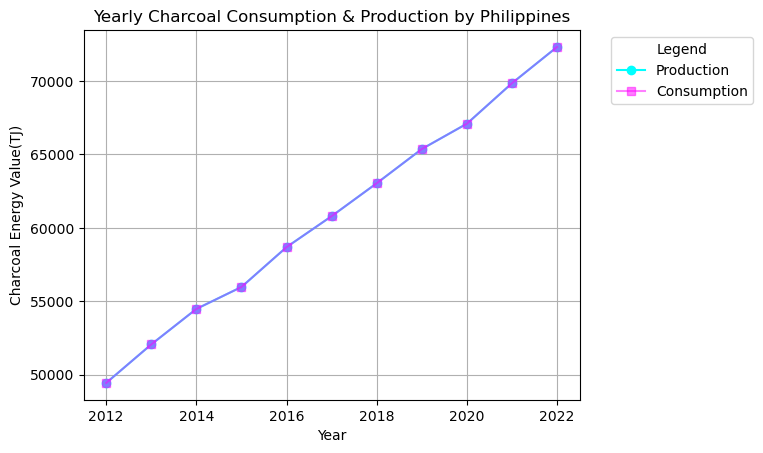

In [75]:
df_charcoal_philippines = df_production[(df_production['Area'] == 'Philippines') & (df_production['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_charcoal_philippines_c = df_consumption[(df_consumption['Area'] == 'Philippines') & (df_consumption['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_charcoal_philippines.index, df_charcoal_philippines.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_charcoal_philippines_c.index, df_charcoal_philippines_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)
# df_charcoal_philippines.plot(figsize=(10, 6), marker='o', linestyle='-', label='Production')
# df_charcoal_philippines_c.plot(figsize=(10, 6), marker='s', linestyle='-', label='Consumption')
plt.xlabel('Year')
plt.ylabel('Charcoal Energy Value(TJ)')
plt.title('Yearly Charcoal Consumption & Production by Philippines')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

<B>Rolling Statistics Test (Visual Inspection of Stationarity)

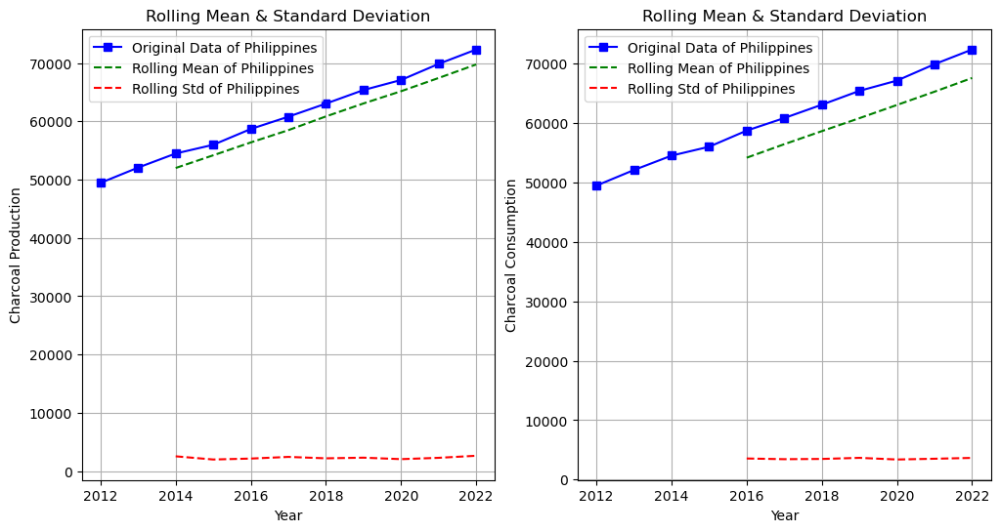

In [76]:
rolling_mean = df_charcoal_philippines.rolling(window=3).mean()
rolling_std = df_charcoal_philippines.rolling(window=3).std()
rolling_mean_c = df_charcoal_philippines_c.rolling(window=5).mean()
rolling_std_c = df_charcoal_philippines_c.rolling(window=5).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_charcoal_philippines, label='Original Data of Philippines', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Philippines', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Philippines', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Charcoal Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_charcoal_philippines_c, label='Original Data of Philippines', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Philippines', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Philippines', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Charcoal Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

Rolling mean is showing a trend and is not constant. Hence, the data is <B>NON STATIONARY</B>, although rolling std is almost constant.

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [77]:
adf_statistic = adfuller(df_charcoal_philippines['Value'])[0]
p_value = adfuller(df_charcoal_philippines['Value'])[1]
critical_points = adfuller(df_charcoal_philippines['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.2220853798580236
p-value: 0.9961349760483019
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Production to convert non stationary data to stationary</B>

In [78]:
df_charcoal_philippines['Differenced Production'] = df_charcoal_philippines['Value'].diff()

adf_statistic = adfuller(df_charcoal_philippines['Differenced Production'].dropna())[0]
p_value = adfuller(df_charcoal_philippines['Differenced Production'].dropna())[1]
critical_points = adfuller(df_charcoal_philippines['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.7746104686011974
p-value: 0.06199300240421295
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [79]:
df_charcoal_philippines['Differenced Production 2'] = df_charcoal_philippines['Differenced Production'].diff()

adf_statistic = adfuller(df_charcoal_philippines['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_charcoal_philippines['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_charcoal_philippines['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.208866812457511
p-value: 8.432916292897473e-06
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

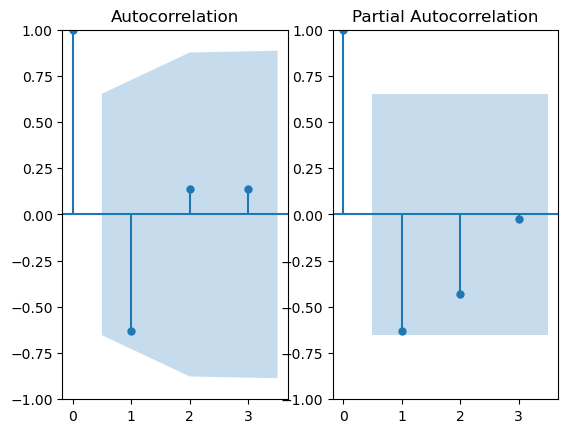

In [80]:
fig, ax = plt.subplots(1,2)

plot_acf(df_charcoal_philippines['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_charcoal_philippines['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

* differencing parameter d = 2
* AR---> p=[1] <via pacf plot>
* MA---> q=[1] <via acf plot>
* Possible parameters:
    1. (1,2,1)

In [81]:
arima = ARIMA(df_charcoal_philippines['Value'], order=(1,2,1))
arima_fit = arima.fit()
print(arima_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 1)   Log Likelihood                 -70.855
Date:                Tue, 25 Mar 2025   AIC                            147.710
Time:                        00:36:51   BIC                            148.302
Sample:                             0   HQIC                           146.433
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7175      0.422     -1.701      0.089      -1.544       0.109
ma.L1          0.6782      0.449      1.512      0.131      -0.201       1.557
sigma2      3.997e+05   2.88e+05      1.387      0.1

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


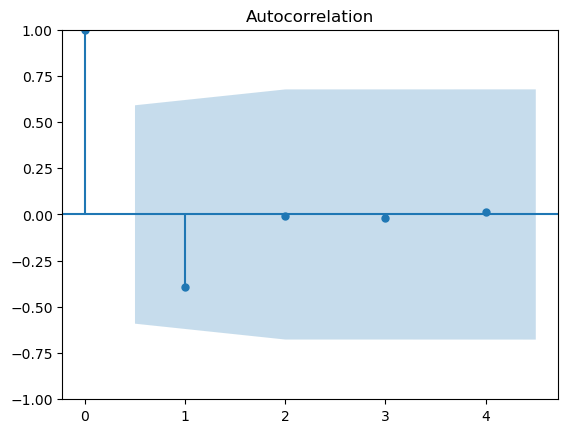

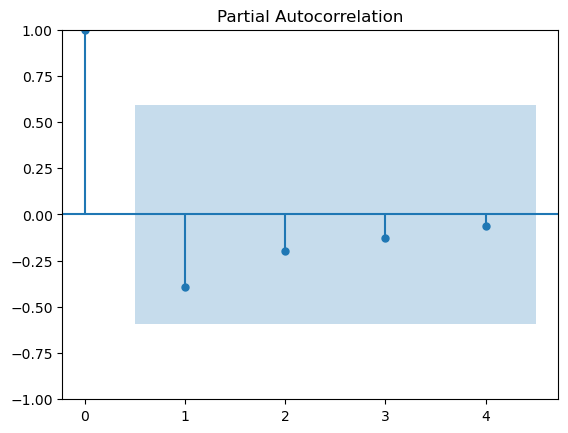

In [82]:
residuals = arima_fit.resid
plot_acf(residuals, lags=4)
plot_pacf(residuals, lags=4)
plt.show()

In [83]:
forecast_years = 10
forecast_p = arima_fit.forecast(steps=forecast_years)
print(forecast_p)

11    74816.864959
12    77292.323212
13    79779.554064
14    82258.337511
15    84743.182376
16    87223.677883
17    89707.294264
18    92188.671268
19    94671.655132
20    97153.485997
Name: predicted_mean, dtype: float64


C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


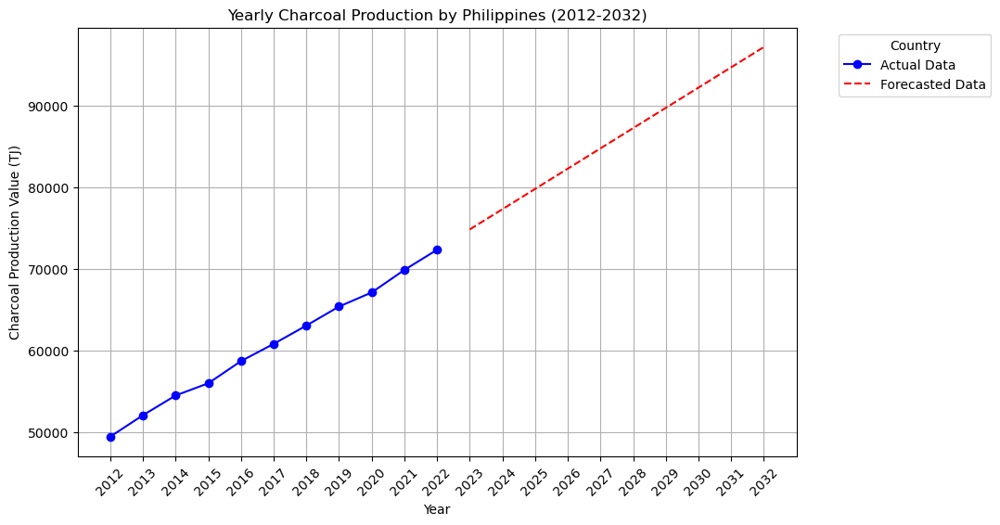

In [84]:
last_year = int(df_charcoal_philippines.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_philippines.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_philippines.index, df_charcoal_philippines['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_p, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Production Value (TJ)')
plt.title('Yearly Charcoal Production by Philippines (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

## <B>Yearly Charcoal Consumption in Philippines</B>

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [85]:
adf_statistic = adfuller(df_charcoal_philippines_c['Value'])[0]
p_value = adfuller(df_charcoal_philippines_c['Value'])[1]
critical_points = adfuller(df_charcoal_philippines_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.2220853798580236
p-value: 0.9961349760483019
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


p-value is not << 0.05...hence the data is <B>STATIONARY</B>

<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [86]:
df_charcoal_philippines_c['Differenced Consumption'] = df_charcoal_philippines_c['Value'].diff()
adf_statistic = adfuller(df_charcoal_philippines_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_charcoal_philippines_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_charcoal_philippines_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.7746104686011974
p-value: 0.06199300240421295
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


p-value is not << 0.05...hence the data is <B>STATIONARY</B>

<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [87]:
df_charcoal_philippines_c['Differenced Consumption 2'] = df_charcoal_philippines_c['Differenced Consumption'].diff()
adf_statistic = adfuller(df_charcoal_philippines_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_charcoal_philippines_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_charcoal_philippines_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.208866812457511
p-value: 8.432916292897473e-06
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

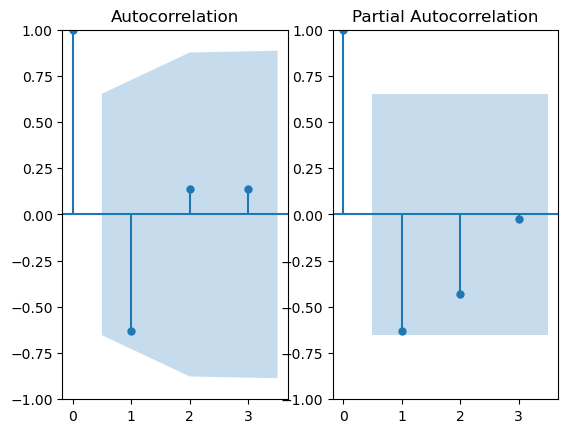

In [88]:
fig, ax = plt.subplots(1,2)

plot_acf(df_charcoal_philippines_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_charcoal_philippines_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

* p=1 or 2, d=2, q=1
* params--> (1,2,1) or (2,2,1)

In [89]:
arima_1 = ARIMA(df_charcoal_philippines_c['Value'], order=(1,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_philippines_c['Value'], order=(2,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 1)   Log Likelihood                 -70.855
Date:                Tue, 25 Mar 2025   AIC                            147.710
Time:                        00:36:53   BIC                            148.302
Sample:                             0   HQIC                           146.433
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7175      0.422     -1.701      0.089      -1.544       0.109
ma.L1          0.6782      0.449      1.512      0.131      -0.201       1.557
sigma2      3.997e+05   2.88e+05      1.387      0.1

Conclusion: The lowest AIC and BIC values are of paramete (2,2,1)

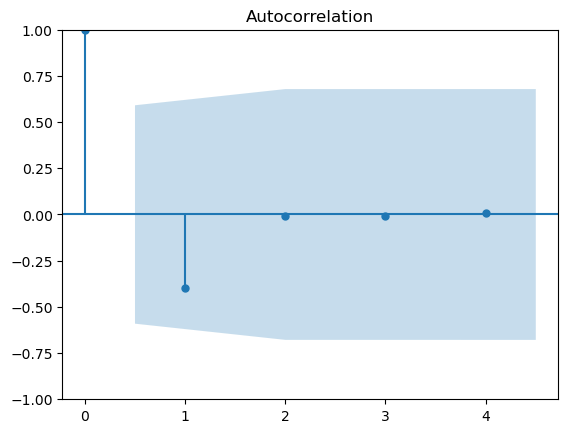

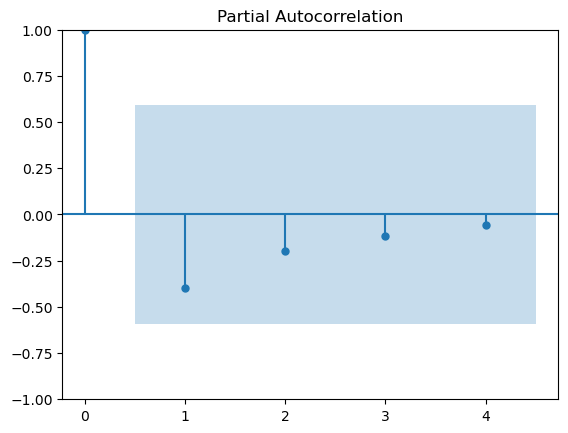

In [90]:
residuals = arima_2_fit.resid
plot_acf(residuals, lags=4)
plot_pacf(residuals, lags=4)
plt.show()

In [91]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)
print(forecast_c)

11    74906.791081
12    77403.918133
13    79952.319179
14    82467.739620
15    85003.998596
16    87527.022114
17    90058.439210
18    92584.530938
19    95114.000943
20    97641.327774
Name: predicted_mean, dtype: float64


C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


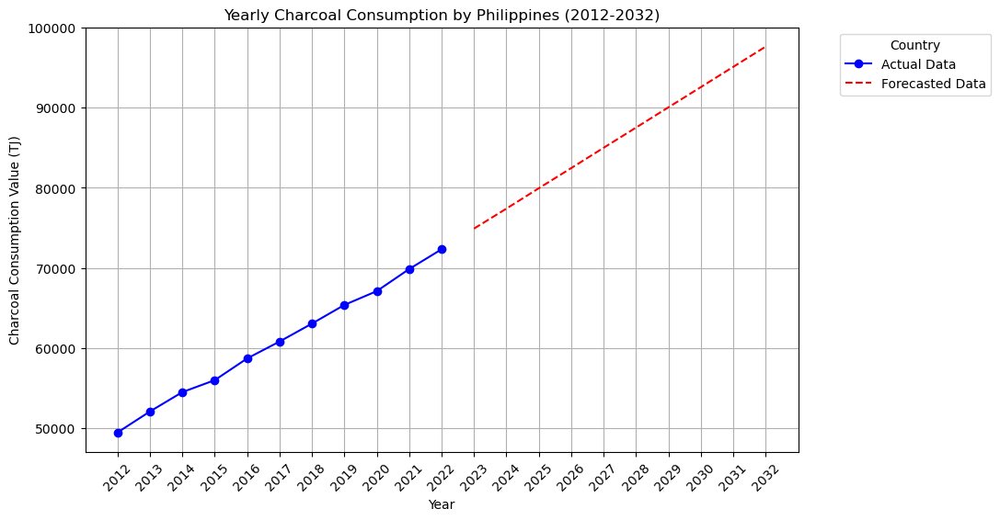

In [92]:
last_year = int(df_charcoal_philippines_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_philippines_c.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_philippines_c.index, df_charcoal_philippines_c['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_c, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Consumption Value (TJ)')
plt.title('Yearly Charcoal Consumption by Philippines (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

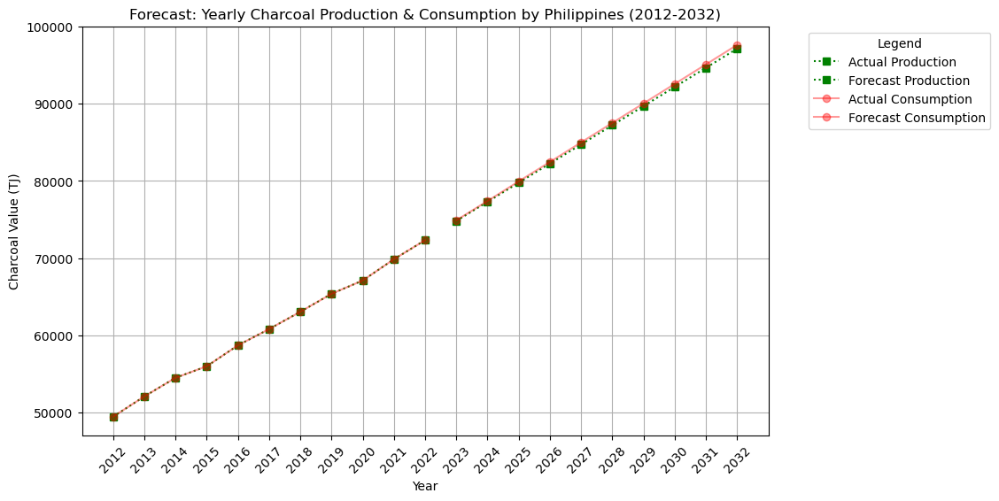

In [93]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_charcoal_philippines.index, df_charcoal_philippines['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_charcoal_philippines_c.index, df_charcoal_philippines_c['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Charcoal Value (TJ)')
plt.title('Forecast: Yearly Charcoal Production & Consumption by Philippines (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_charcoal_philippines.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Charcoal Forecast/Forecast of Yearly Charcoal Production & Consumption by Philippines (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Charcoal Production in China, mainland</B>

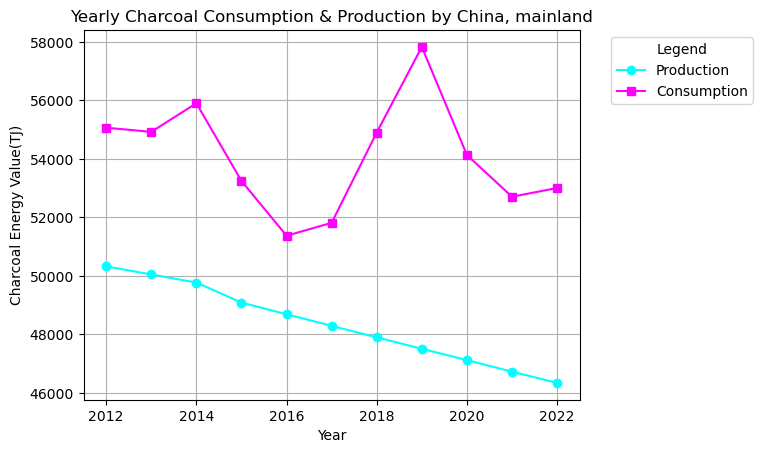

In [94]:
df_charcoal_china = df_production[(df_production['Area'] == 'China, mainland') & (df_production['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_charcoal_china_c = df_consumption[(df_consumption['Area'] == 'China, mainland') & (df_consumption['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_charcoal_china.index, df_charcoal_china.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_charcoal_china_c.index, df_charcoal_china_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')
# df_charcoal_china.plot(figsize=(10, 6), marker='o', linestyle='-', label='Production')
# df_charcoal_china_c.plot(figsize=(10, 6), marker='s', linestyle='-', label='Consumption')
plt.xlabel('Year')
plt.ylabel('Charcoal Energy Value(TJ)')
plt.title('Yearly Charcoal Consumption & Production by China, mainland')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

<B>Rolling Statistics Test (Visual Inspection of Stationarity)

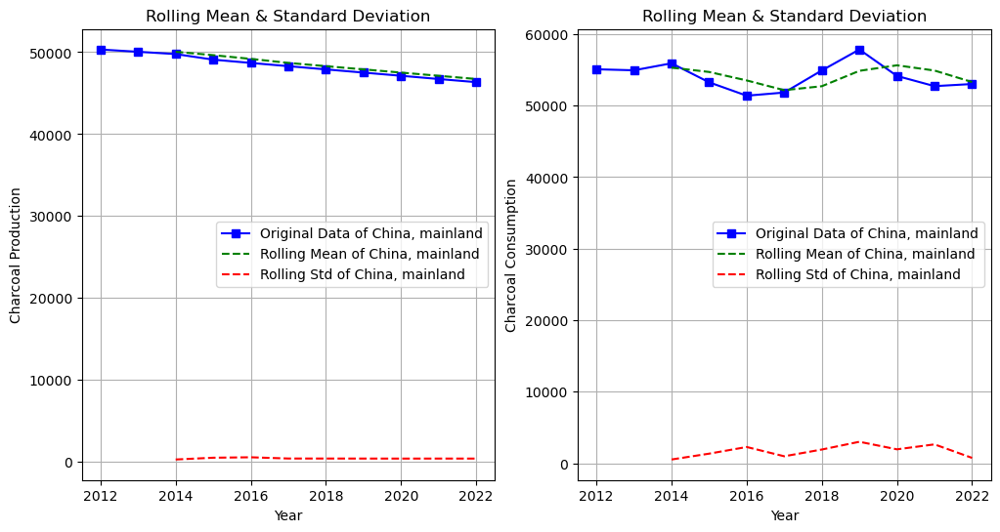

In [95]:
rolling_mean = df_charcoal_china.rolling(window=3).mean()
rolling_std = df_charcoal_china.rolling(window=3).std()
rolling_mean_c = df_charcoal_china_c.rolling(window=3).mean()
rolling_std_c = df_charcoal_china_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_charcoal_china, label='Original Data of China, mainland', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of China, mainland', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Charcoal Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_charcoal_china_c, label='Original Data of China, mainland', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of China, mainland', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Charcoal Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

Rolling mean is showing a trend and is not constant. Hence, the data is <B>NON STATIONARY</B>, although rolling std is almost constant.

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [96]:
adf_statistic = adfuller(df_charcoal_china['Value'])[0]
p_value = adfuller(df_charcoal_china['Value'])[1]
critical_points = adfuller(df_charcoal_china['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.0012262677400237143
p-value: 0.958430557012037
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Production to convert non stationary data to stationary</B>

In [97]:
df_charcoal_china['Differenced Production'] = df_charcoal_china['Value'].diff()

adf_statistic = adfuller(df_charcoal_china['Differenced Production'].dropna())[0]
p_value = adfuller(df_charcoal_china['Differenced Production'].dropna())[1]
critical_points = adfuller(df_charcoal_china['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.1919010286907152
p-value: 0.020458291840489345
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is much much less the all the critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

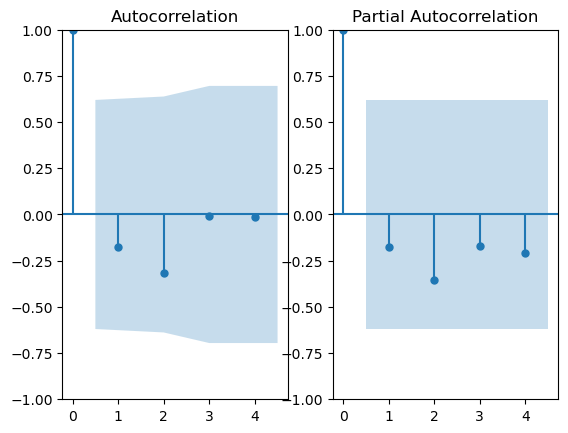

In [98]:
fig, ax = plt.subplots(1,2)
plot_acf(df_charcoal_china['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_charcoal_china['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [99]:
arima_1 = ARIMA(df_charcoal_china['Value'], order=(4,1,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_china['Value'], order=(2,1,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 2)   Log Likelihood                -166.342
Date:                Tue, 25 Mar 2025   AIC                            346.683
Time:                        00:36:58   BIC                            348.801
Sample:                             0   HQIC                           344.360
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1577      0.026      6.097      0.000       0.107       0.208
ar.L2          0.0098      0.002      5.000      0.000       0.006       0.014
ar.L3         -0.1499      0.027     -5.644      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


* Conclusion:<BR>
  The lowest AIC and BIC values are of parameter <b>(2,1,2)</b>

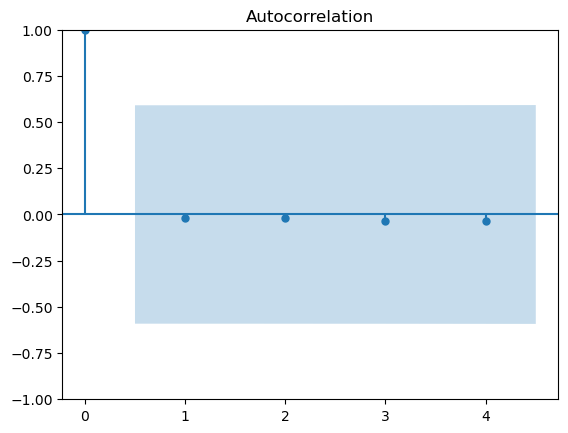

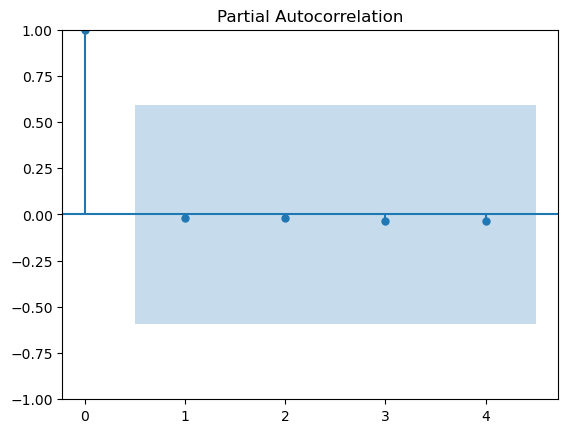

In [100]:
residuals = arima_2_fit.resid
plot_acf(residuals, lags=4)
plot_pacf(residuals, lags=4)
plt.show()

In [101]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)
forecast_p

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


11    46033.612160
12    45719.834382
13    45410.425918
14    45096.680369
15    44787.251601
16    44473.537963
17    44164.089206
18    43850.407165
19    43540.938731
20    43227.287978
Name: predicted_mean, dtype: float64

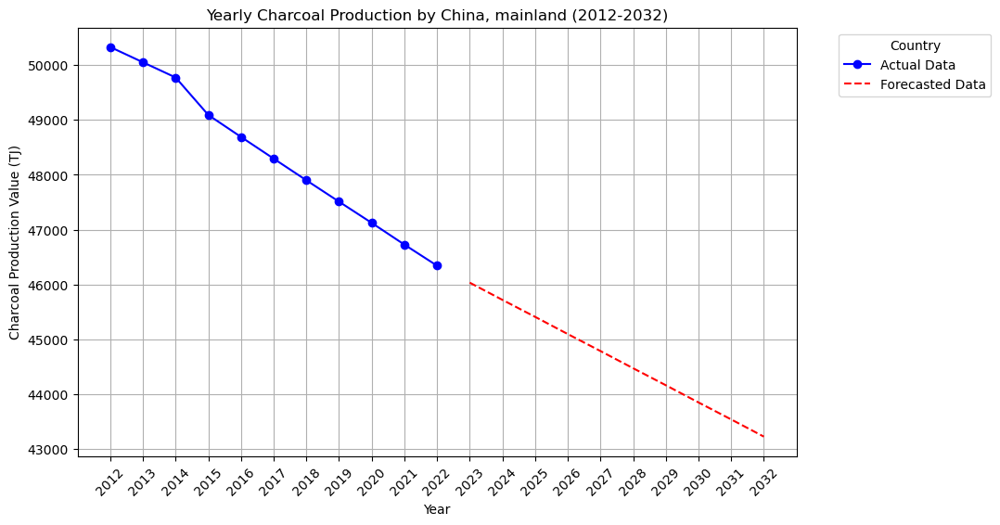

In [102]:
last_year = int(df_charcoal_china.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_china.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_china.index, df_charcoal_china['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_p, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Production Value (TJ)')
plt.title('Yearly Charcoal Production by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

## <B>Yearly Charcoal Consumption in China, mainland</B>

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) of Energy Consumption

In [103]:
adf_statistic = adfuller(df_charcoal_china_c['Value'])[0]
p_value = adfuller(df_charcoal_china_c['Value'])[1]
critical_points = adfuller(df_charcoal_china_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.4180072896005638
p-value: 0.01036010912558586
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


so d=0 and data is Stationary

<B>ACF and PACF PLOTS</B>

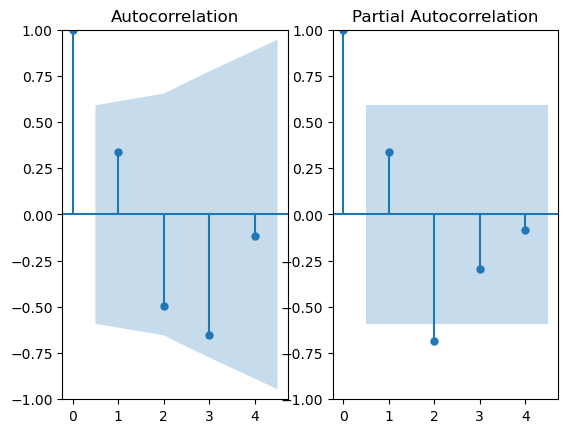

In [104]:
fig, ax = plt.subplots(1,2)

plot_acf(df_charcoal_china_c['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_charcoal_china_c['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

Possible parameters:
* p=2, d=0, q=0
* p=2, d=0, q=2
* p=2, d=0, q=3

In [105]:
arima_1 = ARIMA(df_charcoal_china_c['Value'], order=(2,0,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_china_c['Value'], order=(2,0,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_charcoal_china_c['Value'], order=(2,0,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 0, 0)   Log Likelihood                 -94.284
Date:                Tue, 25 Mar 2025   AIC                            196.568
Time:                        00:37:00   BIC                            198.159
Sample:                             0   HQIC                           195.564
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.408e+04    447.392    120.885      0.000    5.32e+04     5.5e+04
ar.L1          0.5270      0.248      2.122      0.034       0.040       1.014
ar.L2         -0.6282      0.266     -2.365      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 0, 2)   Log Likelihood                 -91.118
Date:                Tue, 25 Mar 2025   AIC                            194.237
Time:                        00:37:00   BIC                            196.624
Sample:                             0   HQIC                           192.732
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.395e+04     95.881    562.642      0.000    5.38e+04    5.41e+04
ar.L1          0.9862      0.255      3.874      0.000       0.487       1.485
ar.L2         -0.8769      0.237     -3.704      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


* Conclusion:<BR>
  The lowest AIC and BIC values are of parameter <b>(2,0,2)</b>

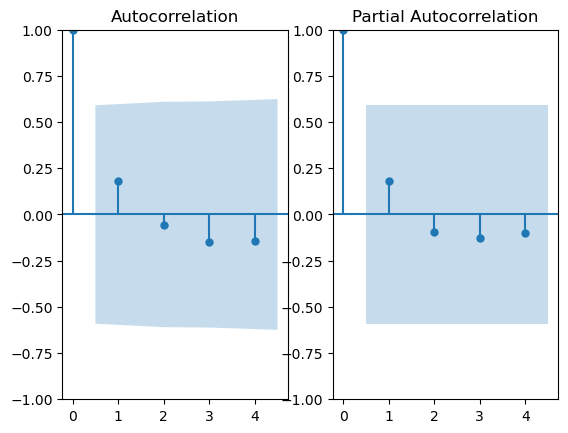

In [106]:
fig, ax = plt.subplots(1,2)
residuals = arima_2_fit.resid
plot_acf(residuals, ax=ax[0], lags=4)
plot_pacf(residuals, ax=ax[1], lags=4)
plt.show()

In [107]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)
forecast_c

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


11    52757.193320
12    54101.201234
13    55141.889251
14    54989.599801
15    53926.820711
16    53012.287454
17    53042.372540
18    53874.010490
19    54667.762820
20    54721.258901
Name: predicted_mean, dtype: float64

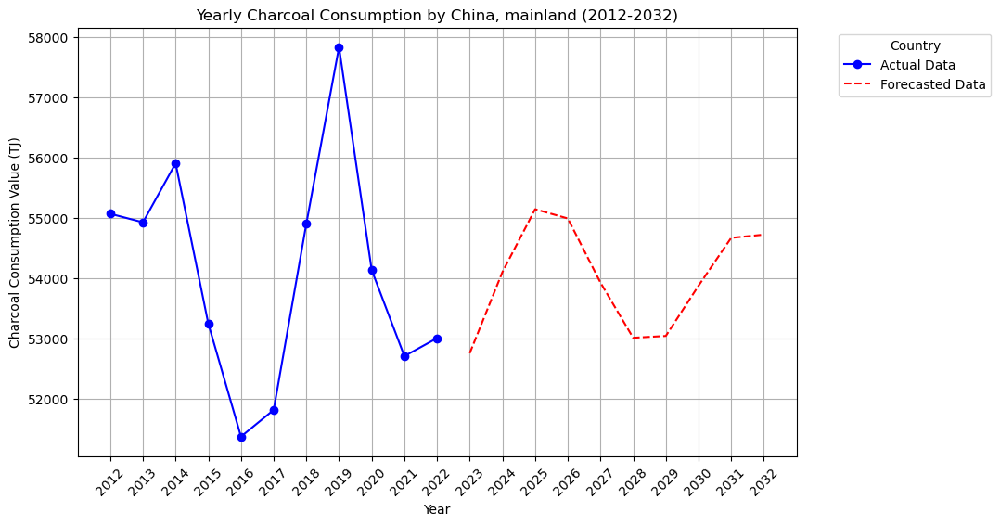

In [108]:
last_year = int(df_charcoal_china_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_china_c.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_china_c.index, df_charcoal_china_c['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_c, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Consumption Value (TJ)')
plt.title('Yearly Charcoal Consumption by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

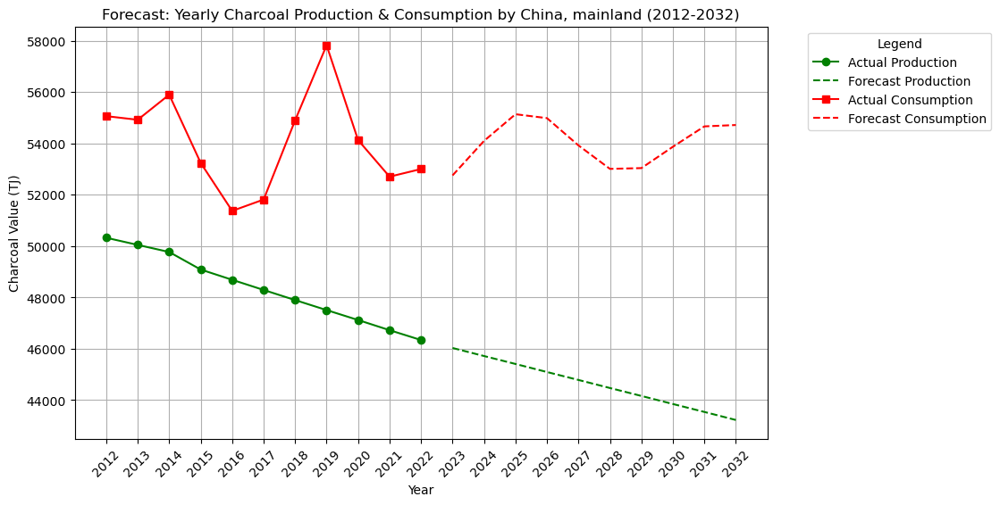

In [109]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_charcoal_china.index, df_charcoal_china['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_charcoal_china_c.index, df_charcoal_china_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Charcoal Value (TJ)')
plt.title('Forecast: Yearly Charcoal Production & Consumption by China, mainland (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_charcoal_china.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Charcoal Forecast/Forecast of Yearly Charcoal Production & Consumption by China, mainland (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Charcoal Production in Indonesia</B>

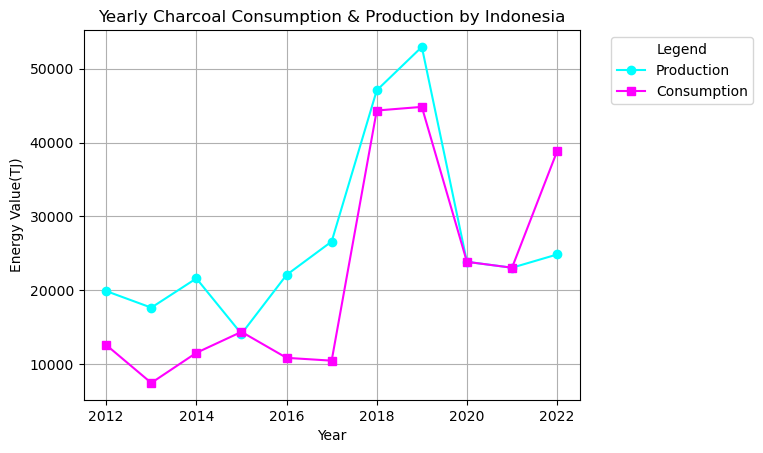

In [110]:
df_charcoal_indonesia = df_production[(df_production['Area'] == 'Indonesia') & (df_production['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_charcoal_indonesia_c = df_consumption[(df_consumption['Area'] == 'Indonesia') & (df_consumption['Item'] == 'Charcoal')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_charcoal_indonesia.index, df_charcoal_indonesia.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_charcoal_indonesia_c.index, df_charcoal_indonesia_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')
# df_charcoal_indonesia.plot(figsize=(10, 6), marker='o', linestyle='-', label='Production')
# df_charcoal_indonesia_c.plot(figsize=(10, 6), marker='s', linestyle='-', label='Consumption')
plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Charcoal Consumption & Production by Indonesia')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

<B>Rolling Statistics Test (Visual Inspection of Stationarity)

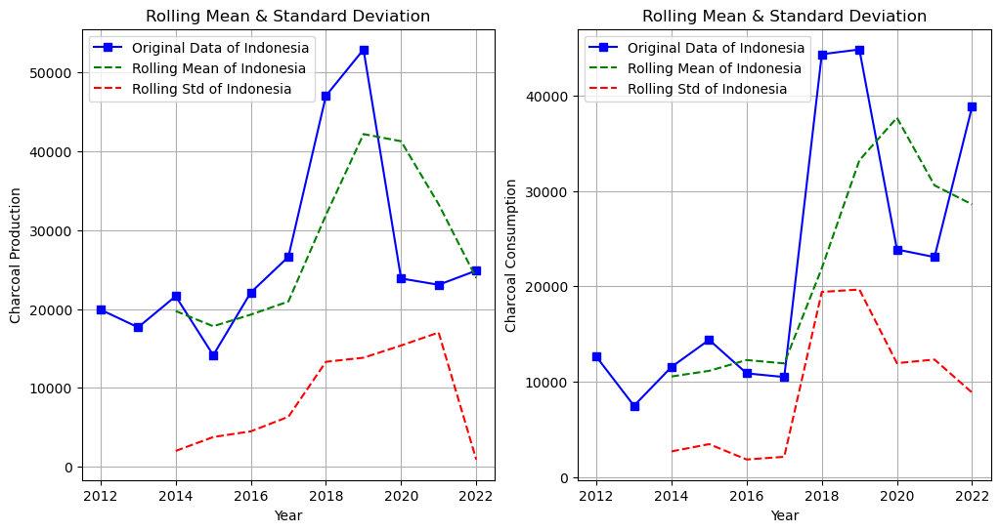

In [111]:
rolling_mean = df_charcoal_indonesia.rolling(window=3).mean()
rolling_std = df_charcoal_indonesia.rolling(window=3).std()
rolling_mean_c = df_charcoal_indonesia_c.rolling(window=3).mean()
rolling_std_c = df_charcoal_indonesia_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_charcoal_indonesia, label='Original Data of Indonesia', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Indonesia', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Charcoal Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_charcoal_indonesia_c, label='Original Data of Indonesia', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Indonesia', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Charcoal Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

Rolling mean and rolling std is showing a trend and is not constant. Hence, the data is <B>NON STATIONARY</B>

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [112]:
adf_statistic = adfuller(df_charcoal_indonesia['Value'])[0]
p_value = adfuller(df_charcoal_indonesia['Value'])[1]
critical_points = adfuller(df_charcoal_indonesia['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.96172599729837
p-value: 0.3036028264724415
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Production to convert non stationary data to stationary</B>

In [113]:
df_charcoal_indonesia['Differenced Production'] = df_charcoal_indonesia['Value'].diff()

adf_statistic = adfuller(df_charcoal_indonesia['Differenced Production'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia['Differenced Production'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.210776724874497
p-value: 0.2023574038103622
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [114]:
df_charcoal_indonesia['Differenced Production 2'] = df_charcoal_indonesia['Differenced Production'].diff()

adf_statistic = adfuller(df_charcoal_indonesia['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.5009438029636253
p-value: 0.11524485615991659
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing 3rd time the Production to convert non stationary data to stationary</B>

In [115]:
df_charcoal_indonesia['Differenced Production 3'] = df_charcoal_indonesia['Differenced Production 2'].diff()

adf_statistic = adfuller(df_charcoal_indonesia['Differenced Production 3'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia['Differenced Production 3'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia['Differenced Production 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.6294376246972435
p-value: 0.08706444584167972
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 4th time the Production to convert non stationary data to stationary</B>

In [116]:
df_charcoal_indonesia['Differenced Production 4'] = df_charcoal_indonesia['Differenced Production 3'].diff()

adf_statistic = adfuller(df_charcoal_indonesia['Differenced Production 4'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia['Differenced Production 4'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia['Differenced Production 4'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.838315413642902
p-value: 0.05300567998354216
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


<B>Differencing 5th time the Production to convert non stationary data to stationary</B>

In [117]:
df_charcoal_indonesia['Differenced Production 5'] = df_charcoal_indonesia['Differenced Production 4'].diff()

adf_statistic = adfuller(df_charcoal_indonesia['Differenced Production 5'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia['Differenced Production 5'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia['Differenced Production 5'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.7861081743621927
p-value: 0.060285679438559996
critical points: {'1%': -7.355440625, '5%': -4.474365000000001, '10%': -3.1269325}


<B>Differencing 6th time the Production to convert non stationary data to stationary</B>

In [118]:
df_charcoal_indonesia['Differenced Production 6'] = df_charcoal_indonesia['Differenced Production 5'].diff()

adf_statistic = adfuller(df_charcoal_indonesia['Differenced Production 6'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia['Differenced Production 6'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia['Differenced Production 6'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.4186387418629813
p-value: 0.1365447159796595
critical points: {'1%': -7.355440625, '5%': -4.474365000000001, '10%': -3.1269325}


In [119]:
df_charcoal_indonesia['Differenced Production 7'] = df_charcoal_indonesia['Differenced Production 6'].diff()

adf_statistic = adfuller(df_charcoal_indonesia['Differenced Production 7'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia['Differenced Production 7'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia['Differenced Production 7'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.1232988741878405
p-value: 0.2352497868574414
critical points: {'1%': -10.41719074074074, '5%': -5.77838074074074, '10%': -3.391681111111111}


Trying KPSS test

In [120]:
from statsmodels.tsa.stattools import kpss

def kpss_test(series, name):
    statistic, p_value, _, critical_values = kpss(series.dropna(), regression='c', nlags='auto')
    print(f'KPSS Test for {name}')
    print(f'Test Statistic: {statistic}')
    print(f'p-value: {p_value}')
    print(f'Critical Values: {critical_values}')
    print('Conclusion:', 'Non-Stationary' if p_value < 0.05 else 'Stationary')
    print('-' * 50)

# Apply KPSS test
kpss_test(df_charcoal_indonesia['Value'], 'Original Series (Value)')
kpss_test(df_charcoal_indonesia['Differenced Production 4'], 'Differenced Production 4')

KPSS Test for Original Series (Value)
Test Statistic: 0.21832543666070453
p-value: 0.1
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Conclusion: Stationary
--------------------------------------------------
KPSS Test for Differenced Production 4
Test Statistic: 0.5000000000000006
p-value: 0.041666666666666546
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Conclusion: Non-Stationary
--------------------------------------------------


C:\Users\HP\AppData\Local\Temp\ipykernel_6596\2098959886.py:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, _, critical_values = kpss(series.dropna(), regression='c', nlags='auto')


In [121]:
df_charcoal_indonesia['Seasonal_Diff'] = df_charcoal_indonesia['Value'].diff(1).dropna()

def kpss_test(series):
    result = kpss(series.dropna(), regression='c', nlags="auto")
    print(f'Test Statistic: {result[0]}')
    print(f'p-value: {result[1]}')
    print(f'Critical Values: {result[3]}')
    if result[1] > 0.05:
        print("Conclusion: Stationary ✅")
    else:
        print("Conclusion: Non-Stationary ❌")

kpss_test(df_charcoal_indonesia['Seasonal_Diff'])

Test Statistic: 0.10541087670839215
p-value: 0.1
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Conclusion: Stationary ✅


C:\Users\HP\AppData\Local\Temp\ipykernel_6596\3127238813.py:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series.dropna(), regression='c', nlags="auto")


d=1

<B>ACF and PACF PLOTS</B>

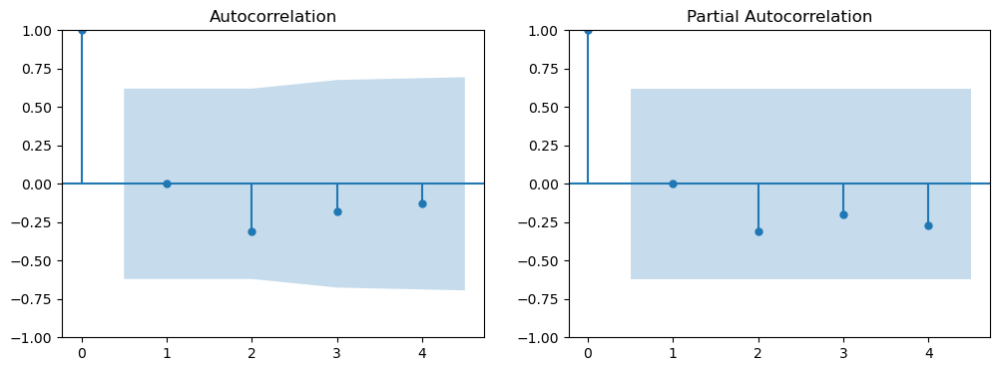

In [122]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))
plot_acf(df_charcoal_indonesia['Seasonal_Diff'].dropna(), ax=axes[0], lags=4)
plot_pacf(df_charcoal_indonesia['Seasonal_Diff'].dropna(), ax=axes[1], lags=4)
plt.show()

In [123]:
arima_1 = ARIMA(df_charcoal_indonesia['Value'], order=(2,1,2))
arima_1_fit = arima_1.fit()
# print(arima_1_fit.summary())
print(f"AIC1: {arima_1_fit.aic}")
print(f"BIC1: {arima_1_fit.bic}\n")

arima_2 = ARIMA(df_charcoal_indonesia['Value'], order=(3,1,2))
arima_2_fit = arima_2.fit()
# print(arima_2_fit.summary())
print(f"AIC2: {arima_2_fit.aic}")
print(f"BIC2: {arima_2_fit.bic}\n")

arima_3 = ARIMA(df_charcoal_indonesia['Value'], order=(4,1,2))
arima_3_fit = arima_3.fit()
# print(arima_1_fit.summary())
print(f"AIC3: {arima_3_fit.aic}")
print(f"BIC3: {arima_3_fit.bic}\n")

arima_4 = ARIMA(df_charcoal_indonesia['Value'], order=(4,1,0))
arima_4_fit = arima_4.fit()
# print(arima_1_fit.summary())
print(f"AIC4: {arima_4_fit.aic}")
print(f"BIC4: {arima_4_fit.bic}\n")

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

AIC1: 9657281916144.254
BIC1: 9657281916145.768

AIC2: 9657281204536.678
BIC2: 9657281204538.494



C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


AIC3: 90475.92206222864
BIC3: 90478.0401578796

AIC4: 224.91930683353522
BIC4: 226.43223229850545



C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


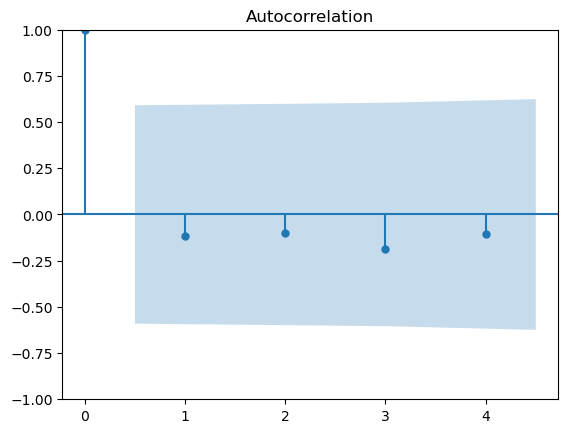

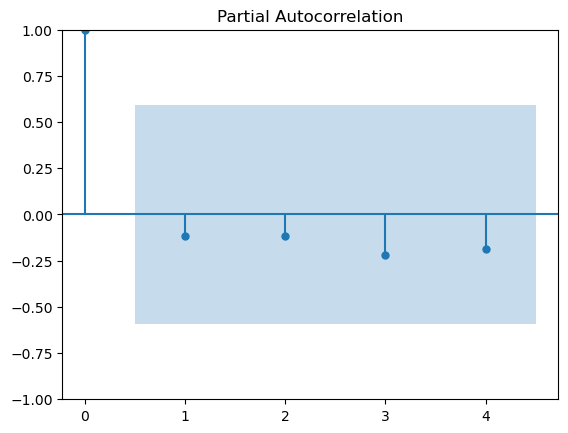

In [124]:
residuals = arima_4_fit.resid
plot_acf(residuals, lags=4)
plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


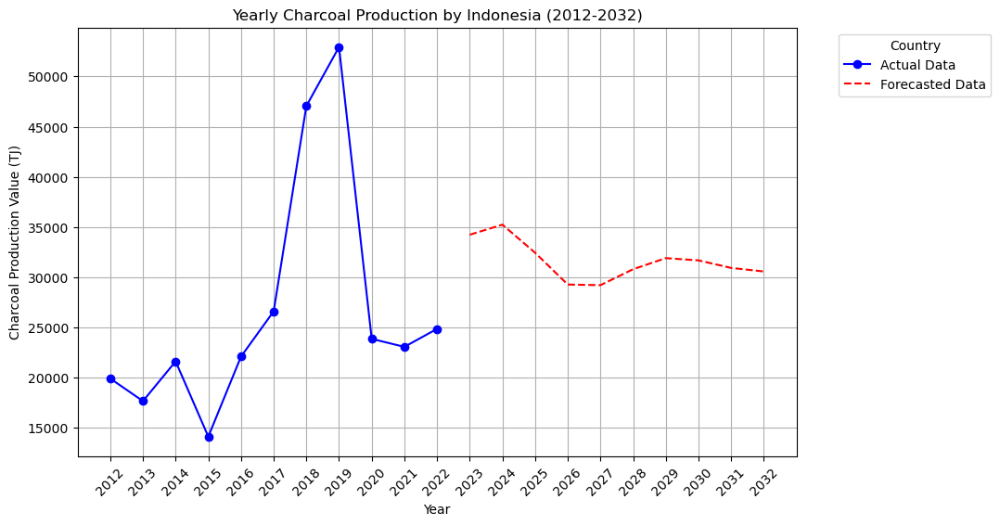

In [125]:
forecast_years = 10
forecast_p = arima_4_fit.forecast(steps=forecast_years)

last_year = int(df_charcoal_indonesia.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_indonesia.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_indonesia.index, df_charcoal_indonesia['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_p, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Production Value (TJ)')
plt.title('Yearly Charcoal Production by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [126]:
adf_statistic = adfuller(df_charcoal_indonesia_c['Value'])[0]
p_value = adfuller(df_charcoal_indonesia_c['Value'])[1]
critical_points = adfuller(df_charcoal_indonesia_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.6794668201244797
p-value: 0.8519966502976437
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


p-value is not << 0.05...hence the data is <B>NOT STATIONARY</B>

<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [127]:
df_charcoal_indonesia_c['Differenced Consumption'] = df_charcoal_indonesia_c['Value'].diff()

adf_statistic = adfuller(df_charcoal_indonesia_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_charcoal_indonesia_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_charcoal_indonesia_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.917563748508092
p-value: 0.0019093233342795926
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

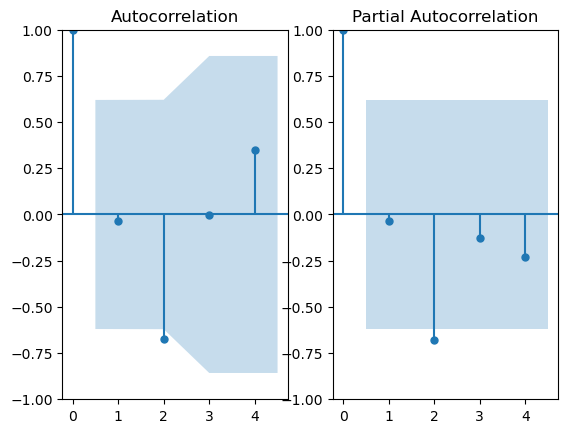

In [128]:
fig, ax = plt.subplots(1,2)

plot_acf(df_charcoal_indonesia_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_charcoal_indonesia_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

p=2, d=1, q=0

In [129]:
arima_1 = ARIMA(df_charcoal_indonesia_c['Value'], order=(2,1,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_charcoal_indonesia_c['Value'], order=(2,1,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 2)   Log Likelihood              -35417.001
Date:                Tue, 25 Mar 2025   AIC                          70844.002
Time:                        00:37:07   BIC                          70845.515
Sample:                             0   HQIC                         70842.342
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5302      0.000   1073.886      0.000       0.529       0.531
ar.L2         -0.9977      7e-05  -1.42e+04      0.000      -0.998      -0.998
ma.L1         -0.9825      0.016    -61.994      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


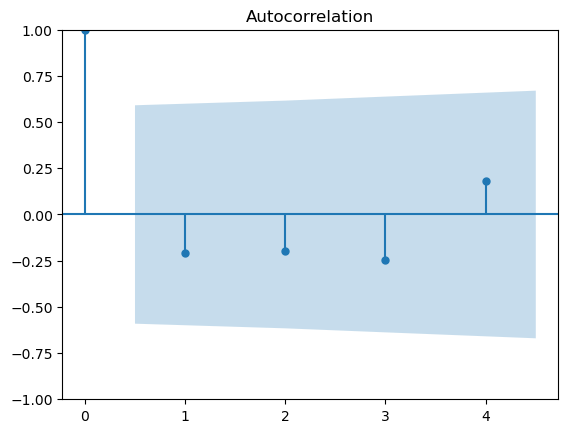

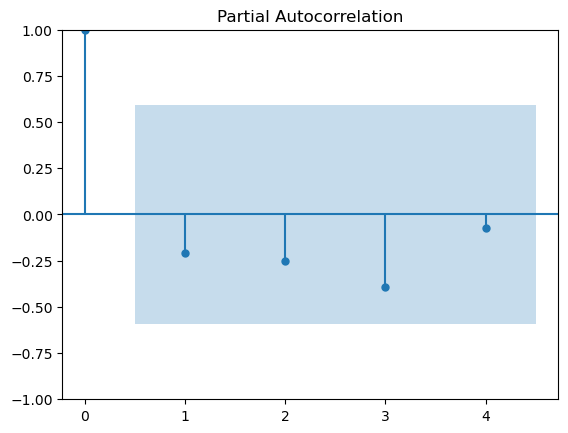

In [130]:
residuals = arima_2_fit.resid
plot_acf(residuals, lags=4)
plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


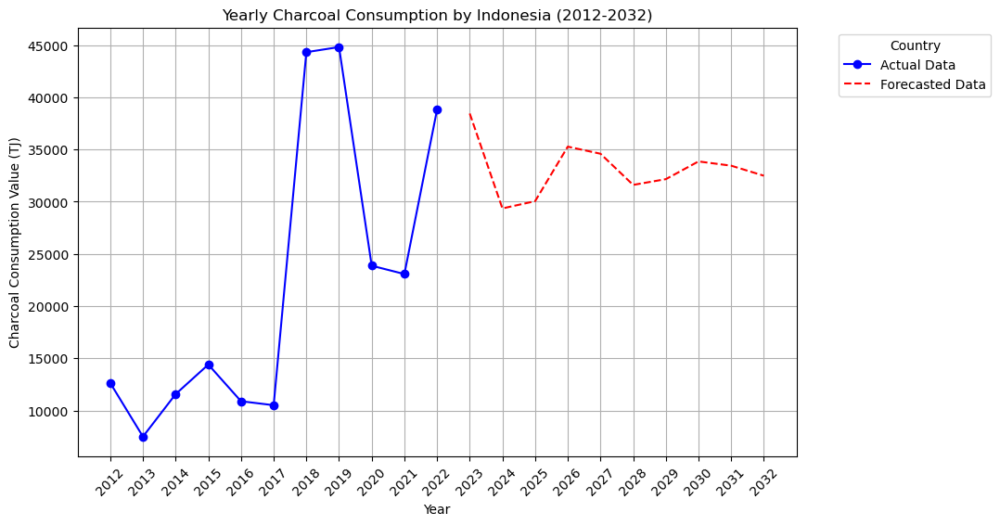

In [131]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_charcoal_indonesia_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_charcoal_indonesia_c.index) + forecast_index 

plt.figure(figsize=(10, 6))
plt.plot(df_charcoal_indonesia_c.index, df_charcoal_indonesia_c['Value'], label='Actual Data', color='blue', marker='o')
plt.plot(forecast_index, forecast_c, label='Forecasted Data', color='red', ls='--')
plt.xlabel('Year')
plt.ylabel('Charcoal Consumption Value (TJ)')
plt.title('Yearly Charcoal Consumption by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

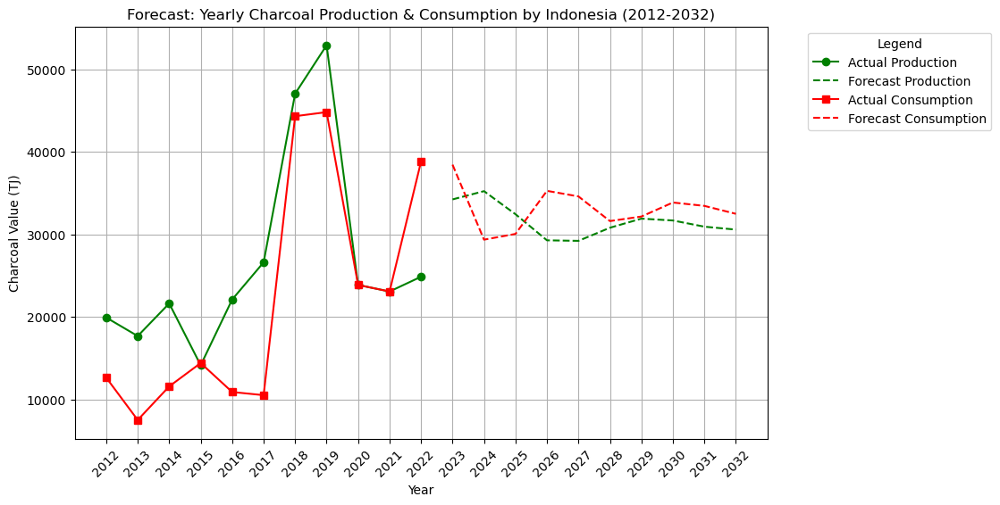

In [132]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_charcoal_indonesia.index, df_charcoal_indonesia['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_charcoal_indonesia_c.index, df_charcoal_indonesia_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Charcoal Value (TJ)')
plt.title('Forecast: Yearly Charcoal Production & Consumption by Indonesia (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_charcoal_indonesia.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Charcoal Forecast/Forecast of Yearly Charcoal Production & Consumption by Indonesia (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Fuelwood Production in India</B>

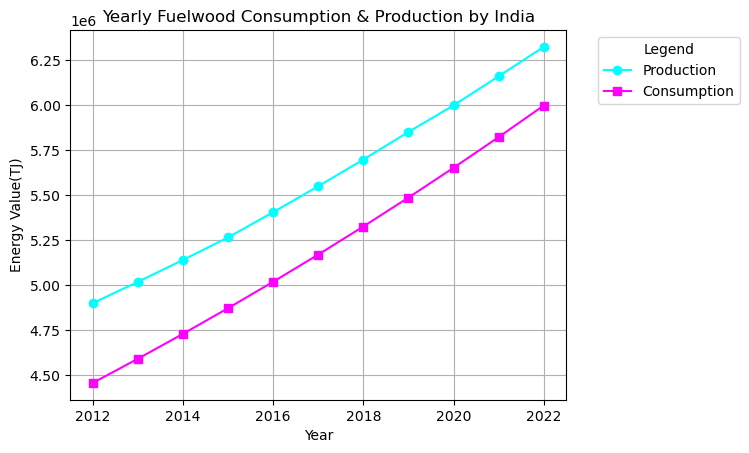

In [133]:
df_fuelwood_india = df_production[(df_production['Area'] == 'India') & (df_production['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_fuelwood_india_c = df_consumption[(df_consumption['Area'] == 'India') & (df_consumption['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_fuelwood_india.index, df_fuelwood_india.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_fuelwood_india_c.index, df_fuelwood_india_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Fuelwood Consumption & Production by India')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

<B>Rolling Statistics Test (Visual Inspection of Stationarity)

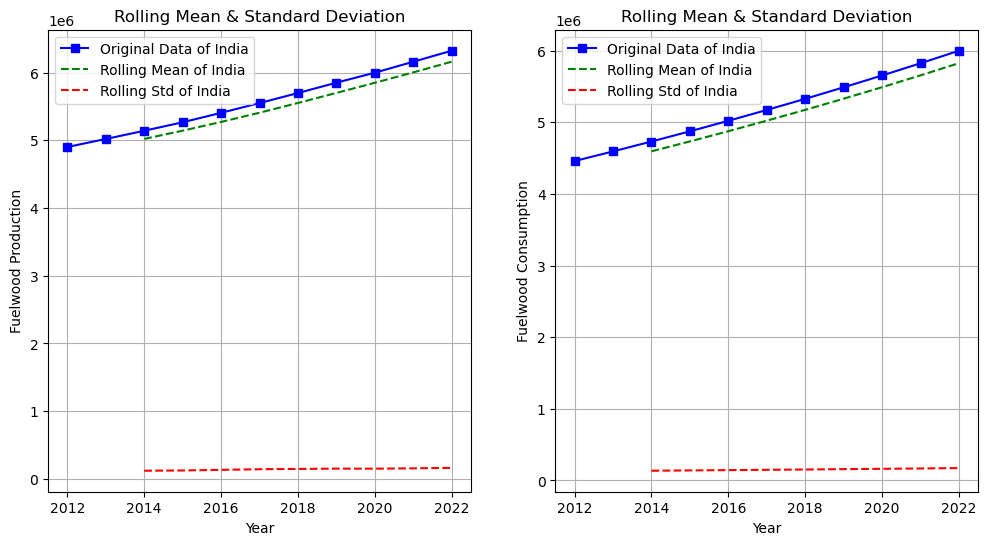

In [134]:
rolling_mean = df_fuelwood_india.rolling(window=3).mean()
rolling_std = df_fuelwood_india.rolling(window=3).std()
rolling_mean_c = df_fuelwood_india_c.rolling(window=3).mean()
rolling_std_c = df_fuelwood_india_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_fuelwood_india, label='Original Data of India', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of India', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of India', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Fuelwood Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_fuelwood_india_c, label='Original Data of India', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of India', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of India', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Fuelwood Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [135]:
adf_statistic = adfuller(df_fuelwood_india['Value'])[0]
p_value = adfuller(df_fuelwood_india['Value'])[1]
critical_points = adfuller(df_fuelwood_india['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 9.172345781616638
p-value: 1.0
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [136]:
df_fuelwood_india['Differenced Production'] = df_fuelwood_india['Value'].diff()
adf_statistic = adfuller(df_fuelwood_india['Differenced Production'].dropna())[0]
p_value = adfuller(df_fuelwood_india['Differenced Production'].dropna())[1]
critical_points = adfuller(df_fuelwood_india['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.919437944562341
p-value: 0.3229728610764759
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [137]:
df_fuelwood_india['Differenced Production 2'] = df_fuelwood_india['Differenced Production'].diff()
adf_statistic = adfuller(df_fuelwood_india['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_fuelwood_india['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_india['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.214448394643562
p-value: 0.000622760590561334
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

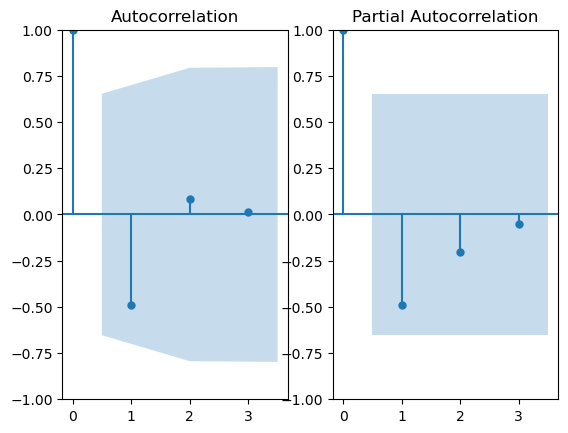

In [138]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_india['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_india['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [139]:
arima_1 = ARIMA(df_fuelwood_india['Value'], order=(0,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_india['Value'], order=(0,2,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_india['Value'], order=(1,2,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_india['Value'], order=(1,2,2))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 2, 1)   Log Likelihood                 -93.428
Date:                Tue, 25 Mar 2025   AIC                            190.857
Time:                        00:37:11   BIC                            191.251
Sample:                             0   HQIC                           190.006
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.0007      0.352     -0.002      0.998      -0.691       0.689
sigma2      4.829e+07      2e-09   2.42e+16      0.000    4.83e+07    4.83e+07
Ljung-Box (L1) (Q):                   2.38   Jarque-

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 1)   Log Likelihood                 -90.883
Date:                Tue, 25 Mar 2025   AIC                            187.766
Time:                        00:37:11   BIC                            188.358
Sample:                             0   HQIC                           186.489
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9469      0.076     12.383      0.000       0.797       1.097
ma.L1         -0.9945      0.686     -1.450      0.147      -2.339       0.350
sigma2      3.666e+07   1.95e-08   1.88e+15      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


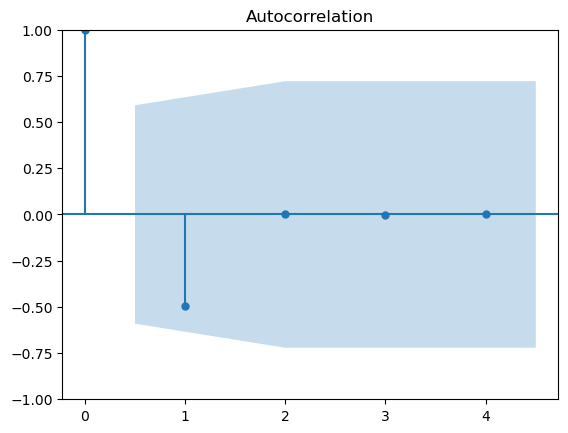

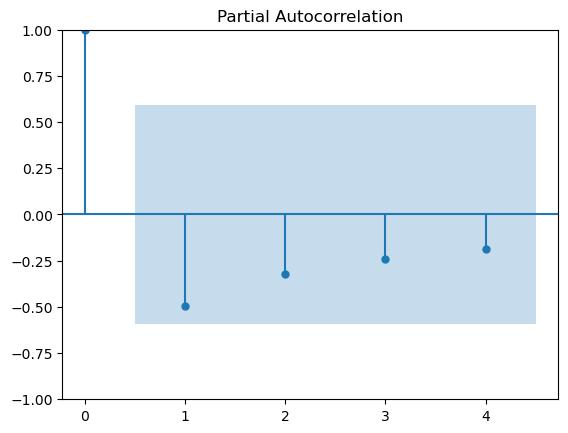

In [140]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


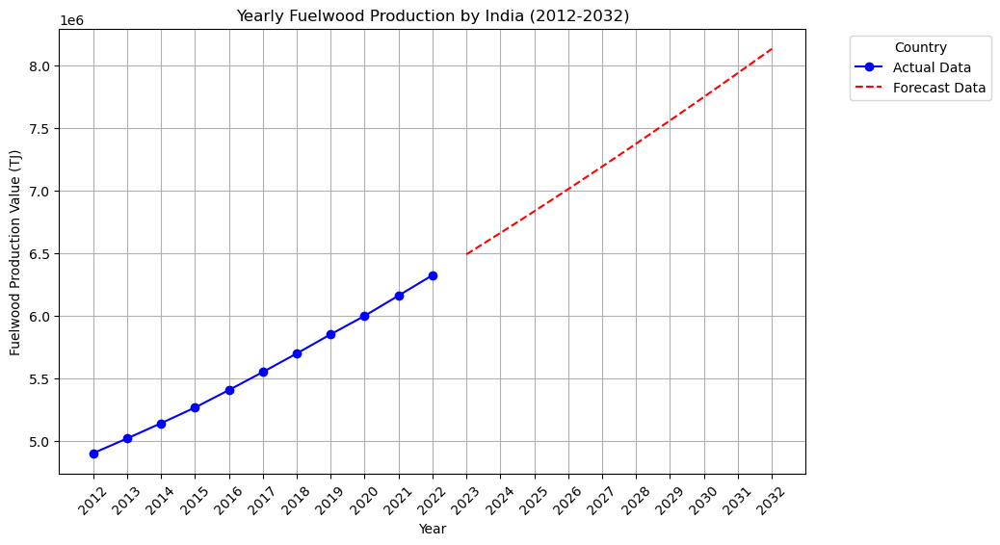

In [141]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_india.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_india.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_india.index ,df_fuelwood_india['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Production Value (TJ)')
plt.title('Yearly Fuelwood Production by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [142]:
adf_statistic = adfuller(df_fuelwood_india_c['Value'])[0]
p_value = adfuller(df_fuelwood_india_c['Value'])[1]
critical_points = adfuller(df_fuelwood_india_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 417.46618418951766
p-value: 1.0
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [143]:
df_fuelwood_india_c['Differenced Consumption'] = df_fuelwood_india_c['Value'].diff()

adf_statistic = adfuller(df_fuelwood_india_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_fuelwood_india_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_fuelwood_india_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 13.52778862671202
p-value: 1.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [144]:
df_fuelwood_india_c['Differenced Consumption 2'] = df_fuelwood_india_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_fuelwood_india_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_fuelwood_india_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_india_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.893423360915814
p-value: 0.7901304831729561
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing 3rd time the Consumption to convert non stationary data to stationary</B>

In [145]:
df_fuelwood_india_c['Differenced Consumption 3'] = df_fuelwood_india_c['Differenced Consumption 2'].diff()

adf_statistic = adfuller(df_fuelwood_india_c['Differenced Consumption 3'].dropna())[0]
p_value = adfuller(df_fuelwood_india_c['Differenced Consumption 3'].dropna())[1]
critical_points = adfuller(df_fuelwood_india_c['Differenced Consumption 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -18.895453555077147
p-value: 0.0
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 3 (d=3)

<B>ACF and PACF PLOTS</B>

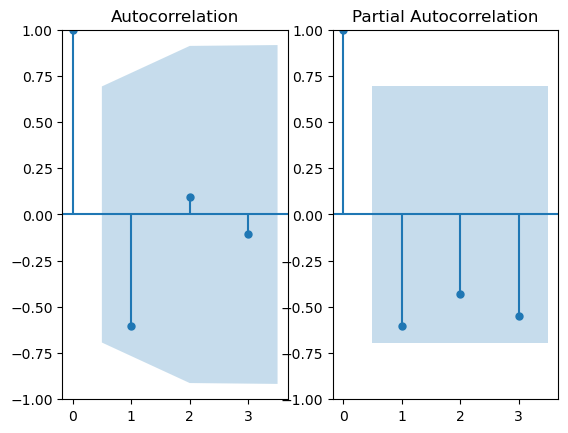

In [146]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_india_c['Differenced Consumption 3'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_india_c['Differenced Consumption 3'].dropna(), ax=ax[1], lags=3)
plt.show()

In [147]:
arima_1 = ARIMA(df_fuelwood_india_c['Value'], order=(1,3,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_india_c['Value'], order=(1,3,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_india_c['Value'], order=(2,3,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_india_c['Value'], order=(2,3,0))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 3, 1)   Log Likelihood                 -56.352
Date:                Tue, 25 Mar 2025   AIC                            118.703
Time:                        00:37:13   BIC                            118.941
Sample:                             0   HQIC                           117.096
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0004    768.564   4.75e-07      1.000   -1506.358    1506.359
ma.L1          0.0004    768.565   4.62e-07      1.000   -1506.359    1506.360
sigma2      1.036e+05   1.32e+05      0.784      0.4

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


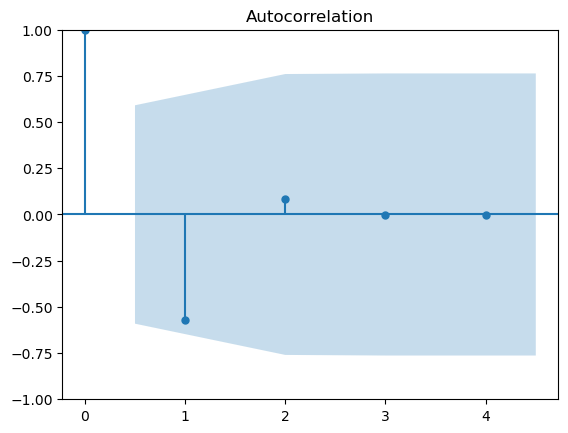

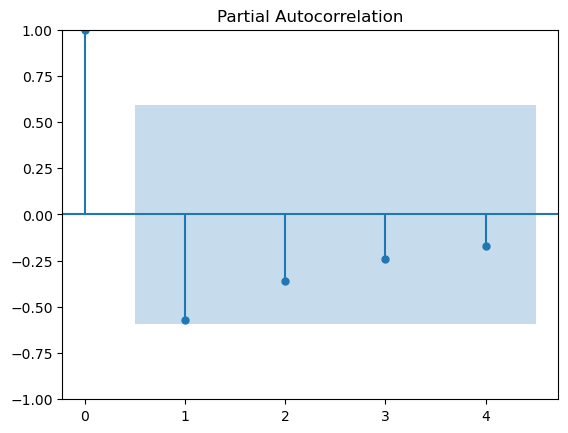

In [148]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


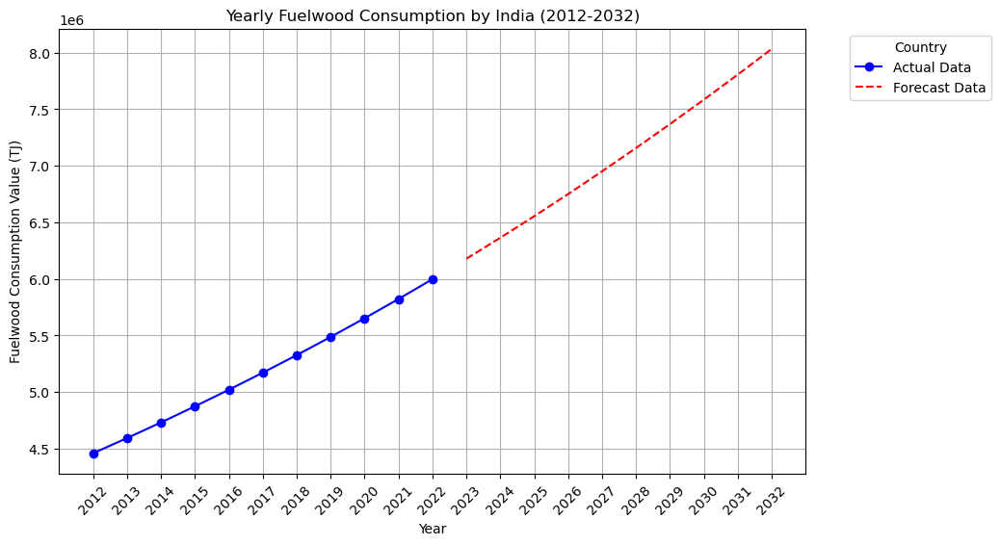

In [149]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_india_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_india_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_india_c.index ,df_fuelwood_india_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Consumption Value (TJ)')
plt.title('Yearly Fuelwood Consumption by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY FUELWOOD PRODUCTION AND CONSUMPTION IN INDIA FORECAST

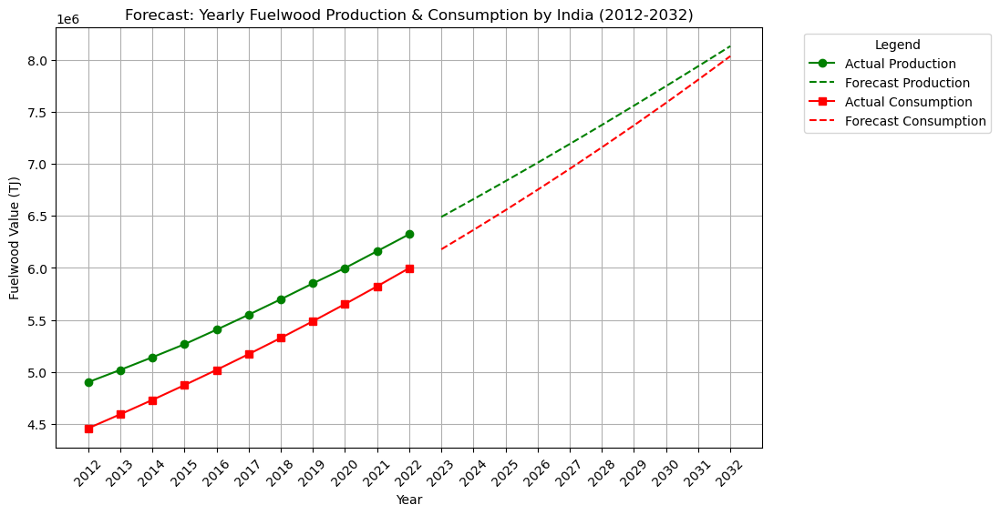

In [150]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_fuelwood_india.index, df_fuelwood_india['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_fuelwood_india_c.index, df_fuelwood_india_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Fuelwood Value (TJ)')
plt.title('Forecast: Yearly Fuelwood Production & Consumption by India (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_fuelwood_india.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Fuelwood Forecast/Forecast of Yearly Fuelwood Production & Consumption by India (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Fuelwood Production in China, mainland</B>

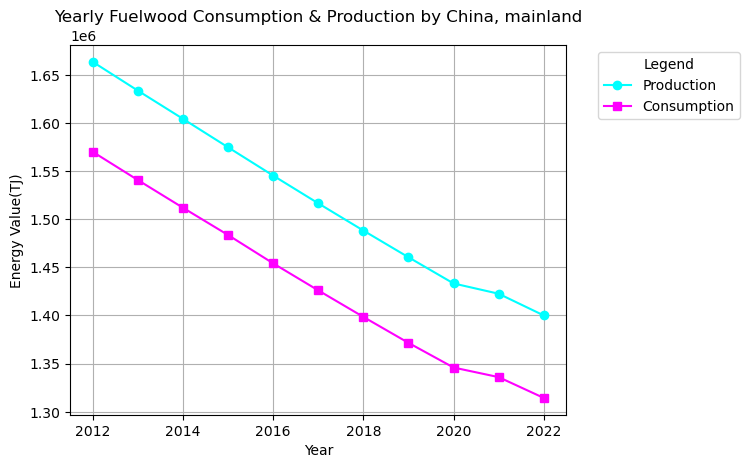

In [151]:
df_fuelwood_china = df_production[(df_production['Area'] == 'China, mainland') & (df_production['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_fuelwood_china_c = df_consumption[(df_consumption['Area'] == 'China, mainland') & (df_consumption['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_fuelwood_china.index, df_fuelwood_china.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_fuelwood_china_c.index, df_fuelwood_china_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Fuelwood Consumption & Production by China, mainland')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

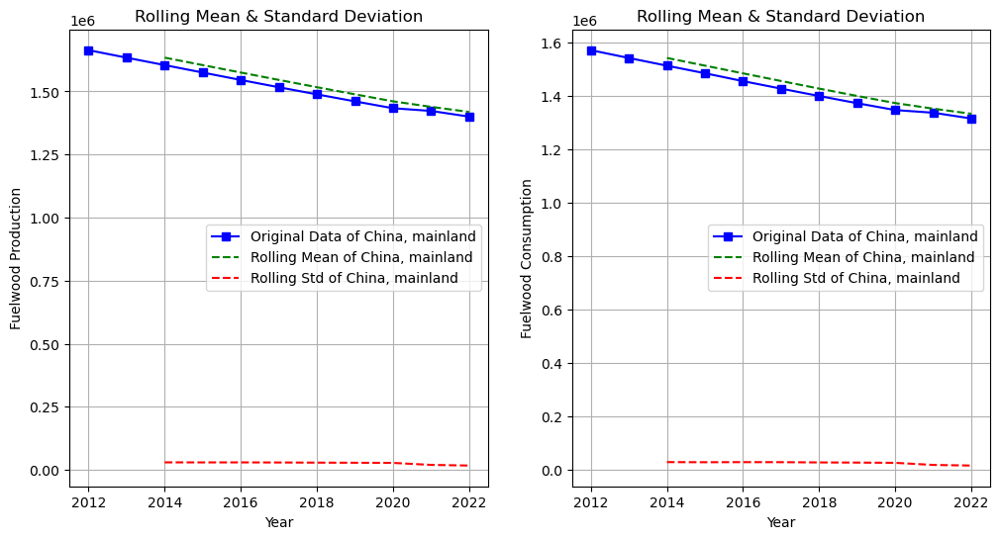

In [152]:
rolling_mean = df_fuelwood_china.rolling(window=3).mean()
rolling_std = df_fuelwood_china.rolling(window=3).std()
rolling_mean_c = df_fuelwood_china_c.rolling(window=3).mean()
rolling_std_c = df_fuelwood_china_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_fuelwood_china, label='Original Data of China, mainland', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of China, mainland', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Fuelwood Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_fuelwood_china_c, label='Original Data of China, mainland', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of China, mainland', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Fuelwood Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [153]:
adf_statistic = adfuller(df_fuelwood_china['Value'])[0]
p_value = adfuller(df_fuelwood_china['Value'])[1]
critical_points = adfuller(df_fuelwood_china['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.514861490765044
p-value: 0.11190010964475033
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [154]:
df_fuelwood_china['Differenced Production'] = df_fuelwood_china['Value'].diff()
adf_statistic = adfuller(df_fuelwood_china['Differenced Production'].dropna())[0]
p_value = adfuller(df_fuelwood_china['Differenced Production'].dropna())[1]
critical_points = adfuller(df_fuelwood_china['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 2.316824438339482
p-value: 0.9989656238320457
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [155]:
df_fuelwood_china['Differenced Production 2'] = df_fuelwood_china['Differenced Production'].diff()
adf_statistic = adfuller(df_fuelwood_china['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_fuelwood_china['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_china['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.609755563017036
p-value: 0.00012392595971826825
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

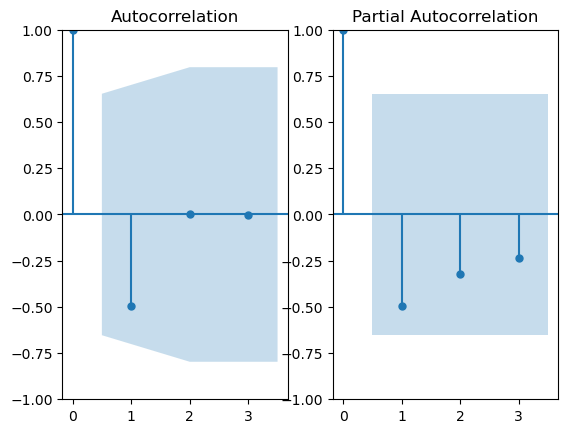

In [156]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_china['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_china['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [157]:
arima_1 = ARIMA(df_fuelwood_china['Value'], order=(0,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_china['Value'], order=(1,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_china['Value'], order=(2,2,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_china['Value'], order=(3,2,1))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 2, 1)   Log Likelihood                -128.702
Date:                Tue, 25 Mar 2025   AIC                            261.405
Time:                        00:37:17   BIC                            261.799
Sample:                             0   HQIC                           260.554
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -1.0000      0.276     -3.623      0.000      -1.541      -0.459
sigma2      3.488e+10   7.91e-12   4.41e+21      0.000    3.49e+10    3.49e+10
Ljung-Box (L1) (Q):                   4.26   Jarque-

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as star

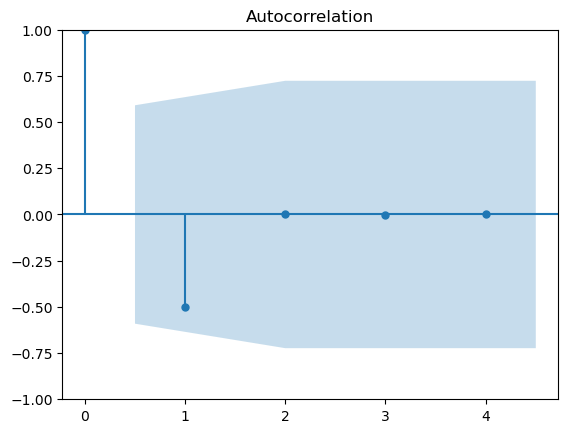

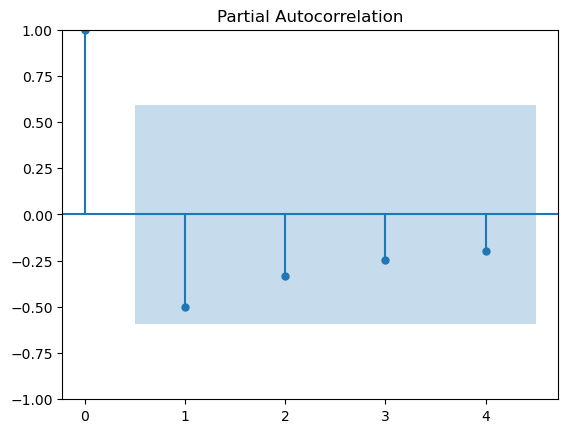

In [158]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


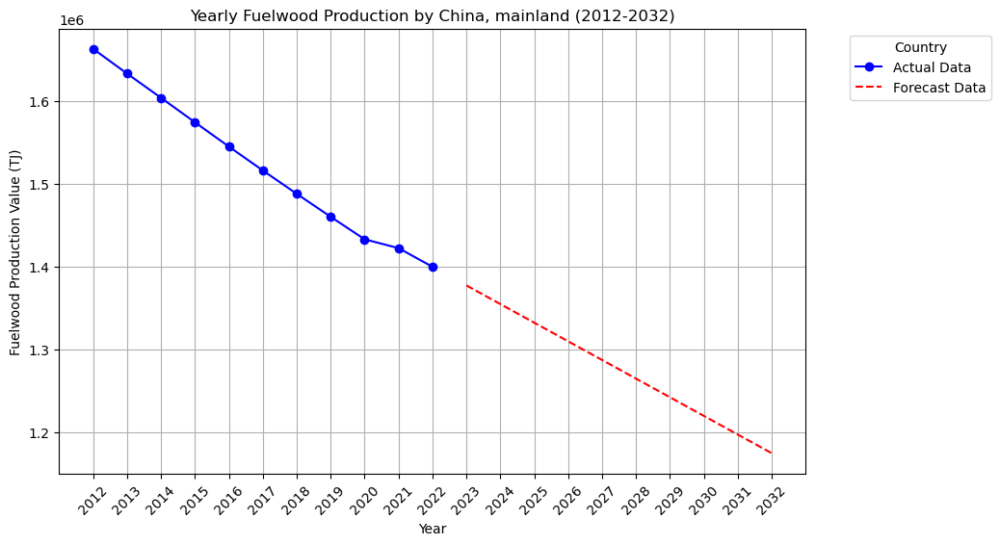

In [159]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_china.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_china.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_china.index ,df_fuelwood_china['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Production Value (TJ)')
plt.title('Yearly Fuelwood Production by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [160]:
adf_statistic = adfuller(df_fuelwood_china_c['Value'])[0]
p_value = adfuller(df_fuelwood_china_c['Value'])[1]
critical_points = adfuller(df_fuelwood_china_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.654405592162008
p-value: 0.08226580868025757
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [161]:
df_fuelwood_china_c['Differenced Consumption'] = df_fuelwood_china_c['Value'].diff()

adf_statistic = adfuller(df_fuelwood_china_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_fuelwood_china_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_fuelwood_china_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 46.70376094454128
p-value: 1.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [162]:
df_fuelwood_china_c['Differenced Consumption 2'] = df_fuelwood_china_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_fuelwood_china_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_fuelwood_china_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_china_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.387072695046683
p-value: 0.0003128658702668711
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

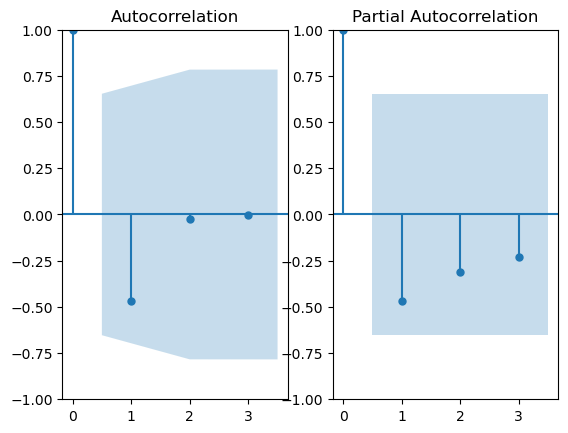

In [163]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_china_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_china_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [164]:
arima_1 = ARIMA(df_fuelwood_china_c['Value'], order=(0,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_china_c['Value'], order=(1,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_china_c['Value'], order=(2,2,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_china_c['Value'], order=(3,2,1))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 2, 1)   Log Likelihood                 -91.984
Date:                Tue, 25 Mar 2025   AIC                            187.968
Time:                        00:37:19   BIC                            188.363
Sample:                             0   HQIC                           187.117
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.0004      0.217     -0.002      0.998      -0.425       0.425
sigma2      5.481e+07   6.25e-10   8.77e+16      0.000    5.48e+07    5.48e+07
Ljung-Box (L1) (Q):                   2.67   Jarque-

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was

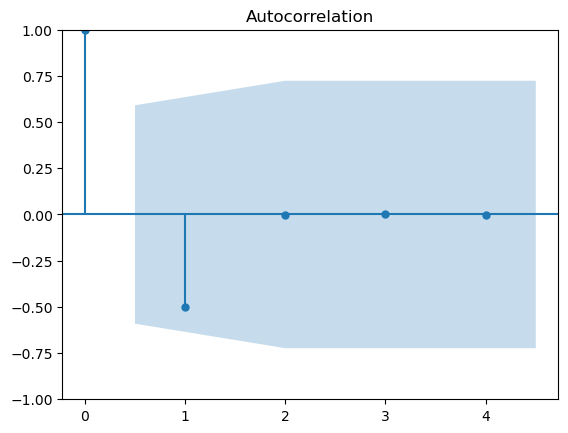

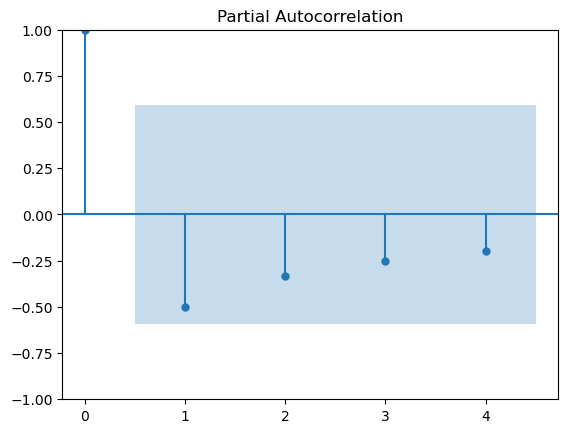

In [165]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


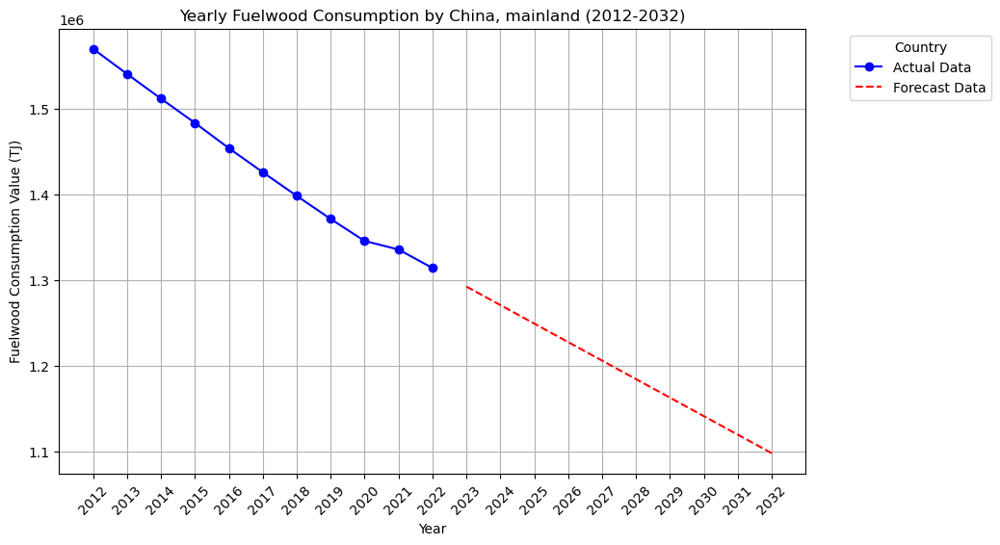

In [166]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_china_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_china_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_china_c.index ,df_fuelwood_china_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Consumption Value (TJ)')
plt.title('Yearly Fuelwood Consumption by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY FUELWOOD PRODUCTION AND CONSUMPTION IN CHINA, MAINLAND FORECAST

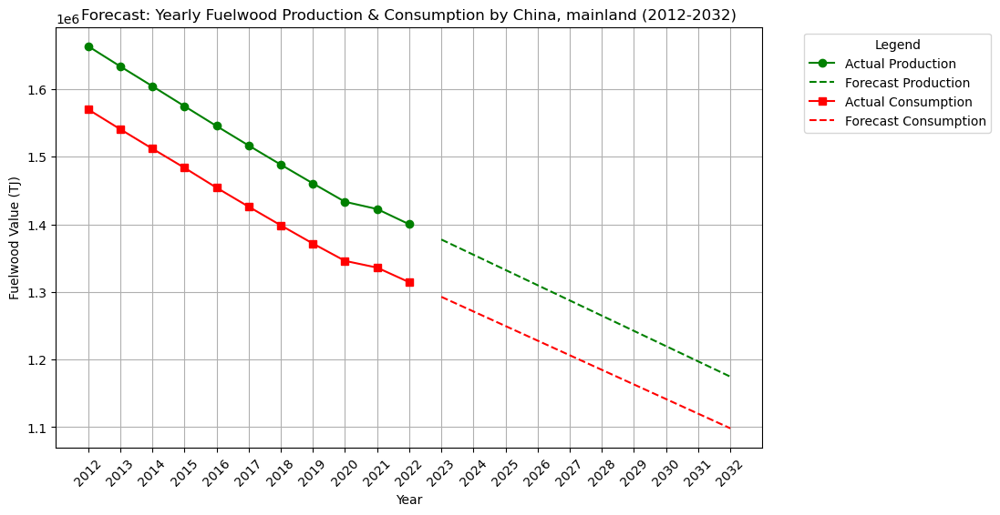

In [167]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_fuelwood_china.index, df_fuelwood_china['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_fuelwood_china_c.index, df_fuelwood_china_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Fuelwood Value (TJ)')
plt.title('Forecast: Yearly Fuelwood Production & Consumption by China, mainland (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_fuelwood_china.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Fuelwood Forecast/Forecast of Yearly Fuelwood Production & Consumption by China, mainland (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Fuelwood Production in Indonesia</B>

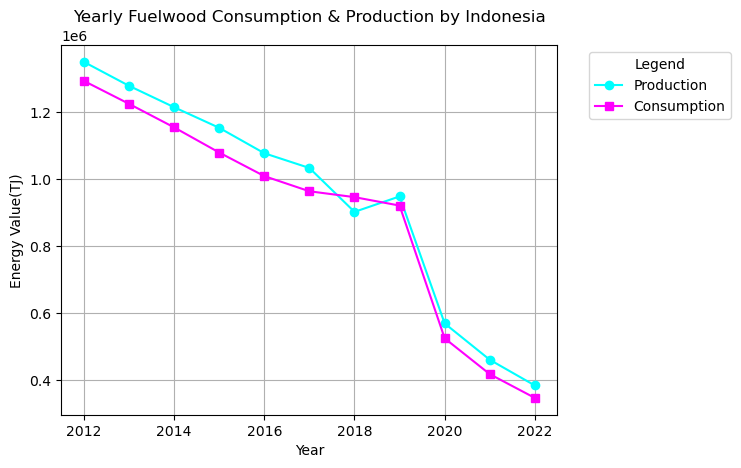

In [168]:
df_fuelwood_indonesia = df_production[(df_production['Area'] == 'Indonesia') & (df_production['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_fuelwood_indonesia_c = df_consumption[(df_consumption['Area'] == 'Indonesia') & (df_consumption['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_fuelwood_indonesia.index, df_fuelwood_indonesia.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_fuelwood_indonesia_c.index, df_fuelwood_indonesia_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Fuelwood Consumption & Production by Indonesia')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

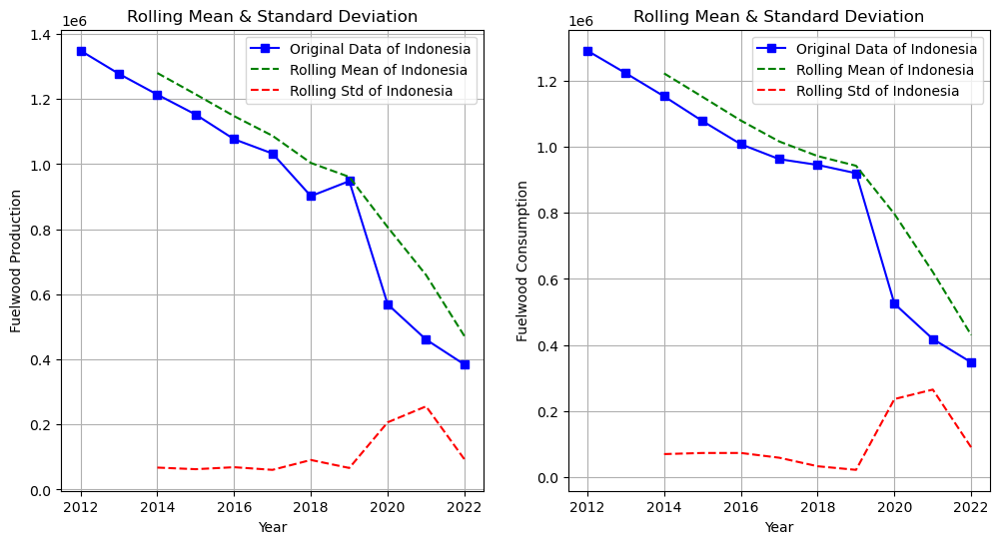

In [169]:
rolling_mean = df_fuelwood_indonesia.rolling(window=3).mean()
rolling_std = df_fuelwood_indonesia.rolling(window=3).std()
rolling_mean_c = df_fuelwood_indonesia_c.rolling(window=3).mean()
rolling_std_c = df_fuelwood_indonesia_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_fuelwood_indonesia, label='Original Data of Indonesia', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Indonesia', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Fuelwood Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_fuelwood_indonesia_c, label='Original Data of Indonesia', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Indonesia', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Fuelwood Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [170]:
adf_statistic = adfuller(df_fuelwood_indonesia['Value'])[0]
p_value = adfuller(df_fuelwood_indonesia['Value'])[1]
critical_points = adfuller(df_fuelwood_indonesia['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.2009905219057462
p-value: 0.9959927195841318
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [171]:
df_fuelwood_indonesia['Differenced Production'] = df_fuelwood_indonesia['Value'].diff()
adf_statistic = adfuller(df_fuelwood_indonesia['Differenced Production'].dropna())[0]
p_value = adfuller(df_fuelwood_indonesia['Differenced Production'].dropna())[1]
critical_points = adfuller(df_fuelwood_indonesia['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 2.416043631027754
p-value: 0.9990176609665289
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [172]:
df_fuelwood_indonesia['Differenced Production 2'] = df_fuelwood_indonesia['Differenced Production'].diff()
adf_statistic = adfuller(df_fuelwood_indonesia['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_fuelwood_indonesia['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_indonesia['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.292440098435405
p-value: 0.9965662703009827
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 3rd time the Production to convert non stationary data to stationary</B>

In [173]:
df_fuelwood_indonesia['Differenced Production 3'] = df_fuelwood_indonesia['Differenced Production 2'].diff()
adf_statistic = adfuller(df_fuelwood_indonesia['Differenced Production 3'].dropna())[0]
p_value = adfuller(df_fuelwood_indonesia['Differenced Production 3'].dropna())[1]
critical_points = adfuller(df_fuelwood_indonesia['Differenced Production 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.947917154321389
p-value: 2.8109815243079033e-05
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 3 (d=3)

<B>ACF and PACF PLOTS</B>

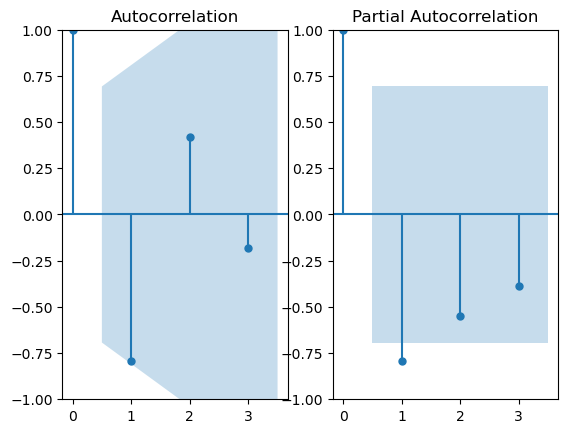

In [174]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_indonesia['Differenced Production 3'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_indonesia['Differenced Production 3'].dropna(), ax=ax[1], lags=3)
plt.show()

In [175]:
arima_1 = ARIMA(df_fuelwood_indonesia['Value'], order=(1,3,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_indonesia['Value'], order=(1,3,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 3, 1)   Log Likelihood                -106.969
Date:                Tue, 25 Mar 2025   AIC                            219.937
Time:                        00:37:23   BIC                            220.175
Sample:                             0   HQIC                           218.330
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.6693      0.291     -2.303      0.021      -1.239      -0.100
ma.L1         -0.9618      0.675     -1.424      0.154      -2.286       0.362
sigma2      2.604e+10   2.87e-11   9.09e+20      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. foreca

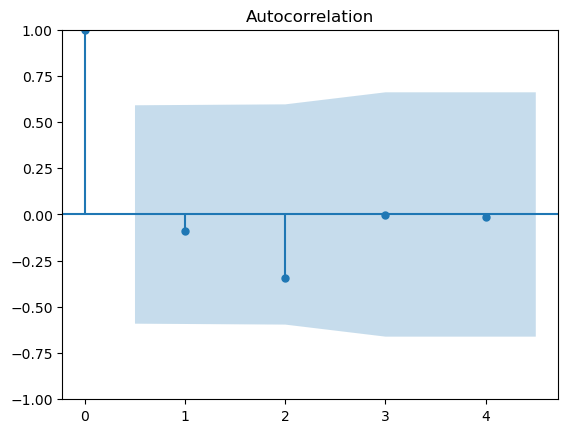

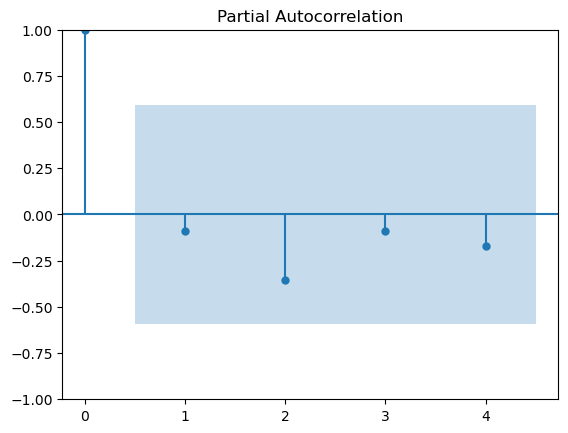

In [176]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


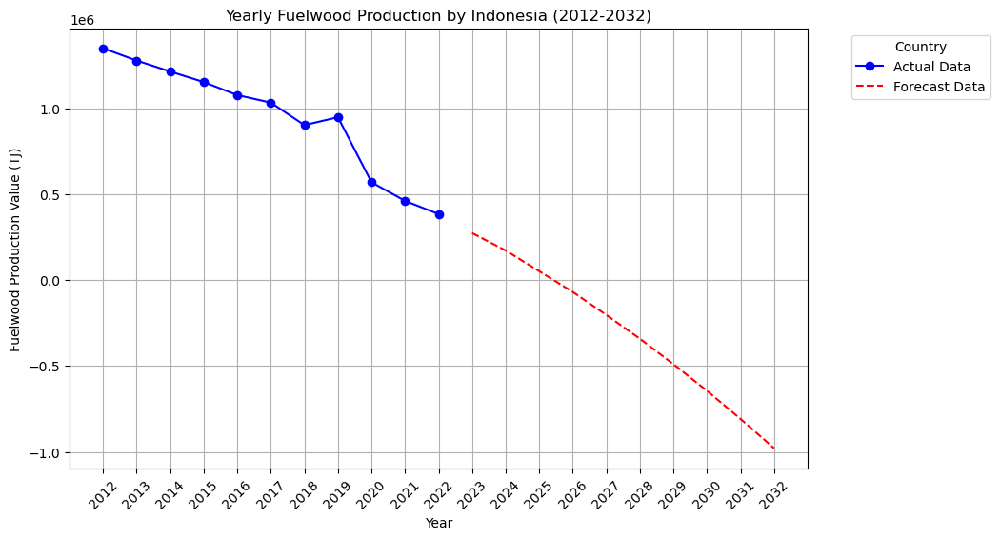

In [177]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_indonesia.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_indonesia.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_indonesia.index ,df_fuelwood_indonesia['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Production Value (TJ)')
plt.title('Yearly Fuelwood Production by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [178]:
adf_statistic = adfuller(df_fuelwood_indonesia_c['Value'])[0]
p_value = adfuller(df_fuelwood_indonesia_c['Value'])[1]
critical_points = adfuller(df_fuelwood_indonesia_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.7420415201846475
p-value: 0.40959186594564123
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [179]:
df_fuelwood_indonesia_c['Differenced Consumption'] = df_fuelwood_indonesia_c['Value'].diff()

adf_statistic = adfuller(df_fuelwood_indonesia_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_fuelwood_indonesia_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_fuelwood_indonesia_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.344509767067754
p-value: 0.6085712001055438
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [180]:
df_fuelwood_indonesia_c['Differenced Consumption 2'] = df_fuelwood_indonesia_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_fuelwood_indonesia_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_fuelwood_indonesia_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_indonesia_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.759641760730208
p-value: 6.49251065011715e-05
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

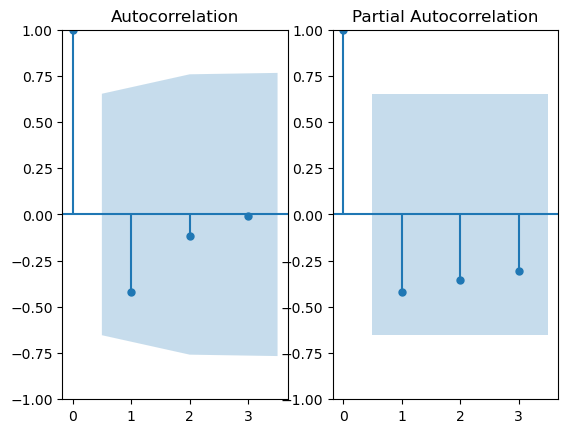

In [181]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_indonesia_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_indonesia_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [182]:
arima_1 = ARIMA(df_fuelwood_indonesia_c['Value'], order=(0,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_indonesia_c['Value'], order=(0,2,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_indonesia_c['Value'], order=(1,2,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_indonesia_c['Value'], order=(2,2,0))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 2, 1)   Log Likelihood                -120.392
Date:                Tue, 25 Mar 2025   AIC                            244.783
Time:                        00:37:25   BIC                            245.178
Sample:                             0   HQIC                           243.932
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.0516      0.186     -0.278      0.781      -0.415       0.312
sigma2      2.439e+10   1.46e-12   1.67e+22      0.000    2.44e+10    2.44e+10
Ljung-Box (L1) (Q):                   1.82   Jarque-

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

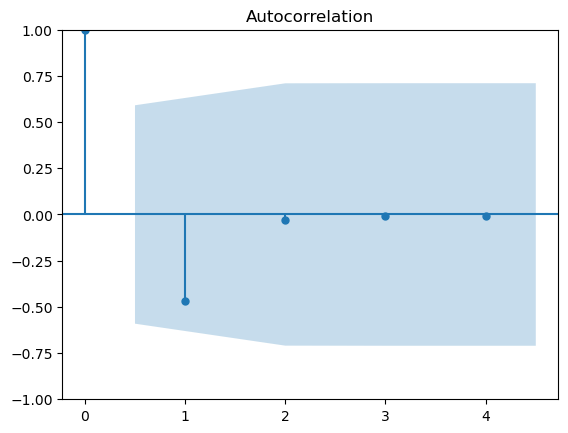

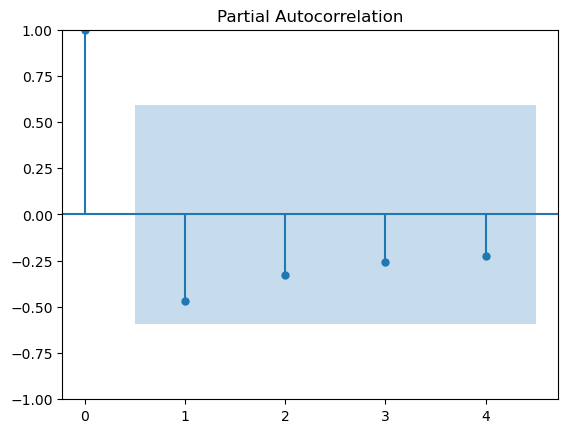

In [183]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


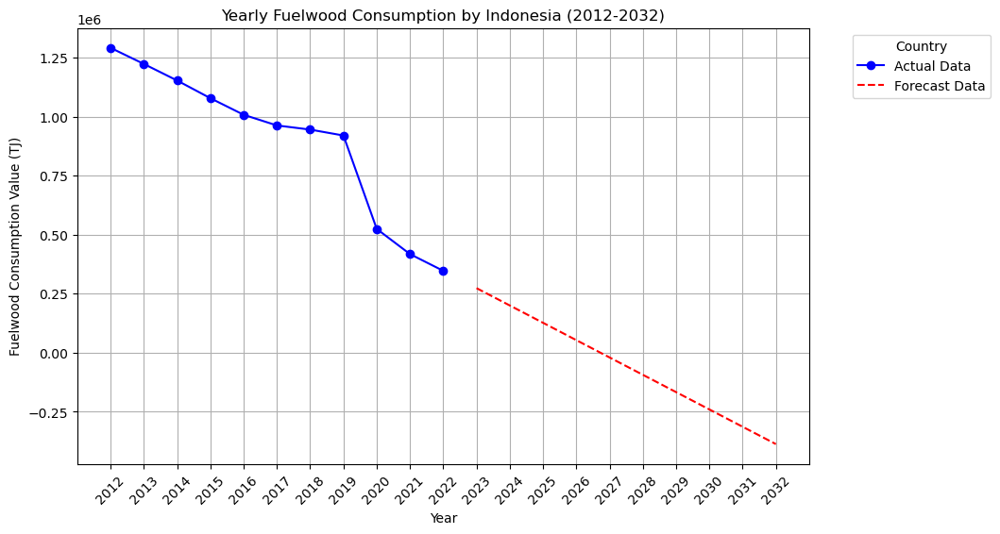

In [184]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_indonesia_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_indonesia_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_indonesia_c.index ,df_fuelwood_indonesia_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Consumption Value (TJ)')
plt.title('Yearly Fuelwood Consumption by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY FUELWOOD PRODUCTION AND CONSUMPTION IN INDONESIA FORECAST

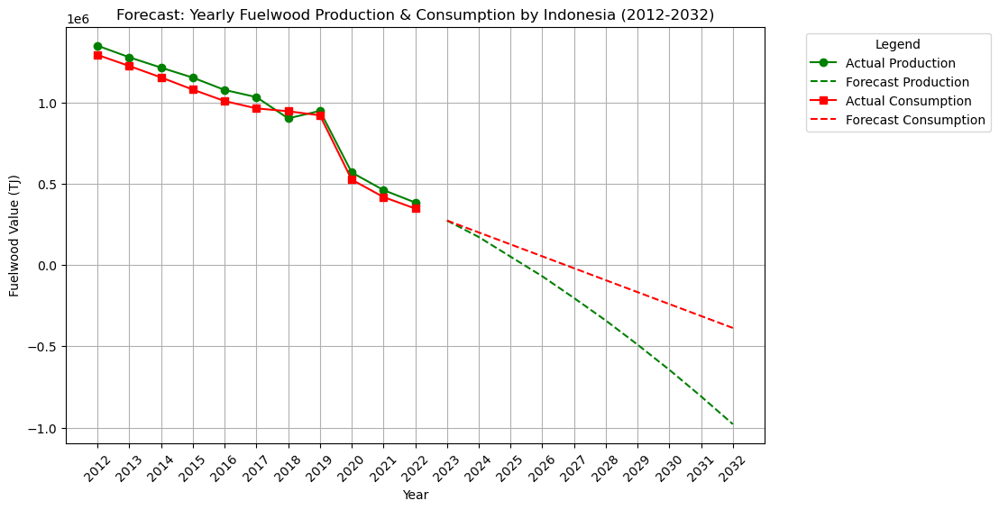

In [185]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_fuelwood_indonesia.index, df_fuelwood_indonesia['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_fuelwood_indonesia_c.index, df_fuelwood_indonesia_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Fuelwood Value (TJ)')
plt.title('Forecast: Yearly Fuelwood Production & Consumption by Indonesia (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_fuelwood_indonesia.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Fuelwood Forecast/Forecast of Yearly Fuelwood Production & Consumption by Indonesia (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Fuelwood Production in Vietnam</B>

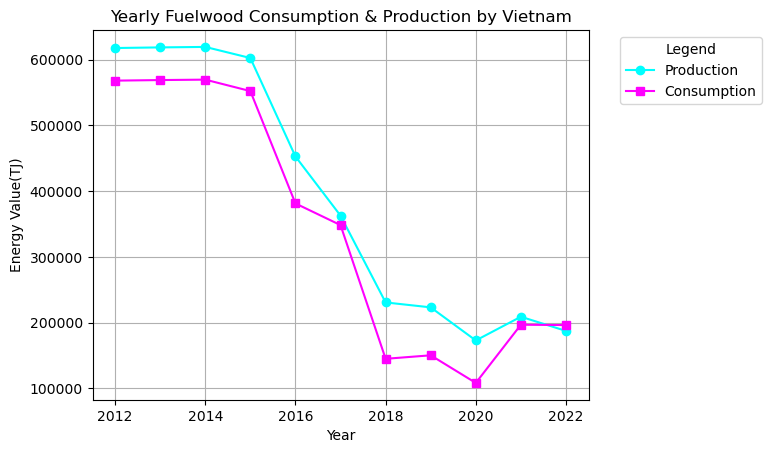

In [186]:
df_fuelwood_vietnam = df_production[(df_production['Area'] == 'Vietnam') & (df_production['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_fuelwood_vietnam_c = df_consumption[(df_consumption['Area'] == 'Vietnam') & (df_consumption['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_fuelwood_vietnam.index, df_fuelwood_vietnam.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_fuelwood_vietnam_c.index, df_fuelwood_vietnam_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Fuelwood Consumption & Production by Vietnam')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

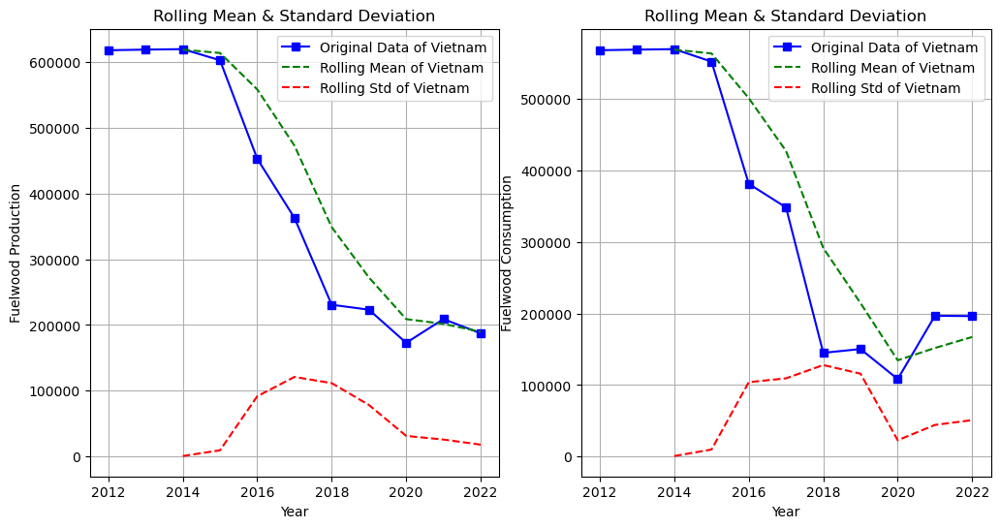

In [187]:
rolling_mean = df_fuelwood_vietnam.rolling(window=3).mean()
rolling_std = df_fuelwood_vietnam.rolling(window=3).std()
rolling_mean_c = df_fuelwood_vietnam_c.rolling(window=3).mean()
rolling_std_c = df_fuelwood_vietnam_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_fuelwood_vietnam, label='Original Data of Vietnam', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Vietnam', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Vietnam', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Fuelwood Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_fuelwood_vietnam_c, label='Original Data of Vietnam', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Vietnam', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Vietnam', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Fuelwood Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [188]:
adf_statistic = adfuller(df_fuelwood_vietnam['Value'])[0]
p_value = adfuller(df_fuelwood_vietnam['Value'])[1]
critical_points = adfuller(df_fuelwood_vietnam['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -11.239527447446061
p-value: 1.821675456520448e-20
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

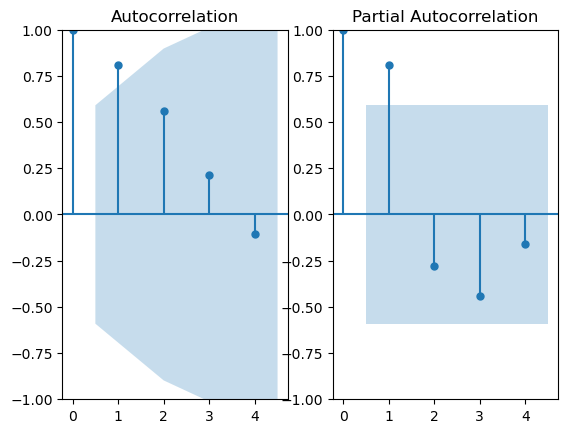

In [189]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_vietnam['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_fuelwood_vietnam['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [190]:
arima_1 = ARIMA(df_fuelwood_vietnam['Value'], order=(1,0,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_vietnam['Value'], order=(1,0,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_vietnam['Value'], order=(0,0,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_vietnam['Value'], order=(1,0,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -139.302
Date:                Tue, 25 Mar 2025   AIC                            286.605
Time:                        00:37:29   BIC                            288.196
Sample:                             0   HQIC                           285.602
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       3.906e+05   1.89e+05      2.064      0.039    1.98e+04    7.61e+05
ar.L1          0.8885      0.273      3.249      0.001       0.353       1.424
ma.L1          0.2565      0.845      0.304      0.7

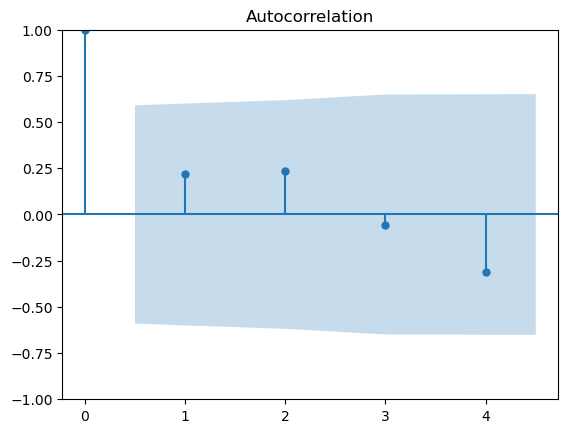

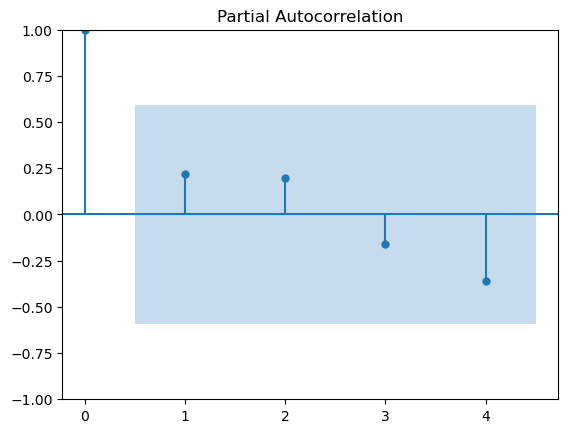

In [191]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


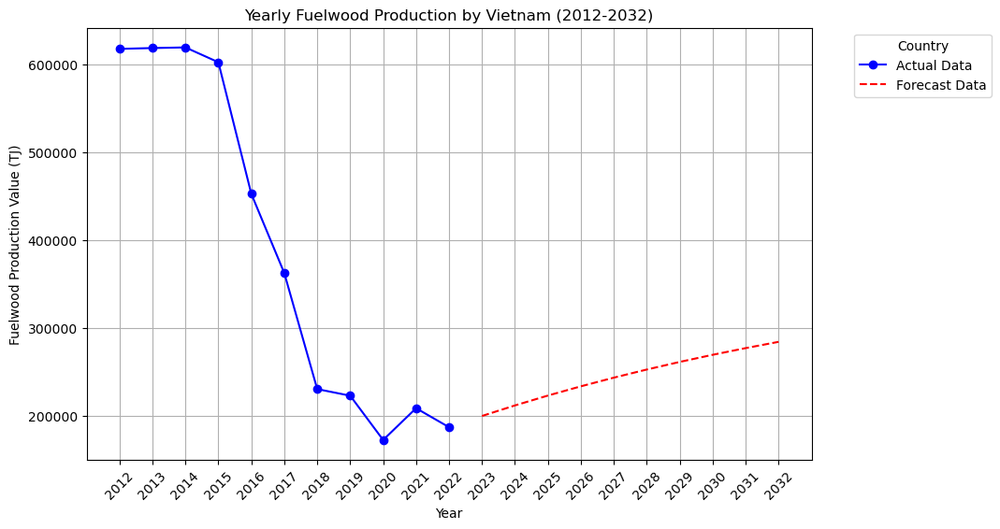

In [192]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_vietnam.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_vietnam.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_vietnam.index ,df_fuelwood_vietnam['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Production Value (TJ)')
plt.title('Yearly Fuelwood Production by Vietnam (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [193]:
adf_statistic = adfuller(df_fuelwood_vietnam_c['Value'])[0]
p_value = adfuller(df_fuelwood_vietnam_c['Value'])[1]
critical_points = adfuller(df_fuelwood_vietnam_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.4109193405886256
p-value: 0.01059221673198914
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

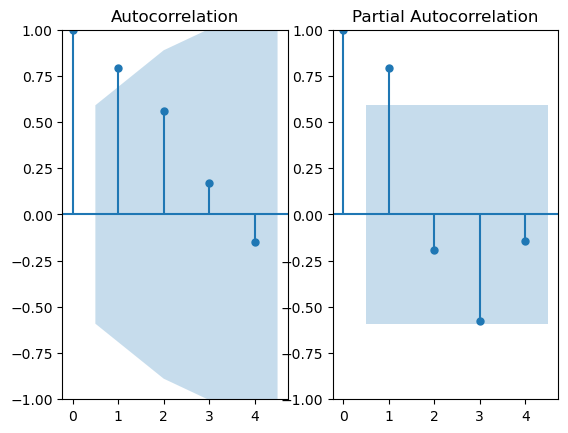

In [194]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_vietnam_c['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_fuelwood_vietnam_c['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [195]:
arima_1 = ARIMA(df_fuelwood_vietnam_c['Value'], order=(1,0,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_vietnam_c['Value'], order=(1,0,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_vietnam_c['Value'], order=(0,0,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_vietnam_c['Value'], order=(1,0,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -141.633
Date:                Tue, 25 Mar 2025   AIC                            291.265
Time:                        00:37:31   BIC                            292.857
Sample:                             0   HQIC                           290.262
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       3.441e+05   1.57e+05      2.188      0.029    3.58e+04    6.52e+05
ar.L1          0.8485      0.340      2.493      0.013       0.181       1.516
ma.L1          0.0860      1.894      0.045      0.9

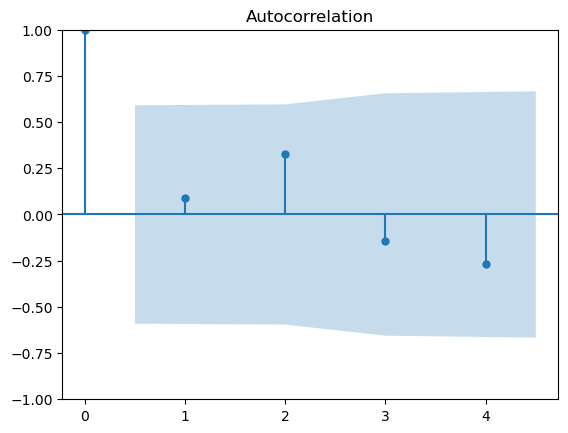

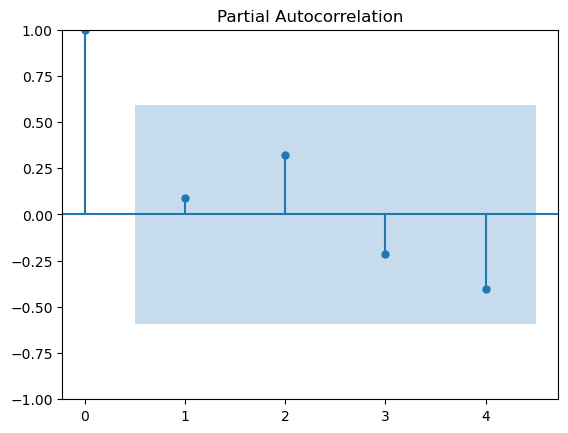

In [196]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


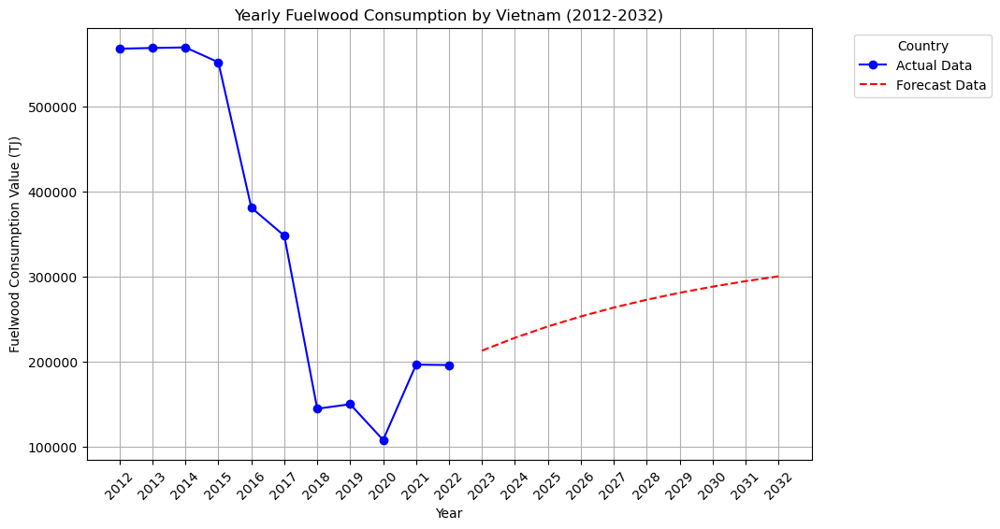

In [197]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_vietnam_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_vietnam_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_vietnam_c.index ,df_fuelwood_vietnam_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Consumption Value (TJ)')
plt.title('Yearly Fuelwood Consumption by Vietnam (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY FUELWOOD PRODUCTION AND CONSUMPTION IN VIETNAM FORECAST

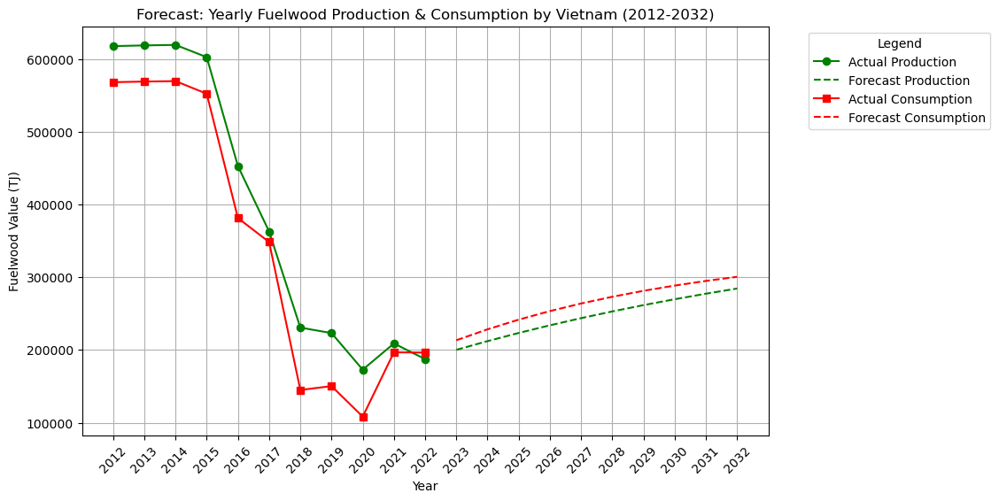

In [198]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_fuelwood_vietnam.index, df_fuelwood_vietnam['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_fuelwood_vietnam_c.index, df_fuelwood_vietnam_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Fuelwood Value (TJ)')
plt.title('Forecast: Yearly Fuelwood Production & Consumption by Vietnam (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_fuelwood_vietnam.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Fuelwood Forecast/Forecast of Yearly Fuelwood Production & Consumption by Vietnam (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Fuelwood Production in Nepal</B>

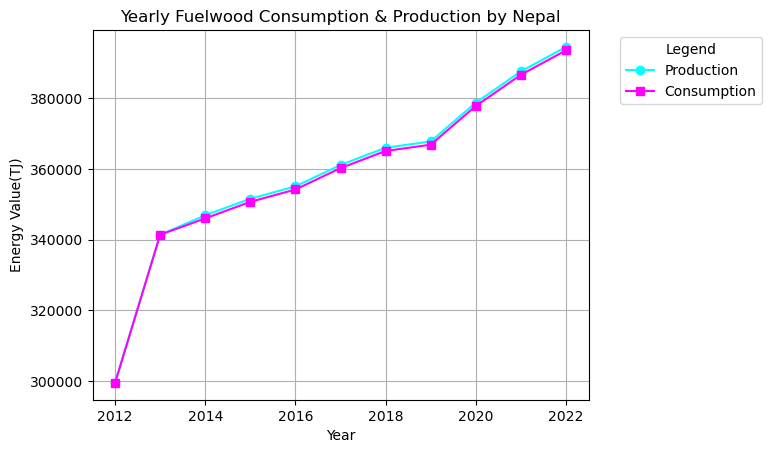

In [199]:
df_fuelwood_nepal = df_production[(df_production['Area'] == 'Nepal') & (df_production['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_fuelwood_nepal_c = df_consumption[(df_consumption['Area'] == 'Nepal') & (df_consumption['Item'] == 'Fuelwood')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_fuelwood_nepal.index, df_fuelwood_nepal.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_fuelwood_nepal_c.index, df_fuelwood_nepal_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Fuelwood Consumption & Production by Nepal')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

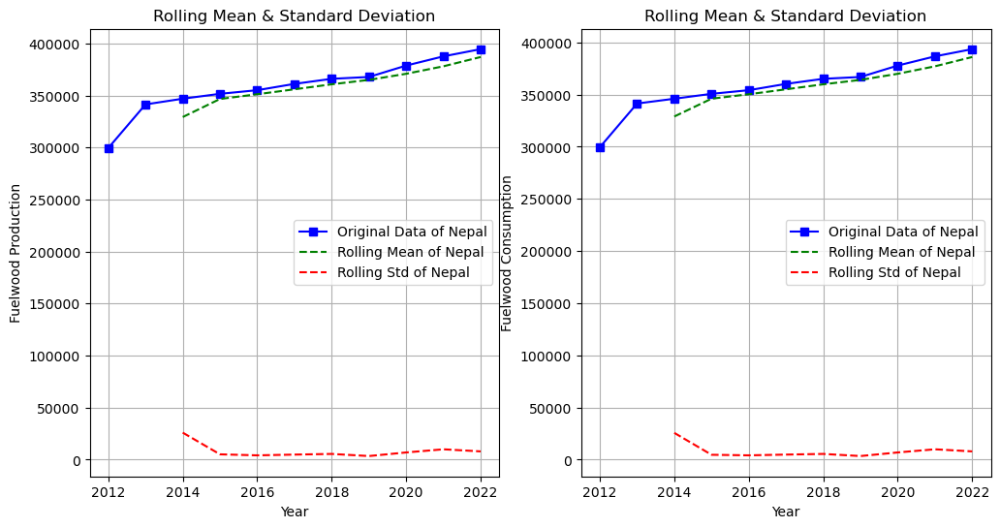

In [200]:
rolling_mean = df_fuelwood_nepal.rolling(window=3).mean()
rolling_std = df_fuelwood_nepal.rolling(window=3).std()
rolling_mean_c = df_fuelwood_nepal_c.rolling(window=3).mean()
rolling_std_c = df_fuelwood_nepal_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_fuelwood_nepal, label='Original Data of Nepal', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Nepal', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Nepal', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Fuelwood Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_fuelwood_nepal_c, label='Original Data of Nepal', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Nepal', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Nepal', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Fuelwood Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [201]:
adf_statistic = adfuller(df_fuelwood_nepal['Value'])[0]
p_value = adfuller(df_fuelwood_nepal['Value'])[1]
critical_points = adfuller(df_fuelwood_nepal['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.1645760869005595
p-value: 0.995731762242
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [202]:
df_fuelwood_nepal['Differenced Production'] = df_fuelwood_nepal['Value'].diff()
adf_statistic = adfuller(df_fuelwood_nepal['Differenced Production'].dropna())[0]
p_value = adfuller(df_fuelwood_nepal['Differenced Production'].dropna())[1]
critical_points = adfuller(df_fuelwood_nepal['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 36.71637670033277
p-value: 1.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [203]:
df_fuelwood_nepal['Differenced Production 2'] = df_fuelwood_nepal['Differenced Production'].diff()
adf_statistic = adfuller(df_fuelwood_nepal['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_fuelwood_nepal['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_nepal['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.949482934380507
p-value: 0.03988900447308314
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

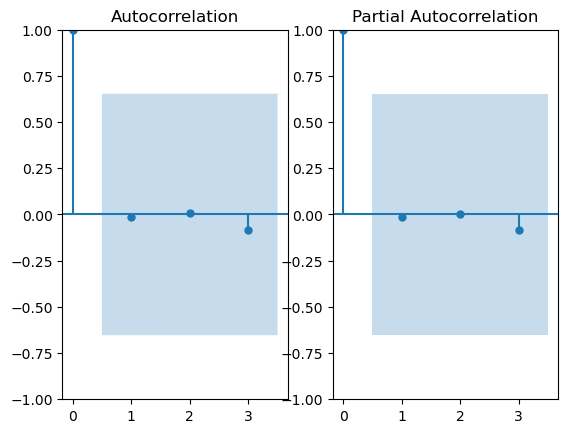

In [204]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_nepal['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_nepal['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [205]:
arima_1 = ARIMA(df_fuelwood_nepal['Value'], order=(0,2,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_nepal['Value'], order=(3,2,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_nepal['Value'], order=(3,2,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_nepal['Value'], order=(0,2,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 2, 0)   Log Likelihood                 -97.777
Date:                Tue, 25 Mar 2025   AIC                            197.554
Time:                        00:37:34   BIC                            197.752
Sample:                             0   HQIC                           197.129
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      1.552e+08   3.89e+07      3.995      0.000    7.91e+07    2.31e+08
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 9.82
Prob(Q):                              0.96   Pr

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

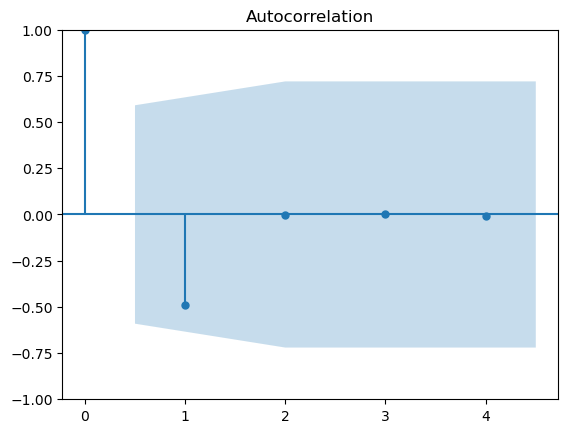

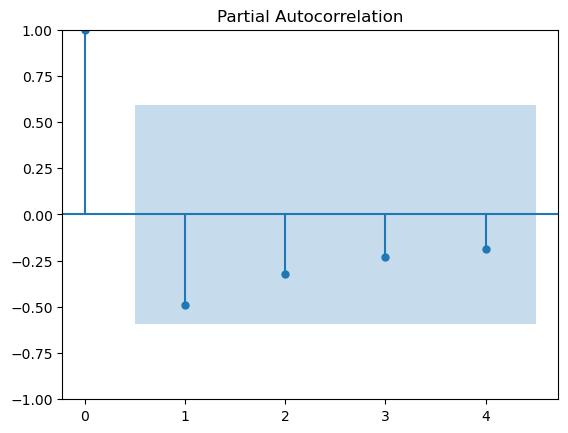

In [206]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


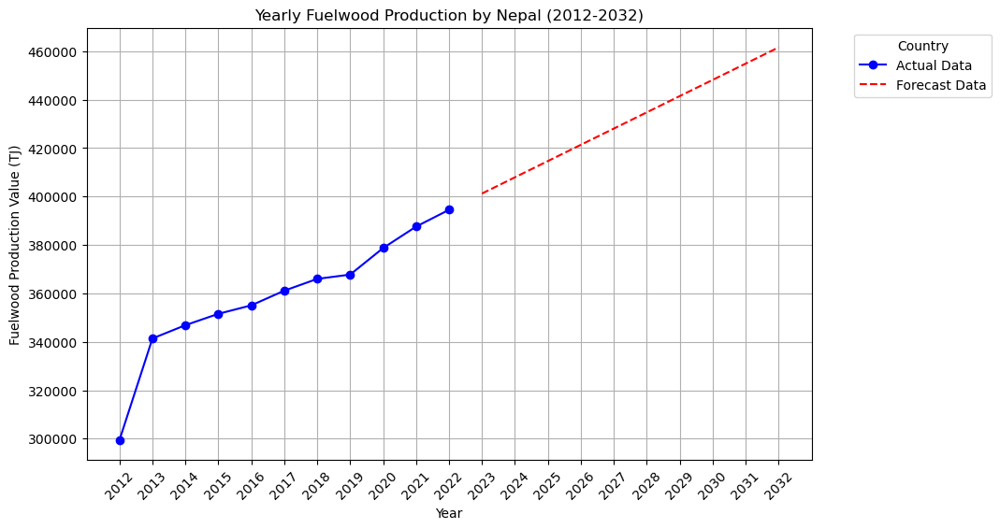

In [207]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_nepal.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_nepal.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_nepal.index ,df_fuelwood_nepal['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Production Value (TJ)')
plt.title('Yearly Fuelwood Production by Nepal (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [208]:
adf_statistic = adfuller(df_fuelwood_nepal_c['Value'])[0]
p_value = adfuller(df_fuelwood_nepal_c['Value'])[1]
critical_points = adfuller(df_fuelwood_nepal_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.1947570424715483
p-value: 0.995949458369935
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [209]:
df_fuelwood_nepal_c['Differenced Consumption'] = df_fuelwood_nepal_c['Value'].diff()

adf_statistic = adfuller(df_fuelwood_nepal_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_fuelwood_nepal_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_fuelwood_nepal_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 30.97802347287871
p-value: 1.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [210]:
df_fuelwood_nepal_c['Differenced Consumption 2'] = df_fuelwood_nepal_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_fuelwood_nepal_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_fuelwood_nepal_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_fuelwood_nepal_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.940622404417712
p-value: 0.04082399978741285
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

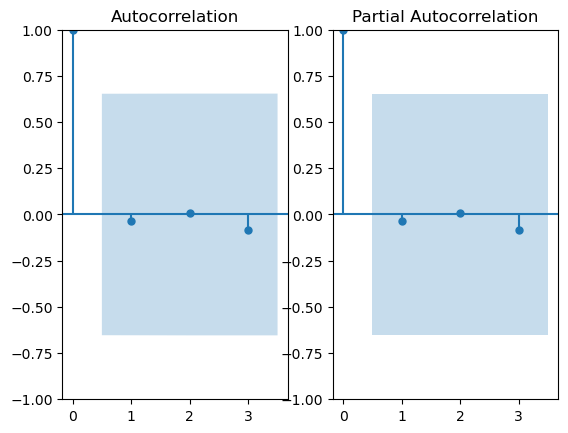

In [211]:
fig, ax = plt.subplots(1,2)
plot_acf(df_fuelwood_nepal_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_fuelwood_nepal_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [212]:
arima_1 = ARIMA(df_fuelwood_nepal_c['Value'], order=(0,2,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_fuelwood_nepal_c['Value'], order=(3,2,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_fuelwood_nepal_c['Value'], order=(3,2,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_fuelwood_nepal_c['Value'], order=(0,2,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 2, 0)   Log Likelihood                 -97.977
Date:                Tue, 25 Mar 2025   AIC                            197.954
Time:                        00:37:37   BIC                            198.151
Sample:                             0   HQIC                           197.528
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      1.622e+08   4.04e+07      4.014      0.000     8.3e+07    2.41e+08
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):                10.11
Prob(Q):                              0.90   Pr

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

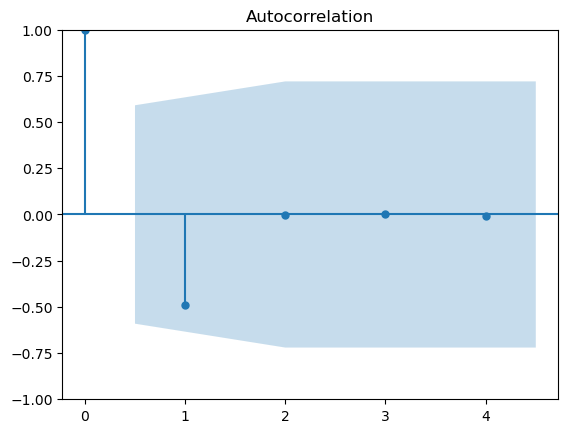

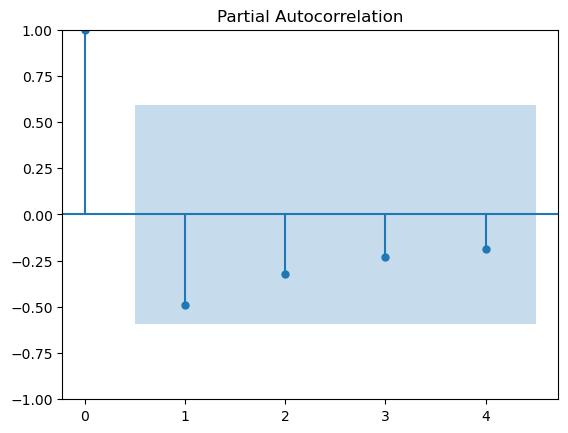

In [213]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


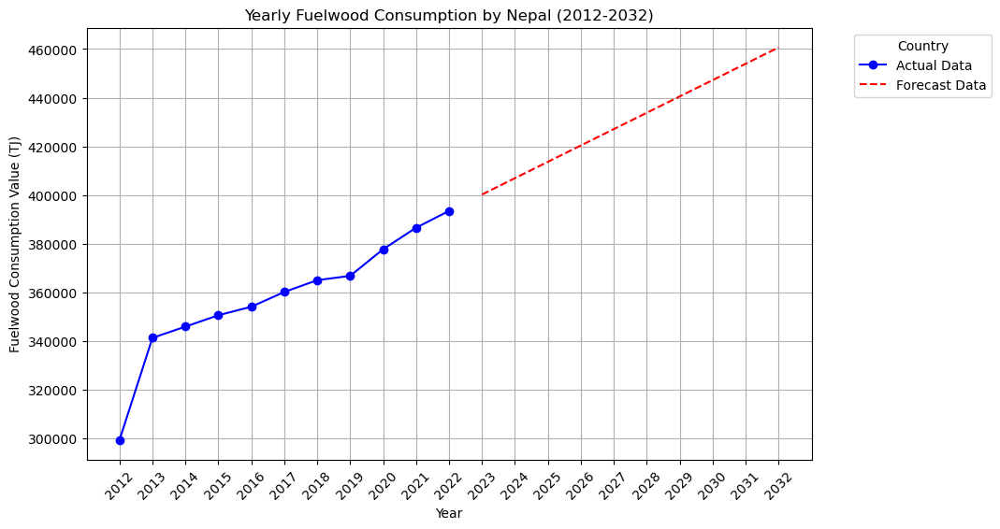

In [214]:
forecast_years = 10
forecast_c = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_fuelwood_nepal_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_fuelwood_nepal_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_fuelwood_nepal_c.index ,df_fuelwood_nepal_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Fuelwood Consumption Value (TJ)')
plt.title('Yearly Fuelwood Consumption by Nepal (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY FUELWOOD PRODUCTION AND CONSUMPTION IN NEPAL FORECAST

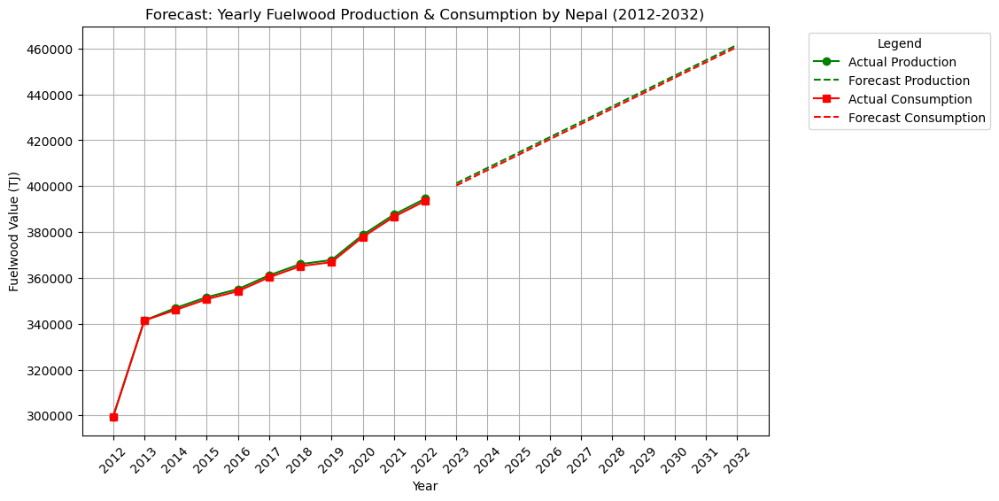

In [215]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_fuelwood_nepal.index, df_fuelwood_nepal['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_fuelwood_nepal_c.index, df_fuelwood_nepal_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Fuelwood Value (TJ)')
plt.title('Forecast: Yearly Fuelwood Production & Consumption by Nepal (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_fuelwood_nepal.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Fuelwood Forecast/Forecast of Yearly Fuelwood Production & Consumption by Nepal (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Animal Waste Production in Bangladesh</B>

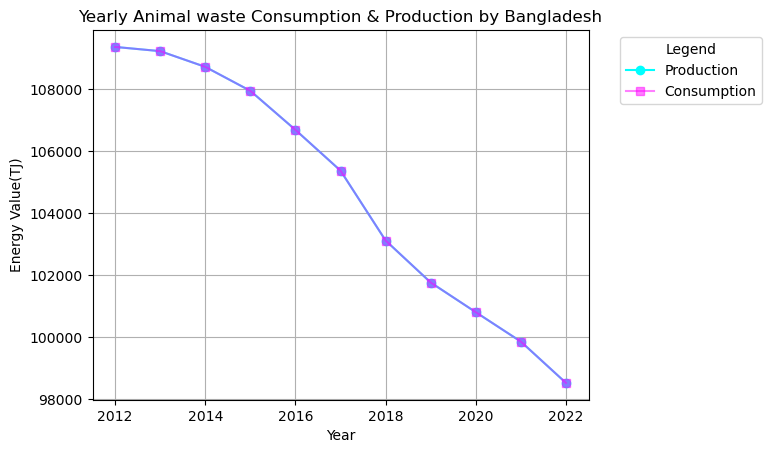

In [216]:
df_animal_waste_bangladesh = df_production[(df_production['Area'] == 'Bangladesh') & (df_production['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_animal_waste_bangladesh_c = df_consumption[(df_consumption['Area'] == 'Bangladesh') & (df_consumption['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_animal_waste_bangladesh.index, df_animal_waste_bangladesh.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_animal_waste_bangladesh_c.index, df_animal_waste_bangladesh_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Animal waste Consumption & Production by Bangladesh')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

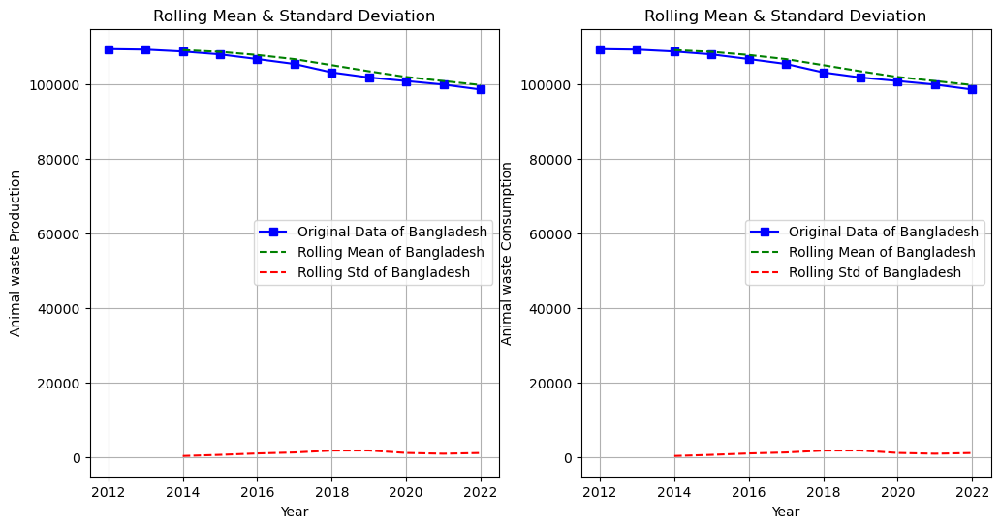

In [217]:
rolling_mean = df_animal_waste_bangladesh.rolling(window=3).mean()
rolling_std = df_animal_waste_bangladesh.rolling(window=3).std()
rolling_mean_c = df_animal_waste_bangladesh_c.rolling(window=3).mean()
rolling_std_c = df_animal_waste_bangladesh_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_animal_waste_bangladesh, label='Original Data of Bangladesh', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Bangladesh', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Bangladesh', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Animal waste Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_animal_waste_bangladesh_c, label='Original Data of Bangladesh', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Bangladesh', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Bangladesh', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Animal waste Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [218]:
adf_statistic = adfuller(df_animal_waste_bangladesh['Value'])[0]
p_value = adfuller(df_animal_waste_bangladesh['Value'])[1]
critical_points = adfuller(df_animal_waste_bangladesh['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.1730992882582265
p-value: 0.9957946516642066
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [219]:
df_animal_waste_bangladesh['Differenced Production'] = df_animal_waste_bangladesh['Value'].diff()
adf_statistic = adfuller(df_animal_waste_bangladesh['Differenced Production'].dropna())[0]
p_value = adfuller(df_animal_waste_bangladesh['Differenced Production'].dropna())[1]
critical_points = adfuller(df_animal_waste_bangladesh['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.125107912505466
p-value: 0.2345391545962902
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [220]:
df_animal_waste_bangladesh['Differenced Production 2'] = df_animal_waste_bangladesh['Differenced Production'].diff()
adf_statistic = adfuller(df_animal_waste_bangladesh['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_animal_waste_bangladesh['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_animal_waste_bangladesh['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.7557841955141478
p-value: 0.06487251092068193
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing 3rd time the Production to convert non stationary data to stationary</B>

In [221]:
df_animal_waste_bangladesh['Differenced Production 3'] = df_animal_waste_bangladesh['Differenced Production 2'].diff()
adf_statistic = adfuller(df_animal_waste_bangladesh['Differenced Production 3'].dropna())[0]
p_value = adfuller(df_animal_waste_bangladesh['Differenced Production 3'].dropna())[1]
critical_points = adfuller(df_animal_waste_bangladesh['Differenced Production 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.122977821136872
p-value: 0.0008872046931501842
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 3 (d=3)

<B>ACF and PACF PLOTS</B>

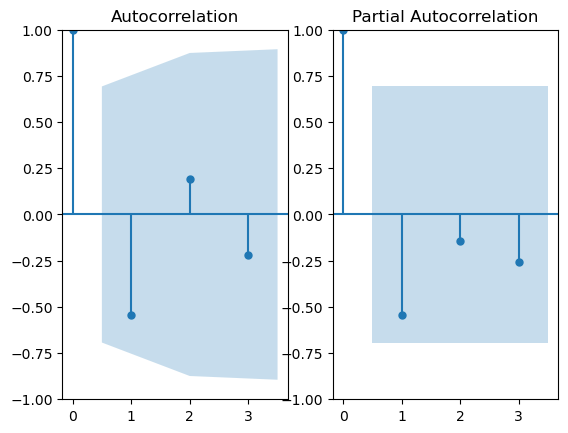

In [222]:
fig, ax = plt.subplots(1,2)
plot_acf(df_animal_waste_bangladesh['Differenced Production 3'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_animal_waste_bangladesh['Differenced Production 3'].dropna(), ax=ax[1], lags=3)
plt.show()

In [223]:
arima_1 = ARIMA(df_animal_waste_bangladesh['Value'], order=(1,3,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_animal_waste_bangladesh['Value'], order=(2,3,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_animal_waste_bangladesh['Value'], order=(3,3,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_animal_waste_bangladesh['Value'], order=(1,3,1))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 3, 0)   Log Likelihood                 -64.803
Date:                Tue, 25 Mar 2025   AIC                            133.606
Time:                        00:37:41   BIC                            133.765
Sample:                             0   HQIC                           132.535
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0021      0.184     -0.011      0.991      -0.364       0.359
sigma2      4.891e+05   1.96e+05      2.491      0.013    1.04e+05    8.74e+05
Ljung-Box (L1) (Q):                   3.37   Jarque-

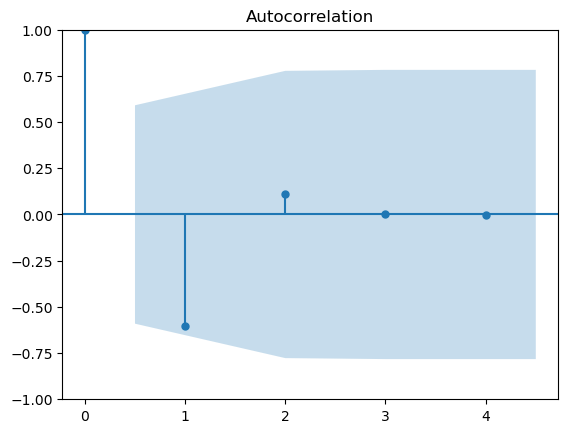

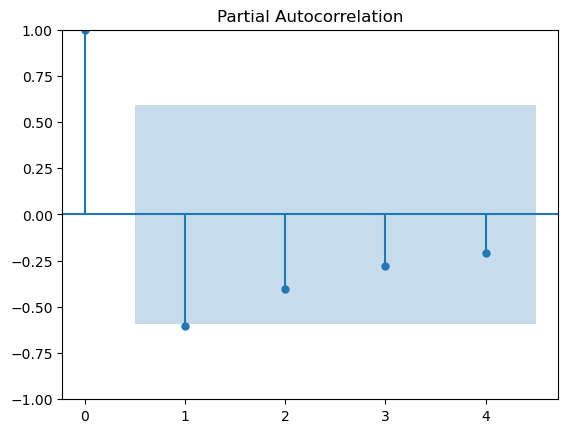

In [224]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


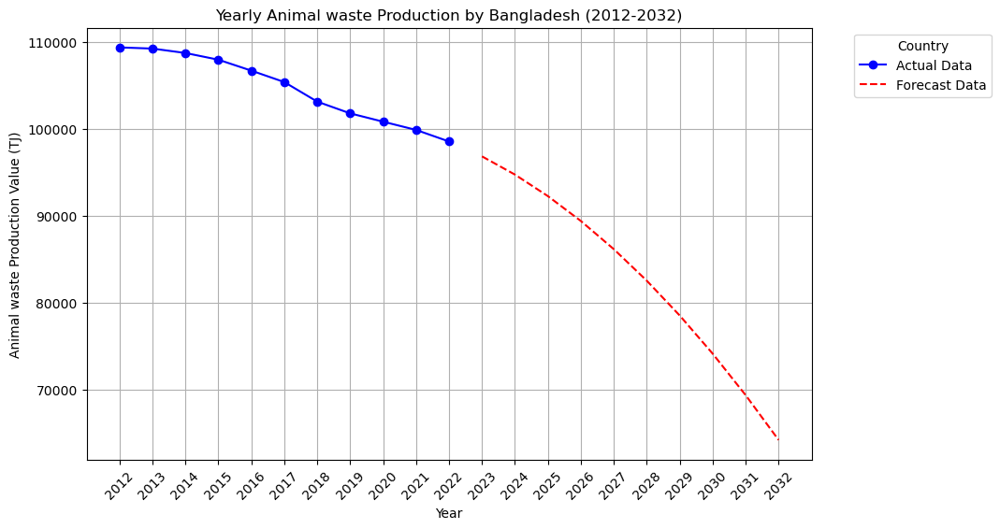

In [225]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_animal_waste_bangladesh.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_animal_waste_bangladesh.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_animal_waste_bangladesh.index ,df_animal_waste_bangladesh['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Animal waste Production Value (TJ)')
plt.title('Yearly Animal waste Production by Bangladesh (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY ANIMAL WASTE PRODUCTION AND CONSUMPTION IN BANGLADESH FORECAST

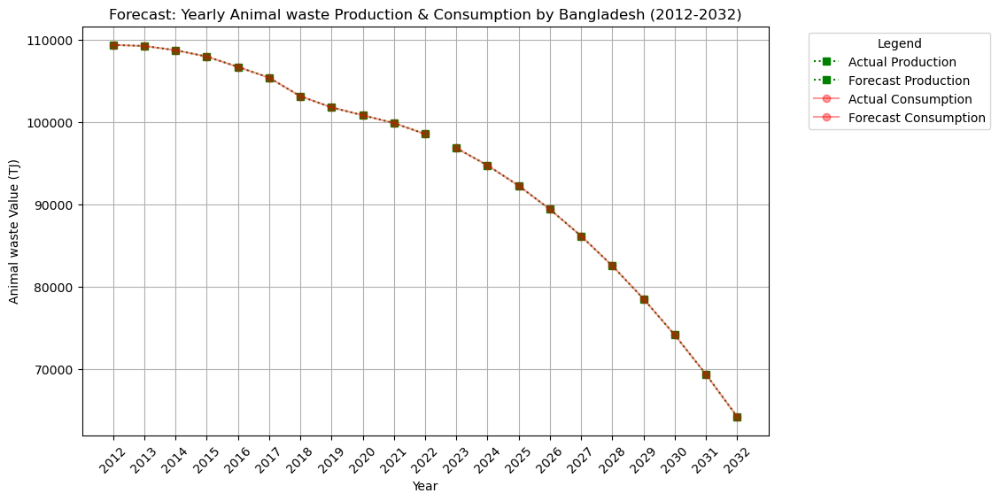

In [226]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_animal_waste_bangladesh.index, df_animal_waste_bangladesh['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_animal_waste_bangladesh.index, df_animal_waste_bangladesh['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Animal waste Value (TJ)')
plt.title('Forecast: Yearly Animal waste Production & Consumption by Bangladesh (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_animal_waste_bangladesh.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Animal Waste Forecast/Forecast of Yearly Animal waste Production & Consumption by Bangladesh (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Animal Waste Production in Nepal</B>

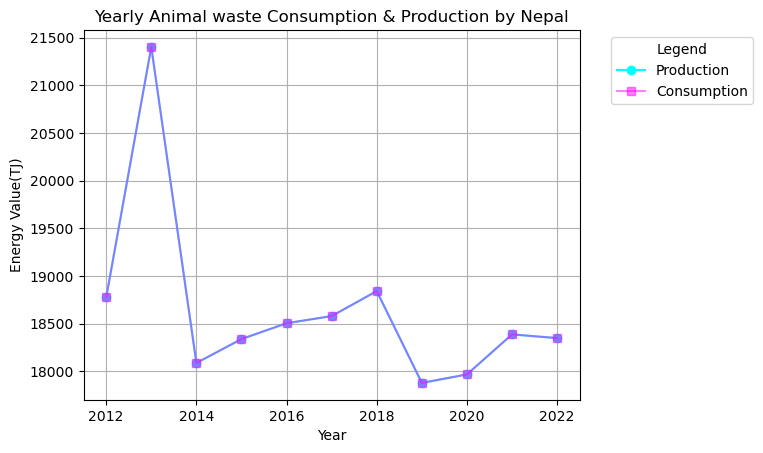

In [227]:
df_animal_waste_nepal = df_production[(df_production['Area'] == 'Nepal') & (df_production['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_animal_waste_nepal_c = df_consumption[(df_consumption['Area'] == 'Nepal') & (df_consumption['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_animal_waste_nepal.index, df_animal_waste_nepal.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_animal_waste_nepal_c.index, df_animal_waste_nepal_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Animal waste Consumption & Production by Nepal')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

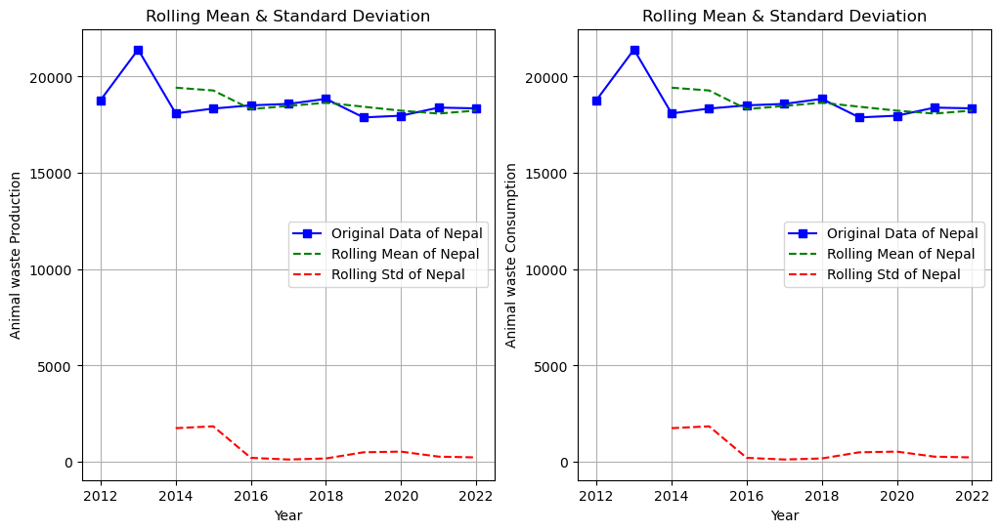

In [228]:
rolling_mean = df_animal_waste_nepal.rolling(window=3).mean()
rolling_std = df_animal_waste_nepal.rolling(window=3).std()
rolling_mean_c = df_animal_waste_nepal_c.rolling(window=3).mean()
rolling_std_c = df_animal_waste_nepal_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_animal_waste_nepal, label='Original Data of Nepal', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Nepal', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Nepal', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Animal waste Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_animal_waste_nepal_c, label='Original Data of Nepal', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Nepal', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Nepal', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Animal waste Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [229]:
adf_statistic = adfuller(df_animal_waste_nepal['Value'])[0]
p_value = adfuller(df_animal_waste_nepal['Value'])[1]
critical_points = adfuller(df_animal_waste_nepal['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.924620006013555
p-value: 0.04255902031892802
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

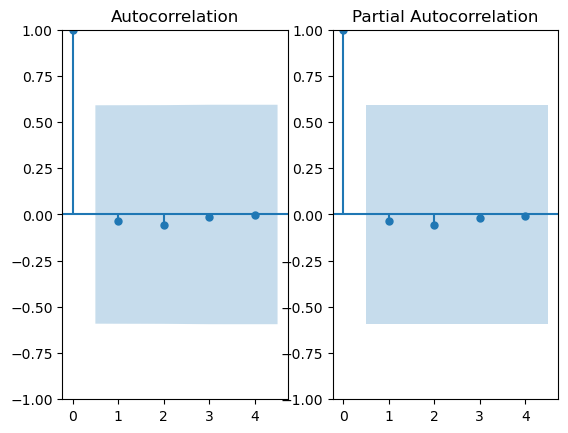

In [230]:
fig, ax = plt.subplots(1,2)
plot_acf(df_animal_waste_nepal['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_animal_waste_nepal['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [231]:
arima_1 = ARIMA(df_animal_waste_nepal['Value'], order=(2,0,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_animal_waste_nepal['Value'], order=(2,0,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_animal_waste_nepal['Value'], order=(1,0,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 0, 2)   Log Likelihood                 -90.687
Date:                Tue, 25 Mar 2025   AIC                            193.373
Time:                        00:37:44   BIC                            195.761
Sample:                             0   HQIC                           191.868
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.859e+04   1044.369     17.797      0.000    1.65e+04    2.06e+04
ar.L1       1.135e-05      0.035      0.000      1.000      -0.069       0.069
ar.L2          1.0000      1.195      0.837      0.4

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 2)   Log Likelihood                 -90.350
Date:                Tue, 25 Mar 2025   AIC                            190.700
Time:                        00:37:45   BIC                            192.690
Sample:                             0   HQIC                           189.446
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.855e+04    277.306     66.889      0.000     1.8e+04    1.91e+04
ar.L1         -0.1357      1.757     -0.077      0.938      -3.579       3.307
ma.L1       3.645e-06   8.99e+04   4.05e-11      1.0

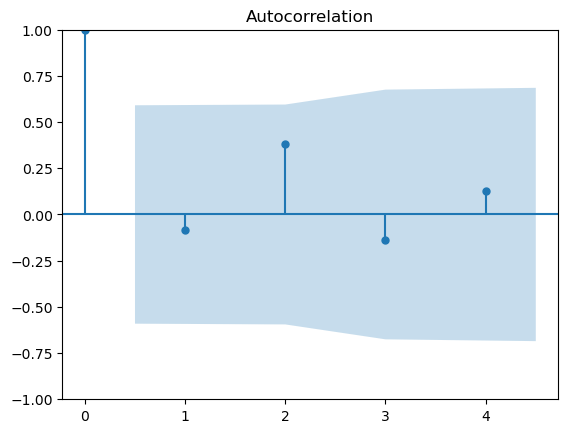

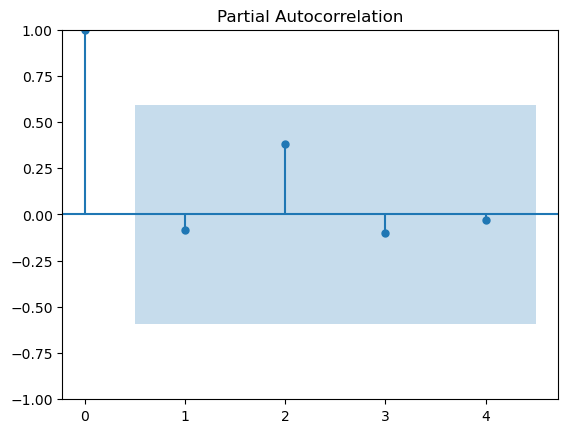

In [232]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


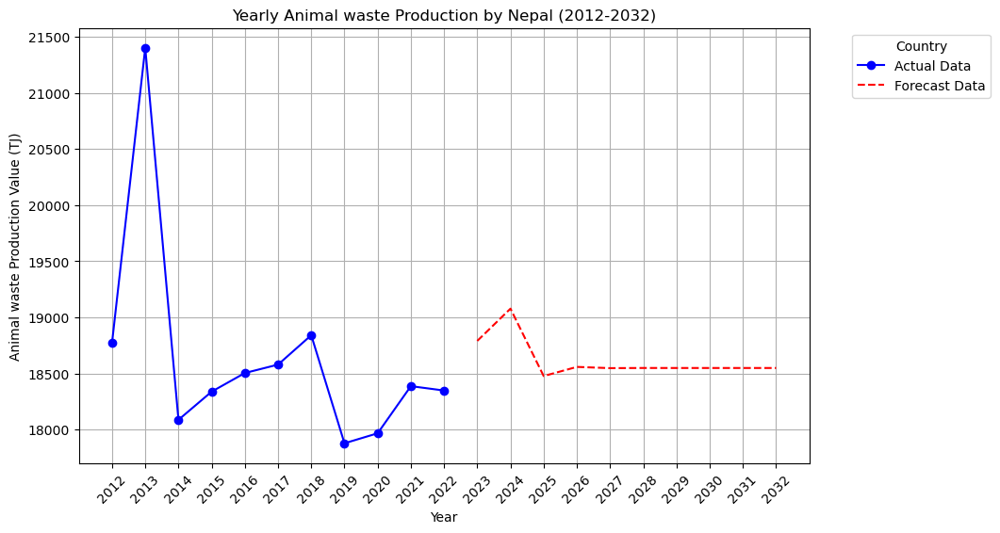

In [233]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_animal_waste_nepal.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_animal_waste_nepal.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_animal_waste_nepal.index ,df_animal_waste_nepal['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Animal waste Production Value (TJ)')
plt.title('Yearly Animal waste Production by Nepal (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY ANIMAL WASTE PRODUCTION AND CONSUMPTION IN NEPAL FORECAST

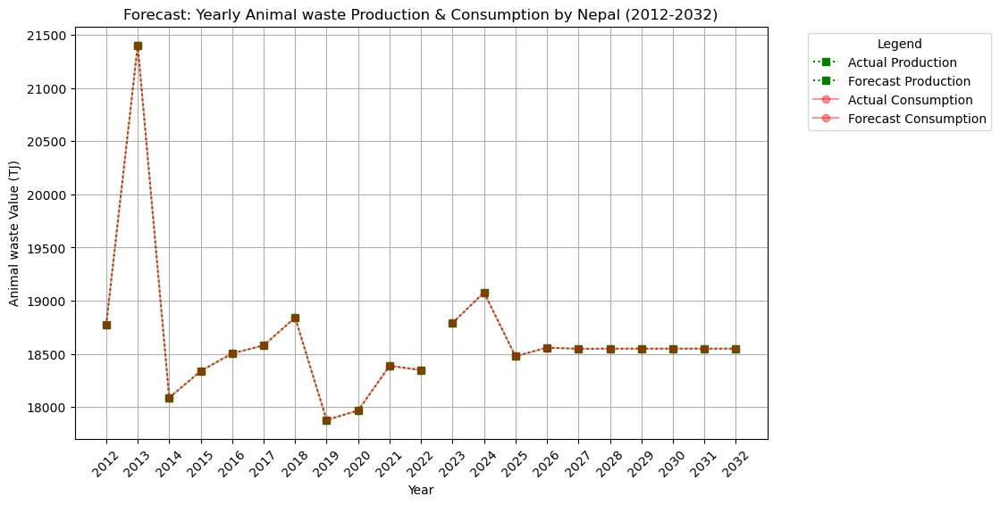

In [234]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_animal_waste_nepal.index, df_animal_waste_nepal['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_animal_waste_nepal.index, df_animal_waste_nepal['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Animal waste Value (TJ)')
plt.title('Forecast: Yearly Animal waste Production & Consumption by Nepal (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_animal_waste_nepal.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Animal Waste Forecast/Forecast of Yearly Animal waste Production & Consumption by Nepal (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Animal Waste Production in Pakistan</B>

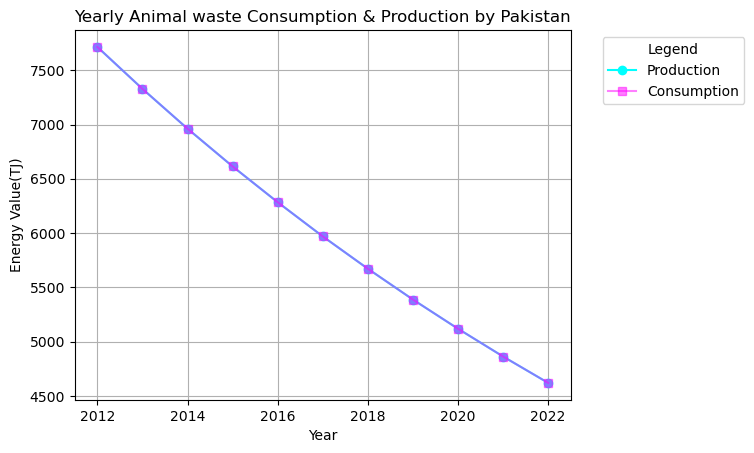

In [235]:
df_animal_waste_pakistan = df_production[(df_production['Area'] == 'Pakistan') & (df_production['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_animal_waste_pakistan_c = df_consumption[(df_consumption['Area'] == 'Pakistan') & (df_consumption['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_animal_waste_pakistan.index, df_animal_waste_pakistan.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_animal_waste_pakistan_c.index, df_animal_waste_pakistan_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Animal waste Consumption & Production by Pakistan')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

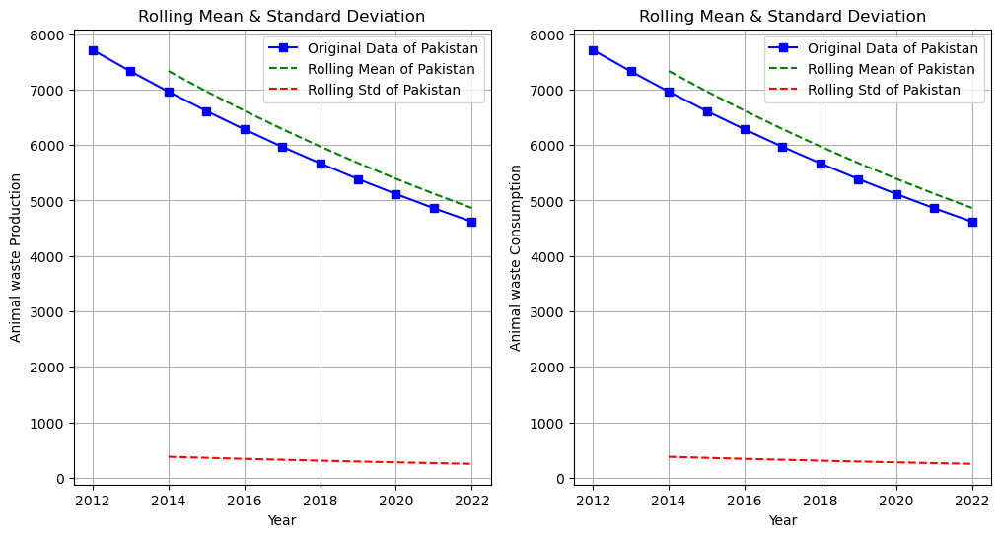

In [236]:
rolling_mean = df_animal_waste_pakistan.rolling(window=3).mean()
rolling_std = df_animal_waste_pakistan.rolling(window=3).std()
rolling_mean_c = df_animal_waste_pakistan_c.rolling(window=3).mean()
rolling_std_c = df_animal_waste_pakistan_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_animal_waste_pakistan, label='Original Data of Pakistan', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Pakistan', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Pakistan', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Animal waste Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_animal_waste_pakistan_c, label='Original Data of Pakistan', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Pakistan', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Pakistan', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Animal waste Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [237]:
adf_statistic = adfuller(df_animal_waste_pakistan['Value'])[0]
p_value = adfuller(df_animal_waste_pakistan['Value'])[1]
critical_points = adfuller(df_animal_waste_pakistan['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.968263710561856
p-value: 0.0015861192522140586
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

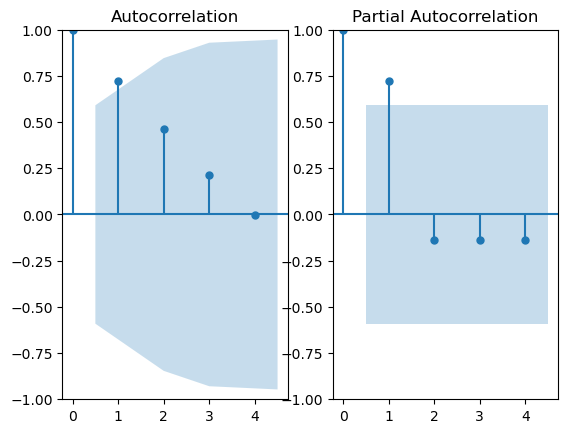

In [238]:
fig, ax = plt.subplots(1,2)
plot_acf(df_animal_waste_pakistan['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_animal_waste_pakistan['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [239]:
arima_1 = ARIMA(df_animal_waste_pakistan['Value'], order=(1,0,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_animal_waste_pakistan['Value'], order=(1,0,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_animal_waste_pakistan['Value'], order=(2,0,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_animal_waste_pakistan['Value'], order=(4,0,0))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 0)   Log Likelihood                 -80.326
Date:                Tue, 25 Mar 2025   AIC                            166.652
Time:                        00:37:49   BIC                            167.846
Sample:                             0   HQIC                           165.900
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       6048.4549   1547.950      3.907      0.000    3014.529    9082.381
ar.L1          0.9765      0.109      8.922      0.000       0.762       1.191
sigma2      9.753e+04      6.894   1.41e+04      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Che

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 0, 0)   Log Likelihood                 -41.539
Date:                Tue, 25 Mar 2025   AIC                             91.079
Time:                        00:37:49   BIC                             92.670
Sample:                             0   HQIC                            90.075
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        2.03e+04      0.004   5.32e+06      0.000    2.03e+04    2.03e+04
ar.L1          1.9988      0.000    1.6e+04      0.000       1.999       1.999
ar.L2         -0.9999      0.000  -9208.670      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


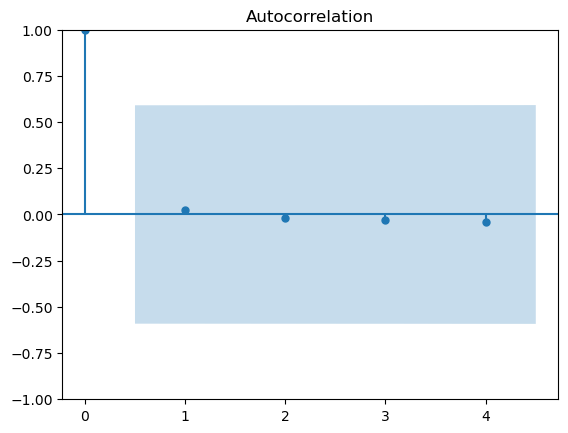

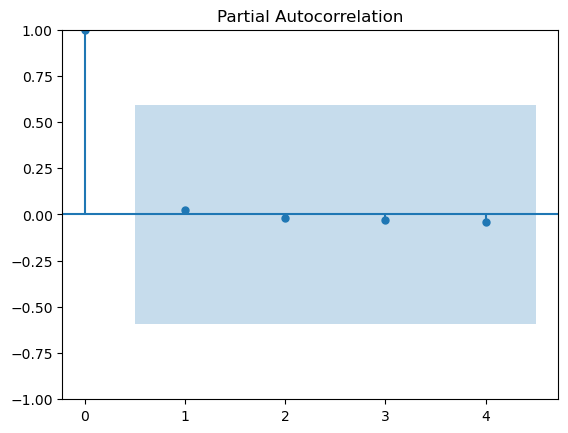

In [240]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


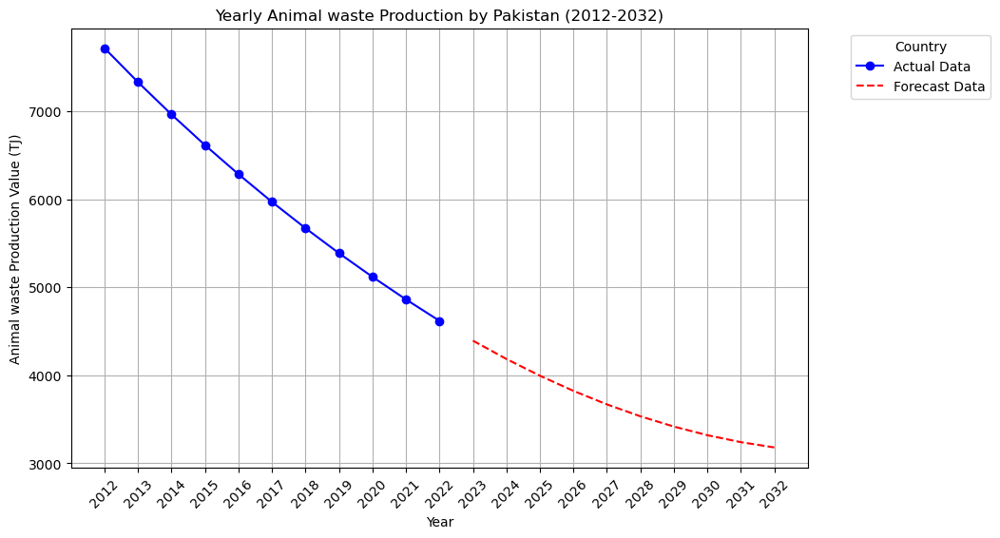

In [241]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_animal_waste_pakistan.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_animal_waste_pakistan.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_animal_waste_pakistan.index ,df_animal_waste_pakistan['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Animal waste Production Value (TJ)')
plt.title('Yearly Animal waste Production by Pakistan (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY ANIMAL WASTE PRODUCTION AND CONSUMPTION IN PAKISTAN FORECAST

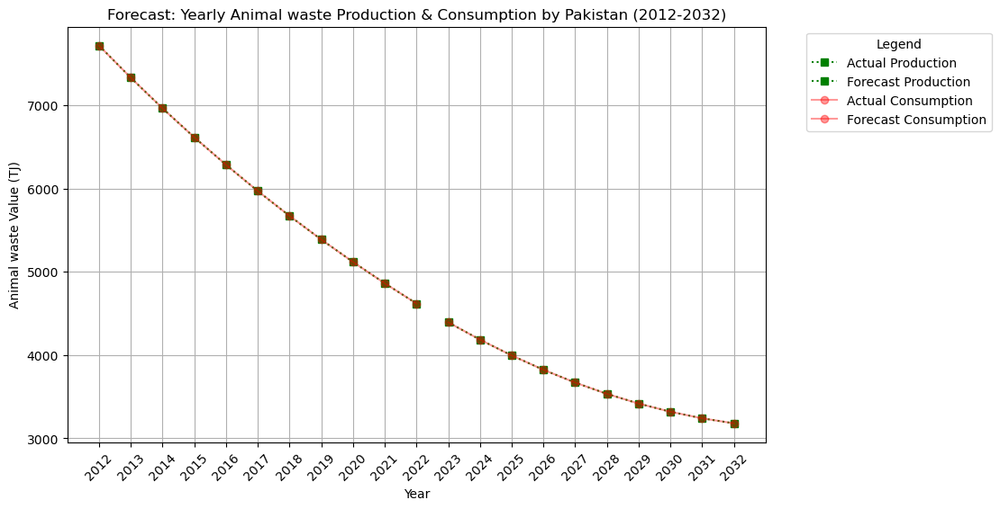

In [242]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_animal_waste_pakistan.index, df_animal_waste_pakistan['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_animal_waste_pakistan.index, df_animal_waste_pakistan['Value'],color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Animal waste Value (TJ)')
plt.title('Forecast: Yearly Animal waste Production & Consumption by Pakistan (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_animal_waste_pakistan.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Animal Waste Forecast/Forecast of Yearly Animal waste Production & Consumption by Pakistan (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Animal Waste Production in Iran</B>

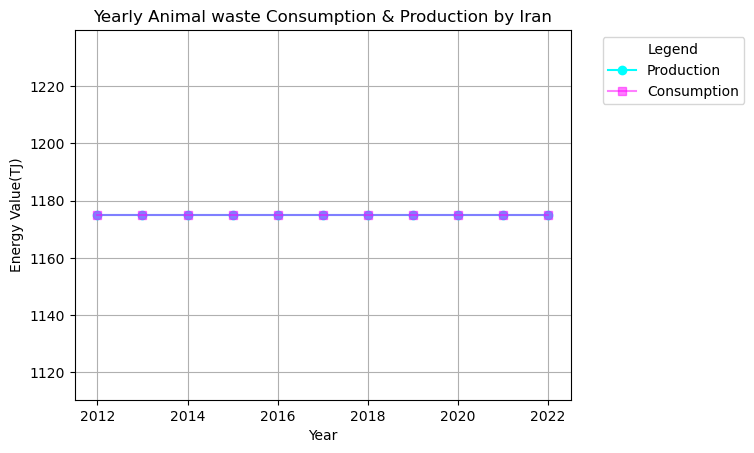

In [243]:
df_animal_waste_iran = df_production[(df_production['Area'] == 'Iran') & (df_production['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_animal_waste_iran_c = df_consumption[(df_consumption['Area'] == 'Iran') & (df_consumption['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_animal_waste_iran.index, df_animal_waste_iran.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_animal_waste_iran_c.index, df_animal_waste_iran_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Animal waste Consumption & Production by Iran')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

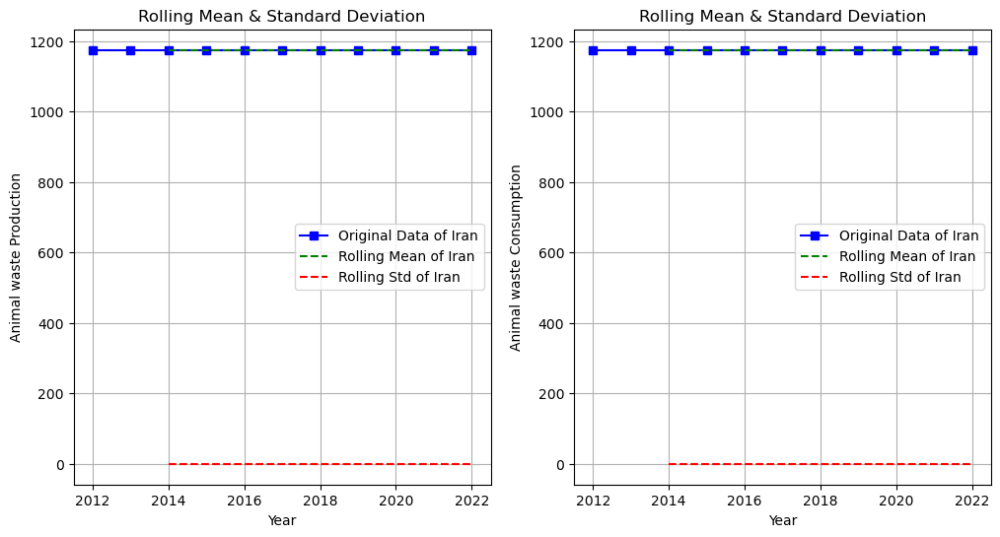

In [244]:
rolling_mean = df_animal_waste_iran.rolling(window=3).mean()
rolling_std = df_animal_waste_iran.rolling(window=3).std()
rolling_mean_c = df_animal_waste_iran_c.rolling(window=3).mean()
rolling_std_c = df_animal_waste_iran_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_animal_waste_iran, label='Original Data of Iran', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Iran', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Iran', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Animal waste Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_animal_waste_iran_c, label='Original Data of Iran', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Iran', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Iran', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Animal waste Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

In [245]:
arima = ARIMA(df_animal_waste_iran['Value'], order=(1,1,1))
arima_fit = arima.fit()
forecast_years = 10
forecast_p = arima_fit.forecast(steps=forecast_years)

last_year = int(df_animal_waste_iran.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_animal_waste_iran.index) + forecast_index

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ

# YEARLY ANIMAL WASTE PRODUCTION AND CONSUMPTION IN IRAN FORECAST

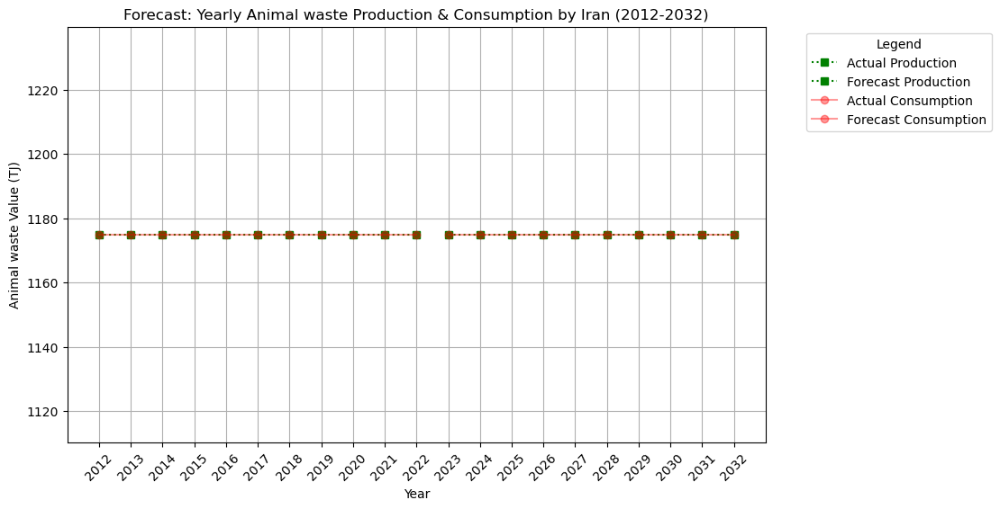

In [246]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_animal_waste_iran.index, df_animal_waste_iran['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_animal_waste_iran.index, df_animal_waste_iran['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Animal waste Value (TJ)')
plt.title('Forecast: Yearly Animal waste Production & Consumption by Iran (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_animal_waste_iran.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Animal Waste Forecast/Forecast of Yearly Animal waste Production & Consumption by Iran (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Animal Waste Production in Philippines</B>

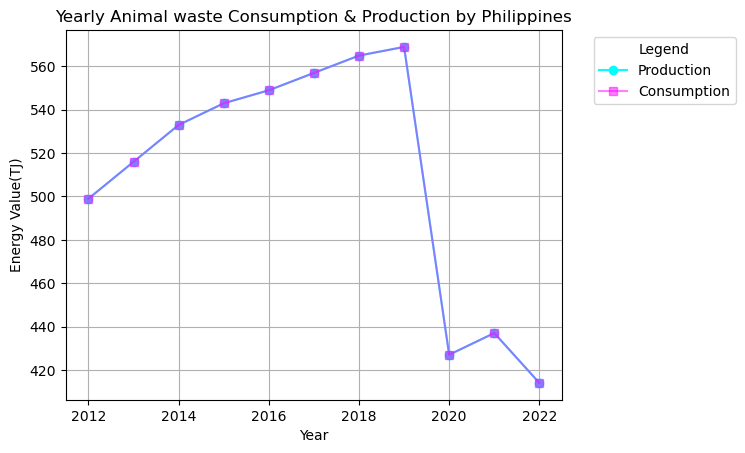

In [247]:
df_animal_waste_philippines = df_production[(df_production['Area'] == 'Philippines') & (df_production['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_animal_waste_philippines_c = df_consumption[(df_consumption['Area'] == 'Philippines') & (df_consumption['Item'] == 'Animal waste')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_animal_waste_philippines.index, df_animal_waste_philippines.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_animal_waste_philippines_c.index, df_animal_waste_philippines_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Animal waste Consumption & Production by Philippines')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

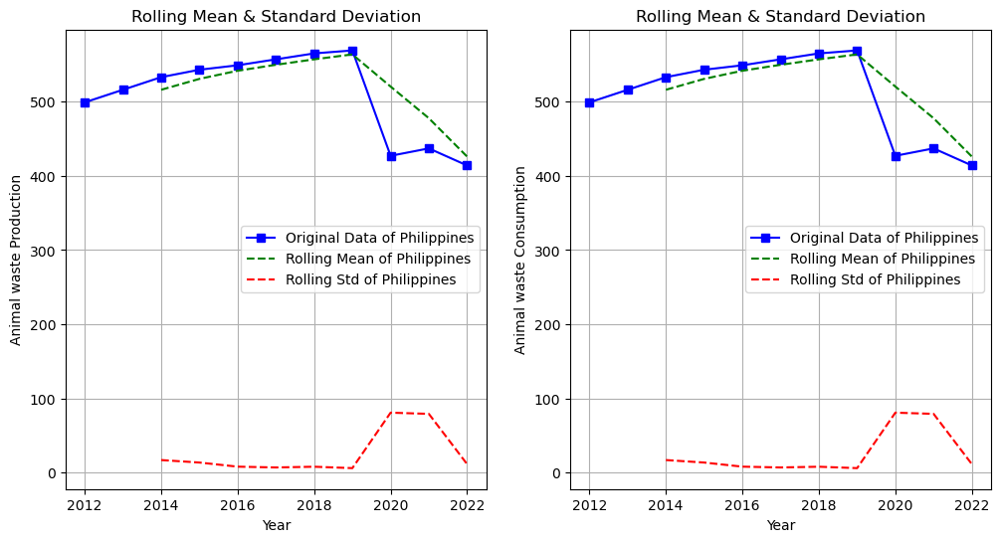

In [248]:
rolling_mean = df_animal_waste_philippines.rolling(window=3).mean()
rolling_std = df_animal_waste_philippines.rolling(window=3).std()
rolling_mean_c = df_animal_waste_philippines_c.rolling(window=3).mean()
rolling_std_c = df_animal_waste_philippines_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_animal_waste_philippines, label='Original Data of Philippines', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Philippines', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Philippines', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Animal waste Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_animal_waste_philippines_c, label='Original Data of Philippines', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Philippines', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Philippines', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Animal waste Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [249]:
adf_statistic = adfuller(df_animal_waste_philippines['Value'])[0]
p_value = adfuller(df_animal_waste_philippines['Value'])[1]
critical_points = adfuller(df_animal_waste_philippines['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.7227946972717949
p-value: 0.8407565227278903
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [250]:
df_animal_waste_philippines['Differenced Production'] = df_animal_waste_philippines['Value'].diff()
adf_statistic = adfuller(df_animal_waste_philippines['Differenced Production'].dropna())[0]
p_value = adfuller(df_animal_waste_philippines['Differenced Production'].dropna())[1]
critical_points = adfuller(df_animal_waste_philippines['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 0.8539471160336817
p-value: 0.9924589083134391
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [251]:
df_animal_waste_philippines['Differenced Production 2'] = df_animal_waste_philippines['Differenced Production'].diff()
adf_statistic = adfuller(df_animal_waste_philippines['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_animal_waste_philippines['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_animal_waste_philippines['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.9915390702760711
p-value: 0.2902952000752652
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 3rd time the Production to convert non stationary data to stationary</B>

In [252]:
df_animal_waste_philippines['Differenced Production 3'] = df_animal_waste_philippines['Differenced Production 2'].diff()
adf_statistic = adfuller(df_animal_waste_philippines['Differenced Production 3'].dropna())[0]
p_value = adfuller(df_animal_waste_philippines['Differenced Production 3'].dropna())[1]
critical_points = adfuller(df_animal_waste_philippines['Differenced Production 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.713960860394106
p-value: 0.4239341558945213
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


<B>Differencing 4th time the Production to convert non stationary data to stationary</B>

In [253]:
df_animal_waste_philippines['Differenced Production 4'] = df_animal_waste_philippines['Differenced Production 3'].diff()
adf_statistic = adfuller(df_animal_waste_philippines['Differenced Production 4'].dropna())[0]
p_value = adfuller(df_animal_waste_philippines['Differenced Production 4'].dropna())[1]
critical_points = adfuller(df_animal_waste_philippines['Differenced Production 4'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.146387811367539
p-value: 0.22627530504932164
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


<B>Differencing 5th time the Production to convert non stationary data to stationary</B>

In [254]:
df_animal_waste_philippines['Differenced Production 5'] = df_animal_waste_philippines['Differenced Production 4'].diff()
adf_statistic = adfuller(df_animal_waste_philippines['Differenced Production 5'].dropna())[0]
p_value = adfuller(df_animal_waste_philippines['Differenced Production 5'].dropna())[1]
critical_points = adfuller(df_animal_waste_philippines['Differenced Production 5'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.9805190869743807
p-value: 0.001516025477442905
critical points: {'1%': -7.355440625, '5%': -4.474365000000001, '10%': -3.1269325}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 5 (d=5)

<B>ACF and PACF PLOTS</B>

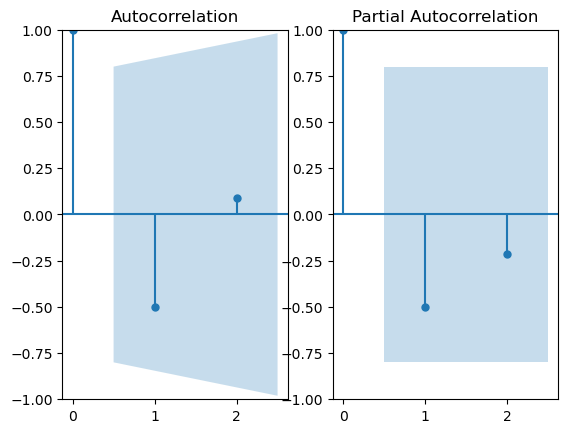

In [255]:
fig, ax = plt.subplots(1,2)
plot_acf(df_animal_waste_philippines['Differenced Production 5'].dropna(), ax=ax[0], lags=2)
plot_pacf(df_animal_waste_philippines['Differenced Production 5'].dropna(), ax=ax[1], lags=2)
plt.show()

In [256]:
arima_1 = ARIMA(df_animal_waste_philippines['Value'], order=(1,5,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_3 = ARIMA(df_animal_waste_philippines['Value'], order=(0,5,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 5, 1)   Log Likelihood                 -39.275
Date:                Tue, 25 Mar 2025   AIC                             84.550
Time:                        00:37:55   BIC                             83.925
Sample:                             0   HQIC                            82.049
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9998      2.200     -0.455      0.649      -5.311       3.311
ma.L1         -0.9937    196.414     -0.005      0.996    -385.958     383.971
sigma2      2.122e+04   4.12e+06      0.005      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

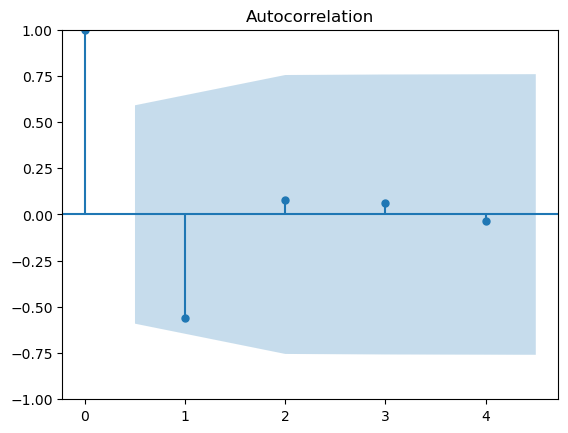

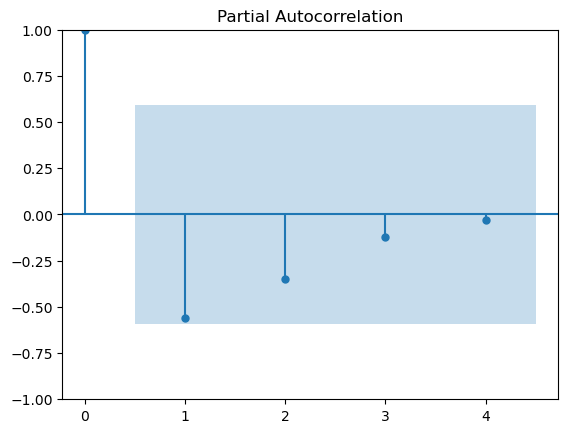

In [257]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


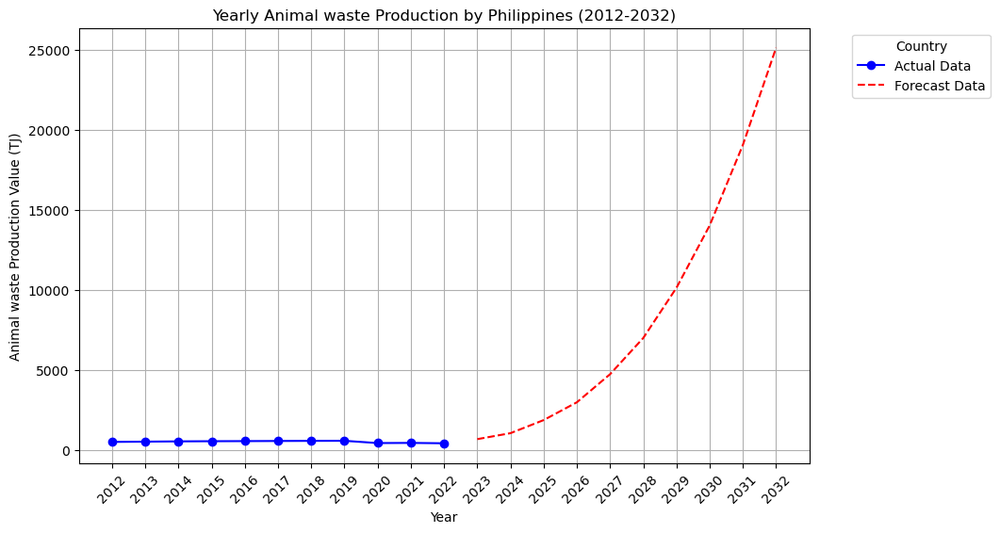

In [258]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_animal_waste_philippines.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_animal_waste_philippines.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_animal_waste_philippines.index ,df_animal_waste_philippines['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Animal waste Production Value (TJ)')
plt.title('Yearly Animal waste Production by Philippines (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY ANIMAL WASTE PRODUCTION AND CONSUMPTION IN PHILIPPINES FORECAST

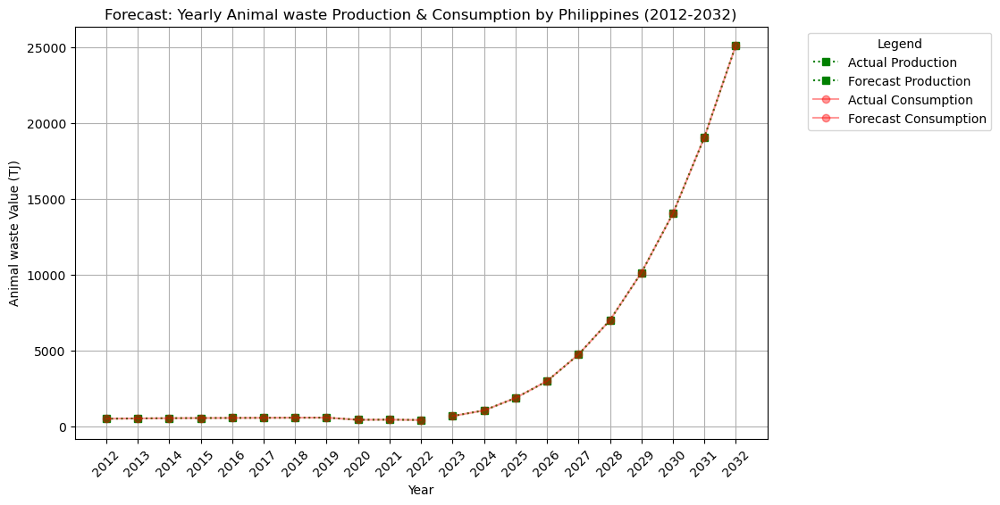

In [259]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_animal_waste_philippines.index, df_animal_waste_philippines['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_animal_waste_philippines.index, df_animal_waste_philippines['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Animal waste Value (TJ)')
plt.title('Forecast: Yearly Animal waste Production & Consumption by Philippines (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_animal_waste_philippines.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Animal Waste Forecast/Forecast of Yearly Animal waste Production & Consumption by Philippines (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Other vegetal material and residues Production in China, mainland</B>

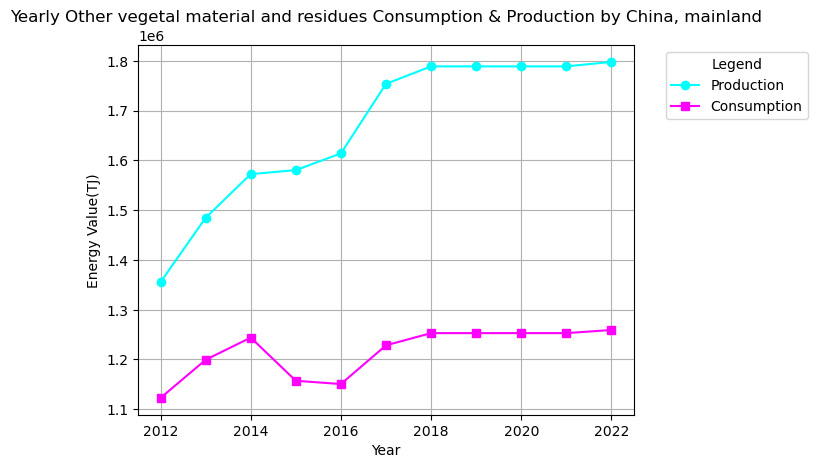

In [260]:
df_vegetal_china = df_production[(df_production['Area'] == 'China, mainland') & (df_production['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_vegetal_china_c = df_consumption[(df_consumption['Area'] == 'China, mainland') & (df_consumption['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_vegetal_china.index, df_vegetal_china.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_vegetal_china_c.index, df_vegetal_china_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Other vegetal material and residues Consumption & Production by China, mainland')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

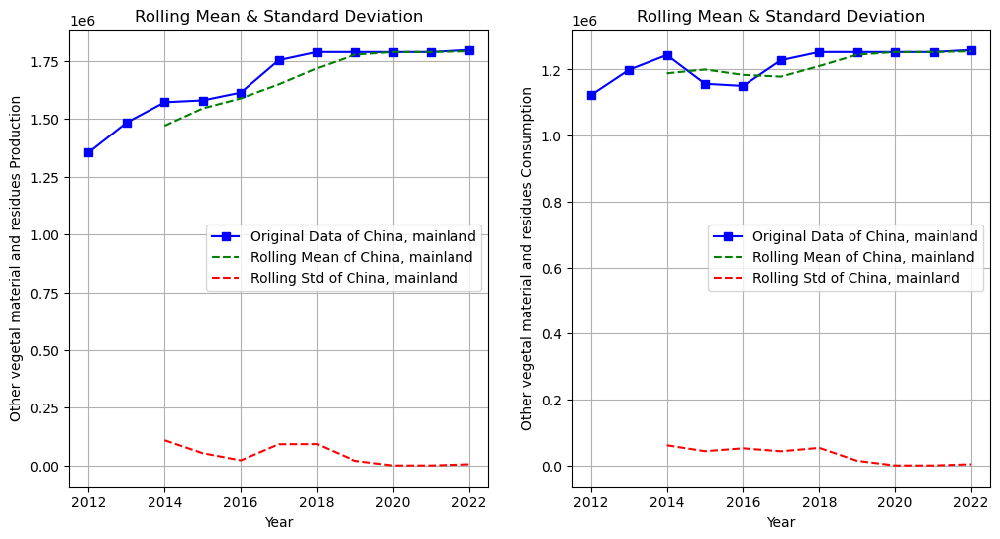

In [261]:
rolling_mean = df_vegetal_china.rolling(window=3).mean()
rolling_std = df_vegetal_china.rolling(window=3).std()
rolling_mean_c = df_vegetal_china_c.rolling(window=3).mean()
rolling_std_c = df_vegetal_china_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_vegetal_china, label='Original Data of China, mainland', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of China, mainland', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Other vegetal material and residues Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_vegetal_china_c, label='Original Data of China, mainland', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of China, mainland', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Other vegetal material and residues Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [262]:
adf_statistic = adfuller(df_vegetal_china['Value'])[0]
p_value = adfuller(df_vegetal_china['Value'])[1]
critical_points = adfuller(df_vegetal_china['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.1438067749185037
p-value: 0.02347661413421653
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

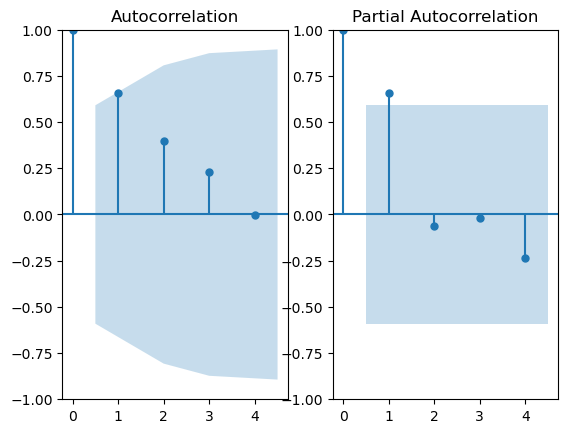

In [263]:
fig, ax = plt.subplots(1,2)
plot_acf(df_vegetal_china['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_vegetal_china['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [264]:
arima_1 = ARIMA(df_vegetal_china['Value'], order=(1,0,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_vegetal_china['Value'], order=(4,0,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 0)   Log Likelihood                -139.772
Date:                Tue, 25 Mar 2025   AIC                            285.544
Time:                        00:37:59   BIC                            286.738
Sample:                             0   HQIC                           284.792
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.665e+06   2.89e+05      5.767      0.000     1.1e+06    2.23e+06
ar.L1          0.9632      0.101      9.542      0.000       0.765       1.161
sigma2      2.849e+09     36.808   7.74e+07      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

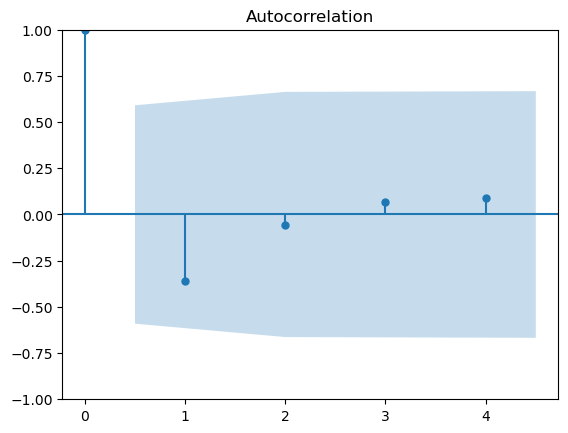

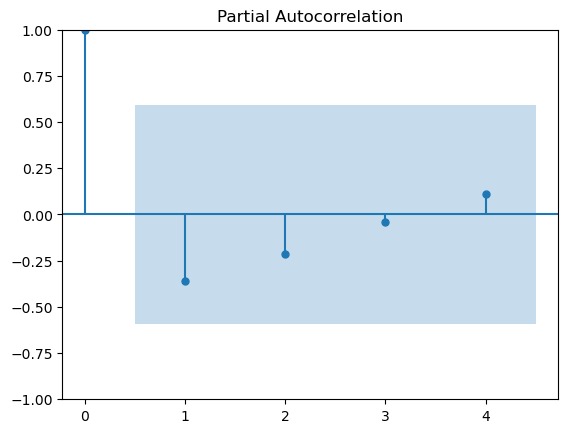

In [265]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


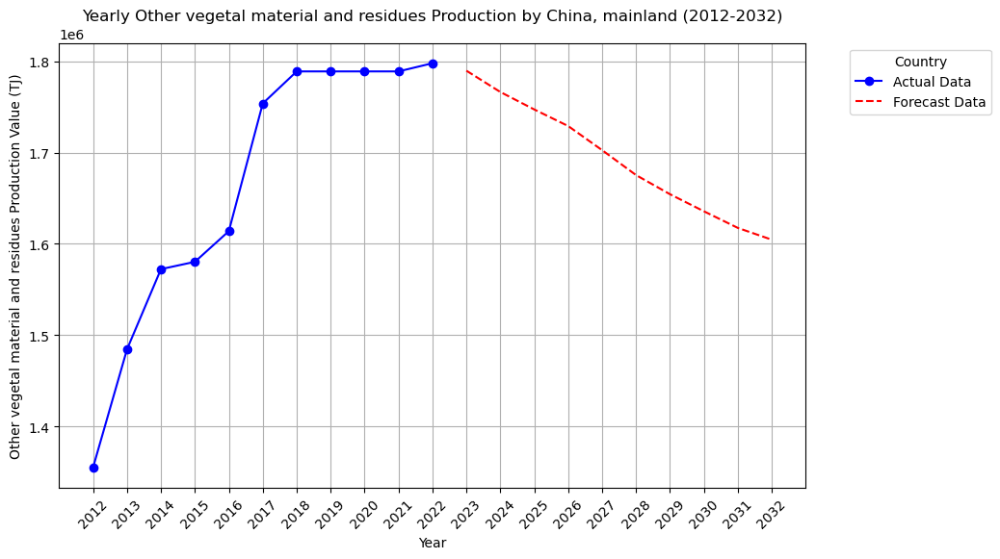

In [266]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_china.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_china.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_china.index ,df_vegetal_china['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Production Value (TJ)')
plt.title('Yearly Other vegetal material and residues Production by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [267]:
adf_statistic = adfuller(df_vegetal_china_c['Value'])[0]
p_value = adfuller(df_vegetal_china_c['Value'])[1]
critical_points = adfuller(df_vegetal_china_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.9916678960043048
p-value: 0.2902383441042563
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [268]:
df_vegetal_china_c['Differenced Consumption'] = df_vegetal_china_c['Value'].diff()

adf_statistic = adfuller(df_vegetal_china_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_vegetal_china_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_vegetal_china_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.492008184745456
p-value: 0.11743094859901693
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [269]:
df_vegetal_china_c['Differenced Consumption 2'] = df_vegetal_china_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_vegetal_china_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_vegetal_china_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_vegetal_china_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -7.79263096749341
p-value: 7.867663702768155e-12
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

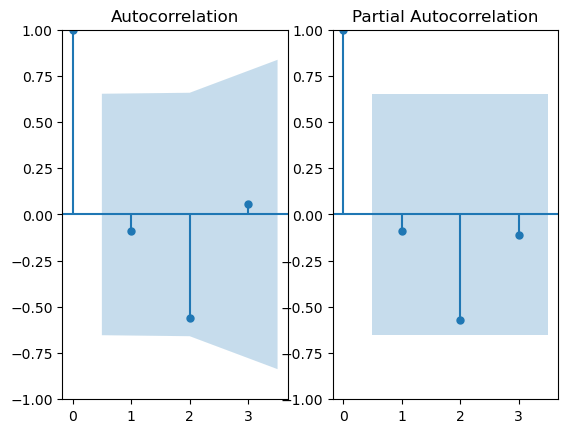

In [270]:
fig, ax = plt.subplots(1,2)
plot_acf(df_vegetal_china_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_vegetal_china_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [271]:
arima_1 = ARIMA(df_vegetal_china_c['Value'], order=(2,2,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_vegetal_china_c['Value'], order=(2,2,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_vegetal_china_c['Value'], order=(0,2,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_vegetal_china_c['Value'], order=(0,2,0))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 2, 2)   Log Likelihood             -817270.104
Date:                Tue, 25 Mar 2025   AIC                        1634550.208
Time:                        00:38:01   BIC                        1634551.194
Sample:                             0   HQIC                       1634548.080
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5834   3.07e-06   -1.9e+05      0.000      -0.583      -0.583
ar.L2         -0.9950   7.04e-08  -1.41e+07      0.000      -0.995      -0.995
ma.L1         -0.0013      0.003     -0.393      0.6

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


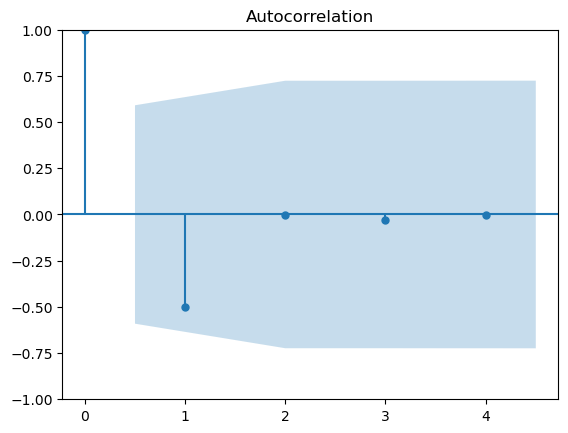

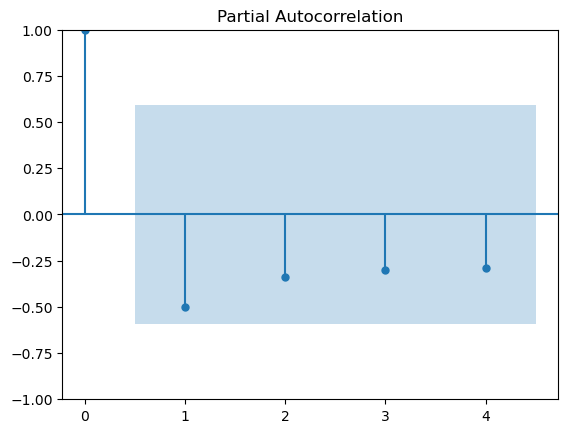

In [272]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


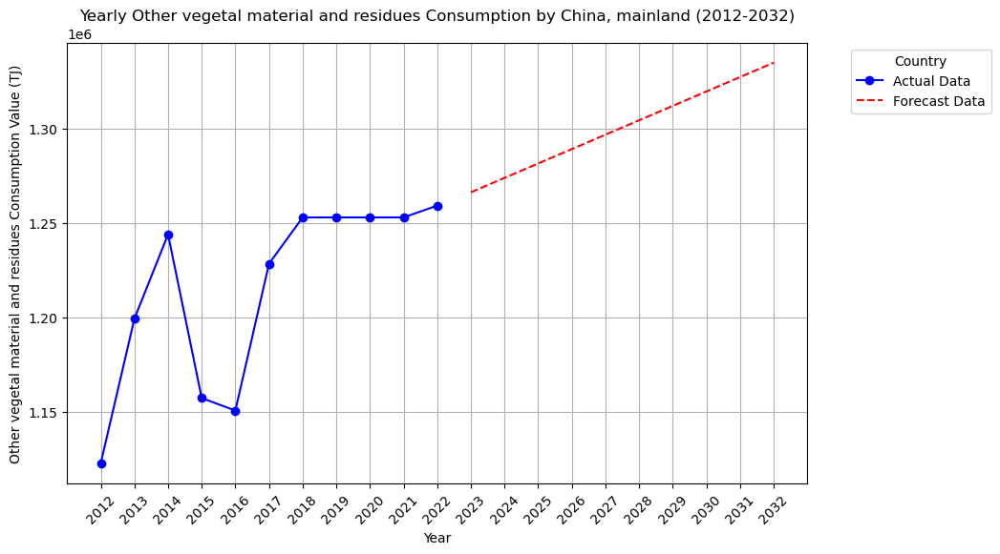

In [273]:
forecast_years = 10
forecast_c = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_china_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_china_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_china_c.index ,df_vegetal_china_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Consumption Value (TJ)')
plt.title('Yearly Other vegetal material and residues Consumption by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER VEGETAL MATERIAL AND RESIDUES PRODUCTION AND CONSUMPTION IN CHINA, MAINLAND FORECAST

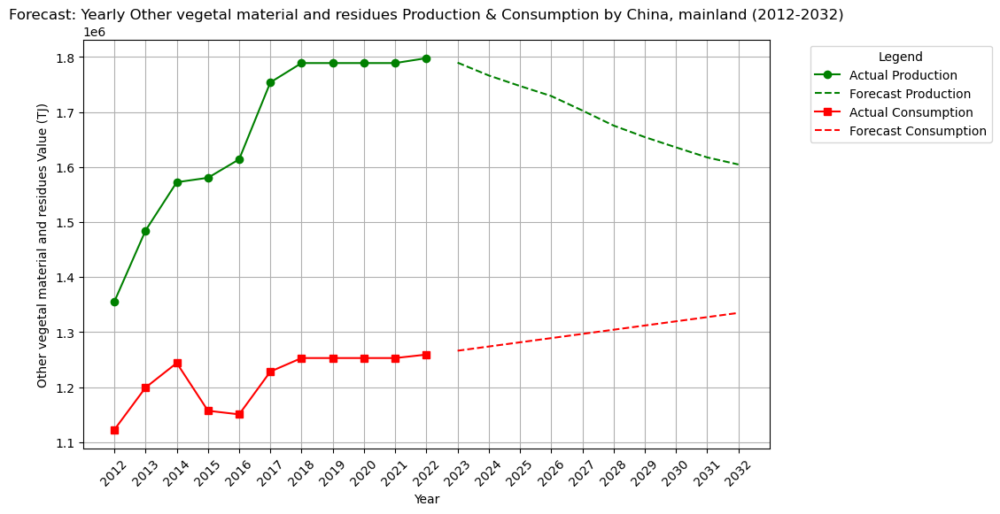

In [274]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_vegetal_china.index, df_vegetal_china['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_vegetal_china_c.index, df_vegetal_china_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Value (TJ)')
plt.title('Forecast: Yearly Other vegetal material and residues Production & Consumption by China, mainland (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_vegetal_china.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Vegetal Material Forecast/Forecast of Yearly Other vegetal material and residues Production & Consumption by China, mainland (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Other vegetal material and residues Production in India</B>

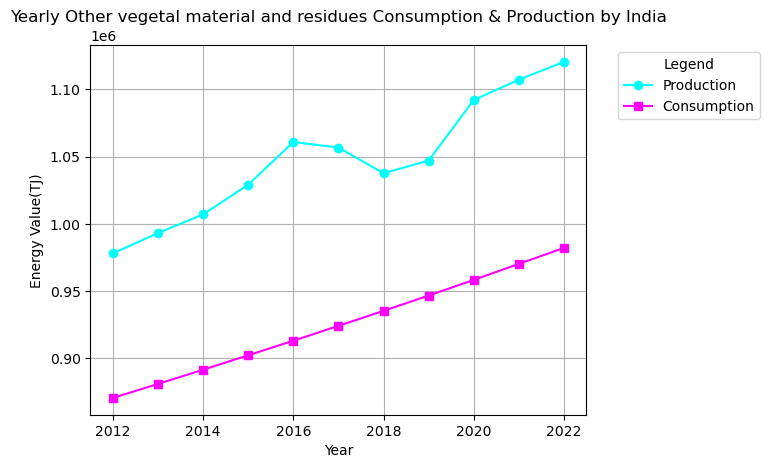

In [275]:
df_vegetal_india = df_production[(df_production['Area'] == 'India') & (df_production['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_vegetal_india_c = df_consumption[(df_consumption['Area'] == 'India') & (df_consumption['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_vegetal_india.index, df_vegetal_india.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_vegetal_india_c.index, df_vegetal_india_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Other vegetal material and residues Consumption & Production by India')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

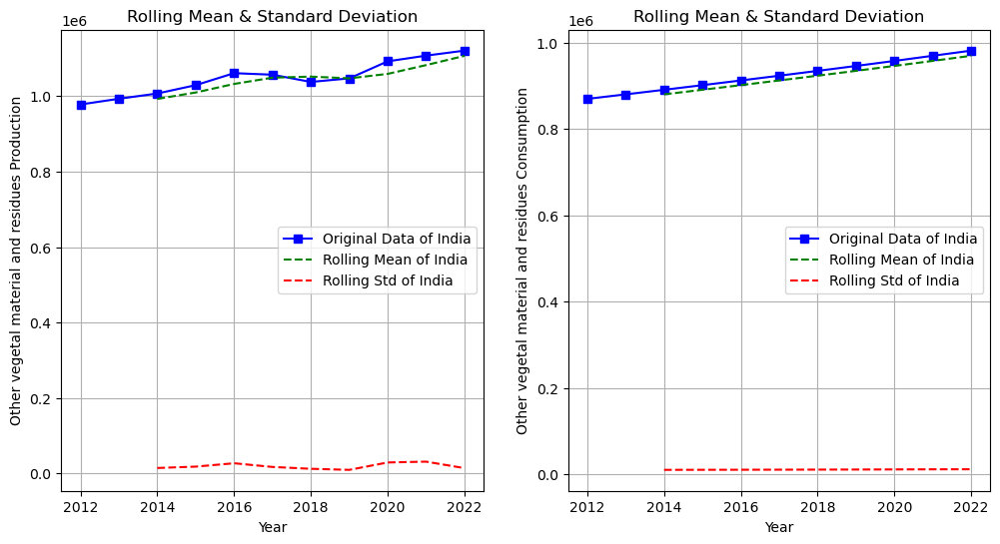

In [276]:
rolling_mean = df_vegetal_india.rolling(window=3).mean()
rolling_std = df_vegetal_india.rolling(window=3).std()
rolling_mean_c = df_vegetal_india_c.rolling(window=3).mean()
rolling_std_c = df_vegetal_india_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_vegetal_india, label='Original Data of India', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of India', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of India', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Other vegetal material and residues Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_vegetal_india_c, label='Original Data of India', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of India', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of India', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Other vegetal material and residues Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [277]:
adf_statistic = adfuller(df_vegetal_india['Value'])[0]
p_value = adfuller(df_vegetal_india['Value'])[1]
critical_points = adfuller(df_vegetal_india['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.20406804343963025
p-value: 0.9380349771391355
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [278]:
df_vegetal_india['Differenced Production'] = df_vegetal_india['Value'].diff()
adf_statistic = adfuller(df_vegetal_india['Differenced Production'].dropna())[0]
p_value = adfuller(df_vegetal_india['Differenced Production'].dropna())[1]
critical_points = adfuller(df_vegetal_india['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.3644814405883925
p-value: 0.5991808064464501
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [279]:
df_vegetal_india['Differenced Production 2'] = df_vegetal_india['Differenced Production'].diff()
adf_statistic = adfuller(df_vegetal_india['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_vegetal_india['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_vegetal_india['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.4685410800359797
p-value: 0.008832752286523355
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

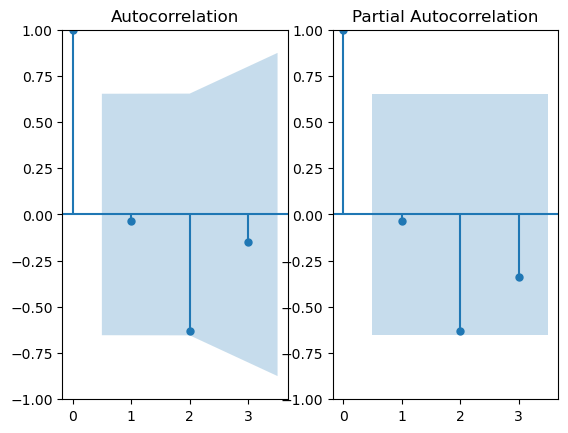

In [280]:
fig, ax = plt.subplots(1,2)
plot_acf(df_vegetal_india['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_vegetal_india['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [281]:
arima_1 = ARIMA(df_vegetal_india['Value'], order=(2,2,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_vegetal_india['Value'], order=(2,2,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_vegetal_india['Value'], order=(0,2,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_vegetal_india['Value'], order=(0,2,2))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 2, 2)   Log Likelihood              -46269.112
Date:                Tue, 25 Mar 2025   AIC                          92548.224
Time:                        00:38:06   BIC                          92549.210
Sample:                             0   HQIC                         92546.096
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9286      0.000   4679.014      0.000       0.928       0.929
ar.L2         -0.4360   3.61e-05  -1.21e+04      0.000      -0.436      -0.436
ma.L1         -1.9893      0.000  -8328.461      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  

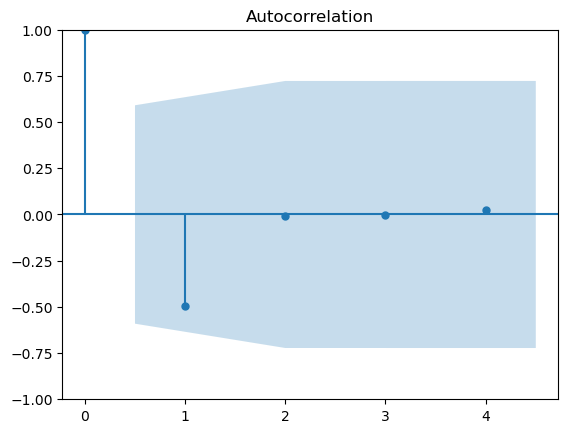

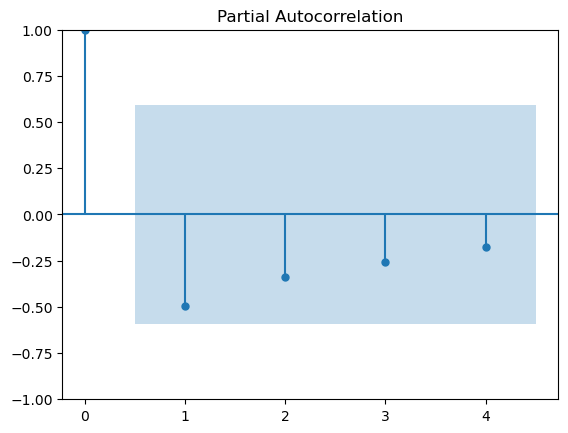

In [282]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


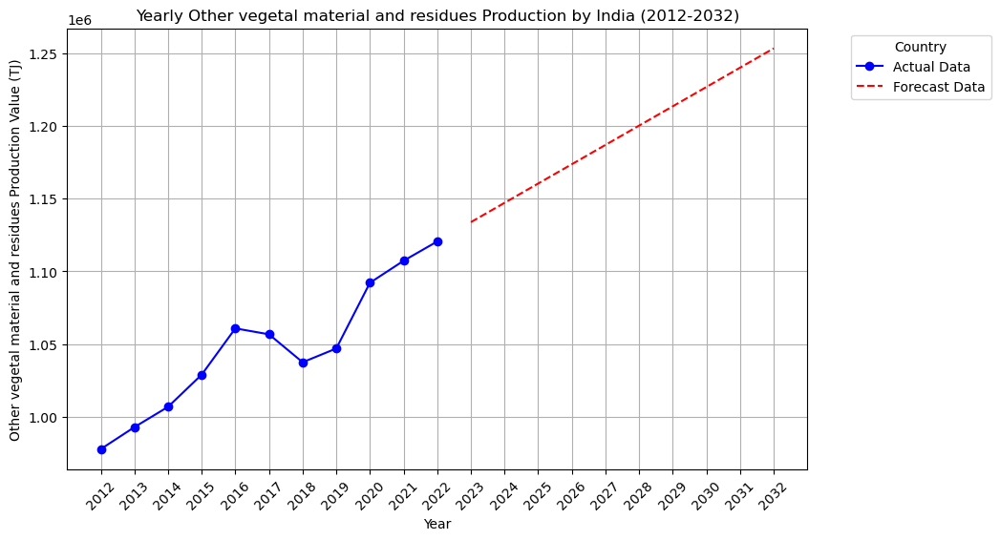

In [283]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_india.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_india.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_india.index ,df_vegetal_india['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Production Value (TJ)')
plt.title('Yearly Other vegetal material and residues Production by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Energy Consumption

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Che

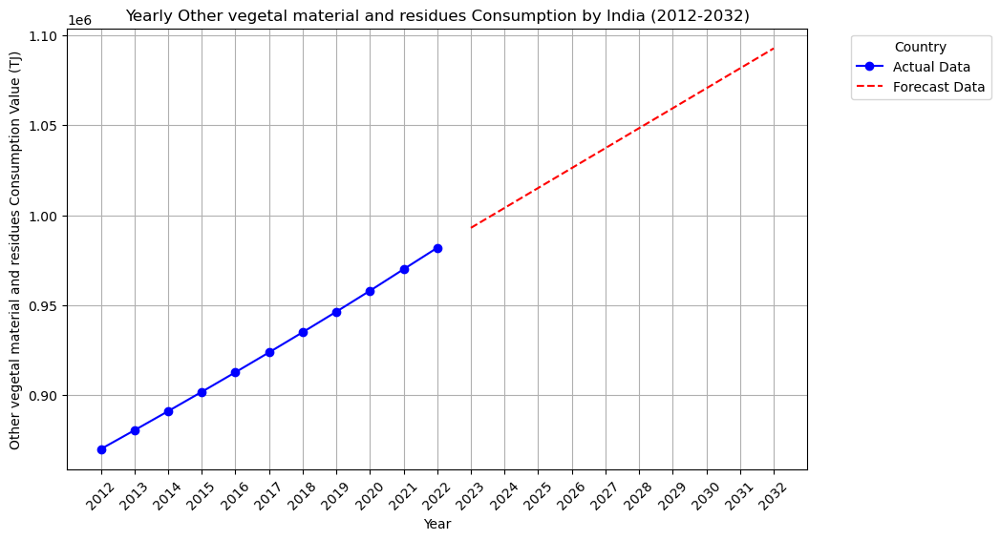

In [284]:
arima = ARIMA(df_vegetal_india_c['Value'], order=(1,1,1))
arima_fit = arima.fit()

forecast_years = 10
forecast_c = arima_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_india_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_india_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_india_c.index ,df_vegetal_india_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Consumption Value (TJ)')
plt.title('Yearly Other vegetal material and residues Consumption by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER VEGETAL MATERIAL AND RESIDUES PRODUCTION AND CONSUMPTION IN INDIA FORECAST

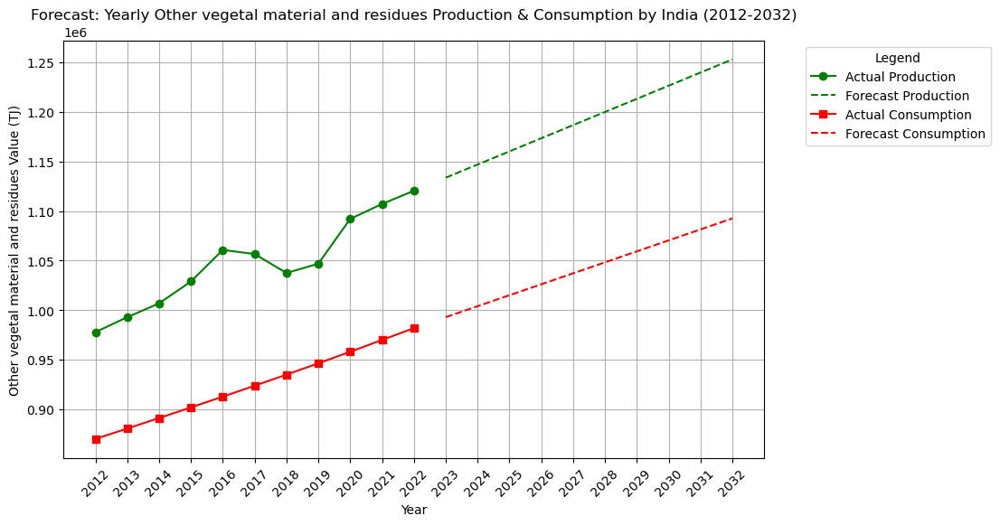

In [285]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_vegetal_india.index, df_vegetal_india['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_vegetal_india_c.index, df_vegetal_india_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Value (TJ)')
plt.title('Forecast: Yearly Other vegetal material and residues Production & Consumption by India (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_vegetal_india.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Vegetal Material Forecast/Forecast of Yearly Other vegetal material and residues Production & Consumption by India (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Other vegetal material and residues Production in Indonesia</B>

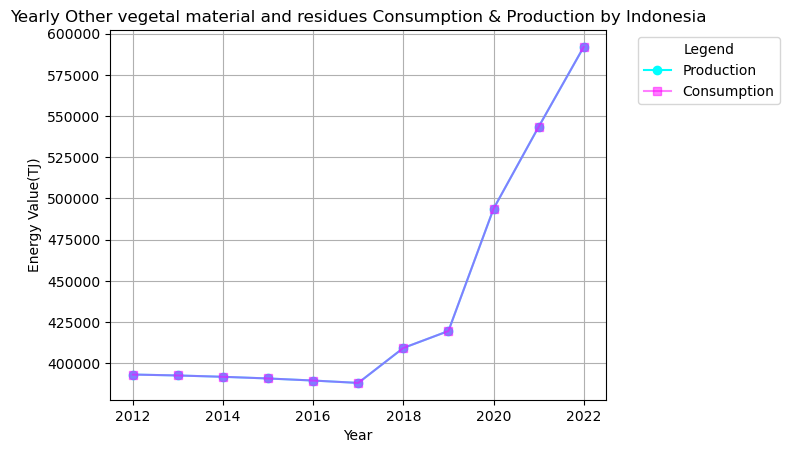

In [286]:
df_vegetal_indonesia = df_production[(df_production['Area'] == 'Indonesia') & (df_production['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_vegetal_indonesia_c = df_consumption[(df_consumption['Area'] == 'Indonesia') & (df_consumption['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_vegetal_indonesia.index, df_vegetal_indonesia.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_vegetal_indonesia_c.index, df_vegetal_indonesia_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Other vegetal material and residues Consumption & Production by Indonesia')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

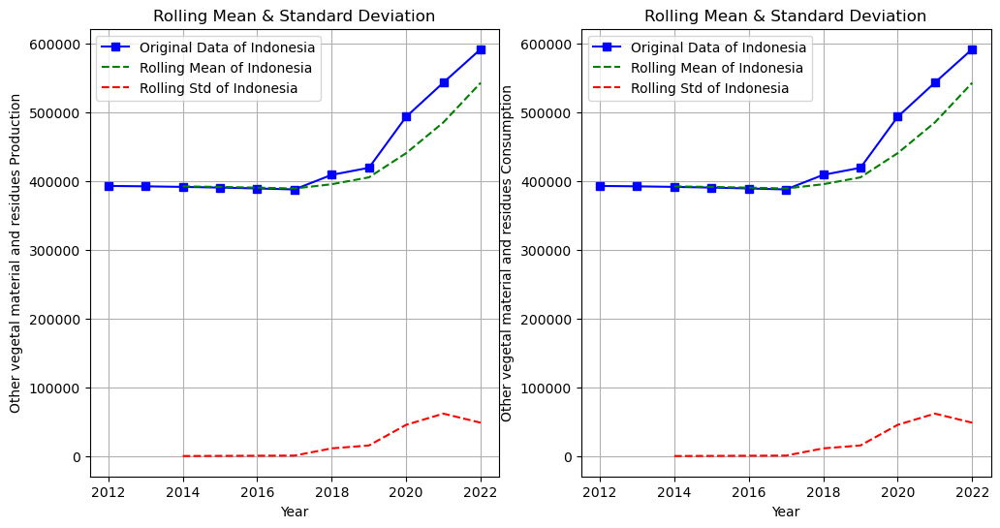

In [287]:
rolling_mean = df_vegetal_indonesia.rolling(window=3).mean()
rolling_std = df_vegetal_indonesia.rolling(window=3).std()
rolling_mean_c = df_vegetal_indonesia_c.rolling(window=3).mean()
rolling_std_c = df_vegetal_indonesia_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_vegetal_indonesia, label='Original Data of Indonesia', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Indonesia', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Other vegetal material and residues Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_vegetal_indonesia_c, label='Original Data of Indonesia', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Indonesia', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Other vegetal material and residues Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [288]:
adf_statistic = adfuller(df_vegetal_indonesia['Value'])[0]
p_value = adfuller(df_vegetal_indonesia['Value'])[1]
critical_points = adfuller(df_vegetal_indonesia['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.787365928508321
p-value: 4.963374615416015e-07
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

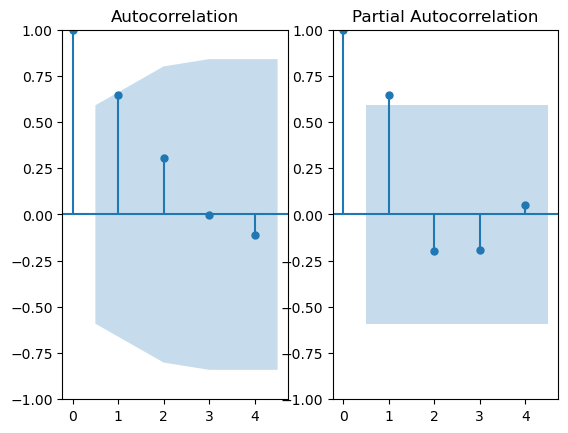

In [289]:
fig, ax = plt.subplots(1,2)
plot_acf(df_vegetal_indonesia['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_vegetal_indonesia['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [290]:
arima_1 = ARIMA(df_vegetal_indonesia['Value'], order=(1,0,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 0)   Log Likelihood                -131.113
Date:                Tue, 25 Mar 2025   AIC                            268.227
Time:                        00:38:10   BIC                            269.421
Sample:                             0   HQIC                           267.474
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.367e+05   1.93e+05      2.262      0.024    5.83e+04    8.15e+05
ar.L1          0.9470      0.143      6.630      0.000       0.667       1.227
sigma2      9.752e+08     85.715   1.14e+07      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


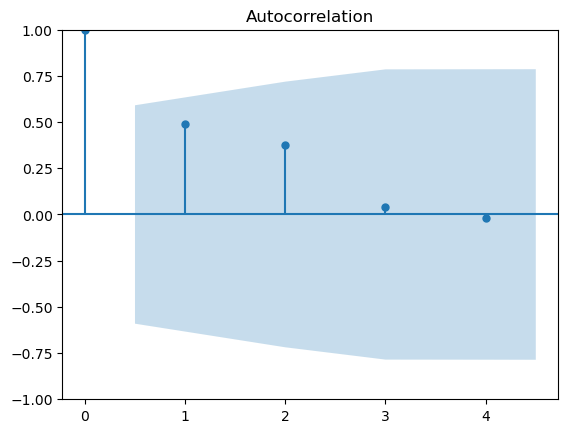

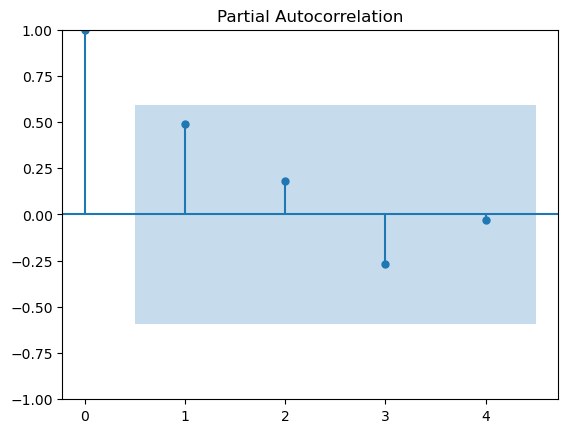

In [291]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


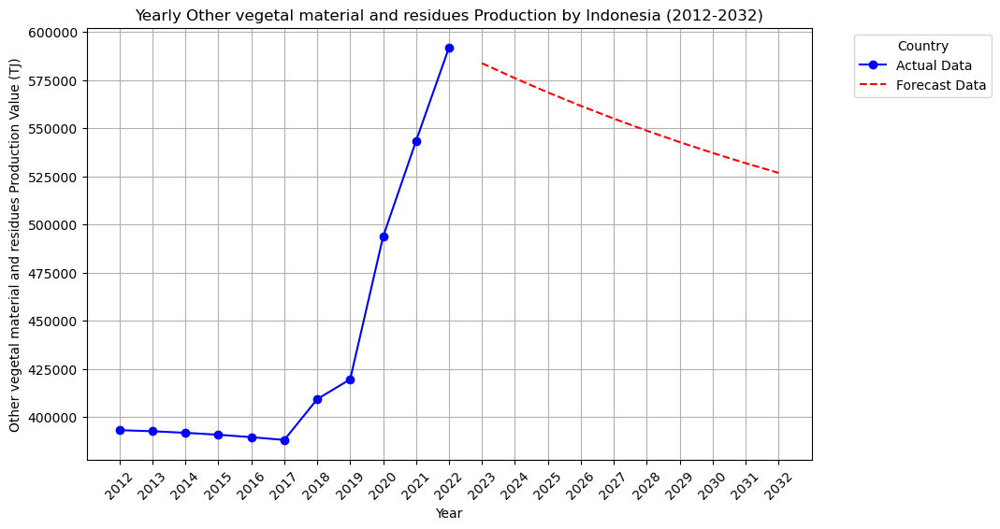

In [292]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_indonesia.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_indonesia.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_indonesia.index ,df_vegetal_indonesia['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Production Value (TJ)')
plt.title('Yearly Other vegetal material and residues Production by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER VEGETAL MATERIAL AND RESIDUES PRODUCTION AND CONSUMPTION IN INDONESIA FORECAST

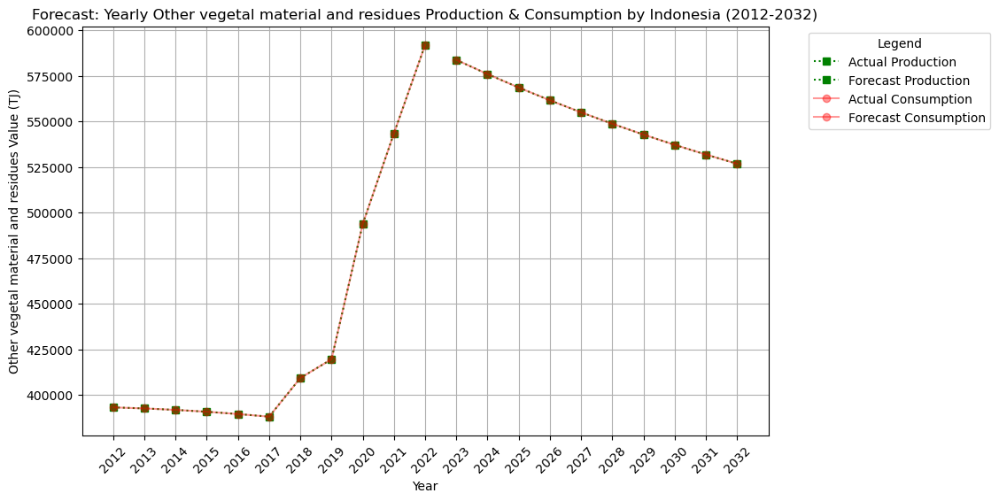

In [293]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_vegetal_indonesia.index, df_vegetal_indonesia['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_vegetal_indonesia.index, df_vegetal_indonesia['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Value (TJ)')
plt.title('Forecast: Yearly Other vegetal material and residues Production & Consumption by Indonesia (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_vegetal_indonesia.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Vegetal Material Forecast/Forecast of Yearly Other vegetal material and residues Production & Consumption by Indonesia (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Other vegetal material and residues Production in Thailand</B>

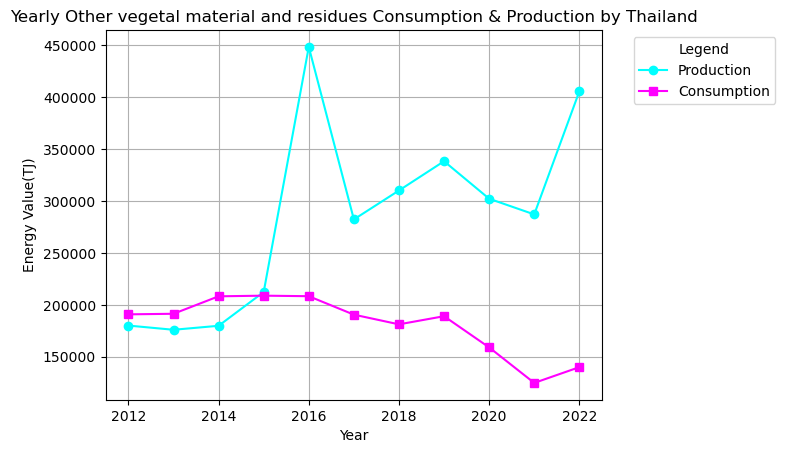

In [294]:
df_vegetal_thailand = df_production[(df_production['Area'] == 'Thailand') & (df_production['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_vegetal_thailand_c = df_consumption[(df_consumption['Area'] == 'Thailand') & (df_consumption['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_vegetal_thailand.index, df_vegetal_thailand.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_vegetal_thailand_c.index, df_vegetal_thailand_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Other vegetal material and residues Consumption & Production by Thailand')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

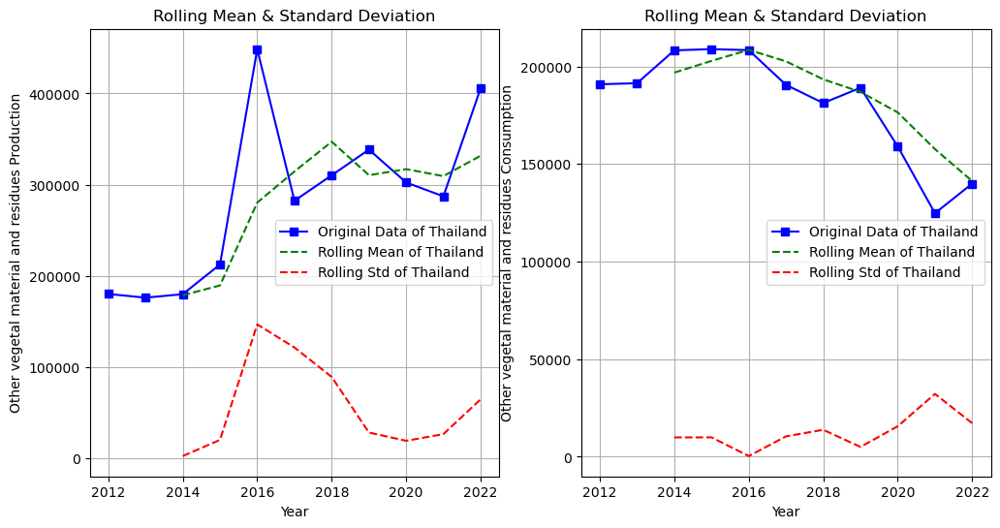

In [295]:
rolling_mean = df_vegetal_thailand.rolling(window=3).mean()
rolling_std = df_vegetal_thailand.rolling(window=3).std()
rolling_mean_c = df_vegetal_thailand_c.rolling(window=3).mean()
rolling_std_c = df_vegetal_thailand_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_vegetal_thailand, label='Original Data of Thailand', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Thailand', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Thailand', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Other vegetal material and residues Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_vegetal_thailand_c, label='Original Data of Thailand', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Thailand', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Thailand', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Other vegetal material and residues Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [296]:
adf_statistic = adfuller(df_vegetal_thailand['Value'])[0]
p_value = adfuller(df_vegetal_thailand['Value'])[1]
critical_points = adfuller(df_vegetal_thailand['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.5899755101018669
p-value: 0.4886271824627886
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [297]:
df_vegetal_thailand['Differenced Production'] = df_vegetal_thailand['Value'].diff()
adf_statistic = adfuller(df_vegetal_thailand['Differenced Production'].dropna())[0]
p_value = adfuller(df_vegetal_thailand['Differenced Production'].dropna())[1]
critical_points = adfuller(df_vegetal_thailand['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.8834027941963316
p-value: 0.04731234829155102
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

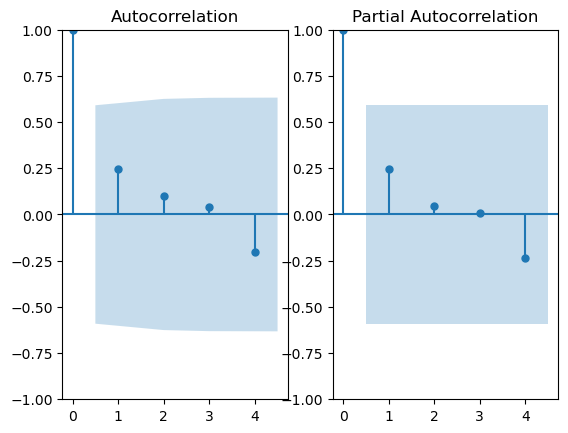

In [298]:
fig, ax = plt.subplots(1,2)
plot_acf(df_vegetal_thailand['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_vegetal_thailand['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [299]:
arima_3 = ARIMA(df_vegetal_thailand['Value'], order=(4,1,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_vegetal_thailand['Value'], order=(4,1,4))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 0)   Log Likelihood                -132.776
Date:                Tue, 25 Mar 2025   AIC                            275.551
Time:                        00:38:14   BIC                            277.064
Sample:                             0   HQIC                           273.892
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4494      0.095     -4.731      0.000      -0.636      -0.263
ar.L2         -0.0375      0.107     -0.351      0.725      -0.246       0.172
ar.L3          0.3720      0.093      3.979      0.0

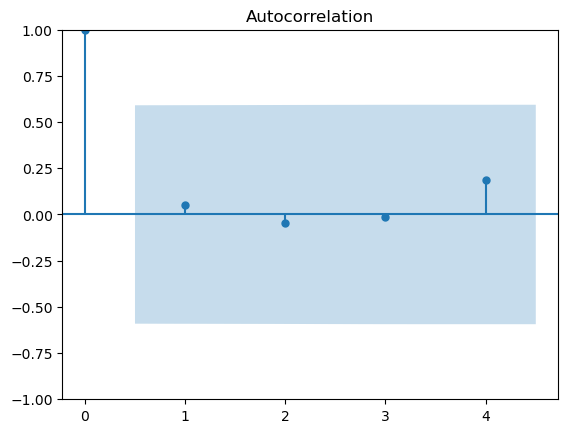

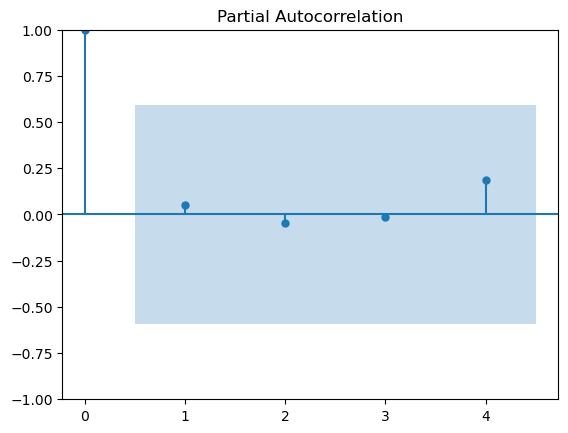

In [300]:
residuals = arima_4_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


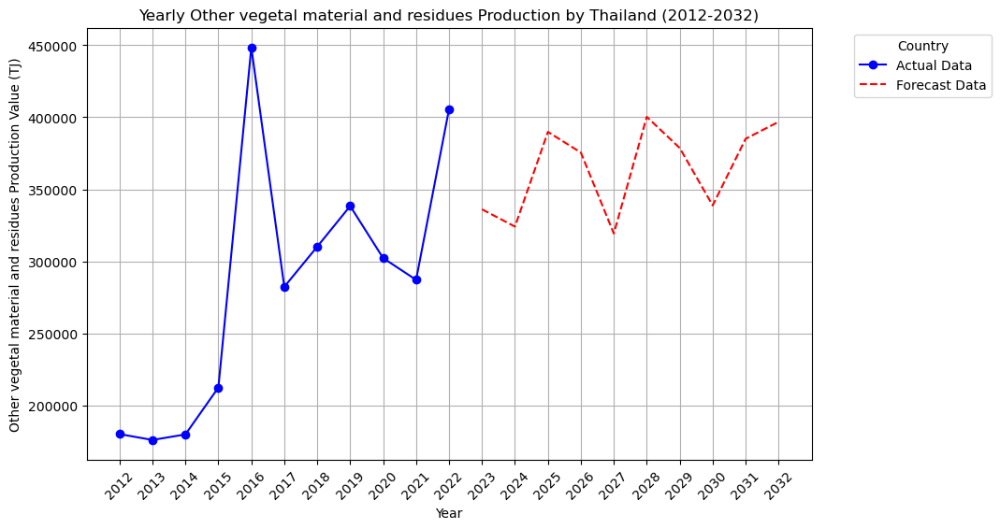

In [301]:
forecast_years = 10
forecast_p = arima_4_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_thailand.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_thailand.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_thailand.index ,df_vegetal_thailand['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Production Value (TJ)')
plt.title('Yearly Other vegetal material and residues Production by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [302]:
adf_statistic = adfuller(df_vegetal_thailand_c['Value'])[0]
p_value = adfuller(df_vegetal_thailand_c['Value'])[1]
critical_points = adfuller(df_vegetal_thailand_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.3579665102441871
p-value: 0.9168838601058547
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [303]:
df_vegetal_thailand_c['Differenced Consumption'] = df_vegetal_thailand_c['Value'].diff()

adf_statistic = adfuller(df_vegetal_thailand_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_vegetal_thailand_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_vegetal_thailand_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.9723058452026732
p-value: 0.2988464479694053
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [304]:
df_vegetal_thailand_c['Differenced Consumption 2'] = df_vegetal_thailand_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_vegetal_thailand_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_vegetal_thailand_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_vegetal_thailand_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.9091222712371168
p-value: 0.044297438688938935
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

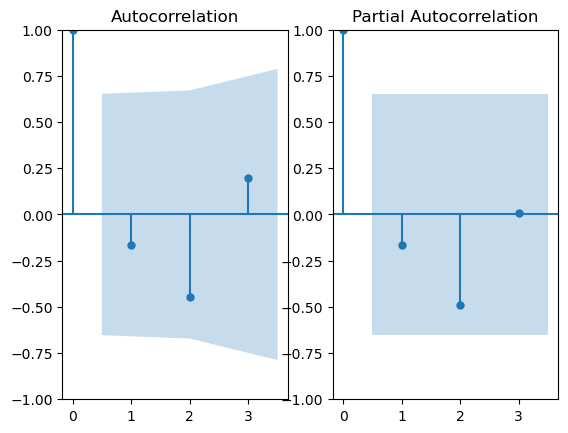

In [305]:
fig, ax = plt.subplots(1,2)
plot_acf(df_vegetal_thailand_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_vegetal_thailand_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [306]:
arima_1 = ARIMA(df_vegetal_thailand_c['Value'], order=(2,2,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_vegetal_thailand_c['Value'], order=(1,2,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_vegetal_thailand_c['Value'], order=(2,2,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_vegetal_thailand_c['Value'], order=(0,2,2))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 2, 0)   Log Likelihood                -104.574
Date:                Tue, 25 Mar 2025   AIC                            215.149
Time:                        00:38:16   BIC                            215.741
Sample:                             0   HQIC                           213.872
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1133      0.250     -0.452      0.651      -0.604       0.378
ar.L2         -0.0087      0.071     -0.122      0.903      -0.147       0.130
sigma2      2.526e+08   7.36e-10   3.43e+17      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


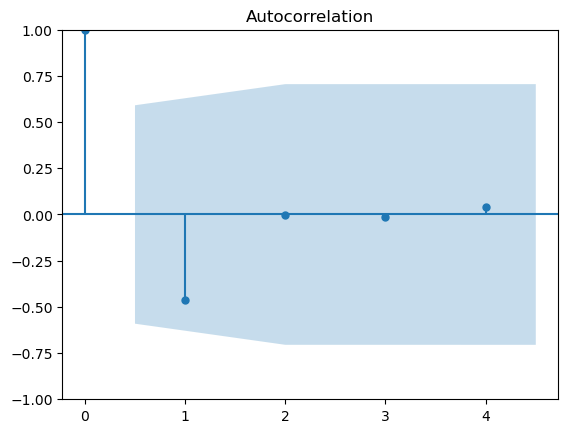

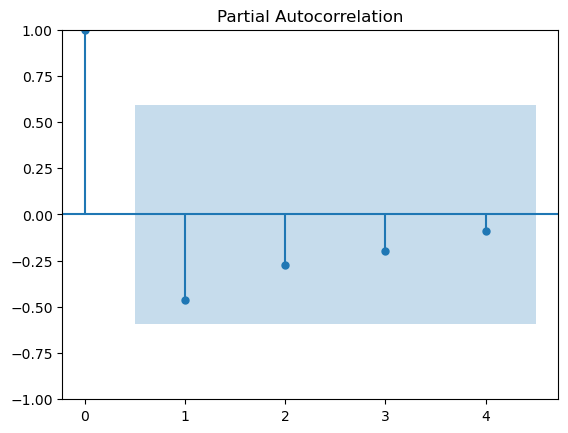

In [307]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


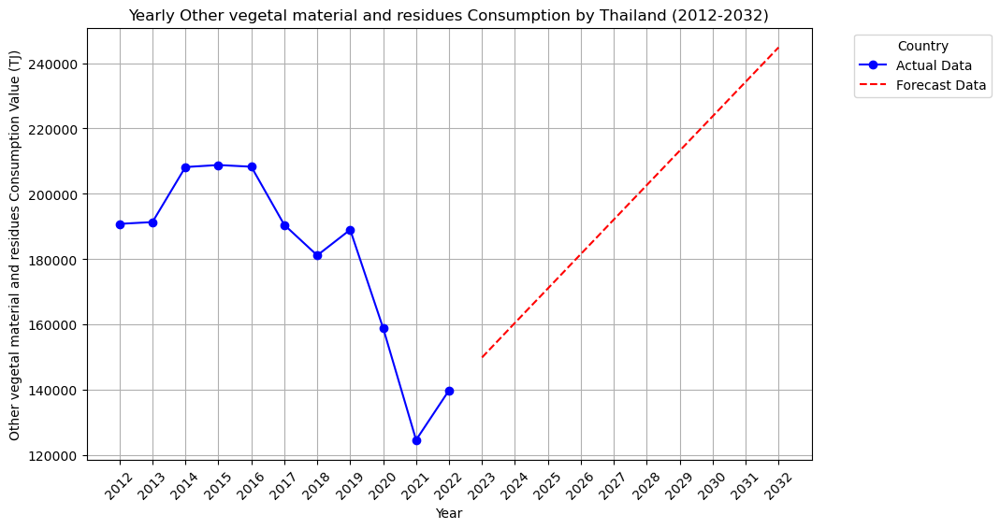

In [308]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_thailand_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_thailand_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_thailand_c.index ,df_vegetal_thailand_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Consumption Value (TJ)')
plt.title('Yearly Other vegetal material and residues Consumption by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER VEGETAL MATERIAL AND RESIDUES PRODUCTION AND CONSUMPTION IN THAILAND FORECAST

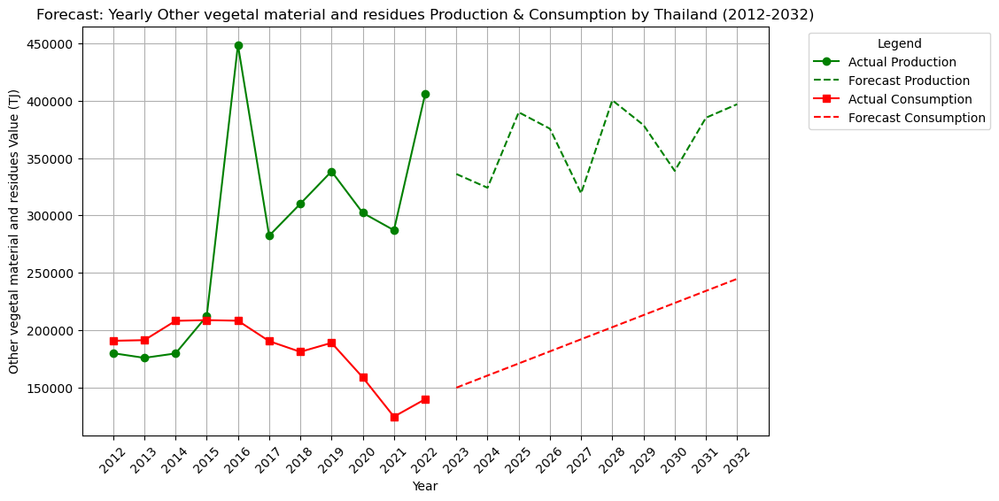

In [309]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_vegetal_thailand.index, df_vegetal_thailand['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_vegetal_thailand_c.index, df_vegetal_thailand_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Value (TJ)')
plt.title('Forecast: Yearly Other vegetal material and residues Production & Consumption by Thailand (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_vegetal_thailand.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Vegetal Material Forecast/Forecast of Yearly Other vegetal material and residues Production & Consumption by Thailand (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Other vegetal material and residues Production in Pakistan</B>

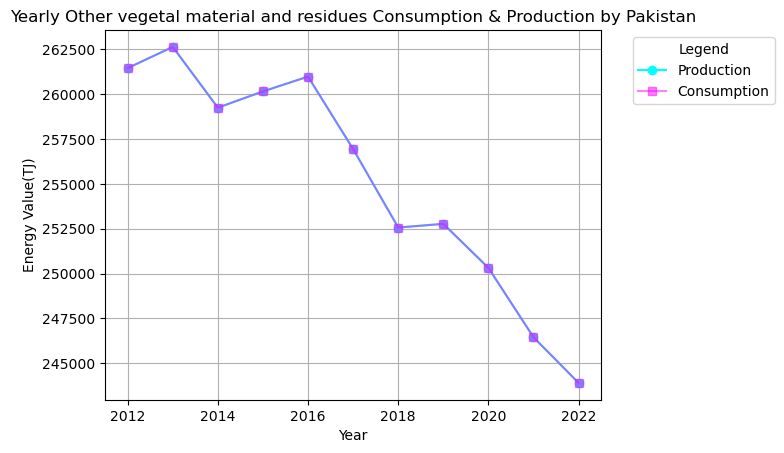

In [310]:
df_vegetal_pakistan = df_production[(df_production['Area'] == 'Pakistan') & (df_production['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_vegetal_pakistan_c = df_consumption[(df_consumption['Area'] == 'Pakistan') & (df_consumption['Item'] == 'Other vegetal material and residues')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_vegetal_pakistan.index, df_vegetal_pakistan.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_vegetal_pakistan_c.index, df_vegetal_pakistan_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Other vegetal material and residues Consumption & Production by Pakistan')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

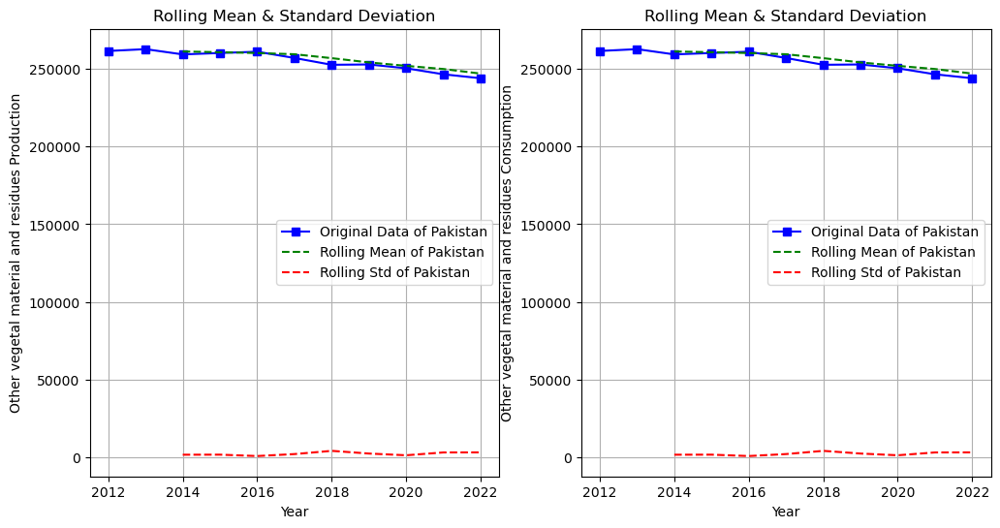

In [311]:
rolling_mean = df_vegetal_pakistan.rolling(window=3).mean()
rolling_std = df_vegetal_pakistan.rolling(window=3).std()
rolling_mean_c = df_vegetal_pakistan_c.rolling(window=3).mean()
rolling_std_c = df_vegetal_pakistan_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_vegetal_pakistan, label='Original Data of Pakistan', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Pakistan', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Pakistan', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Other vegetal material and residues Production')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_vegetal_pakistan_c, label='Original Data of Pakistan', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Pakistan', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Pakistan', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Other vegetal material and residues Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [312]:
adf_statistic = adfuller(df_vegetal_pakistan['Value'])[0]
p_value = adfuller(df_vegetal_pakistan['Value'])[1]
critical_points = adfuller(df_vegetal_pakistan['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.7650300232029046
p-value: 0.9982770785268482
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [313]:
df_vegetal_pakistan['Differenced Production'] = df_vegetal_pakistan['Value'].diff()
adf_statistic = adfuller(df_vegetal_pakistan['Differenced Production'].dropna())[0]
p_value = adfuller(df_vegetal_pakistan['Differenced Production'].dropna())[1]
critical_points = adfuller(df_vegetal_pakistan['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.960247944319342
p-value: 0.038777219933745666
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

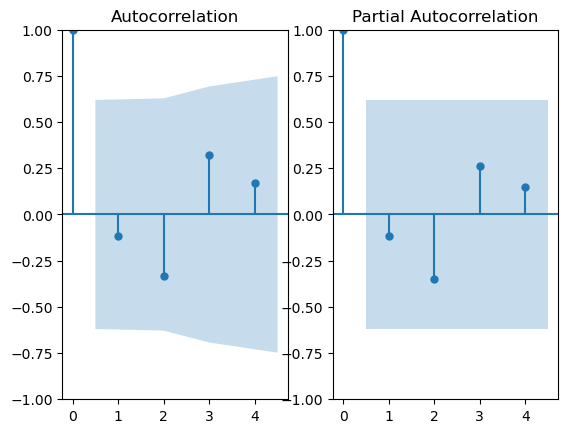

In [314]:
fig, ax = plt.subplots(1,2)
plot_acf(df_vegetal_pakistan['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_vegetal_pakistan['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [315]:
arima_1 = ARIMA(df_vegetal_pakistan['Value'], order=(0,1,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_vegetal_pakistan['Value'], order=(0,1,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_vegetal_pakistan['Value'], order=(2,1,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_vegetal_pakistan['Value'], order=(2,1,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 1, 0)   Log Likelihood                 -93.491
Date:                Tue, 25 Mar 2025   AIC                            188.982
Time:                        00:38:20   BIC                            189.285
Sample:                             0   HQIC                           188.650
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      7.661e+06   5.41e+06      1.416      0.157   -2.95e+06    1.83e+07
Ljung-Box (L1) (Q):                   0.19   Jarque-Bera (JB):                 1.28
Prob(Q):                              0.66   Pr

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


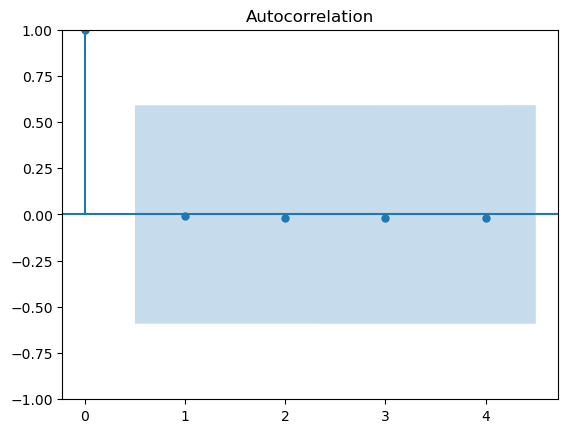

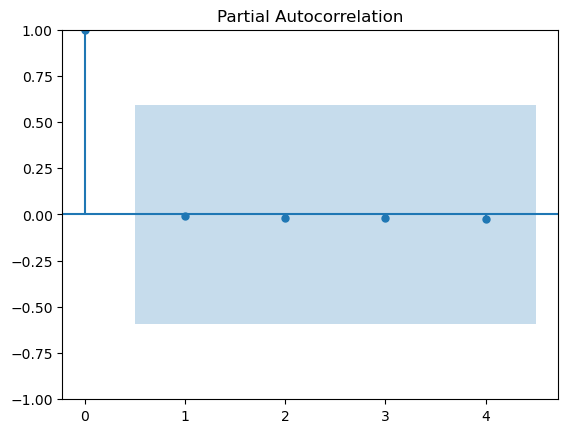

In [316]:
residuals = arima_4_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


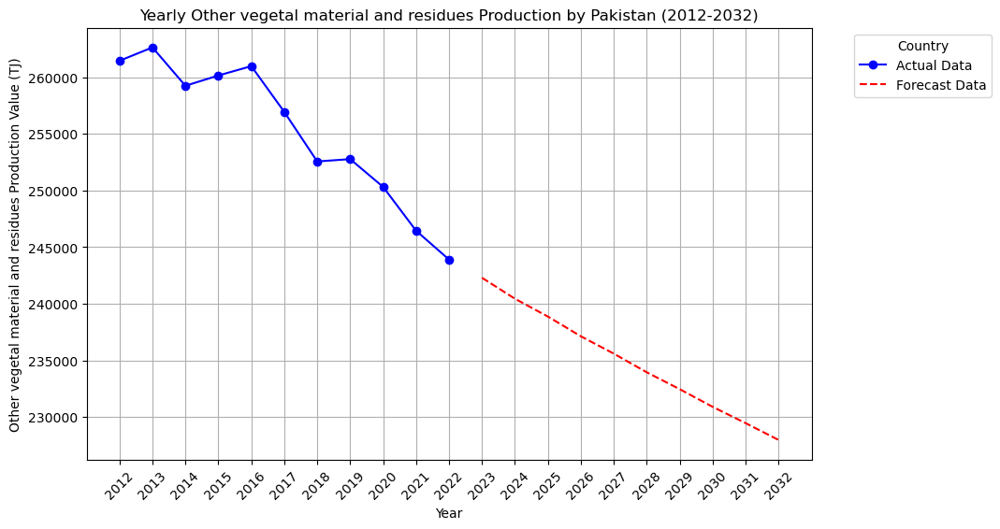

In [317]:
forecast_years = 10
forecast_p = arima_4_fit.forecast(steps=forecast_years)

last_year = int(df_vegetal_pakistan.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_vegetal_pakistan.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_vegetal_pakistan.index ,df_vegetal_pakistan['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Production Value (TJ)')
plt.title('Yearly Other vegetal material and residues Production by Pakistan (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER VEGETAL MATERIAL AND RESIDUES PRODUCTION AND CONSUMPTION IN PAKISTAN FORECAST

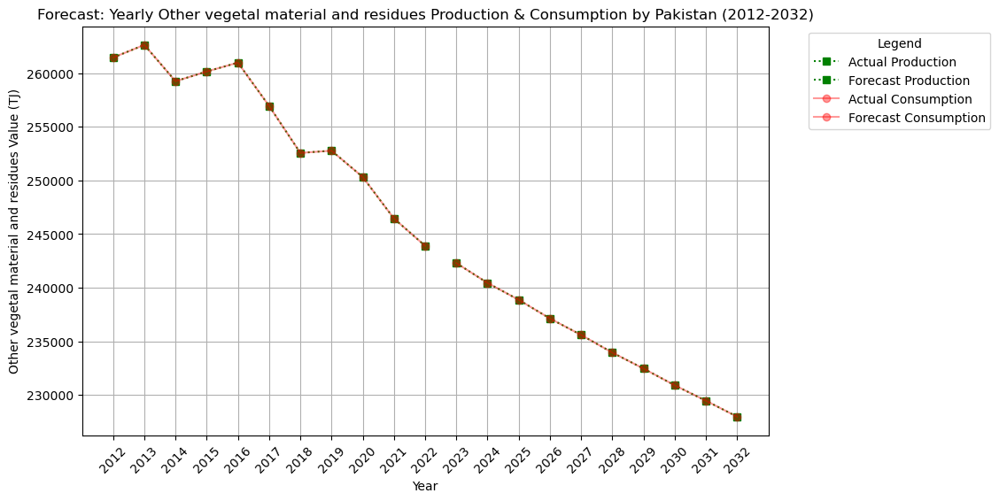

In [318]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_vegetal_pakistan.index, df_vegetal_pakistan['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_vegetal_pakistan.index, df_vegetal_pakistan['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Other vegetal material and residues Value (TJ)')
plt.title('Forecast: Yearly Other vegetal material and residues Production & Consumption by Pakistan (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_vegetal_pakistan.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Vegetal Material Forecast/Forecast of Yearly Other vegetal material and residues Production & Consumption by Pakistan (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Bagasse Production in India</B>

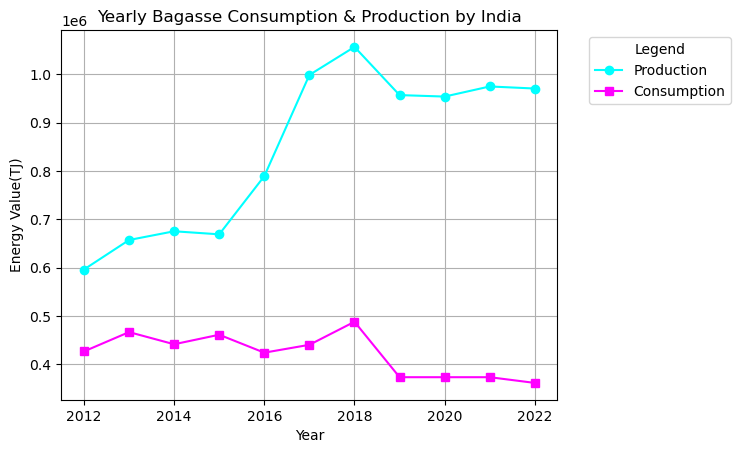

In [319]:
df_bagasse_india = df_production[(df_production['Area'] == 'India') & (df_production['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_bagasse_india_c = df_consumption[(df_consumption['Area'] == 'India') & (df_consumption['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_bagasse_india.index, df_bagasse_india.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_bagasse_india_c.index, df_bagasse_india_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Bagasse Consumption & Production by India')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

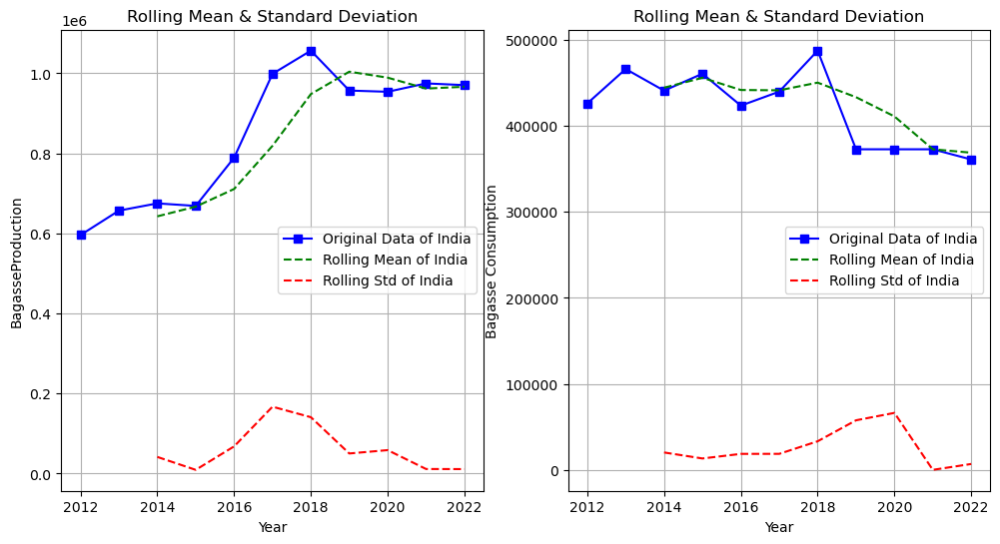

In [320]:
rolling_mean = df_bagasse_india.rolling(window=3).mean()
rolling_std = df_bagasse_india.rolling(window=3).std()
rolling_mean_c = df_bagasse_india_c.rolling(window=3).mean()
rolling_std_c = df_bagasse_india_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_bagasse_india, label='Original Data of India', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of India', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of India', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BagasseProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_bagasse_india_c, label='Original Data of India', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of India', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of India', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Bagasse Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [321]:
adf_statistic = adfuller(df_bagasse_india['Value'])[0]
p_value = adfuller(df_bagasse_india['Value'])[1]
critical_points = adfuller(df_bagasse_india['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.5336685978569318
p-value: 0.5167951247247685
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [322]:
df_bagasse_india['Differenced Production'] = df_bagasse_india['Value'].diff()
adf_statistic = adfuller(df_bagasse_india['Differenced Production'].dropna())[0]
p_value = adfuller(df_bagasse_india['Differenced Production'].dropna())[1]
critical_points = adfuller(df_bagasse_india['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.8768402994617883
p-value: 0.0022120576032580402
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

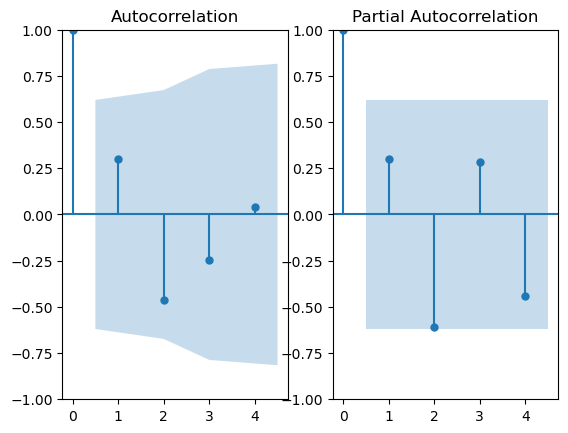

In [323]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_india['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_bagasse_india['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [324]:
arima_1 = ARIMA(df_bagasse_india['Value'], order=(2,1,3))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_3 = ARIMA(df_bagasse_india['Value'], order=(4,1,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 3)   Log Likelihood                -125.126
Date:                Tue, 25 Mar 2025   AIC                            262.251
Time:                        00:38:24   BIC                            264.067
Sample:                             0   HQIC                           260.260
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0307      1.233      0.025      0.980      -2.385       2.447
ar.L2         -0.8012      0.643     -1.246      0.213      -2.061       0.459
ma.L1          0.1591      1.300      0.122      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 3)   Log Likelihood                -123.461
Date:                Tue, 25 Mar 2025   AIC                            262.923
Time:                        00:38:25   BIC                            265.344
Sample:                             0   HQIC                           260.267
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9889      4.975      0.199      0.842      -8.763      10.740
ar.L2         -0.6220      6.563     -0.095      0.924     -13.486      12.242
ar.L3          0.0283      4.679      0.006      0.9

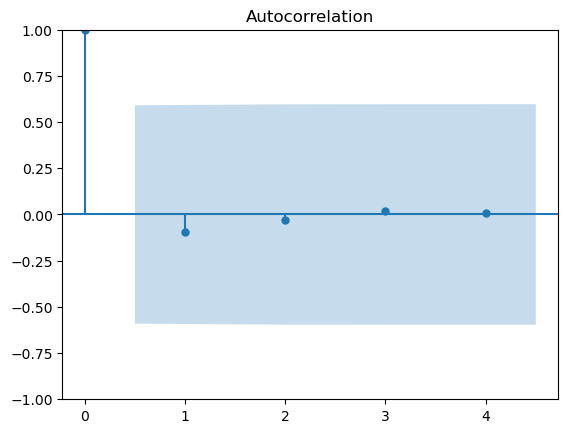

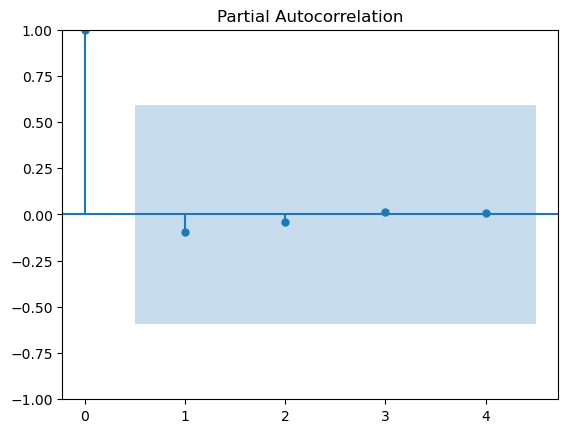

In [325]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


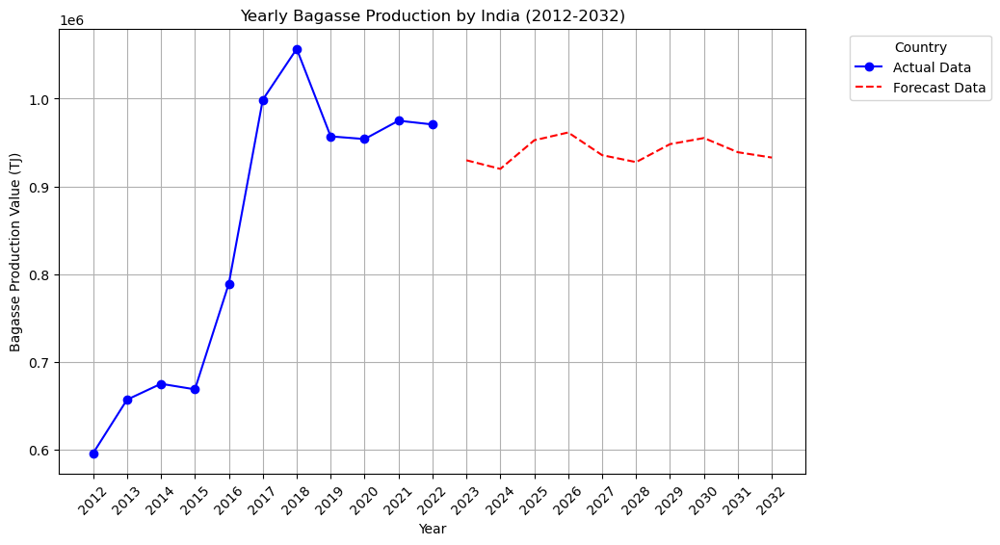

In [326]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_india.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_india.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_india.index ,df_bagasse_india['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Production Value (TJ)')
plt.title('Yearly Bagasse Production by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [327]:
adf_statistic = adfuller(df_bagasse_india_c['Value'])[0]
p_value = adfuller(df_bagasse_india_c['Value'])[1]
critical_points = adfuller(df_bagasse_india_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.419189432281962
p-value: 0.5730426772040867
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [328]:
df_bagasse_india_c['Differenced Consumption'] = df_bagasse_india_c['Value'].diff()

adf_statistic = adfuller(df_bagasse_india_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_bagasse_india_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_bagasse_india_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.49055508036351
p-value: 0.00020451319833941157
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

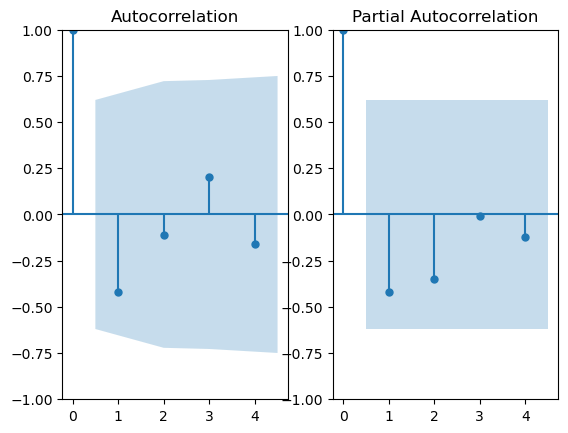

In [329]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_india_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_bagasse_india_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [330]:
arima = ARIMA(df_bagasse_india_c['Value'], order=(2,1,3))
arima_fit = arima.fit()
print(arima_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 3)   Log Likelihood                -118.342
Date:                Tue, 25 Mar 2025   AIC                            248.683
Time:                        00:38:26   BIC                            250.499
Sample:                             0   HQIC                           246.692
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.3174      1.383     -0.952      0.341      -4.029       1.394
ar.L2         -0.9512      0.773     -1.231      0.218      -2.466       0.563
ma.L1          1.4717      3.535      0.416      0.6

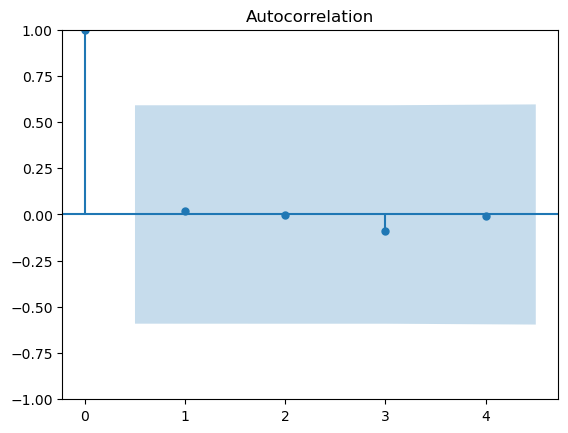

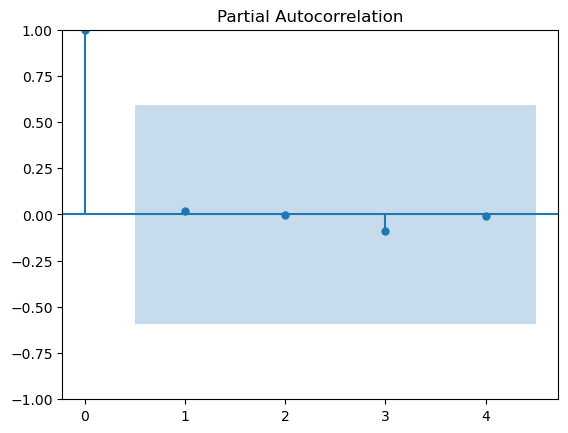

In [331]:
residuals = arima_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


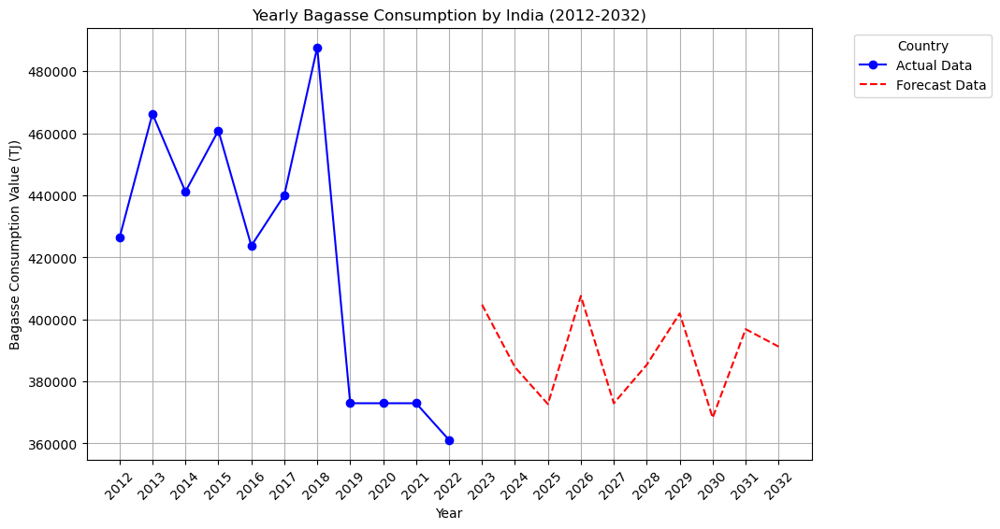

In [332]:
forecast_years = 10
forecast_c = arima_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_india_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_india_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_india_c.index ,df_bagasse_india_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Consumption Value (TJ)')
plt.title('Yearly Bagasse Consumption by India (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BAGASSE PRODUCTION AND CONSUMPTION IN INDIA FORECAST

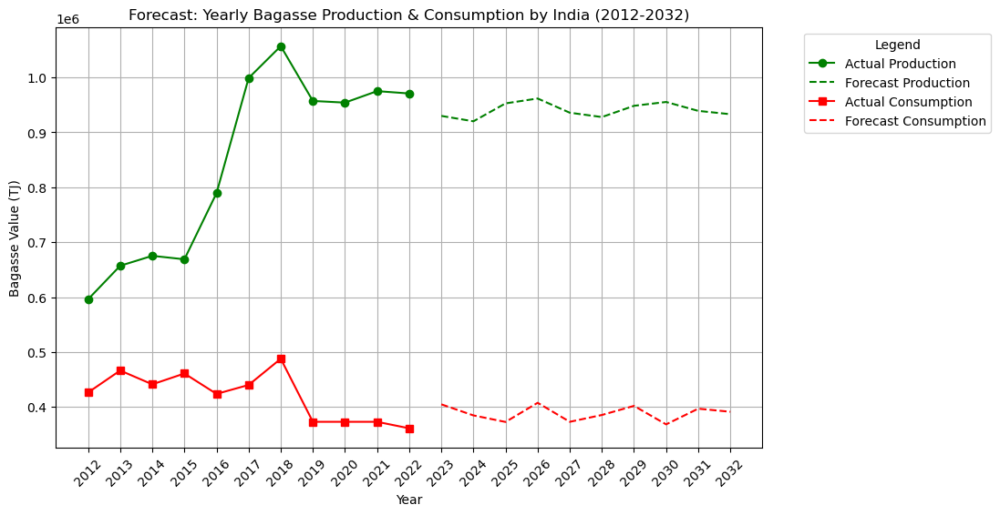

In [333]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_bagasse_india.index, df_bagasse_india['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_bagasse_india_c.index, df_bagasse_india_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Bagasse Value (TJ)')
plt.title('Forecast: Yearly Bagasse Production & Consumption by India (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_bagasse_india.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Bagasse Forecast/Forecast of Yearly Bagasse Production & Consumption by India (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Bagasse Production in China, mainland</B>

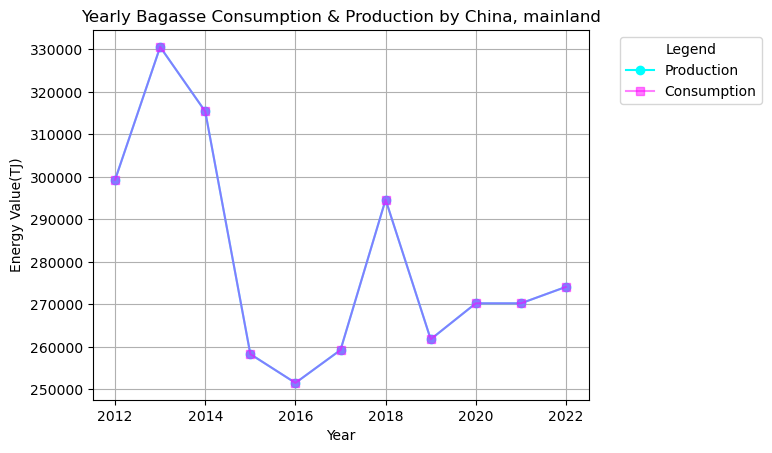

In [334]:
df_bagasse_china = df_production[(df_production['Area'] == 'China, mainland') & (df_production['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_bagasse_china_c = df_consumption[(df_consumption['Area'] == 'China, mainland') & (df_consumption['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_bagasse_china.index, df_bagasse_china.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_bagasse_china_c.index, df_bagasse_china_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Bagasse Consumption & Production by China, mainland')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

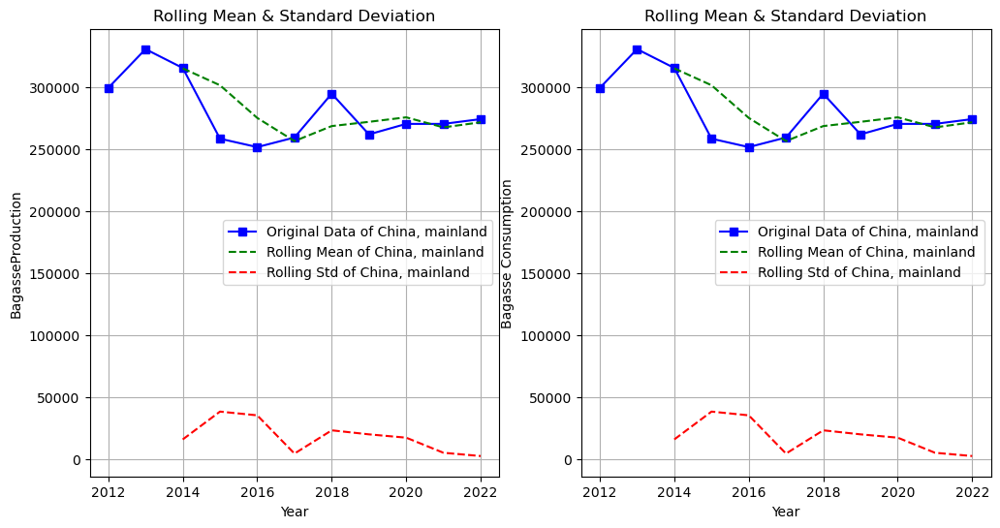

In [335]:
rolling_mean = df_bagasse_china.rolling(window=3).mean()
rolling_std = df_bagasse_china.rolling(window=3).std()
rolling_mean_c = df_bagasse_china_c.rolling(window=3).mean()
rolling_std_c = df_bagasse_china_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_bagasse_china, label='Original Data of China, mainland', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of China, mainland', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BagasseProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_bagasse_china_c, label='Original Data of China, mainland', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of China, mainland', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Bagasse Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [336]:
adf_statistic = adfuller(df_bagasse_china['Value'])[0]
p_value = adfuller(df_bagasse_china['Value'])[1]
critical_points = adfuller(df_bagasse_china['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.718563866311656
p-value: 7.027524198981707e-07
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

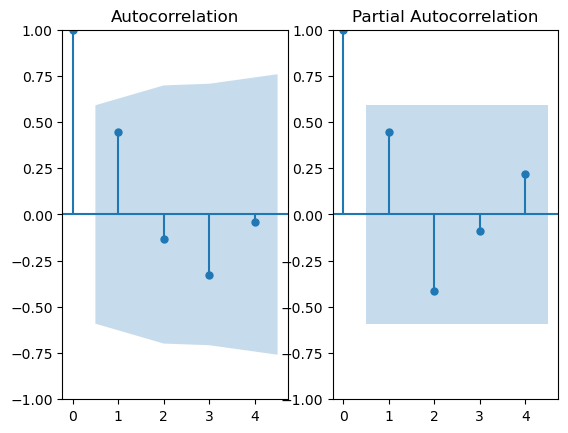

In [337]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_china['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_bagasse_china['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [338]:
arima_1 = ARIMA(df_bagasse_china['Value'], order=(1,0,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_bagasse_china['Value'], order=(2,0,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_bagasse_china['Value'], order=(1,0,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_bagasse_china['Value'], order=(2,0,1))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -125.930
Date:                Tue, 25 Mar 2025   AIC                            259.860
Time:                        00:38:30   BIC                            261.452
Sample:                             0   HQIC                           258.857
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.805e+05   8368.075     33.522      0.000    2.64e+05    2.97e+05
ar.L1          0.1982      0.398      0.498      0.619      -0.582       0.978
ma.L1          0.3662      0.402      0.910      0.3

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


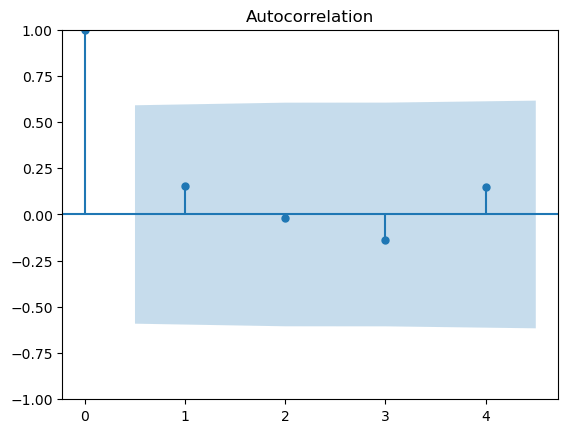

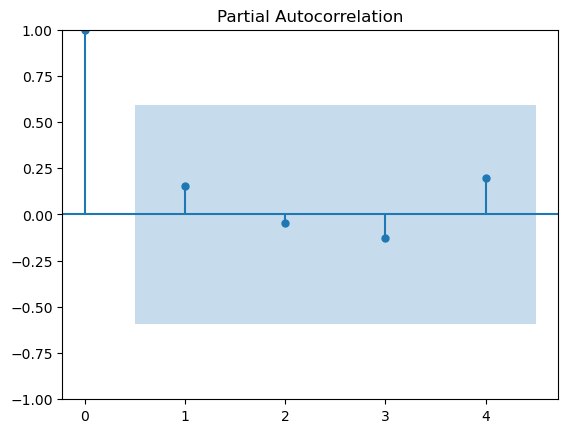

In [339]:
residuals = arima_4_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


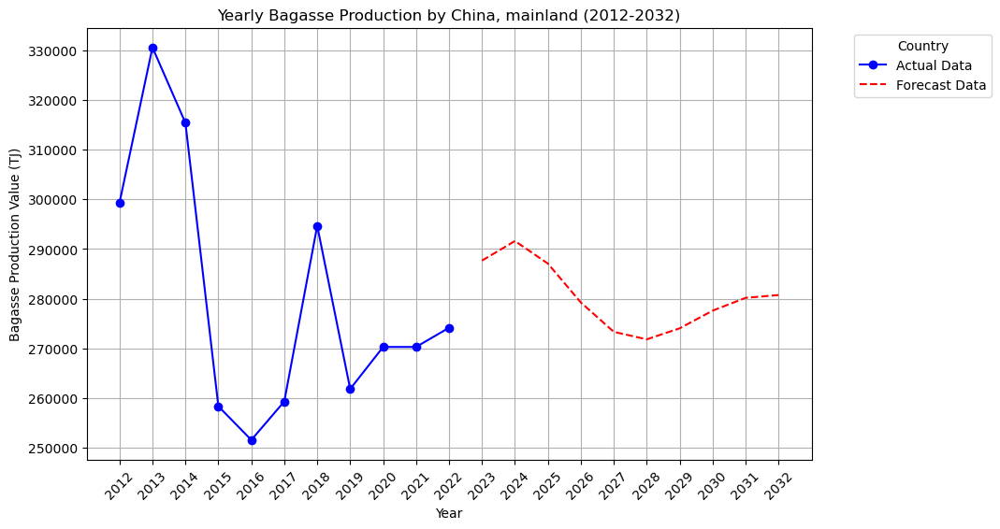

In [340]:
forecast_years = 10
forecast_p = arima_4_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_china.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_china.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_china.index ,df_bagasse_china['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Production Value (TJ)')
plt.title('Yearly Bagasse Production by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BAGASSE PRODUCTION AND CONSUMPTION IN CHINA, MAINLAND FORECAST

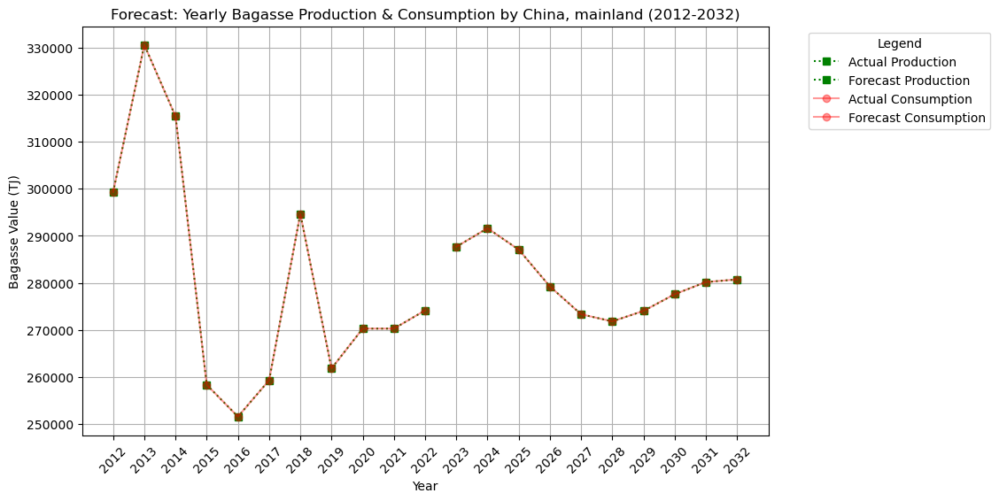

In [341]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_bagasse_china.index, df_bagasse_china['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_bagasse_china.index, df_bagasse_china['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Bagasse Value (TJ)')
plt.title('Forecast: Yearly Bagasse Production & Consumption by China, mainland (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_bagasse_china.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Bagasse Forecast/Forecast of Yearly Bagasse Production & Consumption by China, mainland (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Bagasse Production in Thailand</B>

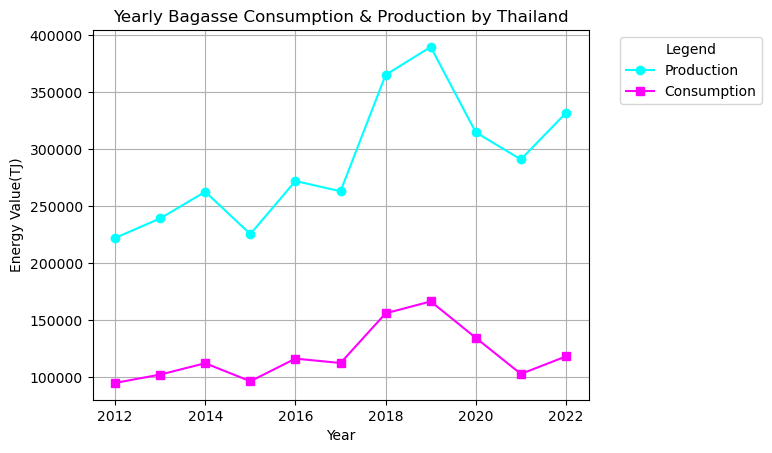

In [342]:
df_bagasse_thailand = df_production[(df_production['Area'] == 'Thailand') & (df_production['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_bagasse_thailand_c = df_consumption[(df_consumption['Area'] == 'Thailand') & (df_consumption['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_bagasse_thailand.index, df_bagasse_thailand.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_bagasse_thailand_c.index, df_bagasse_thailand_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Bagasse Consumption & Production by Thailand')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

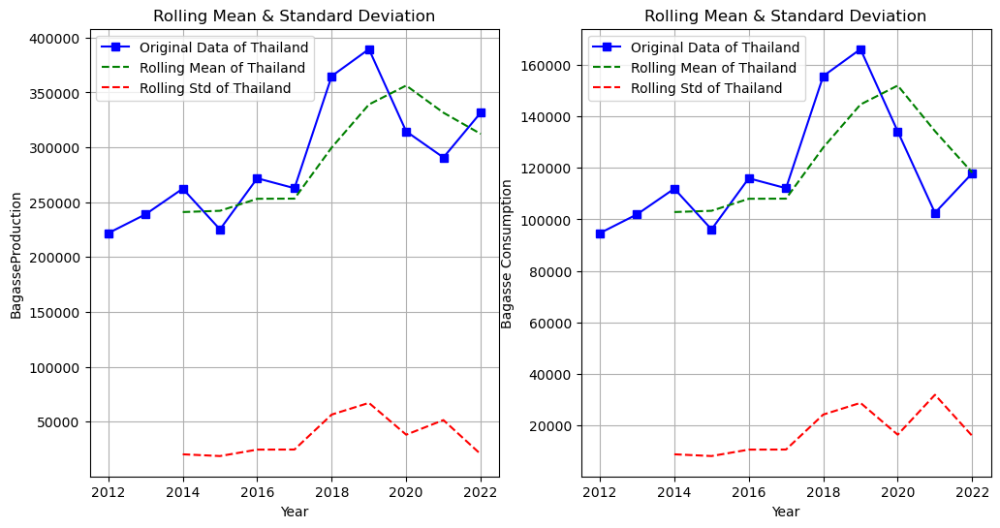

In [343]:
rolling_mean = df_bagasse_thailand.rolling(window=3).mean()
rolling_std = df_bagasse_thailand.rolling(window=3).std()
rolling_mean_c = df_bagasse_thailand_c.rolling(window=3).mean()
rolling_std_c = df_bagasse_thailand_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_bagasse_thailand, label='Original Data of Thailand', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Thailand', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Thailand', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BagasseProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_bagasse_thailand_c, label='Original Data of Thailand', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Thailand', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Thailand', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Bagasse Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [344]:
adf_statistic = adfuller(df_bagasse_thailand['Value'])[0]
p_value = adfuller(df_bagasse_thailand['Value'])[1]
critical_points = adfuller(df_bagasse_thailand['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.6027263294745404
p-value: 0.48222380750184635
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [345]:
df_bagasse_thailand['Differenced Production'] = df_bagasse_thailand['Value'].diff()
adf_statistic = adfuller(df_bagasse_thailand['Differenced Production'].dropna())[0]
p_value = adfuller(df_bagasse_thailand['Differenced Production'].dropna())[1]
critical_points = adfuller(df_bagasse_thailand['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.2705510364165447
p-value: 0.18164179030212468
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [346]:
df_bagasse_thailand['Differenced Production 2'] = df_bagasse_thailand['Differenced Production'].diff()
adf_statistic = adfuller(df_bagasse_thailand['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_bagasse_thailand['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_bagasse_thailand['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.6443443760709644
p-value: 0.004967706187004988
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

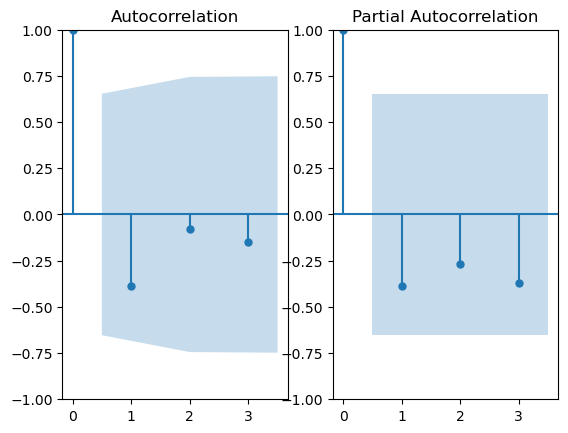

In [347]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_thailand['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_bagasse_thailand['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [348]:
arima_1 = ARIMA(df_bagasse_thailand['Value'], order=(1,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_bagasse_thailand['Value'], order=(3,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_bagasse_thailand['Value'], order=(2,2,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_bagasse_thailand['Value'], order=(1,2,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. foreca

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 1)   Log Likelihood                -112.039
Date:                Tue, 25 Mar 2025   AIC                            230.078
Time:                        00:38:34   BIC                            230.669
Sample:                             0   HQIC                           228.801
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2967      0.614      0.484      0.629      -0.906       1.499
ma.L1         -0.9171      1.085     -0.846      0.398      -3.043       1.209
sigma2      4.235e+09   3.07e-10   1.38e+19      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


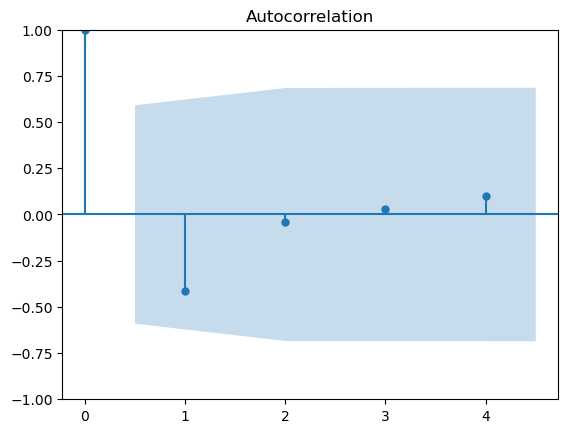

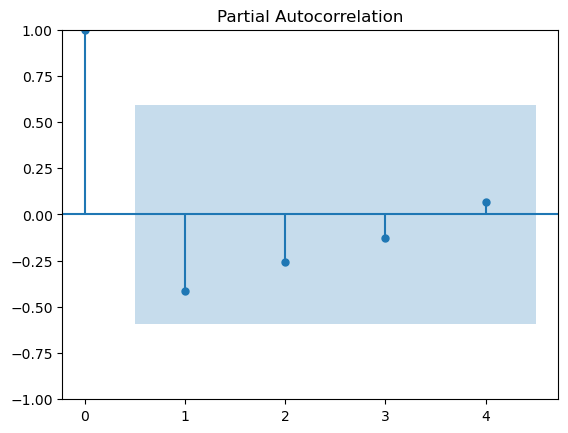

In [349]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


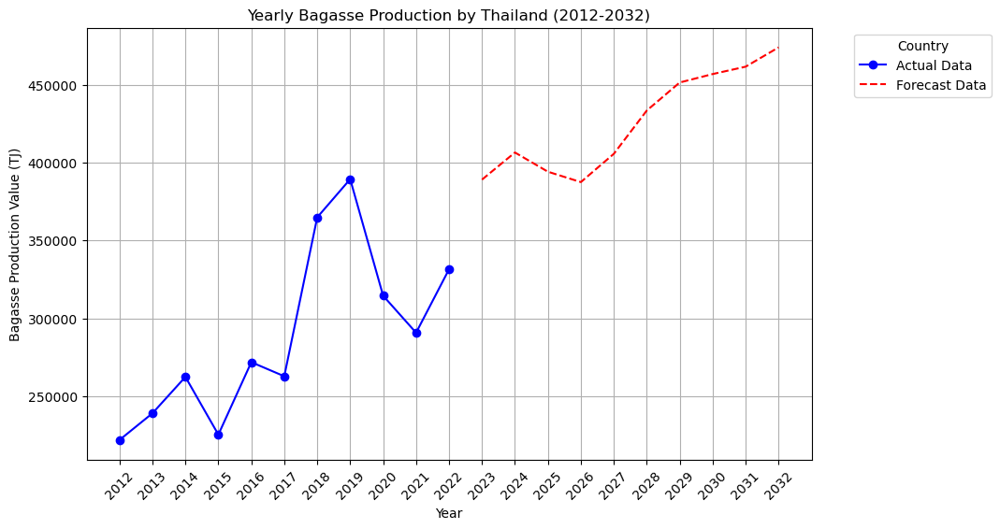

In [350]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_thailand.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_thailand.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_thailand.index ,df_bagasse_thailand['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Production Value (TJ)')
plt.title('Yearly Bagasse Production by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [351]:
adf_statistic = adfuller(df_bagasse_thailand_c['Value'])[0]
p_value = adfuller(df_bagasse_thailand_c['Value'])[1]
critical_points = adfuller(df_bagasse_thailand_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.8979050047254482
p-value: 0.3330473035754008
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [352]:
df_bagasse_thailand_c['Differenced Consumption'] = df_bagasse_thailand_c['Value'].diff()

adf_statistic = adfuller(df_bagasse_thailand_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_bagasse_thailand_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_bagasse_thailand_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.7622229816196926
p-value: 0.06387584468421745
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [353]:
df_bagasse_thailand_c['Differenced Consumption 2'] = df_bagasse_thailand_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_bagasse_thailand_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_bagasse_thailand_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_bagasse_thailand_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.235437871203797
p-value: 0.018022876380151084
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

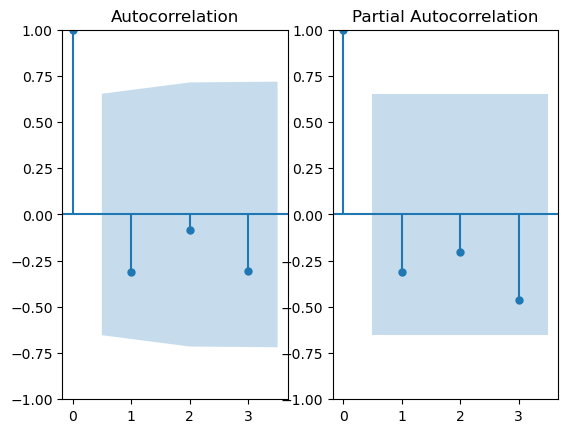

In [354]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_thailand_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_bagasse_thailand_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [355]:
arima_1 = ARIMA(df_bagasse_thailand_c['Value'], order=(3,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_bagasse_thailand_c['Value'], order=(3,2,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 2, 1)   Log Likelihood                -103.351
Date:                Tue, 25 Mar 2025   AIC                            216.702
Time:                        00:38:36   BIC                            217.688
Sample:                             0   HQIC                           214.574
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0406      1.290     -0.031      0.975      -2.570       2.489
ar.L2         -0.2789      0.571     -0.489      0.625      -1.397       0.840
ar.L3         -0.4702      0.729     -0.645      0.5

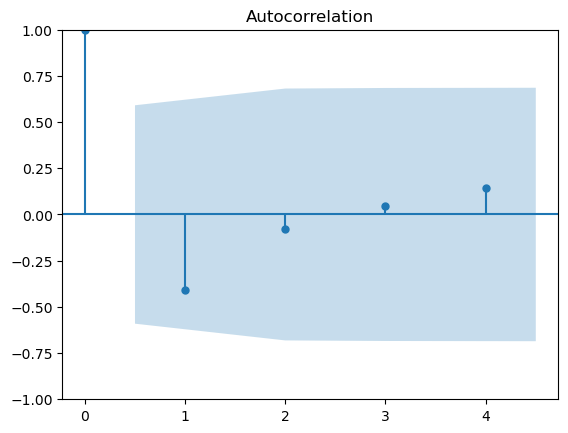

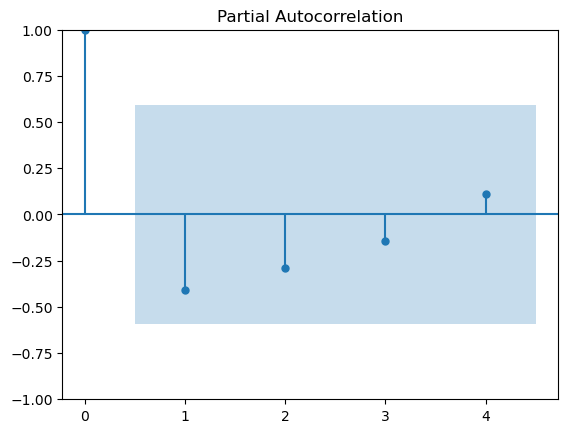

In [356]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


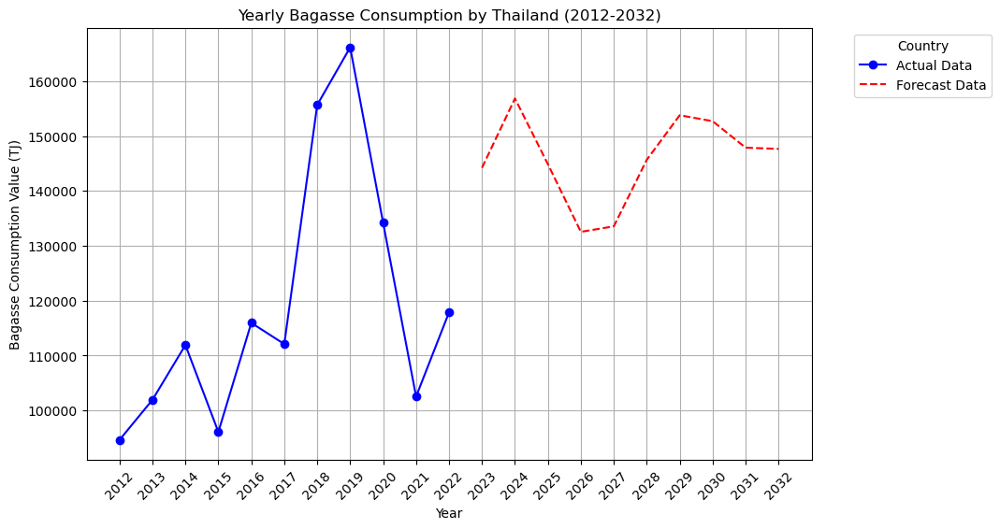

In [357]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_thailand_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_thailand_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_thailand_c.index ,df_bagasse_thailand_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Consumption Value (TJ)')
plt.title('Yearly Bagasse Consumption by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BAGASSE PRODUCTION AND CONSUMPTION IN THAILAND FORECAST

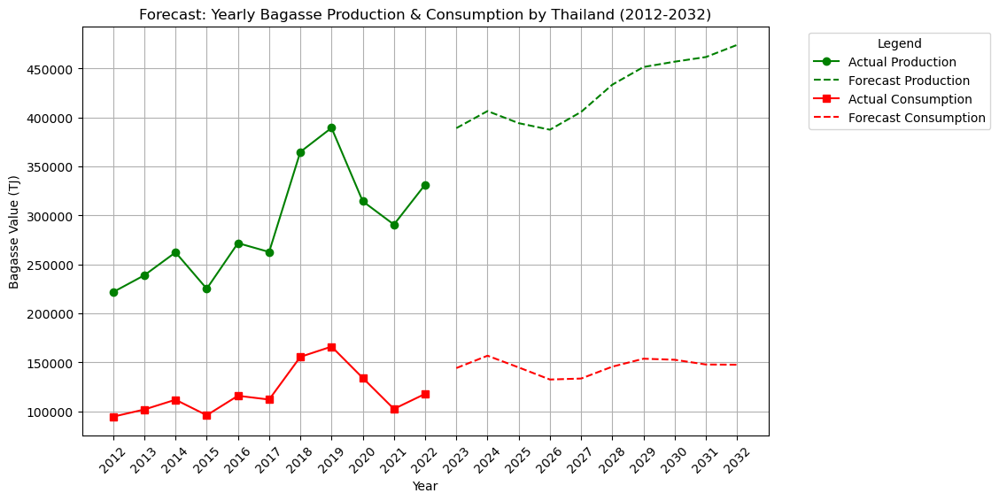

In [358]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_bagasse_thailand.index, df_bagasse_thailand['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_bagasse_thailand_c.index, df_bagasse_thailand_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Bagasse Value (TJ)')
plt.title('Forecast: Yearly Bagasse Production & Consumption by Thailand (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_bagasse_thailand.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Bagasse Forecast/Forecast of Yearly Bagasse Production & Consumption by Thailand (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Bagasse Production in Pakistan</B>

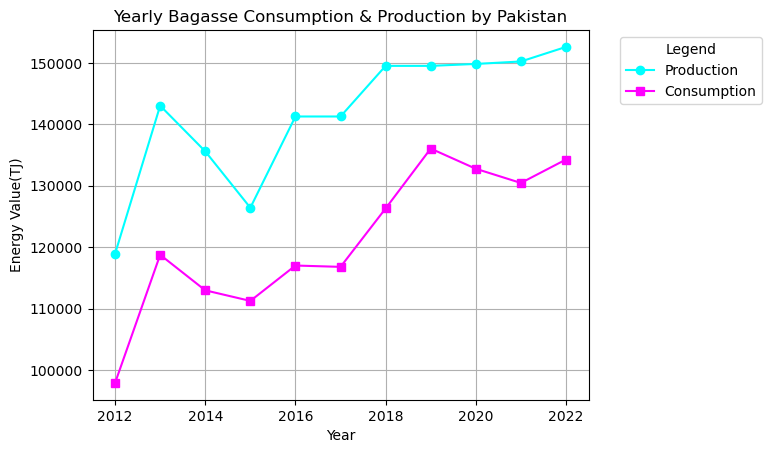

In [359]:
df_bagasse_pakistan = df_production[(df_production['Area'] == 'Pakistan') & (df_production['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_bagasse_pakistan_c = df_consumption[(df_consumption['Area'] == 'Pakistan') & (df_consumption['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_bagasse_pakistan.index, df_bagasse_pakistan.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_bagasse_pakistan_c.index, df_bagasse_pakistan_c.values, marker='s', linestyle='-', label='Consumption', color='magenta')

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Bagasse Consumption & Production by Pakistan')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

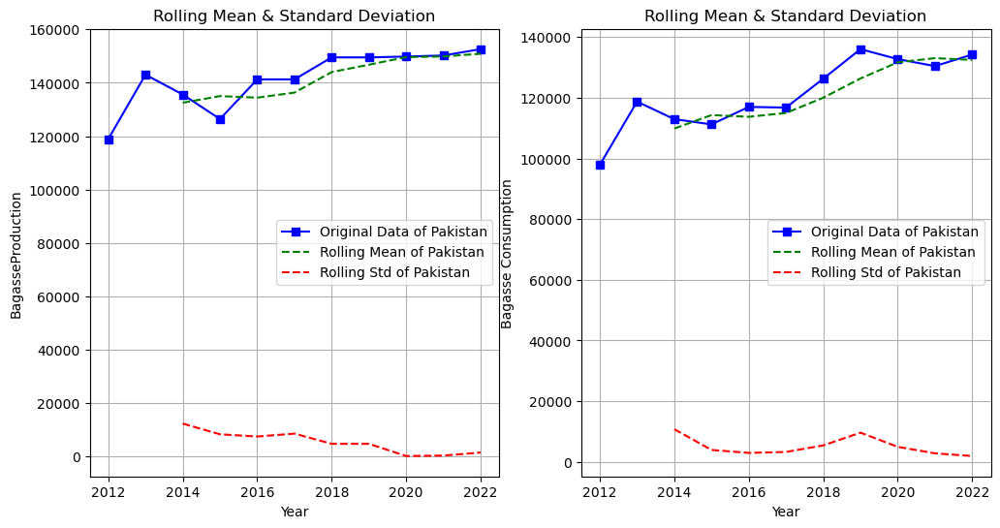

In [360]:
rolling_mean = df_bagasse_pakistan.rolling(window=3).mean()
rolling_std = df_bagasse_pakistan.rolling(window=3).std()
rolling_mean_c = df_bagasse_pakistan_c.rolling(window=3).mean()
rolling_std_c = df_bagasse_pakistan_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_bagasse_pakistan, label='Original Data of Pakistan', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Pakistan', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Pakistan', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BagasseProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_bagasse_pakistan_c, label='Original Data of Pakistan', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Pakistan', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Pakistan', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Bagasse Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [361]:
adf_statistic = adfuller(df_bagasse_pakistan['Value'])[0]
p_value = adfuller(df_bagasse_pakistan['Value'])[1]
critical_points = adfuller(df_bagasse_pakistan['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.4488863925018791
p-value: 0.9016109915782746
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [362]:
df_bagasse_pakistan['Differenced Production'] = df_bagasse_pakistan['Value'].diff()
adf_statistic = adfuller(df_bagasse_pakistan['Differenced Production'].dropna())[0]
p_value = adfuller(df_bagasse_pakistan['Differenced Production'].dropna())[1]
critical_points = adfuller(df_bagasse_pakistan['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -8.159111119331387
p-value: 9.246358671121733e-13
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

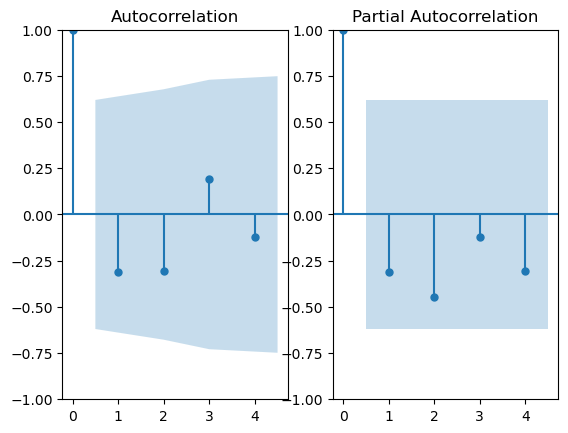

In [363]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_pakistan['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_bagasse_pakistan['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [364]:
arima_1 = ARIMA(df_bagasse_pakistan['Value'], order=(2,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_bagasse_pakistan['Value'], order=(4,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_bagasse_pakistan['Value'], order=(2,1,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_bagasse_pakistan['Value'], order=(4,1,2))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 1)   Log Likelihood                -103.153
Date:                Tue, 25 Mar 2025   AIC                            214.306
Time:                        00:38:40   BIC                            215.516
Sample:                             0   HQIC                           212.978
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2722      0.256      1.063      0.288      -0.230       0.774
ar.L2         -0.1215      0.112     -1.081      0.280      -0.342       0.099
ma.L1         -0.0565      0.299     -0.189      0.8

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 2)   Log Likelihood              -10087.838
Date:                Tue, 25 Mar 2025   AIC                          20185.676
Time:                        00:38:41   BIC                          20187.189
Sample:                             0   HQIC                         20184.016
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.9993   6.06e-05    3.3e+04      0.000       1.999       1.999
ar.L2         -0.9999   8.61e-05  -1.16e+04      0.000      -1.000      -1.000
ma.L1         -1.9995      0.000  -8284.689      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


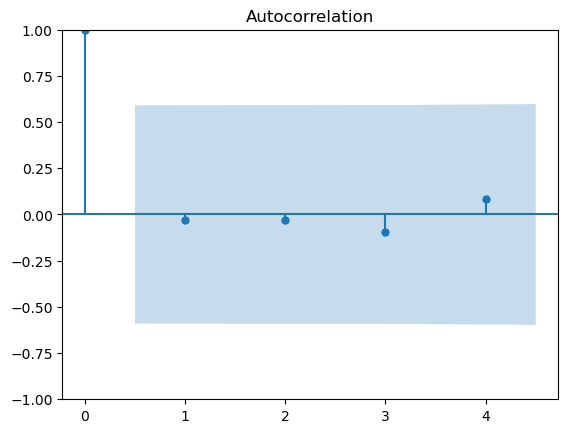

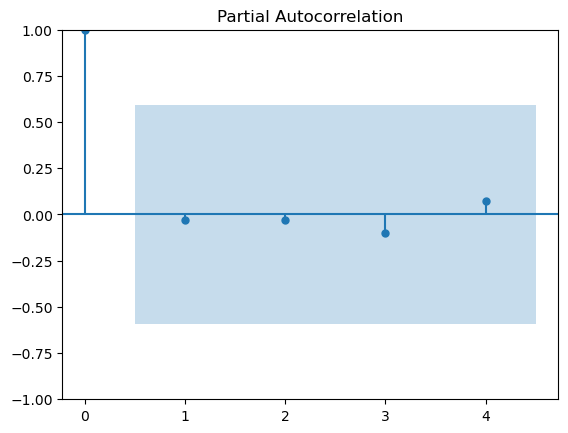

In [365]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


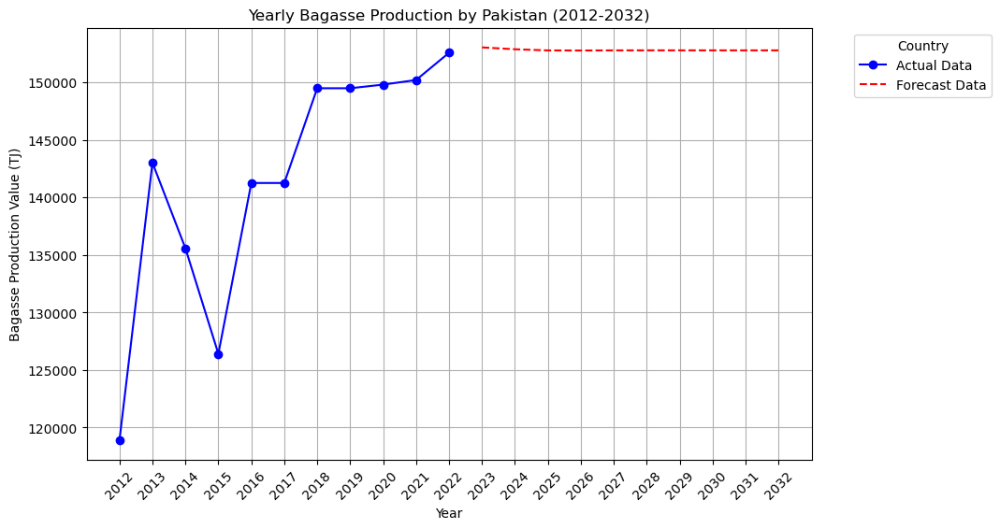

In [366]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_pakistan.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_pakistan.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_pakistan.index ,df_bagasse_pakistan['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Production Value (TJ)')
plt.title('Yearly Bagasse Production by Pakistan (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [367]:
adf_statistic = adfuller(df_bagasse_pakistan_c['Value'])[0]
p_value = adfuller(df_bagasse_pakistan_c['Value'])[1]
critical_points = adfuller(df_bagasse_pakistan_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.111621124954488
p-value: 0.23986743780576064
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [368]:
df_bagasse_pakistan_c['Differenced Consumption'] = df_bagasse_pakistan_c['Value'].diff()

adf_statistic = adfuller(df_bagasse_pakistan_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_bagasse_pakistan_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_bagasse_pakistan_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -104.43951686952171
p-value: 0.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

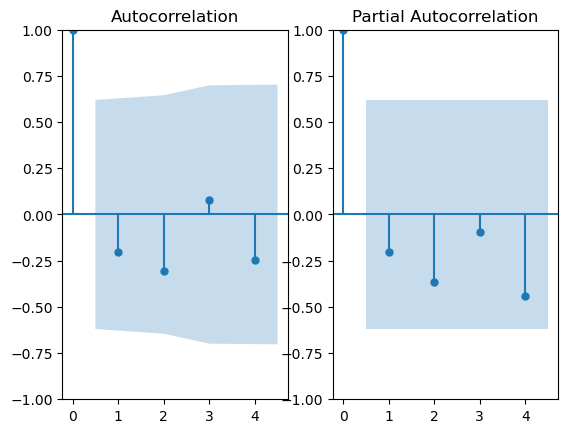

In [369]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_pakistan_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_bagasse_pakistan_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [370]:
arima_1 = ARIMA(df_bagasse_pakistan_c['Value'], order=(2,1,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_bagasse_pakistan_c['Value'], order=(4,1,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_bagasse_pakistan_c['Value'], order=(2,1,4))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_bagasse_pakistan_c['Value'], order=(4,1,4))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 2)   Log Likelihood              -12807.579
Date:                Tue, 25 Mar 2025   AIC                          25625.157
Time:                        00:38:43   BIC                          25626.670
Sample:                             0   HQIC                         25623.497
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7488      0.000  -5816.777      0.000      -0.749      -0.749
ar.L2         -0.9905   7.05e-06   -1.4e+05      0.000      -0.991      -0.991
ma.L1          1.9893      0.000   9646.117      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 4)   Log Likelihood                 -98.136
Date:                Tue, 25 Mar 2025   AIC                            214.272
Time:                        00:38:44   BIC                            216.996
Sample:                             0   HQIC                           211.285
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0055      9.887     -0.001      1.000     -19.384      19.373
ar.L2          0.1453      2.839      0.051      0.959      -5.420       5.710
ar.L3          0.7724      2.927      0.264      0.7

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


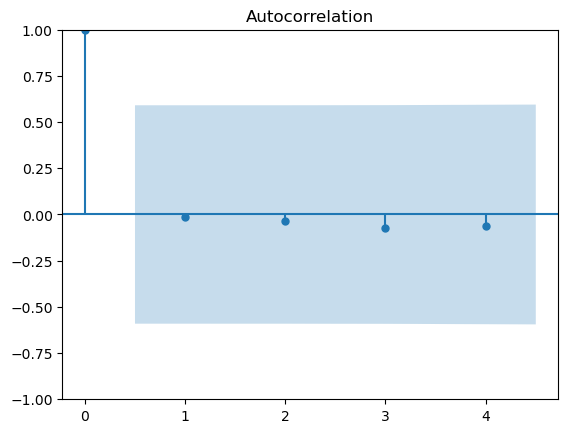

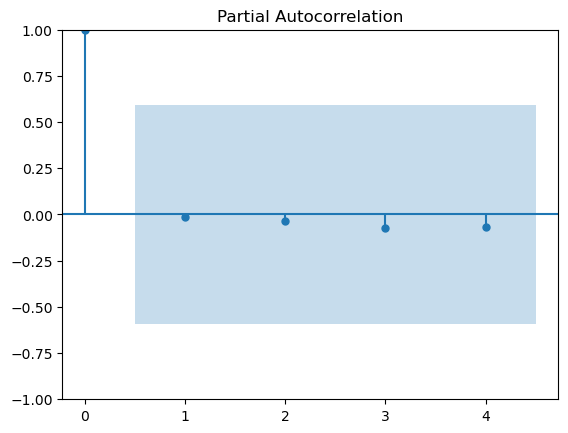

In [371]:
residuals = arima_4_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


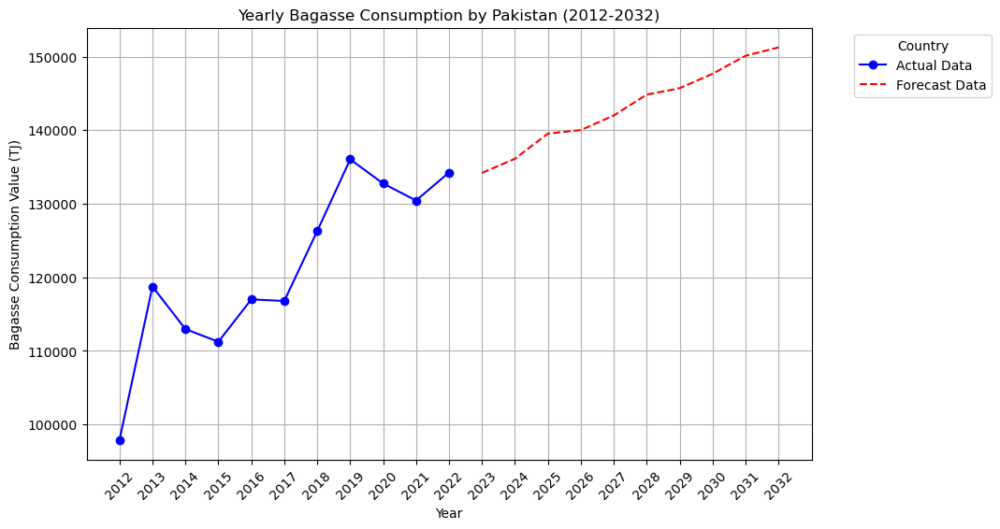

In [372]:
forecast_years = 10
forecast_c = arima_4_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_pakistan_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_pakistan_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_pakistan_c.index ,df_bagasse_pakistan_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Consumption Value (TJ)')
plt.title('Yearly Bagasse Consumption by Pakistan (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BAGASSE PRODUCTION AND CONSUMPTION IN PAKISTAN FORECAST

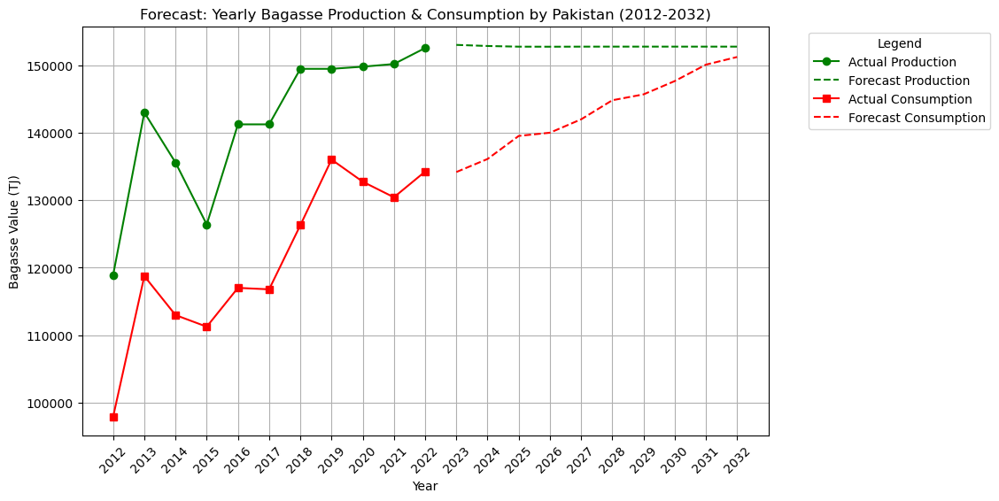

In [373]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_bagasse_pakistan.index, df_bagasse_pakistan['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_bagasse_pakistan_c.index, df_bagasse_pakistan_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Bagasse Value (TJ)')
plt.title('Forecast: Yearly Bagasse Production & Consumption by Pakistan (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_bagasse_pakistan.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Bagasse Forecast/Forecast of Yearly Bagasse Production & Consumption by Pakistan (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Bagasse Production in Indonesia</B>

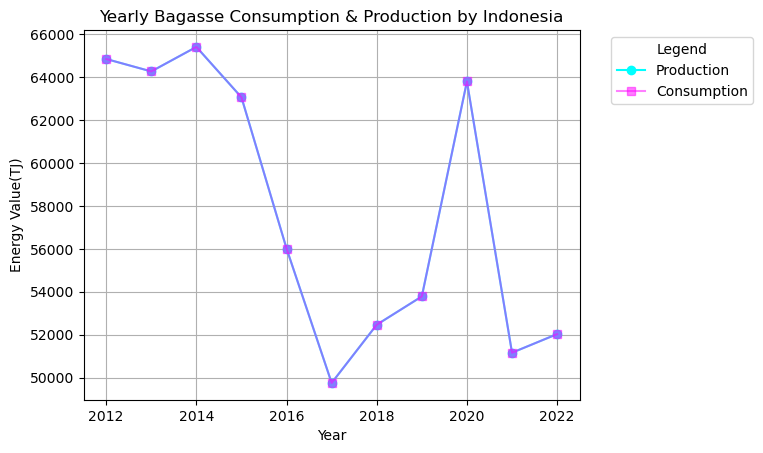

In [374]:
df_bagasse_indonesia = df_production[(df_production['Area'] == 'Indonesia') & (df_production['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_bagasse_indonesia_c = df_consumption[(df_consumption['Area'] == 'Indonesia') & (df_consumption['Item'] == 'Bagasse')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_bagasse_indonesia.index, df_bagasse_indonesia.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_bagasse_indonesia_c.index, df_bagasse_indonesia_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Bagasse Consumption & Production by Indonesia')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

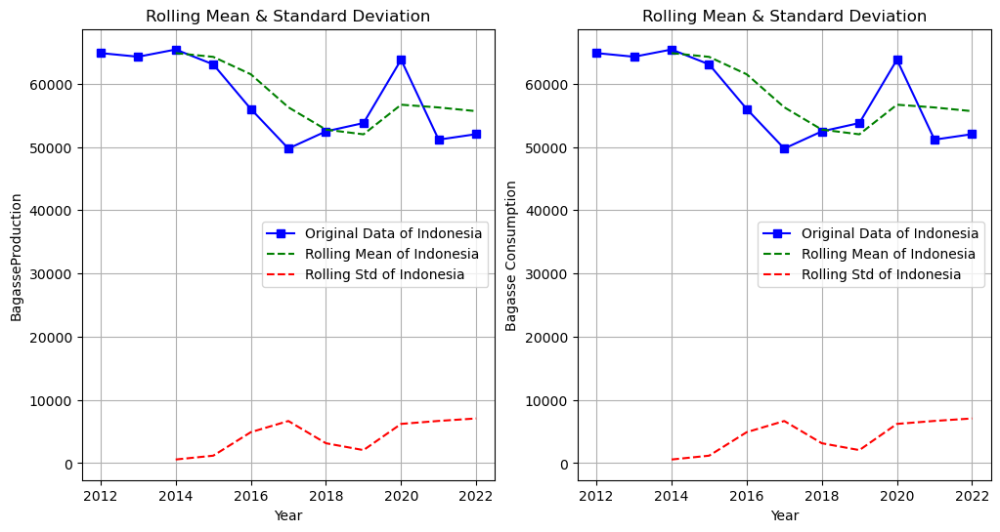

In [375]:
rolling_mean = df_bagasse_indonesia.rolling(window=3).mean()
rolling_std = df_bagasse_indonesia.rolling(window=3).std()
rolling_mean_c = df_bagasse_indonesia_c.rolling(window=3).mean()
rolling_std_c = df_bagasse_indonesia_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_bagasse_indonesia, label='Original Data of Indonesia', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Indonesia', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BagasseProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_bagasse_indonesia_c, label='Original Data of Indonesia', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Indonesia', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Bagasse Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [376]:
adf_statistic = adfuller(df_bagasse_indonesia['Value'])[0]
p_value = adfuller(df_bagasse_indonesia['Value'])[1]
critical_points = adfuller(df_bagasse_indonesia['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.2738351426658339
p-value: 0.6410561555649323
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [377]:
df_bagasse_indonesia['Differenced Production'] = df_bagasse_indonesia['Value'].diff()
adf_statistic = adfuller(df_bagasse_indonesia['Differenced Production'].dropna())[0]
p_value = adfuller(df_bagasse_indonesia['Differenced Production'].dropna())[1]
critical_points = adfuller(df_bagasse_indonesia['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.995412315005247
p-value: 2.266183869019436e-05
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

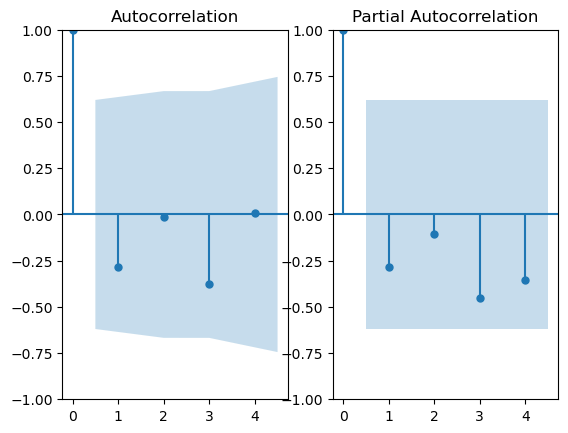

In [378]:
fig, ax = plt.subplots(1,2)
plot_acf(df_bagasse_indonesia['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_bagasse_indonesia['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [379]:
arima_1 = ARIMA(df_bagasse_indonesia['Value'], order=(3,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_bagasse_indonesia['Value'], order=(4,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_bagasse_indonesia['Value'], order=(3,1,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_bagasse_indonesia['Value'], order=(4,1,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 1)   Log Likelihood                -100.692
Date:                Tue, 25 Mar 2025   AIC                            211.384
Time:                        00:38:47   BIC                            212.897
Sample:                             0   HQIC                           209.724
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6100      0.369      1.652      0.099      -0.114       1.334
ar.L2          0.0275      0.402      0.068      0.945      -0.761       0.816
ar.L3         -0.1030      0.234     -0.440      0.6

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 3)   Log Likelihood                 -98.803
Date:                Tue, 25 Mar 2025   AIC                            211.607
Time:                        00:38:48   BIC                            213.725
Sample:                             0   HQIC                           209.283
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0952      0.766      0.124      0.901      -1.407       1.597
ar.L2          0.0908      0.760      0.119      0.905      -1.398       1.580
ar.L3         -0.9728      0.483     -2.015      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


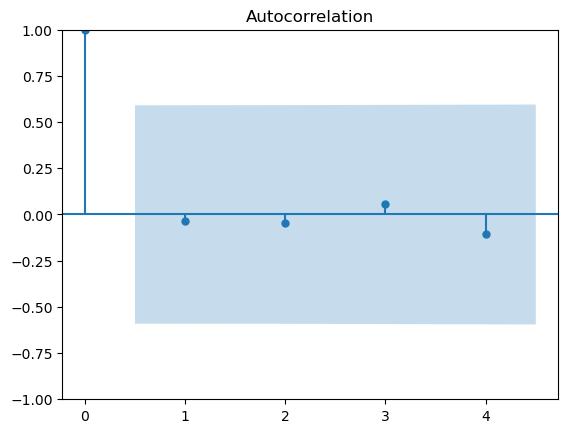

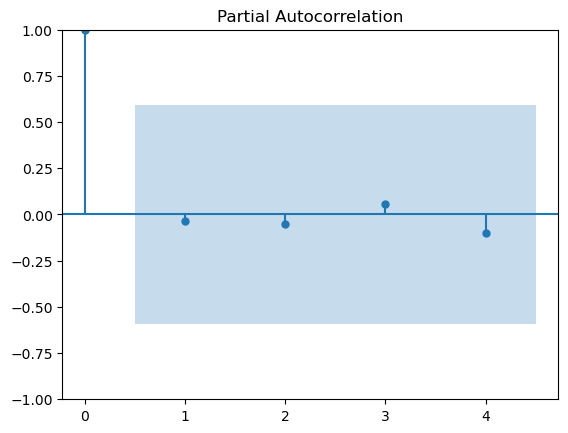

In [380]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


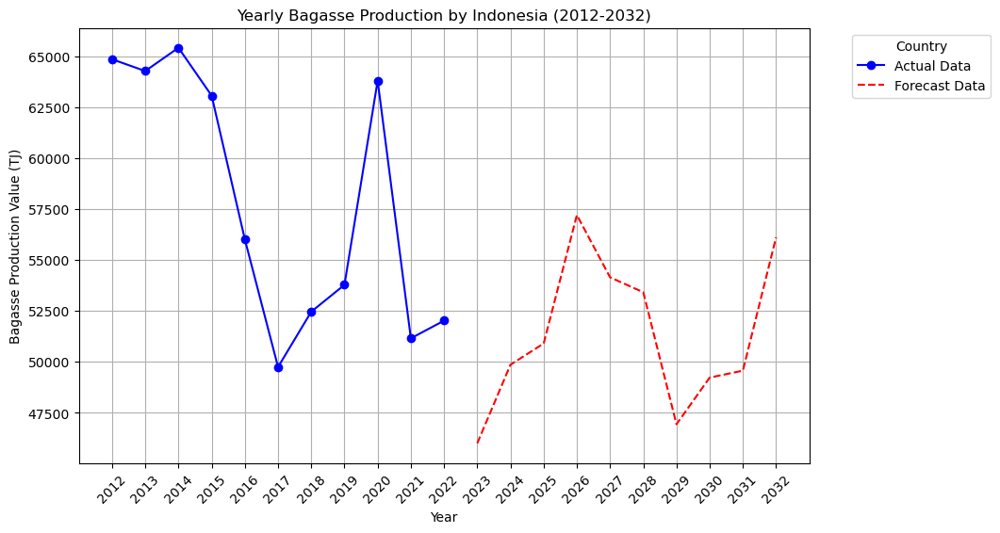

In [381]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_bagasse_indonesia.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_bagasse_indonesia.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_bagasse_indonesia.index ,df_bagasse_indonesia['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Bagasse Production Value (TJ)')
plt.title('Yearly Bagasse Production by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BAGASSE PRODUCTION AND CONSUMPTION IN INDONESIA FORECAST

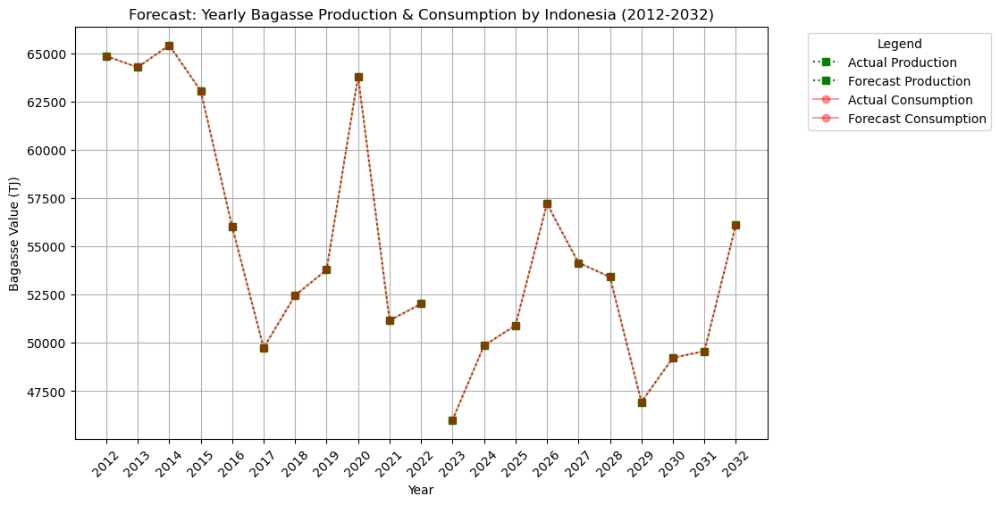

In [382]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_bagasse_indonesia.index, df_bagasse_indonesia['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_bagasse_indonesia.index, df_bagasse_indonesia['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Bagasse Value (TJ)')
plt.title('Forecast: Yearly Bagasse Production & Consumption by Indonesia (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_bagasse_indonesia.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Bagasse Forecast/Forecast of Yearly Bagasse Production & Consumption by Indonesia (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biodiesel Production in China, mainland</B>

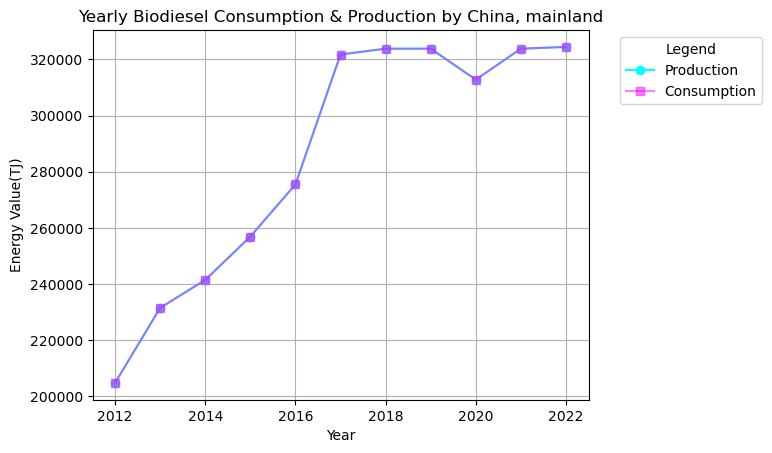

In [383]:
df_biodiesel_china = df_production[(df_production['Area'] == 'China, mainland') & (df_production['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biodiesel_china_c = df_consumption[(df_consumption['Area'] == 'China, mainland') & (df_consumption['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biodiesel_china.index, df_biodiesel_china.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biodiesel_china_c.index, df_biodiesel_china_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biodiesel Consumption & Production by China, mainland')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

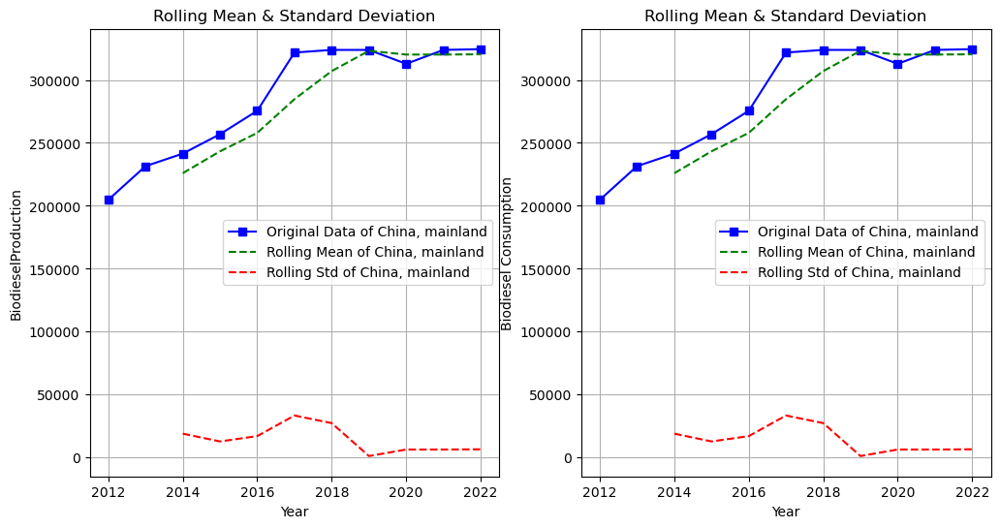

In [384]:
rolling_mean = df_biodiesel_china.rolling(window=3).mean()
rolling_std = df_biodiesel_china.rolling(window=3).std()
rolling_mean_c = df_biodiesel_china_c.rolling(window=3).mean()
rolling_std_c = df_biodiesel_china_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biodiesel_china, label='Original Data of China, mainland', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of China, mainland', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiodieselProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biodiesel_china_c, label='Original Data of China, mainland', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of China, mainland', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biodiesel Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [385]:
adf_statistic = adfuller(df_biodiesel_china['Value'])[0]
p_value = adfuller(df_biodiesel_china['Value'])[1]
critical_points = adfuller(df_biodiesel_china['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.0858558883405967
p-value: 0.250239921859726
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [386]:
df_biodiesel_china['Differenced Production'] = df_biodiesel_china['Value'].diff()
adf_statistic = adfuller(df_biodiesel_china['Differenced Production'].dropna())[0]
p_value = adfuller(df_biodiesel_china['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biodiesel_china['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.3435225193072093
p-value: 0.15831490430887057
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [387]:
df_biodiesel_china['Differenced Production 2'] = df_biodiesel_china['Differenced Production'].diff()
adf_statistic = adfuller(df_biodiesel_china['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_biodiesel_china['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_biodiesel_china['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.585583122982046
p-value: 0.096013701959479
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 3rd time the Production to convert non stationary data to stationary</B>

In [388]:
df_biodiesel_china['Differenced Production 3'] = df_biodiesel_china['Differenced Production 2'].diff()
adf_statistic = adfuller(df_biodiesel_china['Differenced Production 3'].dropna())[0]
p_value = adfuller(df_biodiesel_china['Differenced Production 3'].dropna())[1]
critical_points = adfuller(df_biodiesel_china['Differenced Production 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.109043842239299
p-value: 0.24089361201399384
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


<B>Differencing 4th time the Production to convert non stationary data to stationary</B>

In [389]:
df_biodiesel_china['Differenced Production 4'] = df_biodiesel_china['Differenced Production 3'].diff()
adf_statistic = adfuller(df_biodiesel_china['Differenced Production 4'].dropna())[0]
p_value = adfuller(df_biodiesel_china['Differenced Production 4'].dropna())[1]
critical_points = adfuller(df_biodiesel_china['Differenced Production 4'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -6.544032979435082
p-value: 9.194361216395691e-09
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 4 (d=4)

<B>ACF and PACF PLOTS</B>

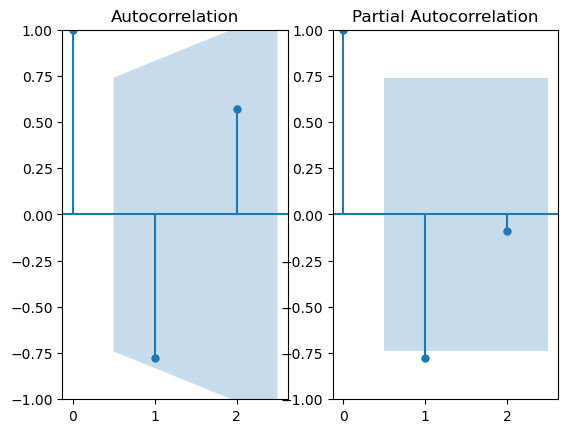

In [390]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biodiesel_china['Differenced Production 4'].dropna(), ax=ax[0], lags=2)
plot_pacf(df_biodiesel_china['Differenced Production 4'].dropna(), ax=ax[1], lags=2)
plt.show()

In [391]:
arima_1 = ARIMA(df_biodiesel_china['Value'], order=(1,4,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biodiesel_china['Value'], order=(1,4,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 4, 1)   Log Likelihood                 -81.908
Date:                Tue, 25 Mar 2025   AIC                            169.816
Time:                        00:38:52   BIC                            169.654
Sample:                             0   HQIC                           167.811
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7163      0.721     -0.993      0.320      -2.129       0.697
ma.L1         -0.9378      0.790     -1.187      0.235      -2.487       0.611
sigma2      9.839e+08   5.65e-10   1.74e+18      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

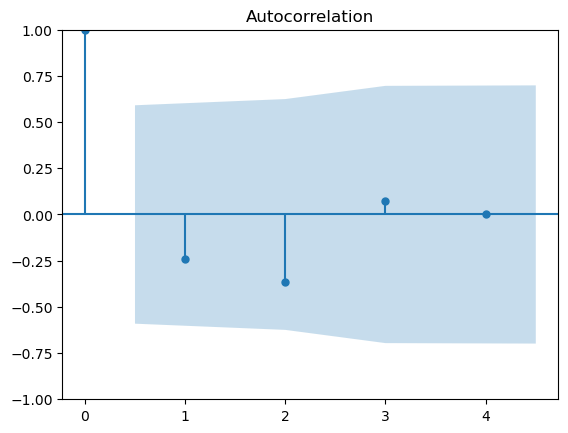

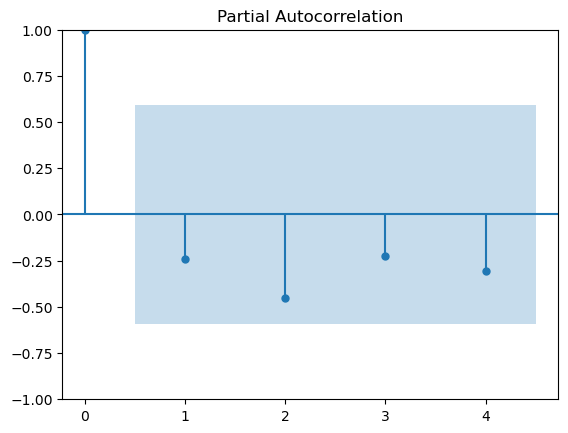

In [392]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


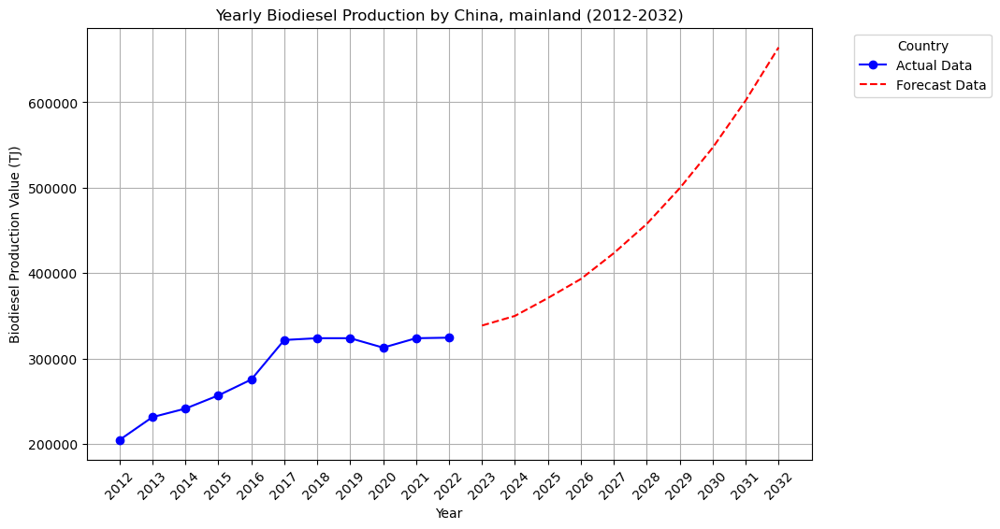

In [393]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biodiesel_china.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biodiesel_china.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biodiesel_china.index ,df_biodiesel_china['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biodiesel Production Value (TJ)')
plt.title('Yearly Biodiesel Production by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIODIESEL PRODUCTION AND CONSUMPTION IN CHINA, MAINLAND FORECAST

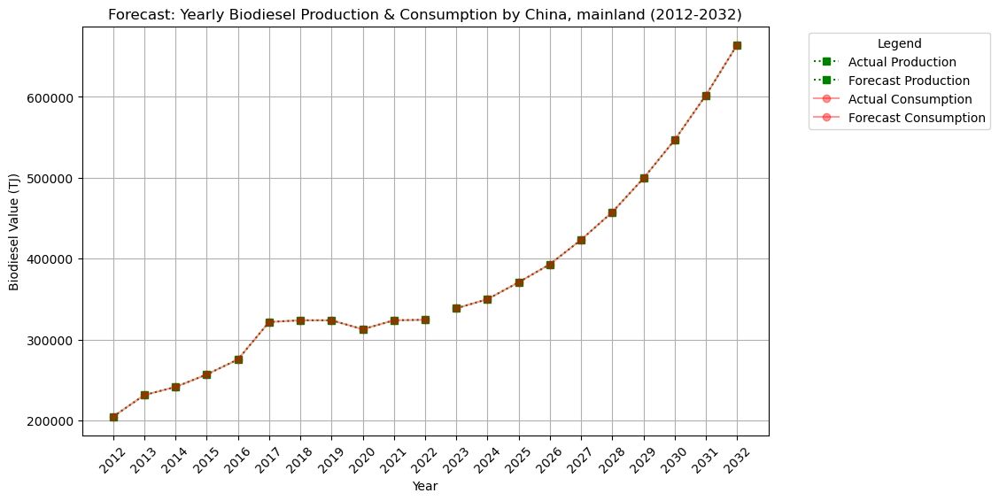

In [394]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biodiesel_china.index, df_biodiesel_china['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biodiesel_china.index, df_biodiesel_china['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biodiesel Value (TJ)')
plt.title('Forecast: Yearly Biodiesel Production & Consumption by China, mainland (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biodiesel_china.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biodiesel Forecast/Forecast of Yearly Biodiesel Production & Consumption by China, mainland (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biodiesel Production in Indonesia</B>

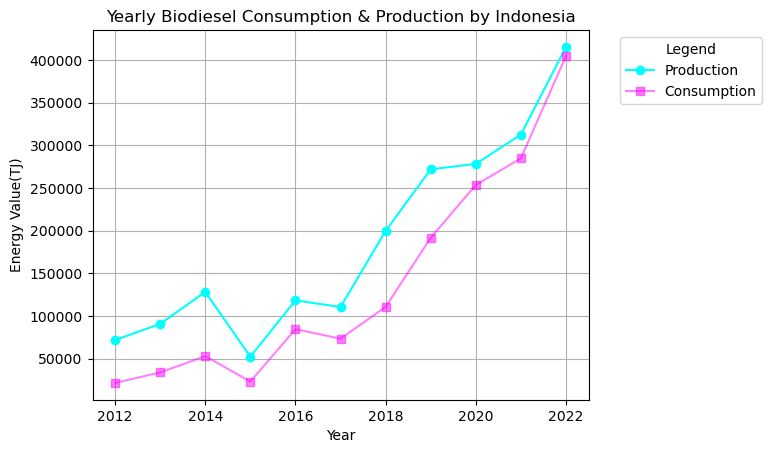

In [395]:
df_biodiesel_indonesia = df_production[(df_production['Area'] == 'Indonesia') & (df_production['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biodiesel_indonesia_c = df_consumption[(df_consumption['Area'] == 'Indonesia') & (df_consumption['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biodiesel_indonesia.index, df_biodiesel_indonesia.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biodiesel_indonesia_c.index, df_biodiesel_indonesia_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biodiesel Consumption & Production by Indonesia')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

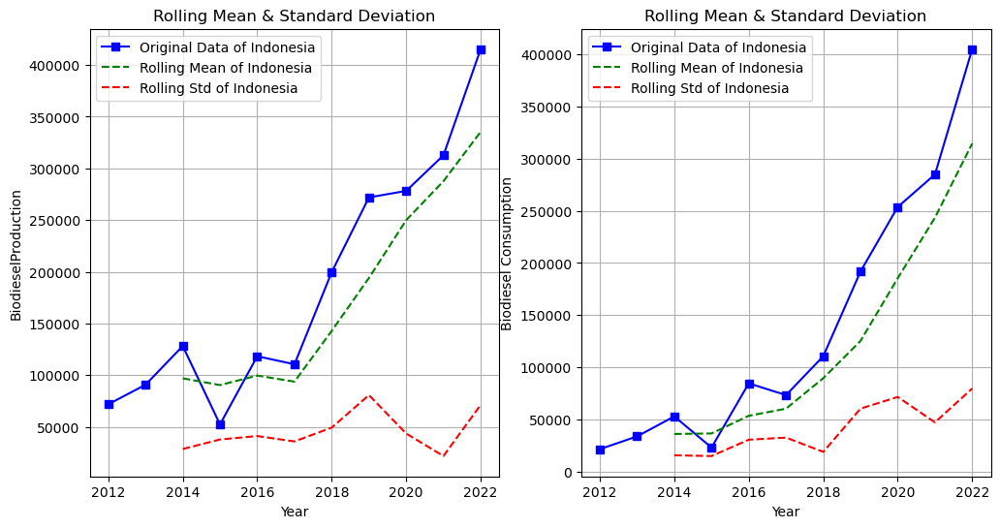

In [396]:
rolling_mean = df_biodiesel_indonesia.rolling(window=3).mean()
rolling_std = df_biodiesel_indonesia.rolling(window=3).std()
rolling_mean_c = df_biodiesel_indonesia_c.rolling(window=3).mean()
rolling_std_c = df_biodiesel_indonesia_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biodiesel_indonesia, label='Original Data of Indonesia', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Indonesia', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiodieselProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biodiesel_indonesia_c, label='Original Data of Indonesia', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Indonesia', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Indonesia', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biodiesel Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [397]:
adf_statistic = adfuller(df_biodiesel_indonesia['Value'])[0]
p_value = adfuller(df_biodiesel_indonesia['Value'])[1]
critical_points = adfuller(df_biodiesel_indonesia['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 0.5846813247716961
p-value: 0.987231900630668
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [398]:
df_biodiesel_indonesia['Differenced Production'] = df_biodiesel_indonesia['Value'].diff()
adf_statistic = adfuller(df_biodiesel_indonesia['Differenced Production'].dropna())[0]
p_value = adfuller(df_biodiesel_indonesia['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biodiesel_indonesia['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.266009768677848
p-value: 0.016467911314715405
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

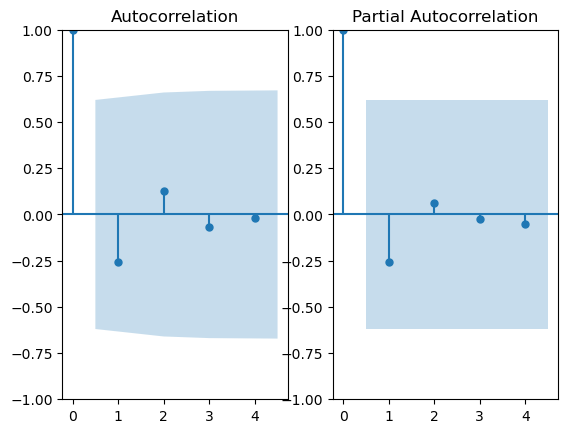

In [399]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biodiesel_indonesia['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biodiesel_indonesia['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [400]:
arima_1 = ARIMA(df_biodiesel_indonesia['Value'], order=(1,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biodiesel_indonesia['Value'], order=(1,1,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biodiesel_indonesia['Value'], order=(4,1,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biodiesel_indonesia['Value'], order=(4,1,2))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 1, 1)   Log Likelihood                -123.336
Date:                Tue, 25 Mar 2025   AIC                            252.673
Time:                        00:38:55   BIC                            253.580
Sample:                             0   HQIC                           251.677
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9905      0.248      3.993      0.000       0.504       1.477
ma.L1         -0.9205      1.043     -0.882      0.378      -2.965       1.124
sigma2      3.506e+09   3.98e-10   8.81e+18      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as star

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 1, 2)   Log Likelihood                -124.365
Date:                Tue, 25 Mar 2025   AIC                            256.730
Time:                        00:38:56   BIC                            257.941
Sample:                             0   HQIC                           255.403
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9346      0.218      4.278      0.000       0.506       1.363
ma.L1         -1.6457      0.388     -4.236      0.000      -2.407      -0.884
ma.L2          1.0000      0.610      1.638      0.1

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


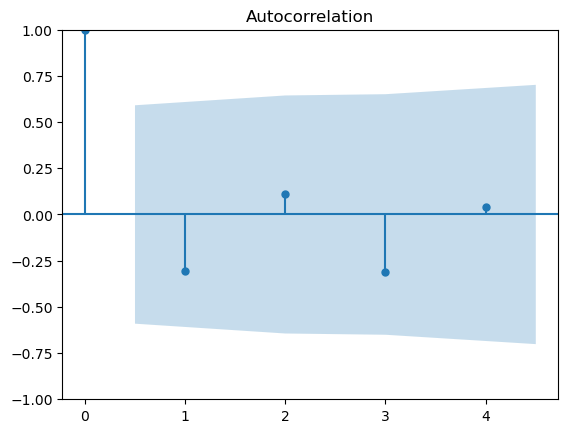

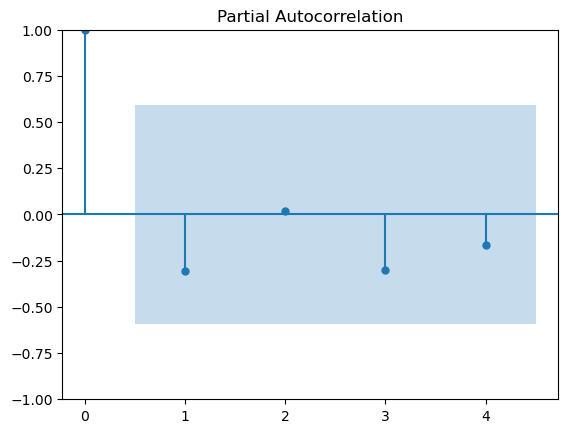

In [401]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


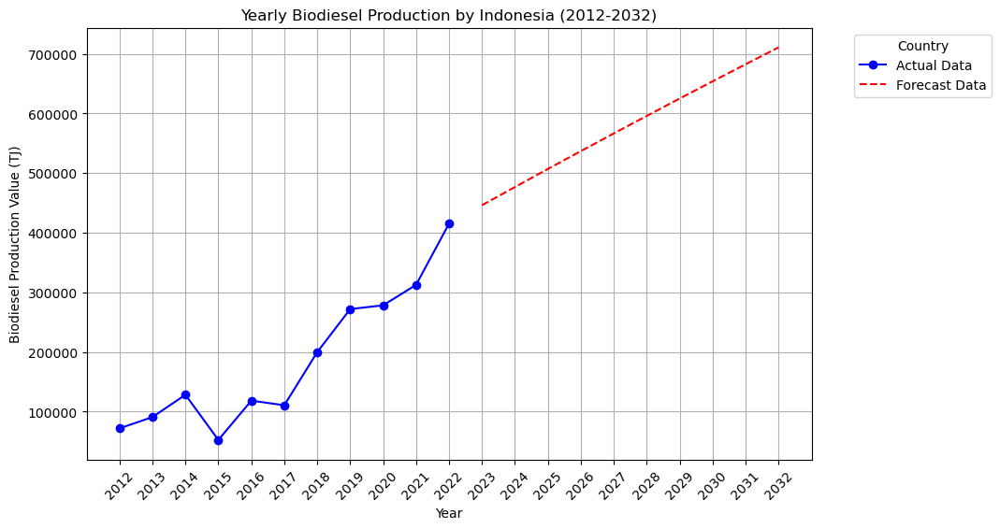

In [402]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biodiesel_indonesia.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biodiesel_indonesia.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biodiesel_indonesia.index ,df_biodiesel_indonesia['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biodiesel Production Value (TJ)')
plt.title('Yearly Biodiesel Production by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [403]:
adf_statistic = adfuller(df_biodiesel_indonesia_c['Value'])[0]
p_value = adfuller(df_biodiesel_indonesia_c['Value'])[1]
critical_points = adfuller(df_biodiesel_indonesia_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 2.275398216677712
p-value: 0.9989390207939338
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [404]:
df_biodiesel_indonesia_c['Differenced Consumption'] = df_biodiesel_indonesia_c['Value'].diff()

adf_statistic = adfuller(df_biodiesel_indonesia_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biodiesel_indonesia_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biodiesel_indonesia_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 0.18800065570157756
p-value: 0.971580499703307
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [405]:
df_biodiesel_indonesia_c['Differenced Consumption 2'] = df_biodiesel_indonesia_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_biodiesel_indonesia_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_biodiesel_indonesia_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_biodiesel_indonesia_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.529601711682191
p-value: 0.10843701374565201
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 3rd time the Consumption to convert non stationary data to stationary</B>

In [406]:
df_biodiesel_indonesia_c['Differenced Consumption 3'] = df_biodiesel_indonesia_c['Differenced Consumption 2'].diff()

adf_statistic = adfuller(df_biodiesel_indonesia_c['Differenced Consumption 3'].dropna())[0]
p_value = adfuller(df_biodiesel_indonesia_c['Differenced Consumption 3'].dropna())[1]
critical_points = adfuller(df_biodiesel_indonesia_c['Differenced Consumption 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.07794243046623
p-value: 0.028229198688900073
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 3 (d=3)

<B>ACF and PACF PLOTS</B>

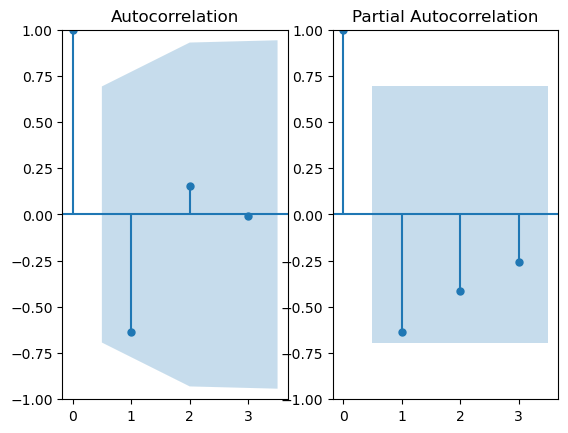

In [407]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biodiesel_indonesia_c['Differenced Consumption 3'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biodiesel_indonesia_c['Differenced Consumption 3'].dropna(), ax=ax[1], lags=3)
plt.show()

In [408]:
arima_1 = ARIMA(df_biodiesel_indonesia_c['Value'], order=(0,3,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biodiesel_indonesia_c['Value'], order=(0,3,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biodiesel_indonesia_c['Value'], order=(1,3,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biodiesel_indonesia_c['Value'], order=(1,3,1))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. foreca

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 3, 1)   Log Likelihood                -100.063
Date:                Tue, 25 Mar 2025   AIC                            204.125
Time:                        00:38:58   BIC                            204.284
Sample:                             0   HQIC                           203.054
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -1.0000      0.660     -1.516      0.130      -2.293       0.293
sigma2      2.621e+09   2.52e-10   1.04e+19      0.000    2.62e+09    2.62e+09
Ljung-Box (L1) (Q):                   3.91   Jarque-

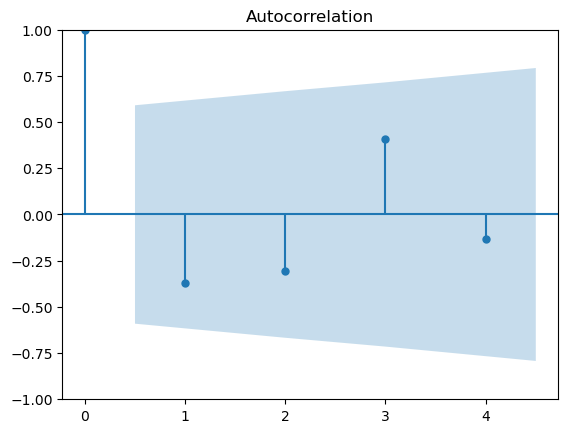

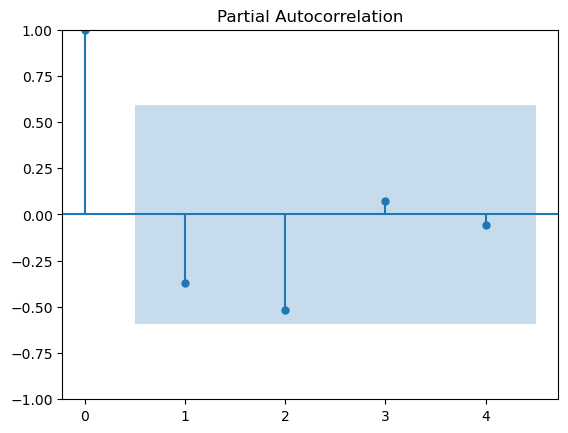

In [409]:
residuals = arima_4_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


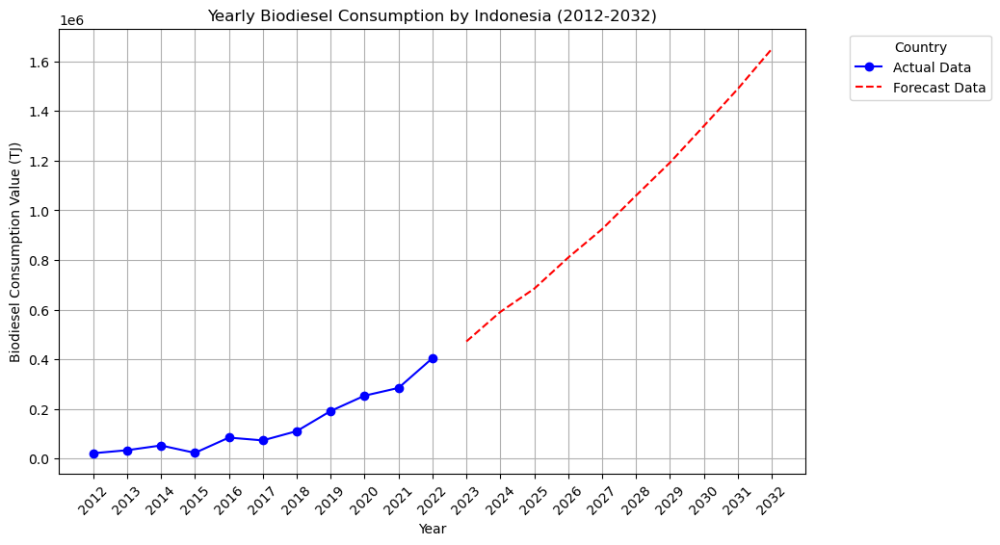

In [410]:
forecast_years = 10
forecast_c = arima_4_fit.forecast(steps=forecast_years)

last_year = int(df_biodiesel_indonesia_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biodiesel_indonesia_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biodiesel_indonesia_c.index ,df_biodiesel_indonesia_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biodiesel Consumption Value (TJ)')
plt.title('Yearly Biodiesel Consumption by Indonesia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIODIESEL PRODUCTION AND CONSUMPTION IN INDONESIA FORECAST

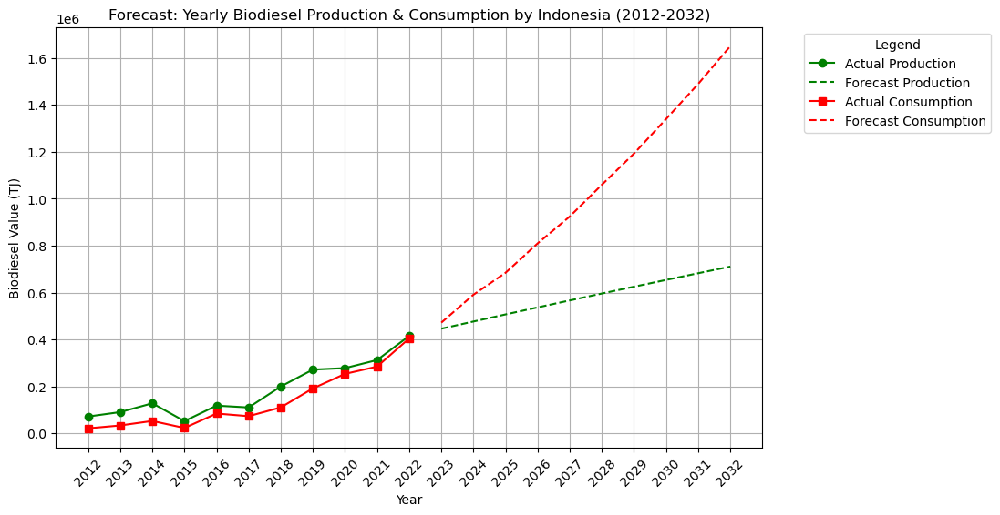

In [411]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biodiesel_indonesia.index, df_biodiesel_indonesia['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biodiesel_indonesia_c.index, df_biodiesel_indonesia_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biodiesel Value (TJ)')
plt.title('Forecast: Yearly Biodiesel Production & Consumption by Indonesia (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biodiesel_indonesia.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biodiesel Forecast/Forecast of Yearly Biodiesel Production & Consumption by Indonesia (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Bagasse Production in Thailand</B>

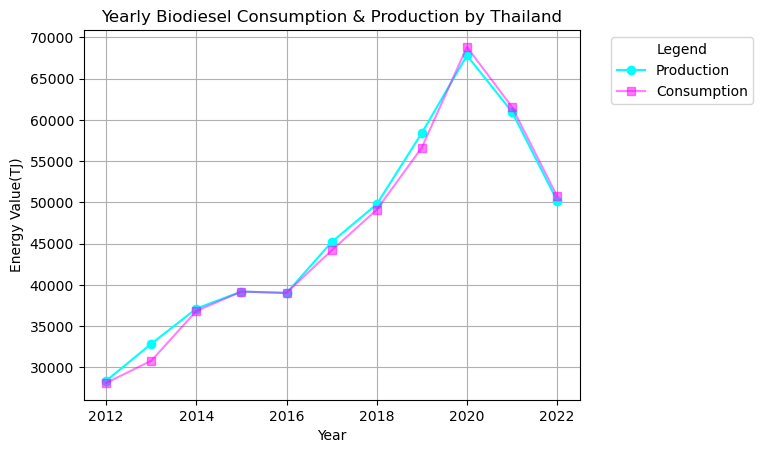

In [412]:
df_biodiesel_thailand = df_production[(df_production['Area'] == 'Thailand') & (df_production['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biodiesel_thailand_c = df_consumption[(df_consumption['Area'] == 'Thailand') & (df_consumption['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biodiesel_thailand.index, df_biodiesel_thailand.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biodiesel_thailand_c.index, df_biodiesel_thailand_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biodiesel Consumption & Production by Thailand')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

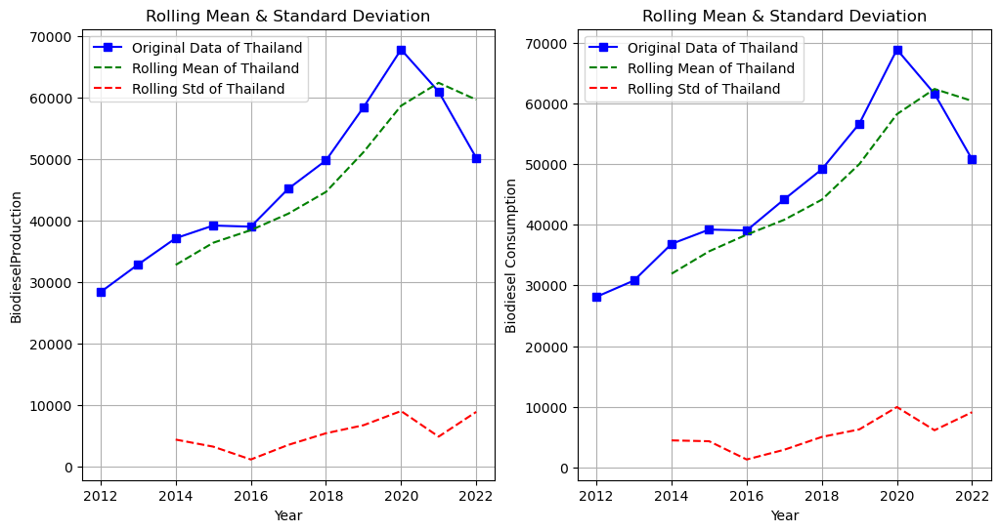

In [413]:
rolling_mean = df_biodiesel_thailand.rolling(window=3).mean()
rolling_std = df_biodiesel_thailand.rolling(window=3).std()
rolling_mean_c = df_biodiesel_thailand_c.rolling(window=3).mean()
rolling_std_c = df_biodiesel_thailand_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biodiesel_thailand, label='Original Data of Thailand', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Thailand', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Thailand', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiodieselProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biodiesel_thailand_c, label='Original Data of Thailand', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Thailand', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Thailand', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biodiesel Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [414]:
adf_statistic = adfuller(df_biodiesel_thailand['Value'])[0]
p_value = adfuller(df_biodiesel_thailand['Value'])[1]
critical_points = adfuller(df_biodiesel_thailand['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.7778396652429471
p-value: 0.391517851631062
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [415]:
df_biodiesel_thailand['Differenced Production'] = df_biodiesel_thailand['Value'].diff()
adf_statistic = adfuller(df_biodiesel_thailand['Differenced Production'].dropna())[0]
p_value = adfuller(df_biodiesel_thailand['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biodiesel_thailand['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.231884166965873
p-value: 0.018211705811688978
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

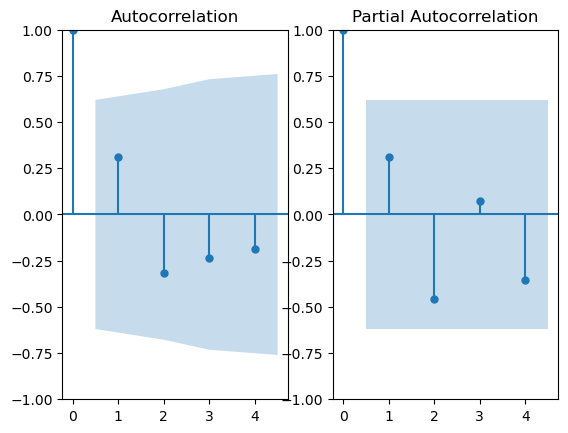

In [416]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biodiesel_thailand['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biodiesel_thailand['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [417]:
arima_1 = ARIMA(df_biodiesel_thailand['Value'], order=(2,1,4))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biodiesel_thailand['Value'], order=(4,1,4))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Lik

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 4)   Log Likelihood                 -99.608
Date:                Tue, 25 Mar 2025   AIC                            213.216
Time:                        00:39:03   BIC                            215.334
Sample:                             0   HQIC                           210.892
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0823      0.783     -1.382      0.167      -2.618       0.453
ar.L2         -0.7959      0.607     -1.310      0.190      -1.986       0.395
ma.L1          1.5219      1.003      1.517      0.1

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


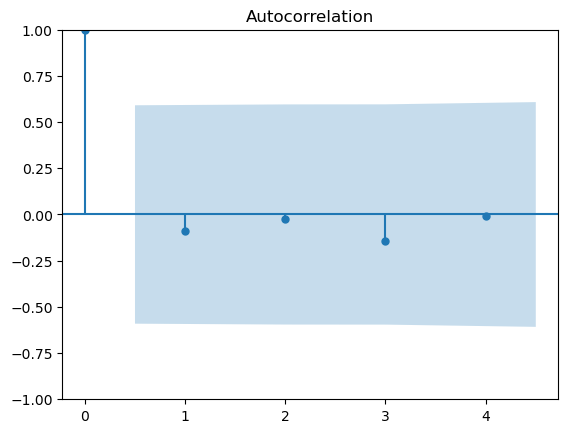

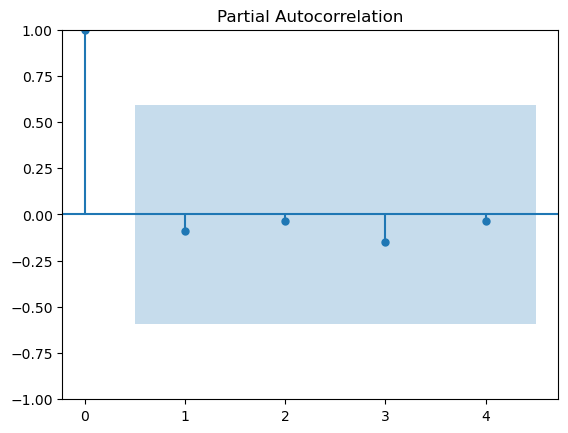

In [418]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


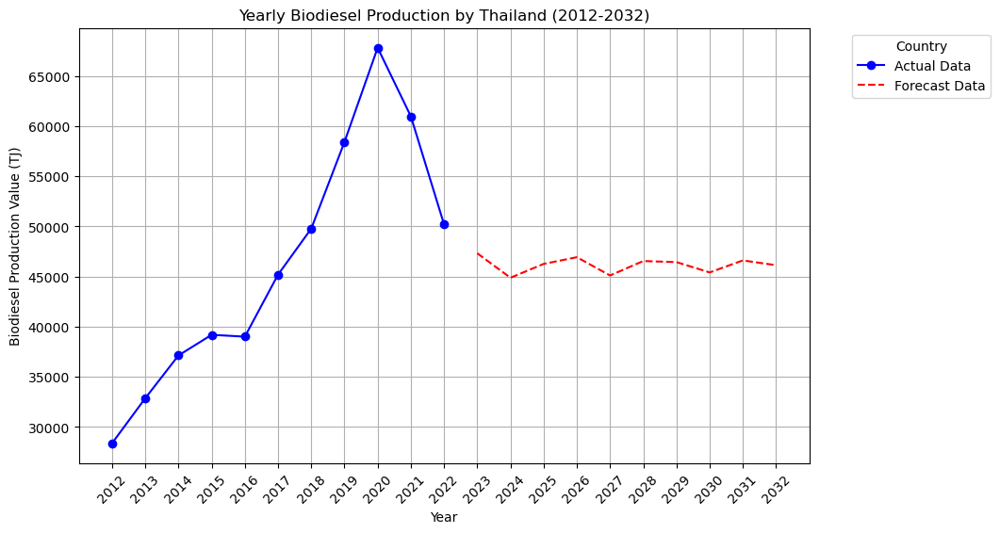

In [419]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biodiesel_thailand.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biodiesel_thailand.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biodiesel_thailand.index ,df_biodiesel_thailand['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biodiesel Production Value (TJ)')
plt.title('Yearly Biodiesel Production by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [420]:
adf_statistic = adfuller(df_biodiesel_thailand_c['Value'])[0]
p_value = adfuller(df_biodiesel_thailand_c['Value'])[1]
critical_points = adfuller(df_biodiesel_thailand_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.7833920851709641
p-value: 0.38873767556080036
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [421]:
df_biodiesel_thailand_c['Differenced Consumption'] = df_biodiesel_thailand_c['Value'].diff()

adf_statistic = adfuller(df_biodiesel_thailand_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biodiesel_thailand_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biodiesel_thailand_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -6.111356949840392
p-value: 9.316087702115393e-08
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

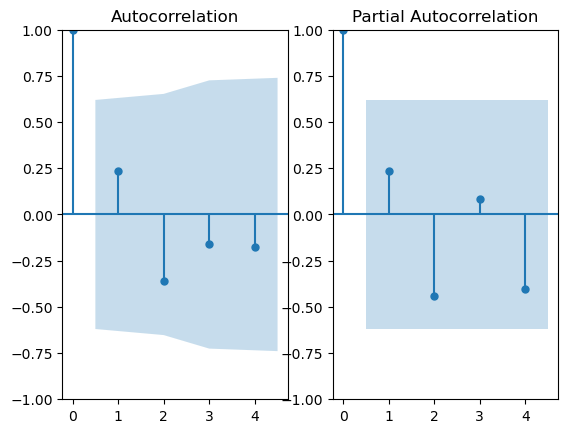

In [422]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biodiesel_thailand_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biodiesel_thailand_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [423]:
arima_1 = ARIMA(df_biodiesel_thailand_c['Value'], order=(2,1,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biodiesel_thailand_c['Value'], order=(4,1,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biodiesel_thailand_c['Value'], order=(2,1,4))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biodiesel_thailand_c['Value'], order=(4,1,4))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 2)   Log Likelihood               -5519.273
Date:                Tue, 25 Mar 2025   AIC                          11048.547
Time:                        00:39:05   BIC                          11050.060
Sample:                             0   HQIC                         11046.887
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0472      0.019      2.436      0.015       0.009       0.085
ar.L2          0.9527      0.011     85.508      0.000       0.931       0.975
ma.L1          0.0014      1.045      0.001      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 2)   Log Likelihood               -9291.137
Date:                Tue, 25 Mar 2025   AIC                          18596.274
Time:                        00:39:06   BIC                          18598.392
Sample:                             0   HQIC                         18593.951
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1848      0.002    747.374      0.000       1.182       1.188
ar.L2         -0.3761      0.001   -415.711      0.000      -0.378      -0.374
ar.L3          1.1863      0.001   2187.848      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 4)   Log Likelihood                -100.611
Date:                Tue, 25 Mar 2025   AIC                            219.222
Time:                        00:39:06   BIC                            221.945
Sample:                             0   HQIC                           216.235
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3021     27.795     -0.011      0.991     -54.779      54.174
ar.L2          0.1257     22.702      0.006      0.996     -44.370      44.621
ar.L3          0.7901     12.536      0.063      0.9

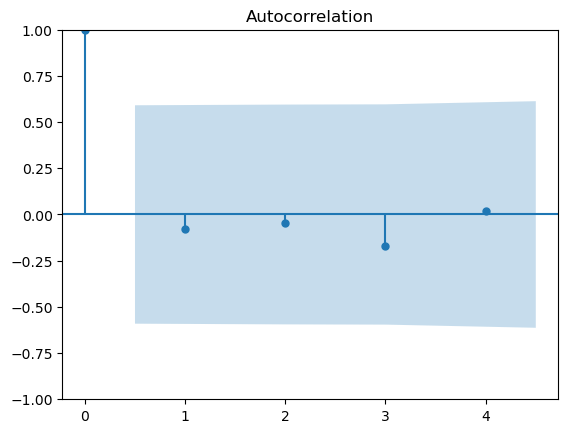

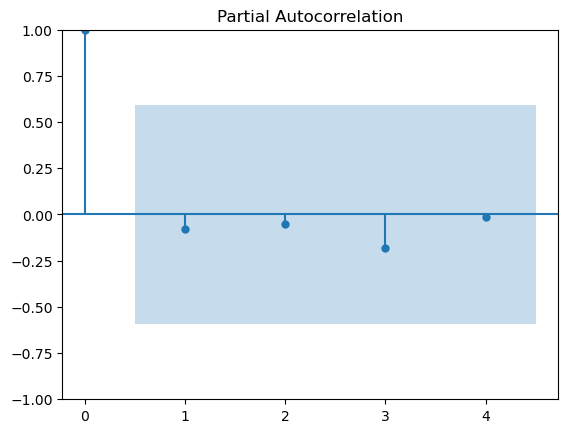

In [424]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


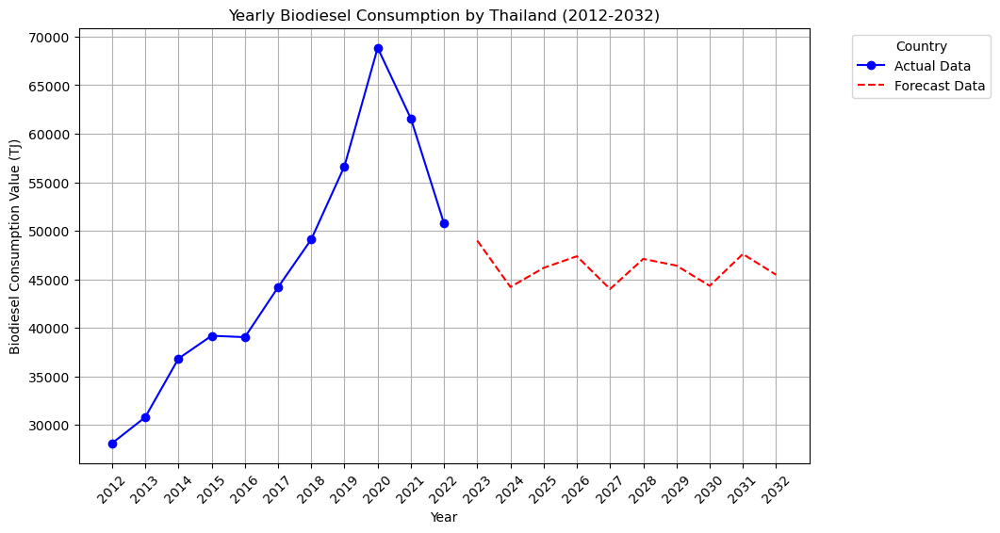

In [425]:
forecast_years = 10
forecast_c = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_biodiesel_thailand_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biodiesel_thailand_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biodiesel_thailand_c.index ,df_biodiesel_thailand_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biodiesel Consumption Value (TJ)')
plt.title('Yearly Biodiesel Consumption by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIODIESEL PRODUCTION AND CONSUMPTION IN THAILAND FORECAST

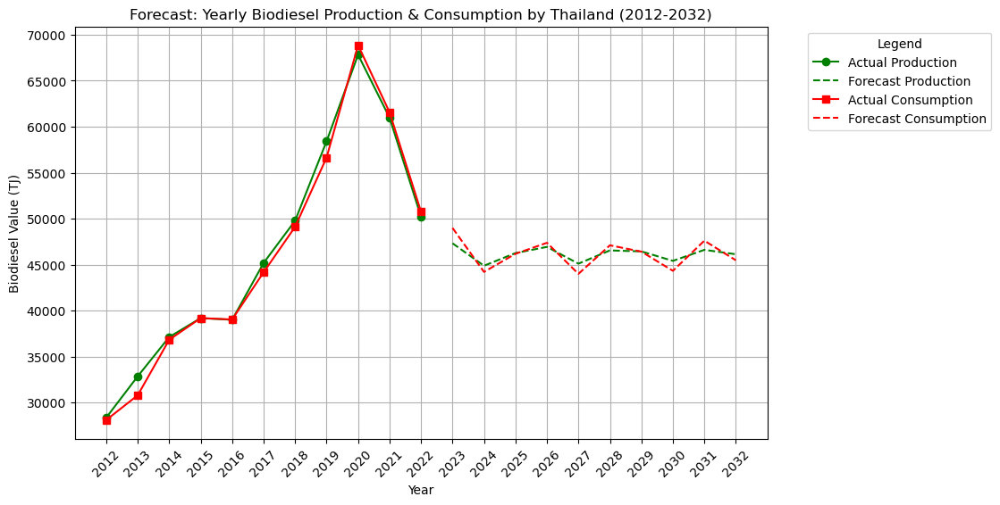

In [426]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biodiesel_thailand.index, df_biodiesel_thailand['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biodiesel_thailand_c.index, df_biodiesel_thailand_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biodiesel Value (TJ)')
plt.title('Forecast: Yearly Biodiesel Production & Consumption by Thailand (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biodiesel_thailand.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biodiesel Forecast/Forecast of Yearly Biodiesel Production & Consumption by Thailand (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Bagasse Production in Malaysia</B>

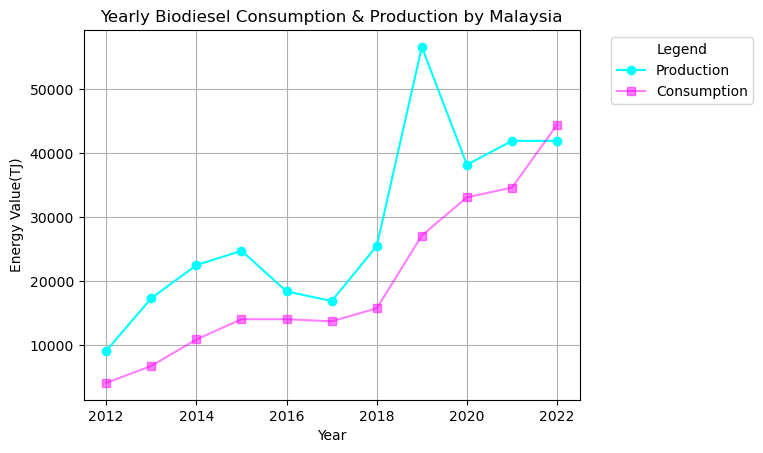

In [427]:
df_biodiesel_malaysia = df_production[(df_production['Area'] == 'Malaysia') & (df_production['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biodiesel_malaysia_c = df_consumption[(df_consumption['Area'] == 'Malaysia') & (df_consumption['Item'] == 'Biodiesel')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biodiesel_malaysia.index, df_biodiesel_malaysia.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biodiesel_malaysia_c.index, df_biodiesel_malaysia_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biodiesel Consumption & Production by Malaysia')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

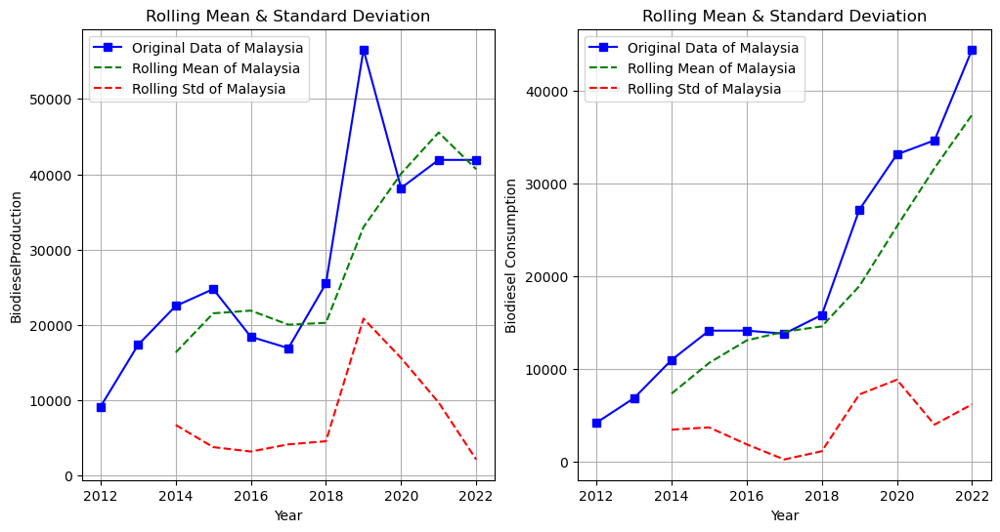

In [428]:
rolling_mean = df_biodiesel_malaysia.rolling(window=3).mean()
rolling_std = df_biodiesel_malaysia.rolling(window=3).std()
rolling_mean_c = df_biodiesel_malaysia_c.rolling(window=3).mean()
rolling_std_c = df_biodiesel_malaysia_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biodiesel_malaysia, label='Original Data of Malaysia', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Malaysia', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Malaysia', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiodieselProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biodiesel_malaysia_c, label='Original Data of Malaysia', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Malaysia', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Malaysia', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biodiesel Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [429]:
adf_statistic = adfuller(df_biodiesel_malaysia['Value'])[0]
p_value = adfuller(df_biodiesel_malaysia['Value'])[1]
critical_points = adfuller(df_biodiesel_malaysia['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.1880851165286472
p-value: 0.9959025199197228
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [430]:
df_biodiesel_malaysia['Differenced Production'] = df_biodiesel_malaysia['Value'].diff()
adf_statistic = adfuller(df_biodiesel_malaysia['Differenced Production'].dropna())[0]
p_value = adfuller(df_biodiesel_malaysia['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biodiesel_malaysia['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.6338633907472655
p-value: 0.005145674023383102
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

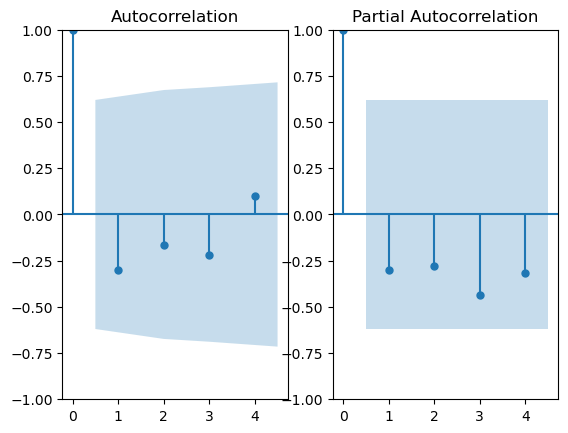

In [431]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biodiesel_malaysia['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biodiesel_malaysia['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [432]:
arima_1 = ARIMA(df_biodiesel_malaysia['Value'], order=(3,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biodiesel_malaysia['Value'], order=(4,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biodiesel_malaysia['Value'], order=(3,1,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biodiesel_malaysia['Value'], order=(4,1,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 1)   Log Likelihood                -108.324
Date:                Tue, 25 Mar 2025   AIC                            226.648
Time:                        00:39:11   BIC                            228.161
Sample:                             0   HQIC                           224.988
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4961     16.050     -0.031      0.975     -31.953      30.961
ar.L2         -0.1934      3.080     -0.063      0.950      -6.229       5.842
ar.L3         -0.1992      1.952     -0.102      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 3)   Log Likelihood                -107.537
Date:                Tue, 25 Mar 2025   AIC                            229.074
Time:                        00:39:11   BIC                            231.192
Sample:                             0   HQIC                           226.750
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3739    462.350      0.001      0.999    -905.816     906.564
ar.L2          0.7072    574.984      0.001      0.999   -1126.240    1127.654
ar.L3         -0.3269    170.210     -0.002      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 3)   Log Likelihood                -107.031
Date:                Tue, 25 Mar 2025   AIC                            230.063
Time:                        00:39:11   BIC                            232.484
Sample:                             0   HQIC                           227.407
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3366     74.129      0.018      0.986    -143.954     146.627
ar.L2         -0.8004    113.289     -0.007      0.994    -222.842     221.242
ar.L3          0.1129     70.878      0.002      0.9

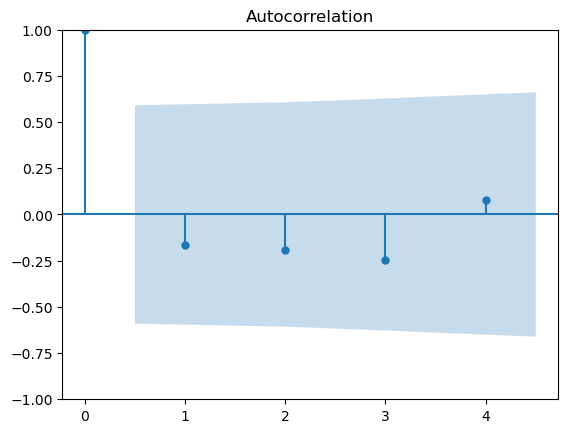

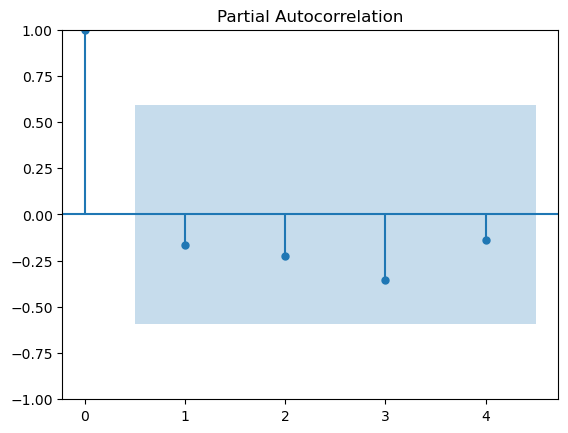

In [433]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


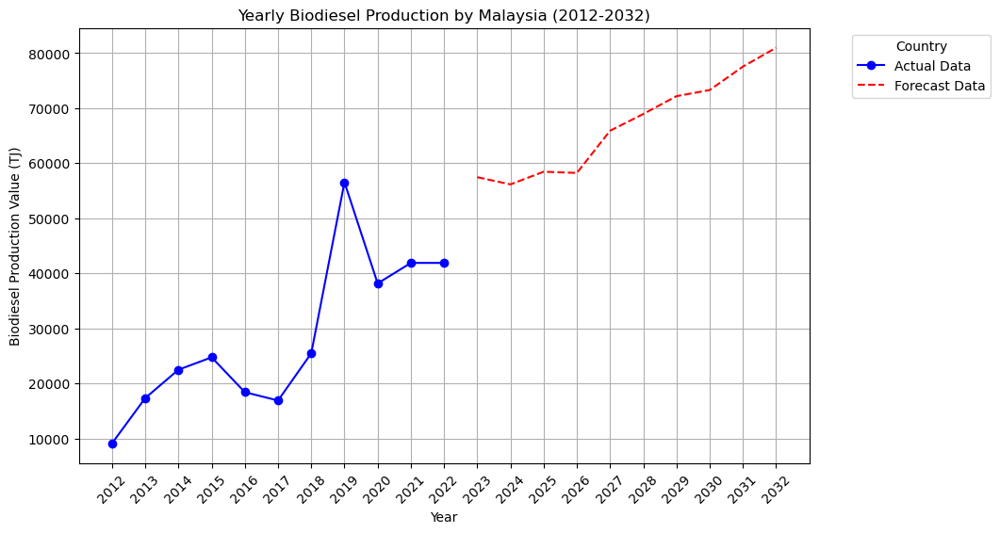

In [434]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_biodiesel_malaysia.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biodiesel_malaysia.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biodiesel_malaysia.index ,df_biodiesel_malaysia['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biodiesel Production Value (TJ)')
plt.title('Yearly Biodiesel Production by Malaysia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [435]:
adf_statistic = adfuller(df_biodiesel_malaysia_c['Value'])[0]
p_value = adfuller(df_biodiesel_malaysia_c['Value'])[1]
critical_points = adfuller(df_biodiesel_malaysia_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 2.2779125609939097
p-value: 0.9989407221716985
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [436]:
df_biodiesel_malaysia_c['Differenced Consumption'] = df_biodiesel_malaysia_c['Value'].diff()

adf_statistic = adfuller(df_biodiesel_malaysia_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biodiesel_malaysia_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biodiesel_malaysia_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.0548911531009404
p-value: 0.26303541671695774
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [437]:
df_biodiesel_malaysia_c['Differenced Consumption 2'] = df_biodiesel_malaysia_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_biodiesel_malaysia_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_biodiesel_malaysia_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_biodiesel_malaysia_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.5074453834787866
p-value: 0.007797927074869811
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

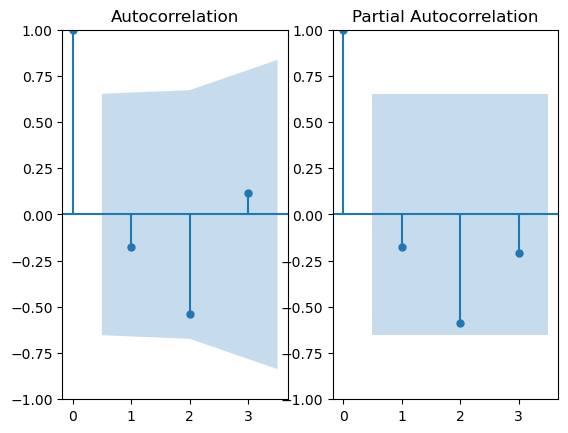

In [438]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biodiesel_malaysia_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biodiesel_malaysia_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [439]:
arima_1 = ARIMA(df_biodiesel_malaysia_c['Value'], order=(2,2,3))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 2, 3)   Log Likelihood                 -86.758
Date:                Tue, 25 Mar 2025   AIC                            185.515
Time:                        00:39:13   BIC                            186.699
Sample:                             0   HQIC                           182.962
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2252     13.564     -0.017      0.987     -26.810      26.360
ar.L2         -0.2978      3.741     -0.080      0.937      -7.630       7.035
ma.L1         -0.0697     11.844     -0.006      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


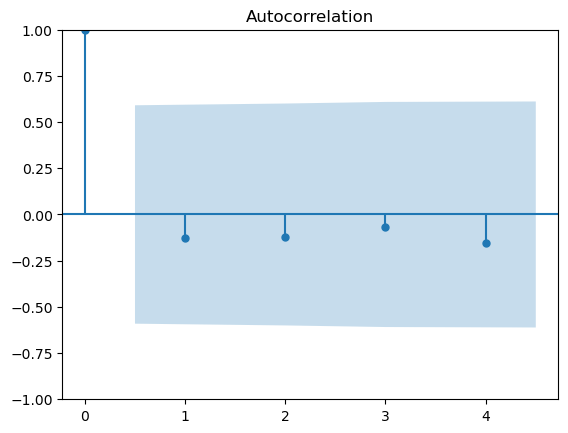

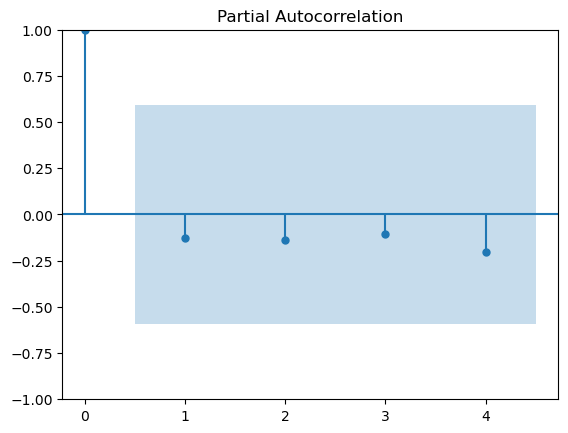

In [440]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


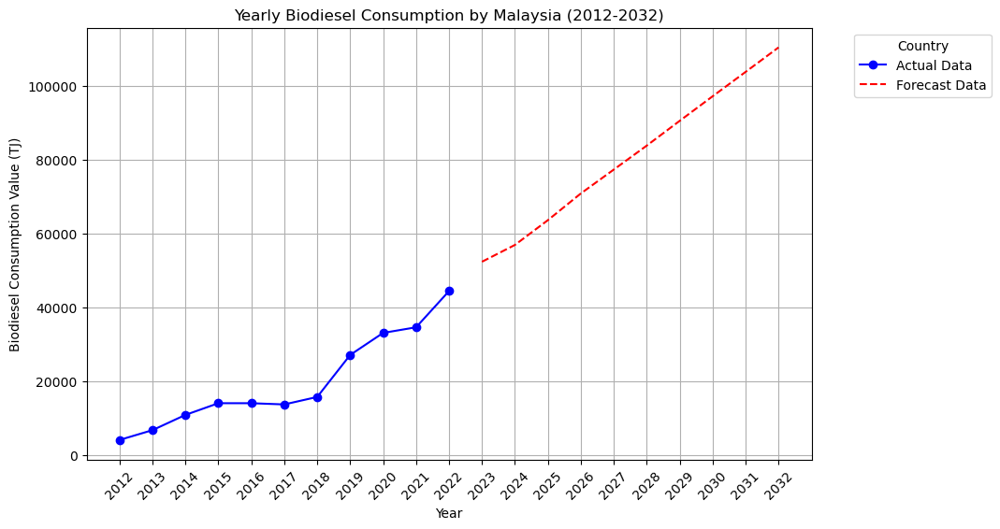

In [441]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biodiesel_malaysia_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biodiesel_malaysia_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biodiesel_malaysia_c.index ,df_biodiesel_malaysia_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biodiesel Consumption Value (TJ)')
plt.title('Yearly Biodiesel Consumption by Malaysia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIODIESEL PRODUCTION AND CONSUMPTION IN MALAYSIA FORECAST

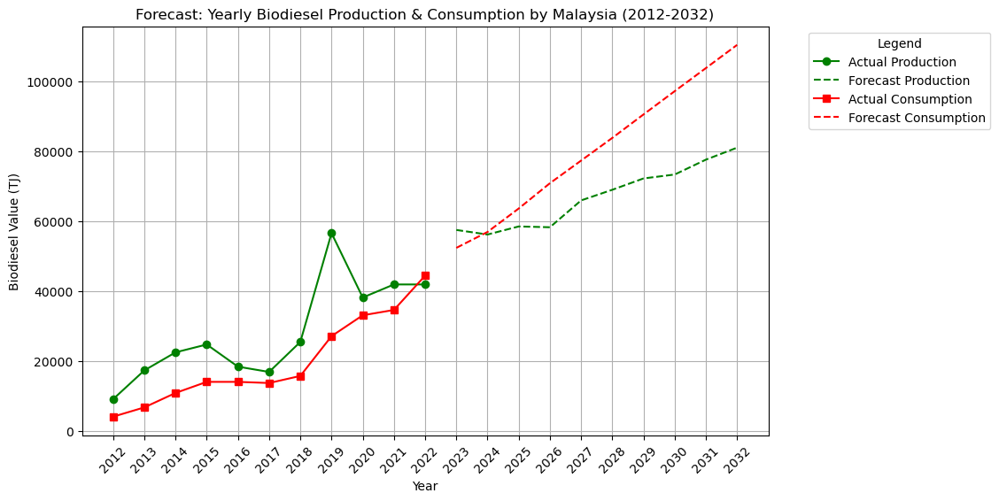

In [442]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biodiesel_malaysia.index, df_biodiesel_malaysia['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biodiesel_malaysia_c.index, df_biodiesel_malaysia_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biodiesel Value (TJ)')
plt.title('Forecast: Yearly Biodiesel Production & Consumption by Malaysia (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biodiesel_malaysia.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biodiesel Forecast/Forecast of Yearly Biodiesel Production & Consumption by Malaysia (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogasoline Production in China, mainland</B>

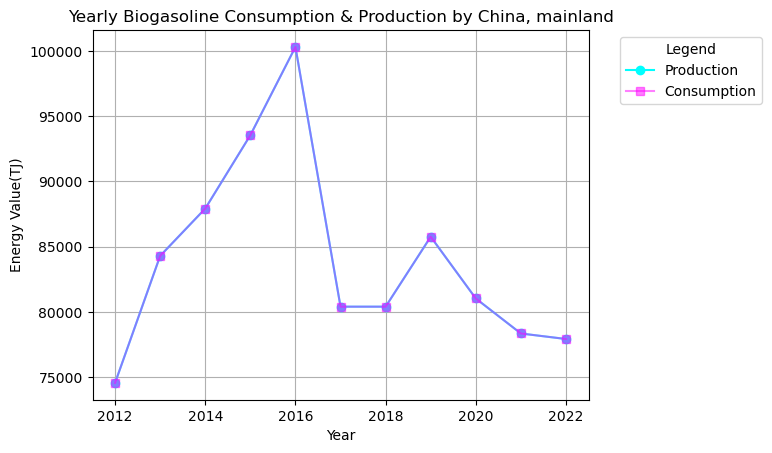

In [443]:
df_biogasoline_china = df_production[(df_production['Area'] == 'China, mainland') & (df_production['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogasoline_china_c = df_consumption[(df_consumption['Area'] == 'China, mainland') & (df_consumption['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogasoline_china.index, df_biogasoline_china.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogasoline_china_c.index, df_biogasoline_china_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogasoline Consumption & Production by China, mainland')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()


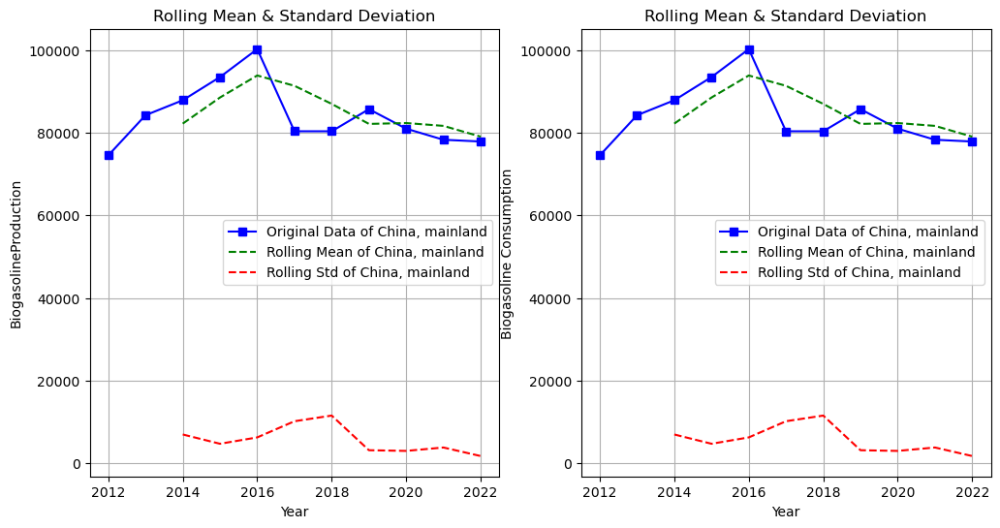

In [444]:
rolling_mean = df_biogasoline_china.rolling(window=3).mean()
rolling_std = df_biogasoline_china.rolling(window=3).std()
rolling_mean_c = df_biogasoline_china_c.rolling(window=3).mean()
rolling_std_c = df_biogasoline_china_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogasoline_china, label='Original Data of China, mainland', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of China, mainland', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasolineProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogasoline_china_c, label='Original Data of China, mainland', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of China, mainland', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of China, mainland', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogasoline Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [445]:
adf_statistic = adfuller(df_biogasoline_china['Value'])[0]
p_value = adfuller(df_biogasoline_china['Value'])[1]
critical_points = adfuller(df_biogasoline_china['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.1227946887735594
p-value: 0.23544806795563927
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [446]:
df_biogasoline_china['Differenced Production'] = df_biogasoline_china['Value'].diff()
adf_statistic = adfuller(df_biogasoline_china['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogasoline_china['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogasoline_china['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -11.387188140882627
p-value: 8.234852205037556e-21
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

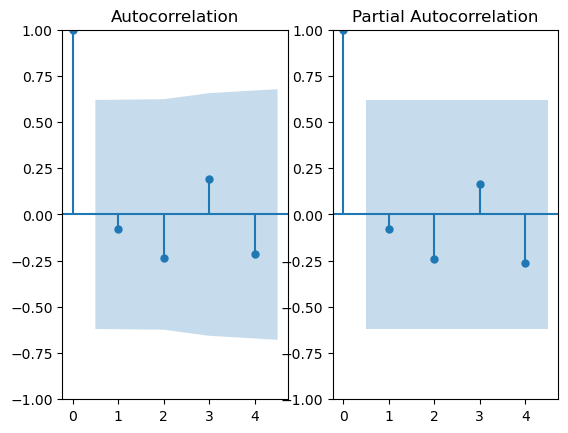

In [447]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_china['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogasoline_china['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [448]:
arima_1 = ARIMA(df_biogasoline_china['Value'], order=(2,1,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_china['Value'], order=(2,1,4))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_china['Value'], order=(4,1,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogasoline_china['Value'], order=(4,1,4))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 2)   Log Likelihood              -82630.793
Date:                Tue, 25 Mar 2025   AIC                         165271.586
Time:                        00:39:17   BIC                         165273.099
Sample:                             0   HQIC                        165269.926
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1456   5.69e-05  -2561.205      0.000      -0.146      -0.146
ar.L2          0.0036   4.51e-05     78.821      0.000       0.003       0.004
ma.L1          0.0009      0.028      0.033      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 2)   Log Likelihood              -12704.491
Date:                Tue, 25 Mar 2025   AIC                          25422.981
Time:                        00:39:17   BIC                          25425.100
Sample:                             0   HQIC                         25420.658
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4706      0.000  -1423.889      0.000      -0.471      -0.470
ar.L2         -0.0045      0.000    -12.834      0.000      -0.005      -0.004
ar.L3         -0.2838      0.000  -1018.443      0.0

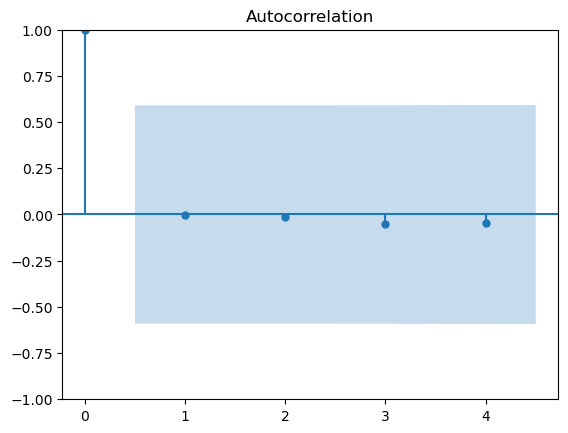

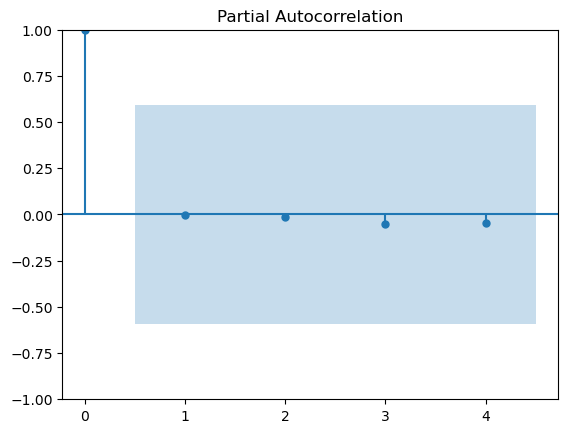

In [449]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


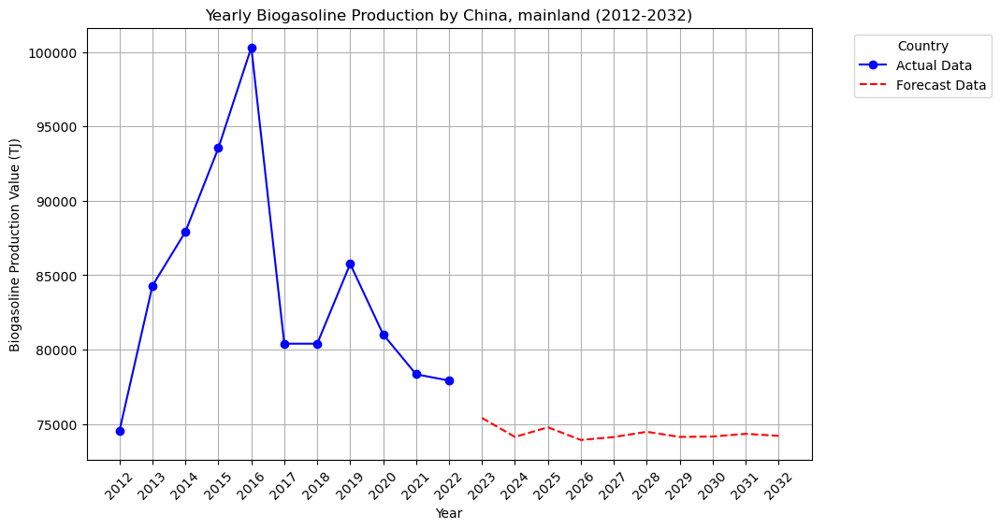

In [450]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_china.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_china.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_china.index ,df_biogasoline_china['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Production Value (TJ)')
plt.title('Yearly Biogasoline Production by China, mainland (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASOLINE PRODUCTION AND CONSUMPTION IN CHINA, MAINLAND FORECAST

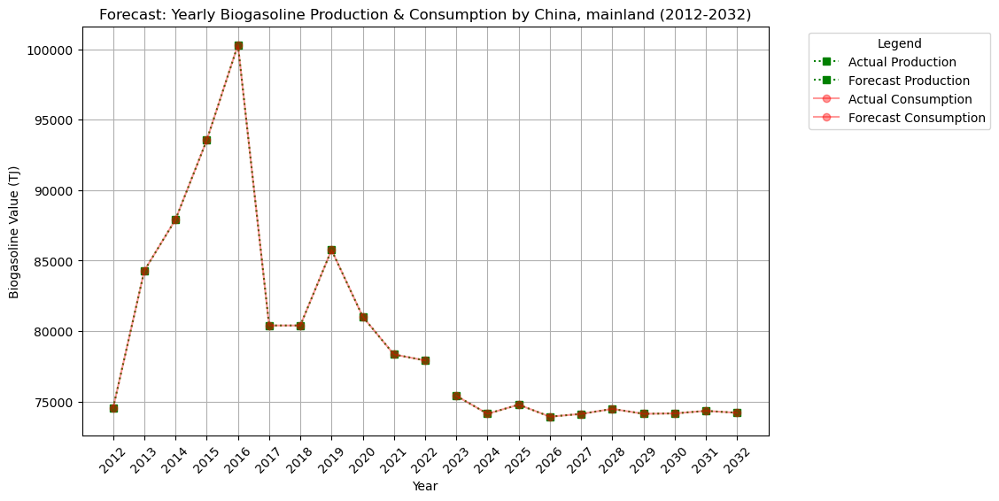

In [451]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogasoline_china.index, df_biogasoline_china['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogasoline_china.index, df_biogasoline_china['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogasoline Value (TJ)')
plt.title('Forecast: Yearly Biogasoline Production & Consumption by China, mainland (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogasoline_china.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogasoline Forecast/Forecast of Yearly Biogasoline Production & Consumption by China, mainland (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogasoline Production in Thailand</B>

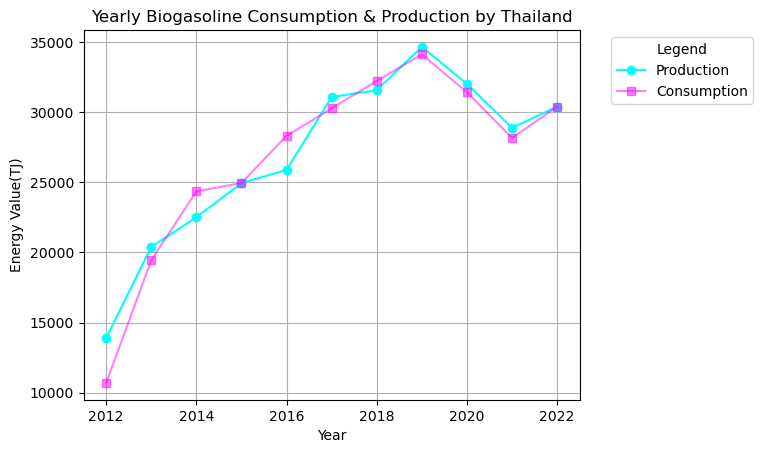

In [452]:
df_biogasoline_thailand = df_production[(df_production['Area'] == 'Thailand') & (df_production['Item'] == 'Biogasoline')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogasoline_thailand_c = df_consumption[(df_consumption['Area'] == 'Thailand') & (df_consumption['Item'] == 'Biogasoline')] \
    .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogasoline_thailand.index, df_biogasoline_thailand.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogasoline_thailand_c.index, df_biogasoline_thailand_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogasoline Consumption & Production by Thailand')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

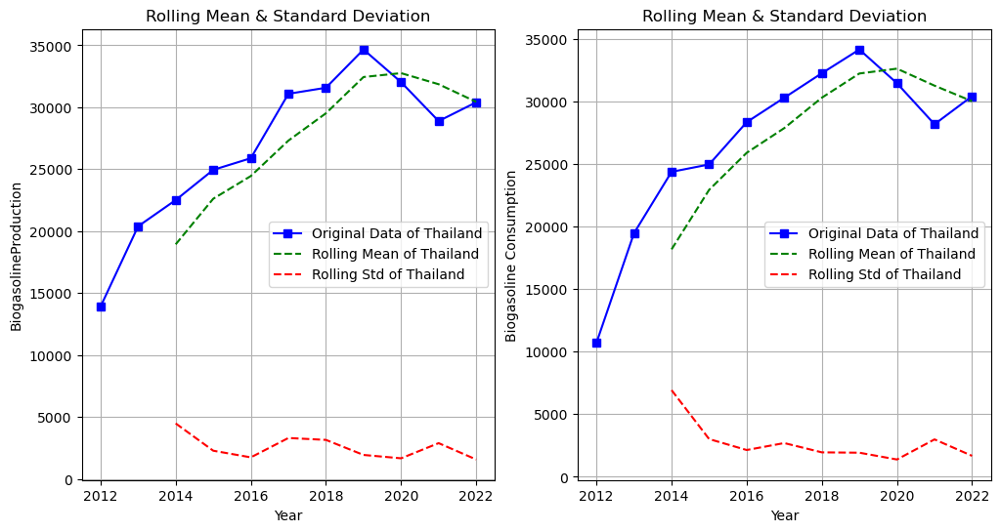

In [453]:
rolling_mean = df_biogasoline_thailand.rolling(window=3).mean()
rolling_std = df_biogasoline_thailand.rolling(window=3).std()
rolling_mean_c = df_biogasoline_thailand_c.rolling(window=3).mean()
rolling_std_c = df_biogasoline_thailand_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogasoline_thailand, label='Original Data of Thailand', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Thailand', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Thailand', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasolineProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogasoline_thailand_c, label='Original Data of Thailand', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Thailand', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Thailand', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogasoline Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [454]:
adf_statistic = adfuller(df_biogasoline_thailand['Value'])[0]
p_value = adfuller(df_biogasoline_thailand['Value'])[1]
critical_points = adfuller(df_biogasoline_thailand['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.1032936452883115
p-value: 0.02631040222036299
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

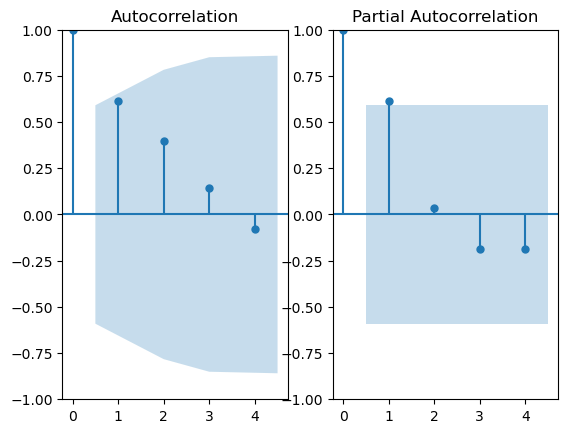

In [455]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_thailand['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogasoline_thailand['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [456]:
arima_1 = ARIMA(df_biogasoline_thailand['Value'], order=(1,0,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_thailand['Value'], order=(1,0,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_thailand['Value'], order=(1,0,4))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 0)   Log Likelihood                -105.494
Date:                Tue, 25 Mar 2025   AIC                            216.988
Time:                        00:39:21   BIC                            218.182
Sample:                             0   HQIC                           216.236
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.691e+04   7831.389      3.437      0.001    1.16e+04    4.23e+04
ar.L1          0.9063      0.157      5.784      0.000       0.599       1.213
sigma2      1.071e+07      3.137   3.41e+06      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


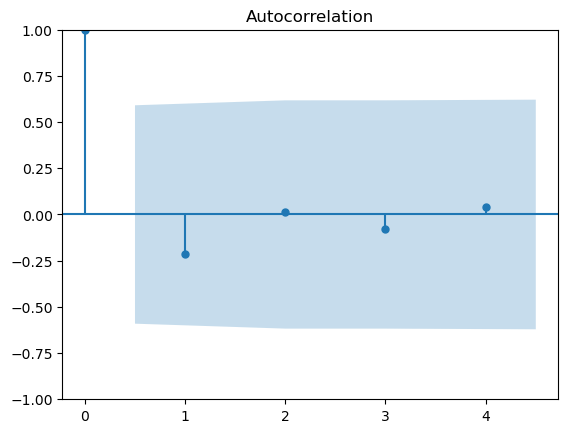

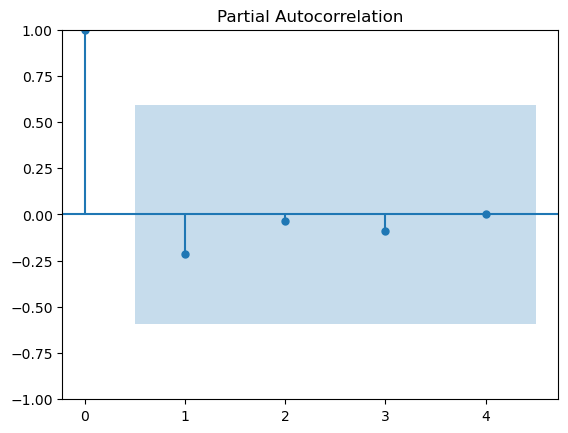

In [457]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


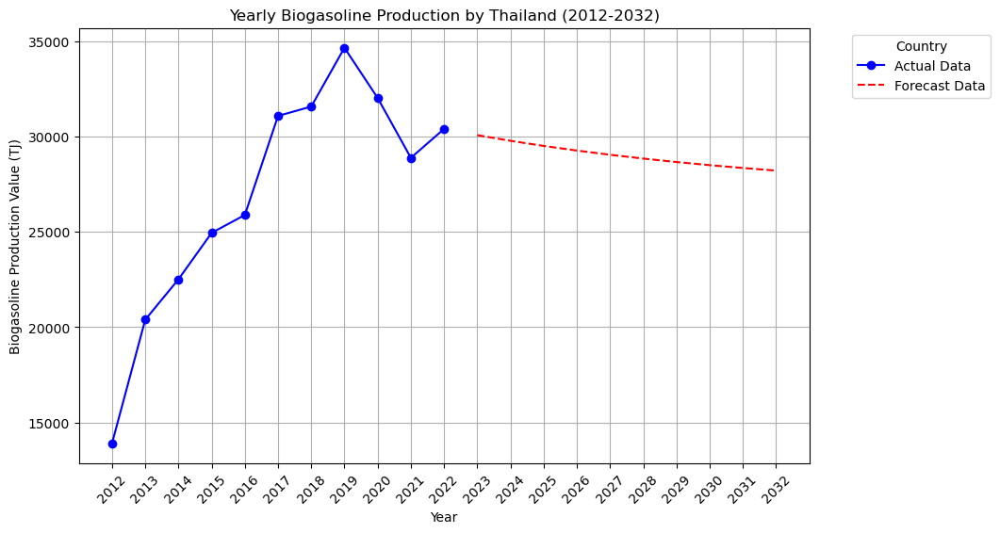

In [458]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_thailand.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_thailand.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_thailand.index ,df_biogasoline_thailand['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Production Value (TJ)')
plt.title('Yearly Biogasoline Production by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [459]:
adf_statistic = adfuller(df_biogasoline_thailand_c['Value'])[0]
p_value = adfuller(df_biogasoline_thailand_c['Value'])[1]
critical_points = adfuller(df_biogasoline_thailand_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.9218111543440006
p-value: 0.3218710392220905
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [460]:
df_biogasoline_thailand_c['Differenced Consumption'] = df_biogasoline_thailand_c['Value'].diff()

adf_statistic = adfuller(df_biogasoline_thailand_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biogasoline_thailand_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biogasoline_thailand_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.2687016017634125
p-value: 0.1822610612742706
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [461]:
df_biogasoline_thailand_c['Differenced Consumption 2'] = df_biogasoline_thailand_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_biogasoline_thailand_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_biogasoline_thailand_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_biogasoline_thailand_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.091680247271163
p-value: 0.027175045435178007
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

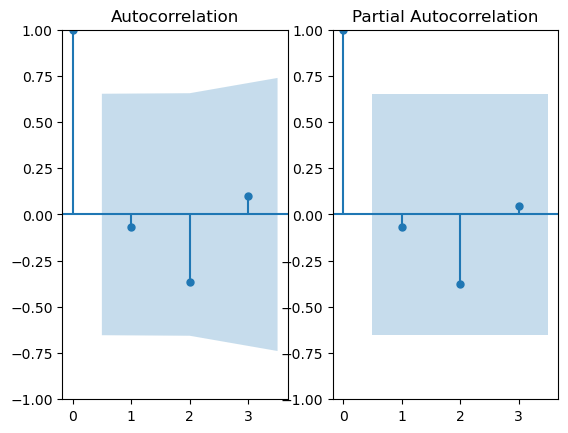

In [462]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_thailand_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biogasoline_thailand_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [463]:
arima_1 = ARIMA(df_biogasoline_thailand_c['Value'], order=(2,2,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_thailand_c['Value'], order=(0,2,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_thailand_c['Value'], order=(0,2,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogasoline_thailand_c['Value'], order=(2,2,0))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. foreca

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 2, 2)   Log Likelihood      -4236280510154.903
Date:                Tue, 25 Mar 2025   AIC                  8472561020319.807
Time:                        00:39:24   BIC                  8472561020320.793
Sample:                             0   HQIC                 8472561020317.679
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.2685   1.05e-11  -1.21e+11      0.000      -1.268      -1.268
ar.L2         -0.4207    9.4e-12  -4.47e+10      0.000      -0.421      -0.421
ma.L1       1.707e-05   1.16e-11   1.47e+06      0.0

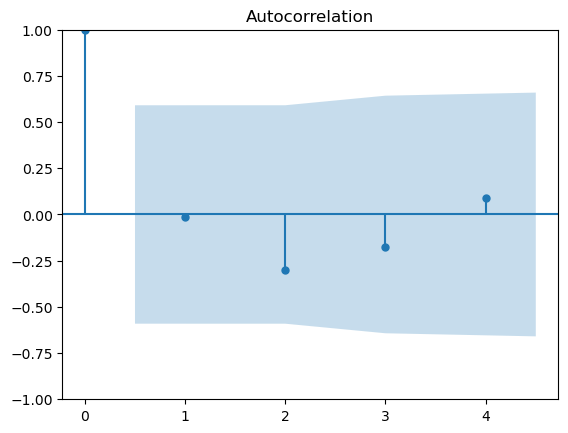

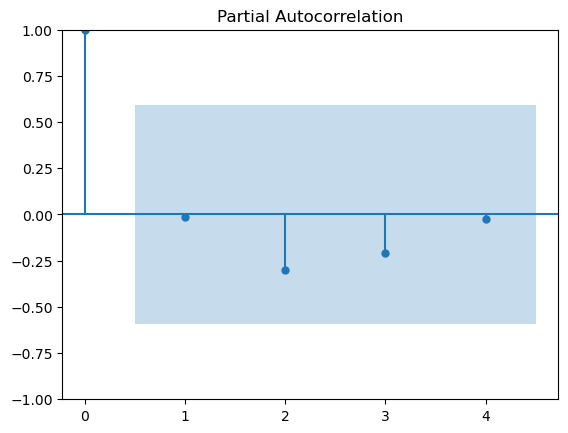

In [464]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


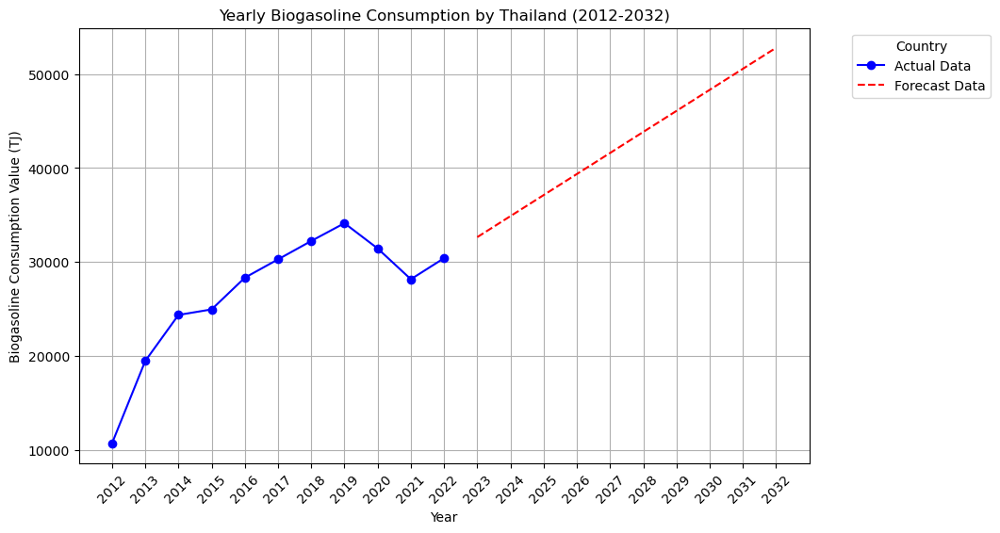

In [465]:
forecast_years = 10
forecast_c = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_thailand_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_thailand_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_thailand_c.index ,df_biogasoline_thailand_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Consumption Value (TJ)')
plt.title('Yearly Biogasoline Consumption by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASOLINE PRODUCTION AND CONSUMPTION IN THAILAND FORECAST

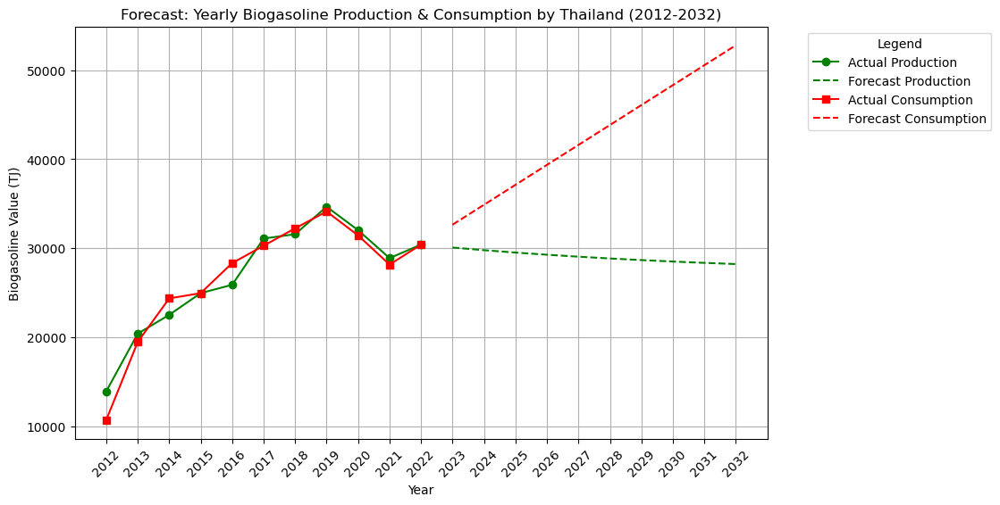

In [466]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogasoline_thailand.index, df_biogasoline_thailand['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogasoline_thailand_c.index, df_biogasoline_thailand_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogasoline Value (TJ)')
plt.title('Forecast: Yearly Biogasoline Production & Consumption by Thailand (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogasoline_thailand.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogasoline Forecast/Forecast of Yearly Biogasoline Production & Consumption by Thailand (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogasoline Production in Philippines</B>

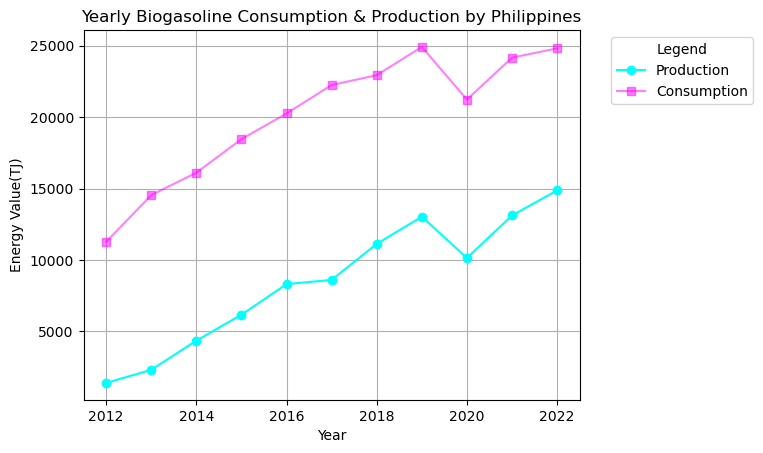

In [467]:
df_biogasoline_philippines = df_production[(df_production['Area'] == 'Philippines') & (df_production['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogasoline_philippines_c = df_consumption[(df_consumption['Area'] == 'Philippines') & (df_consumption['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogasoline_philippines.index, df_biogasoline_philippines.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogasoline_philippines_c.index, df_biogasoline_philippines_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogasoline Consumption & Production by Philippines')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

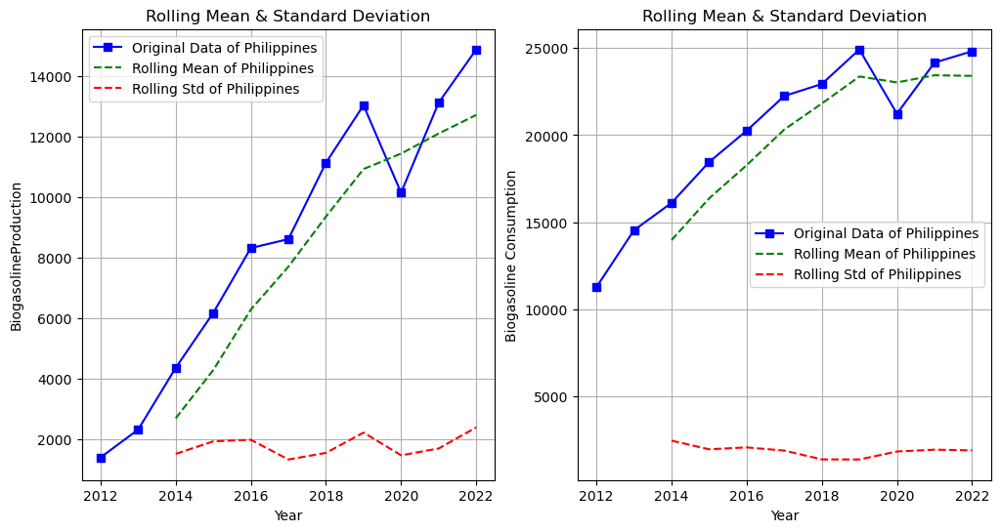

In [468]:
rolling_mean = df_biogasoline_philippines.rolling(window=3).mean()
rolling_std = df_biogasoline_philippines.rolling(window=3).std()
rolling_mean_c = df_biogasoline_philippines_c.rolling(window=3).mean()
rolling_std_c = df_biogasoline_philippines_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogasoline_philippines, label='Original Data of Philippines', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Philippines', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Philippines', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasolineProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogasoline_philippines_c, label='Original Data of Philippines', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Philippines', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Philippines', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogasoline Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [469]:
adf_statistic = adfuller(df_biogasoline_philippines['Value'])[0]
p_value = adfuller(df_biogasoline_philippines['Value'])[1]
critical_points = adfuller(df_biogasoline_philippines['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.3624829448583977
p-value: 0.15260642503101102
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [470]:
df_biogasoline_philippines['Differenced Production'] = df_biogasoline_philippines['Value'].diff()
adf_statistic = adfuller(df_biogasoline_philippines['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogasoline_philippines['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogasoline_philippines['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 377.97811164919733
p-value: 1.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [471]:
df_biogasoline_philippines['Differenced Production 2'] = df_biogasoline_philippines['Differenced Production'].diff()
adf_statistic = adfuller(df_biogasoline_philippines['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_biogasoline_philippines['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_biogasoline_philippines['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.918213421618158
p-value: 2.54289287273841e-07
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

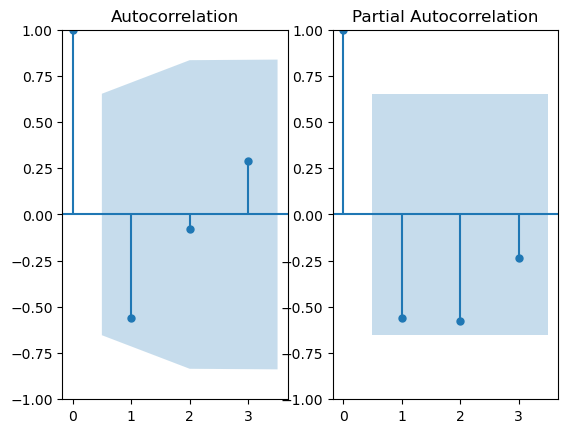

In [472]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_philippines['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biogasoline_philippines['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [473]:
arima_1 = ARIMA(df_biogasoline_philippines['Value'], order=(1,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_philippines['Value'], order=(2,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_philippines['Value'], order=(3,2,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. foreca

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 1)   Log Likelihood                 -79.855
Date:                Tue, 25 Mar 2025   AIC                            165.710
Time:                        00:39:27   BIC                            166.302
Sample:                             0   HQIC                           164.434
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3505      0.878     -0.399      0.690      -2.070       1.369
ma.L1         -0.9976      0.344     -2.902      0.004      -1.671      -0.324
sigma2      2.482e+06   1.39e-07   1.79e+13      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 2, 1)   Log Likelihood                 -78.266
Date:                Tue, 25 Mar 2025   AIC                            166.531
Time:                        00:39:28   BIC                            167.517
Sample:                             0   HQIC                           164.403
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3147      1.237     -0.254      0.799      -2.740       2.111
ar.L2         -0.2023      2.406     -0.084      0.933      -4.918       4.514
ar.L3          0.7496      1.478      0.507      0.6

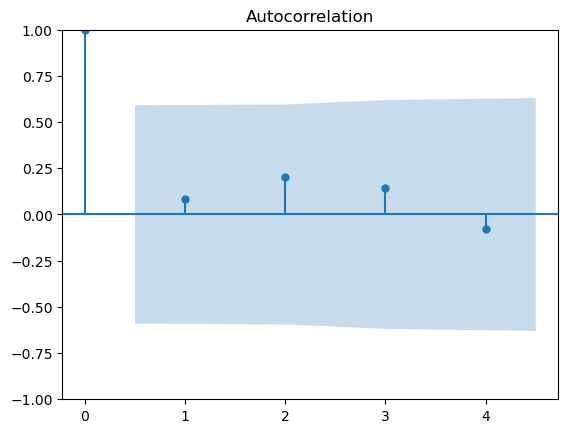

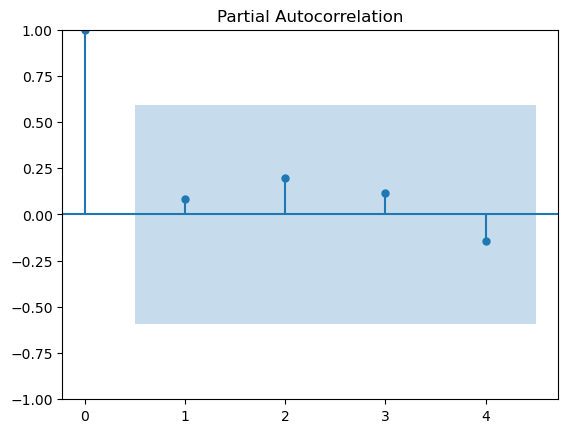

In [474]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


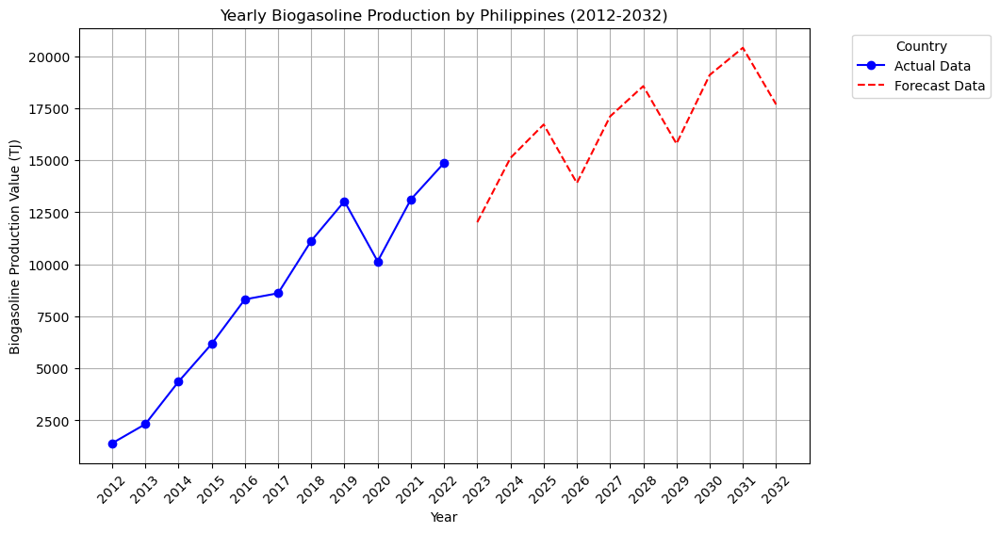

In [475]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_philippines.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_philippines.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_philippines.index ,df_biogasoline_philippines['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Production Value (TJ)')
plt.title('Yearly Biogasoline Production by Philippines (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [476]:
adf_statistic = adfuller(df_biogasoline_philippines_c['Value'])[0]
p_value = adfuller(df_biogasoline_philippines_c['Value'])[1]
critical_points = adfuller(df_biogasoline_philippines_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.1609284919518488
p-value: 0.22073040221799978
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [477]:
df_biogasoline_philippines_c['Differenced Consumption'] = df_biogasoline_philippines_c['Value'].diff()

adf_statistic = adfuller(df_biogasoline_philippines_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biogasoline_philippines_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biogasoline_philippines_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -4.013926847138433
p-value: 0.0013393164485142322
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

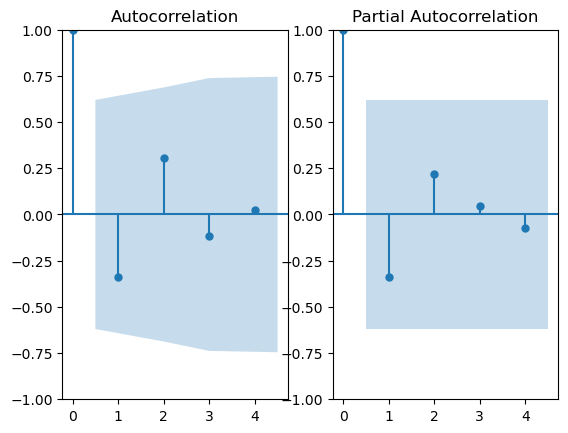

In [478]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_philippines_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogasoline_philippines_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [479]:
arima_1 = ARIMA(df_biogasoline_philippines_c['Value'], order=(1,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_philippines_c['Value'], order=(4,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_philippines_c['Value'], order=(1,1,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogasoline_philippines_c['Value'], order=(4,1,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 -89.436
Date:                Tue, 25 Mar 2025   AIC                            184.873
Time:                        00:39:29   BIC                            185.781
Sample:                             0   HQIC                           183.877
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8777      0.175      5.009      0.000       0.534       1.221
ma.L1         -0.7210      0.277     -2.604      0.009      -1.264      -0.178
sigma2      3.667e+06   1.84e+06      1.990      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 3)   Log Likelihood                 -88.366
Date:                Tue, 25 Mar 2025   AIC                            192.732
Time:                        00:39:30   BIC                            195.153
Sample:                             0   HQIC                           190.077
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.6144      2.224     -0.276      0.782      -4.973       3.744
ar.L2         -0.0985      2.618     -0.038      0.970      -5.229       5.032
ar.L3          0.6442      1.504      0.428      0.6

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


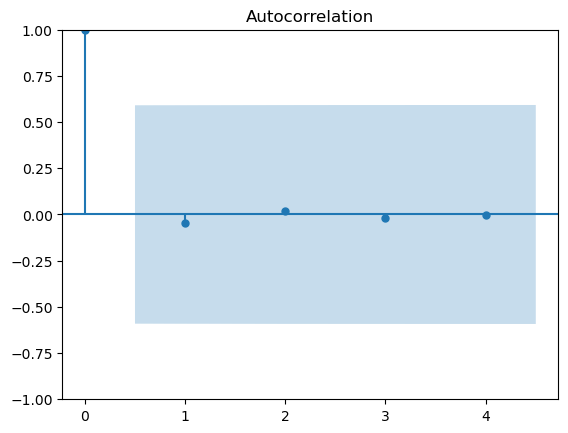

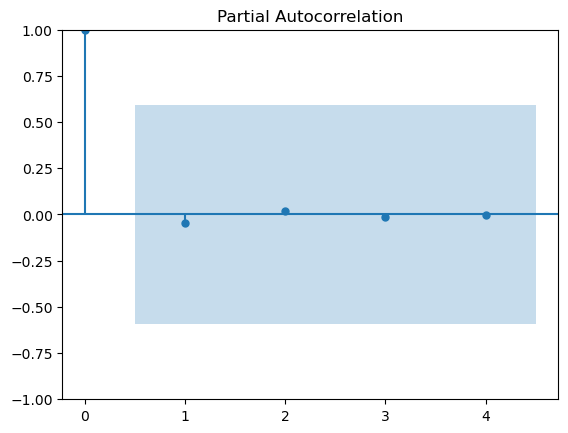

In [480]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


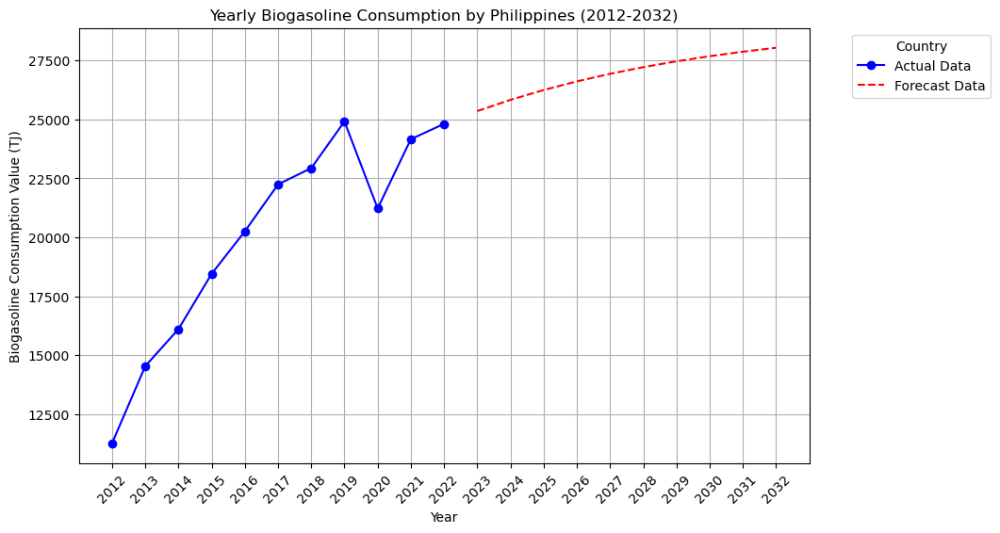

In [481]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_philippines_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_philippines_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_philippines_c.index ,df_biogasoline_philippines_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Consumption Value (TJ)')
plt.title('Yearly Biogasoline Consumption by Philippines (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASOLINE PRODUCTION AND CONSUMPTION IN PHILIPPINES FORECAST

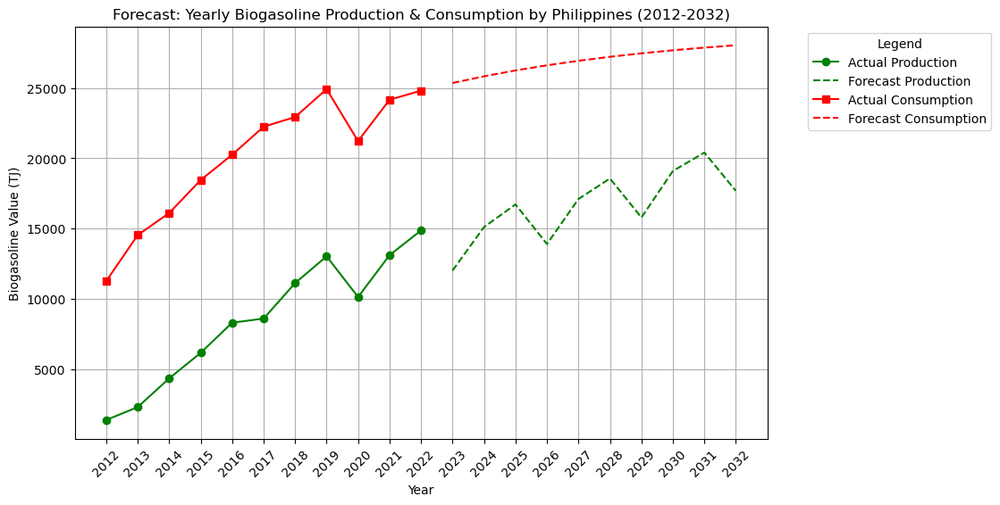

In [482]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogasoline_philippines.index, df_biogasoline_philippines['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogasoline_philippines_c.index, df_biogasoline_philippines_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogasoline Value (TJ)')
plt.title('Forecast: Yearly Biogasoline Production & Consumption by Philippines (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogasoline_philippines.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogasoline Forecast/Forecast of Yearly Biogasoline Production & Consumption by Philippines (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogasoline Production in Turkiye</B>

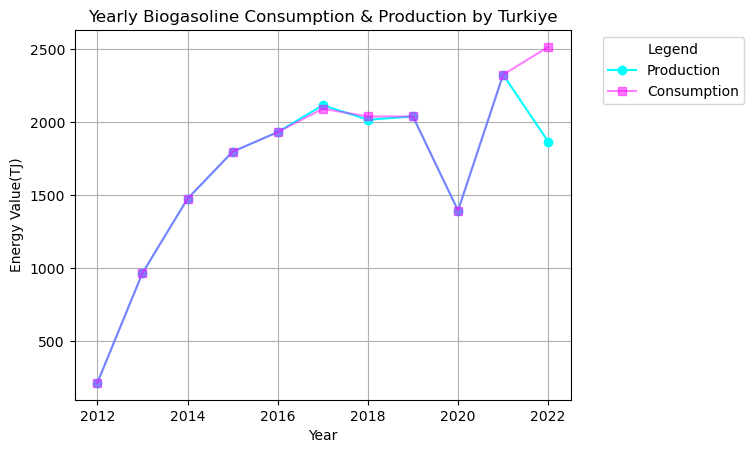

In [483]:
df_biogasoline_turkiye = df_production[(df_production['Area'] == 'Turkiye') & (df_production['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogasoline_turkiye_c = df_consumption[(df_consumption['Area'] == 'Turkiye') & (df_consumption['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogasoline_turkiye.index, df_biogasoline_turkiye.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogasoline_turkiye_c.index, df_biogasoline_turkiye_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogasoline Consumption & Production by Turkiye')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

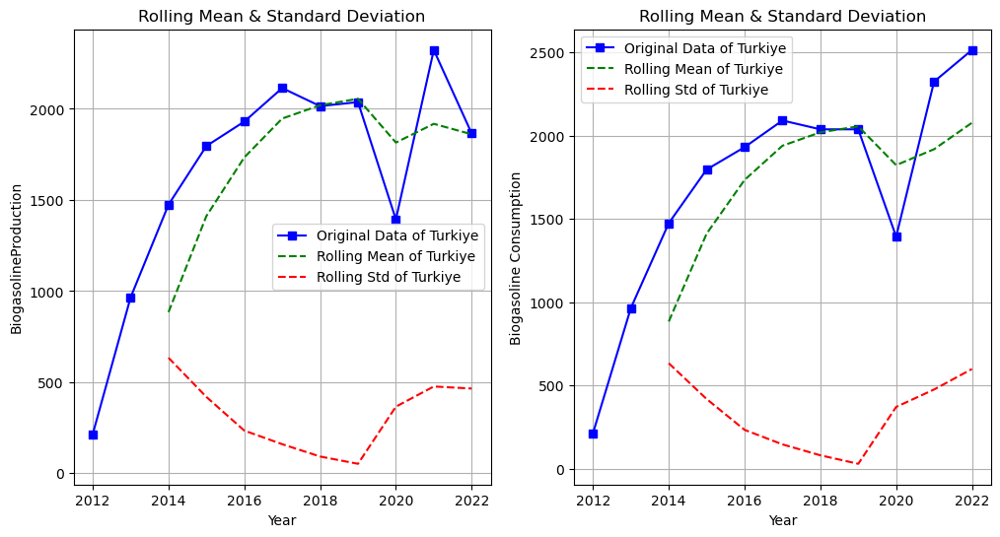

In [484]:
rolling_mean = df_biogasoline_turkiye.rolling(window=3).mean()
rolling_std = df_biogasoline_turkiye.rolling(window=3).std()
rolling_mean_c = df_biogasoline_turkiye_c.rolling(window=3).mean()
rolling_std_c = df_biogasoline_turkiye_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogasoline_turkiye, label='Original Data of Turkiye', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Turkiye', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Turkiye', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasolineProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogasoline_turkiye_c, label='Original Data of Turkiye', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Turkiye', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Turkiye', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogasoline Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [485]:
adf_statistic = adfuller(df_biogasoline_turkiye['Value'])[0]
p_value = adfuller(df_biogasoline_turkiye['Value'])[1]
critical_points = adfuller(df_biogasoline_turkiye['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.9152088979697335
p-value: 0.043607779468772145
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

<B>ACF and PACF PLOTS</B>

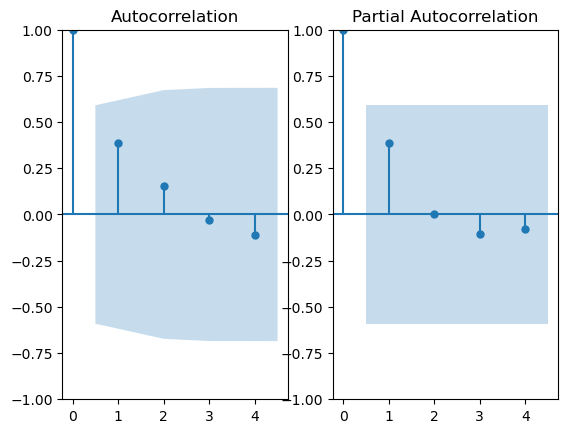

In [486]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_turkiye['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogasoline_turkiye['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [487]:
arima_1 = ARIMA(df_biogasoline_turkiye['Value'], order=(1,3,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_turkiye['Value'], order=(2,3,0))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_turkiye['Value'], order=(3,3,0))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogasoline_turkiye['Value'], order=(1,3,1))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 3, 0)   Log Likelihood                 -63.170
Date:                Tue, 25 Mar 2025   AIC                            130.340
Time:                        00:39:34   BIC                            130.499
Sample:                             0   HQIC                           129.268
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9999      0.216     -4.634      0.000      -1.423      -0.577
sigma2      3.943e+05   1.94e+05      2.034      0.042    1.44e+04    7.74e+05
Ljung-Box (L1) (Q):                   3.45   Jarque-

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

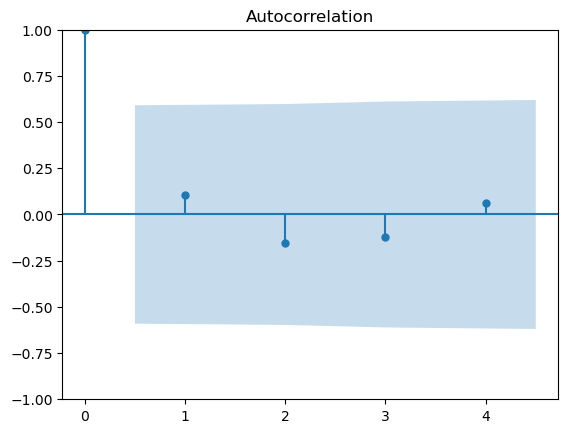

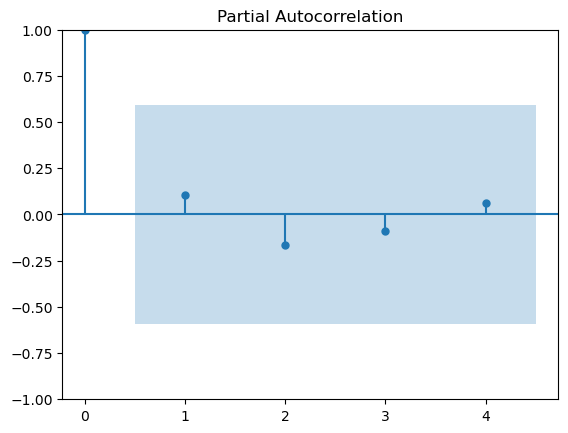

In [488]:
residuals = arima_4_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


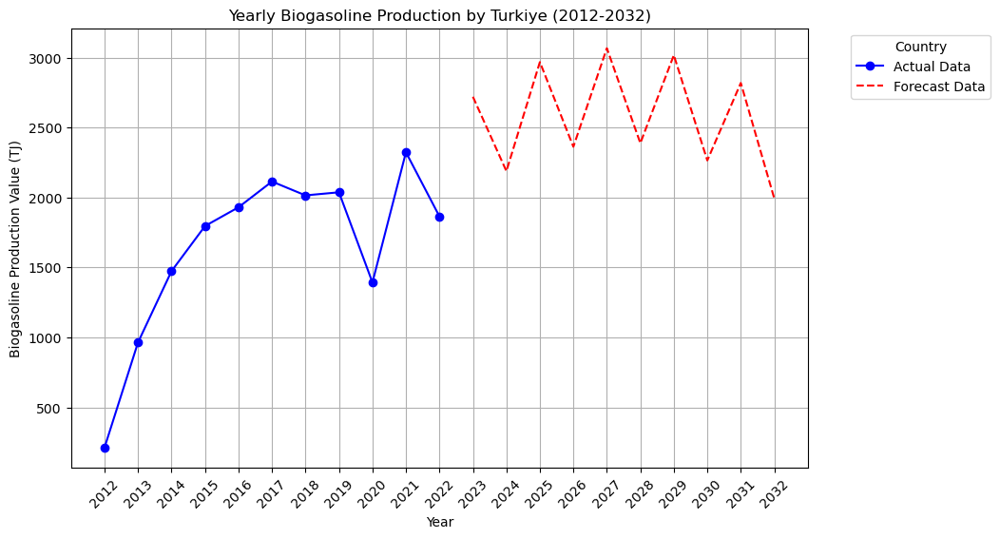

In [489]:
forecast_years = 10
forecast_p = arima_4_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_turkiye.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_turkiye.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_turkiye.index ,df_biogasoline_turkiye['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Production Value (TJ)')
plt.title('Yearly Biogasoline Production by Turkiye (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [490]:
adf_statistic = adfuller(df_biogasoline_turkiye_c['Value'])[0]
p_value = adfuller(df_biogasoline_turkiye_c['Value'])[1]
critical_points = adfuller(df_biogasoline_turkiye_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.6256088735430785
p-value: 0.08781909359773576
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [491]:
df_biogasoline_turkiye_c['Differenced Consumption'] = df_biogasoline_turkiye_c['Value'].diff()

adf_statistic = adfuller(df_biogasoline_turkiye_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biogasoline_turkiye_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biogasoline_turkiye_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -6.704511790215952
p-value: 3.8150537635613246e-09
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

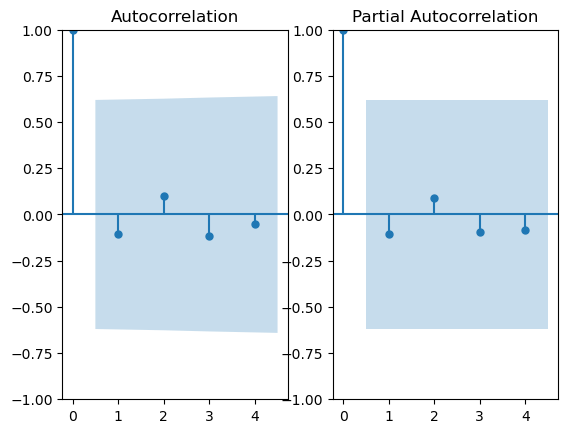

In [492]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_turkiye_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogasoline_turkiye_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [493]:
arima_1 = ARIMA(df_biogasoline_turkiye_c['Value'], order=(1,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_turkiye_c['Value'], order=(3,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_turkiye_c['Value'], order=(1,1,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogasoline_turkiye_c['Value'], order=(3,1,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 -75.580
Date:                Tue, 25 Mar 2025   AIC                            157.160
Time:                        00:39:36   BIC                            158.067
Sample:                             0   HQIC                           156.164
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9996      0.033     29.994      0.000       0.934       1.065
ma.L1         -0.9884      0.529     -1.867      0.062      -2.026       0.049
sigma2      1.971e+05   2.82e-06   6.99e+10      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 1, 3)   Log Likelihood                 -75.462
Date:                Tue, 25 Mar 2025   AIC                            160.924
Time:                        00:39:36   BIC                            162.437
Sample:                             0   HQIC                           159.264
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2987      1.805      0.166      0.869      -3.238       3.836
ma.L1         -0.3205      2.998     -0.107      0.915      -6.196       5.555
ma.L2          0.4666      6.112      0.076      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


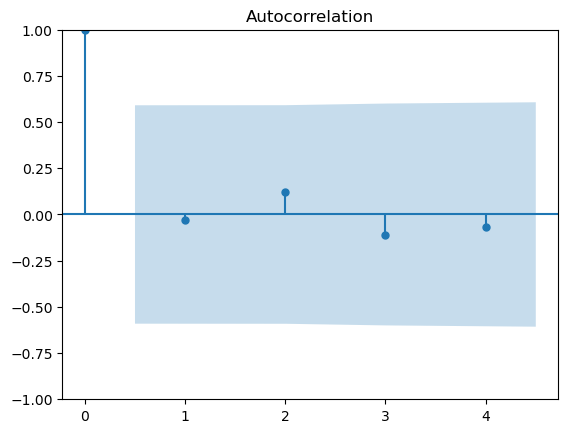

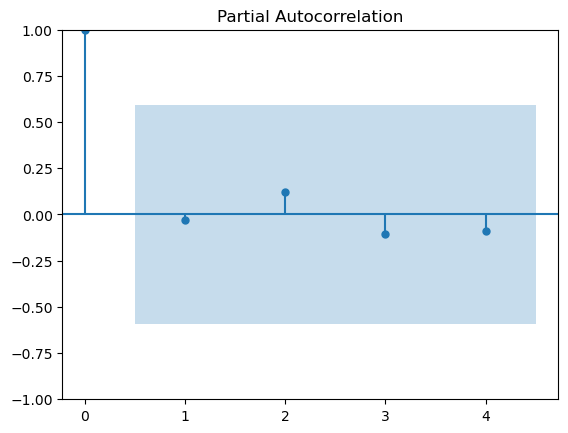

In [494]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


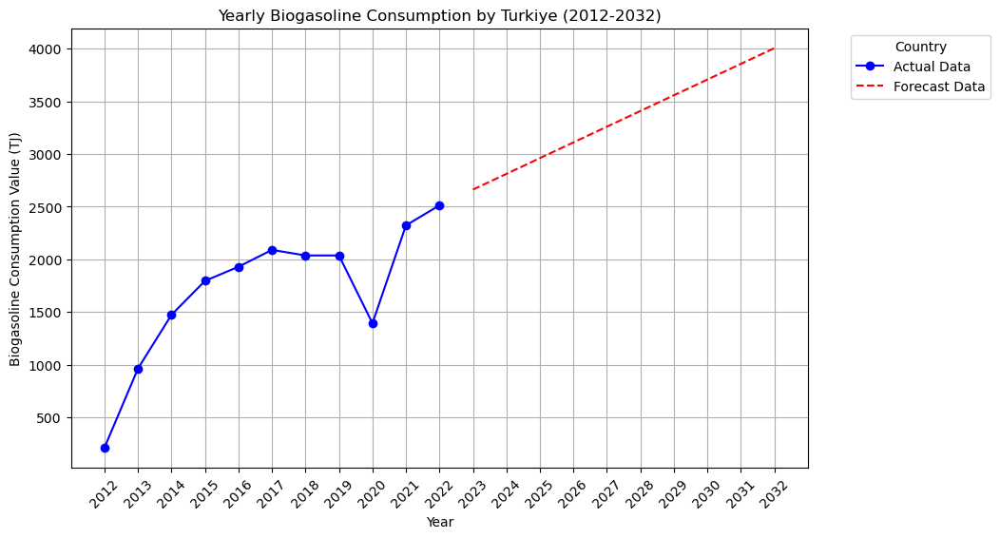

In [495]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_turkiye_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_turkiye_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_turkiye_c.index ,df_biogasoline_turkiye_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Consumption Value (TJ)')
plt.title('Yearly Biogasoline Consumption by Turkiye (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASOLINE PRODUCTION AND CONSUMPTION IN TURKIYE FORECAST

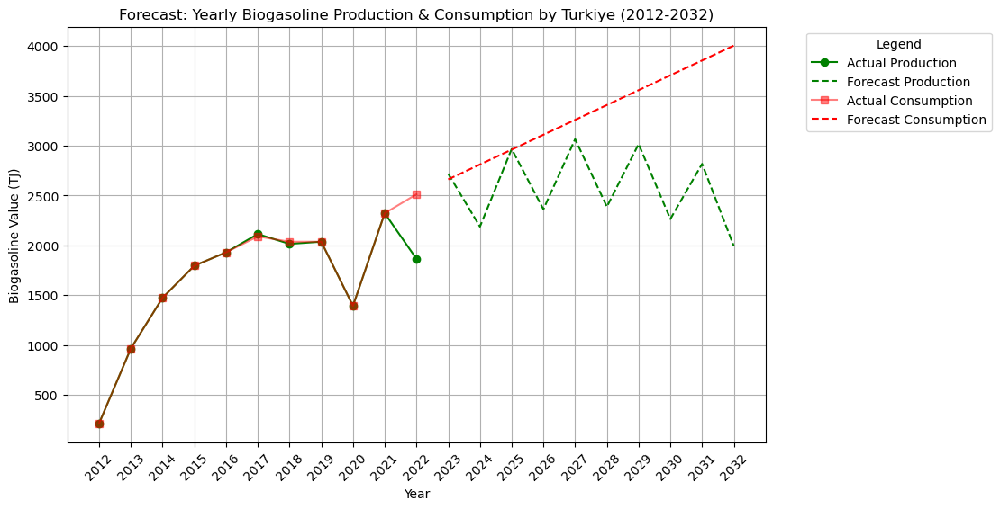

In [496]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogasoline_turkiye.index, df_biogasoline_turkiye['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogasoline_turkiye_c.index, df_biogasoline_turkiye_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption', alpha=0.5)

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogasoline Value (TJ)')
plt.title('Forecast: Yearly Biogasoline Production & Consumption by Turkiye (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogasoline_turkiye.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogasoline Forecast/Forecast of Yearly Biogasoline Production & Consumption by Turkiye (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogasoline Production in Vietnam</B>

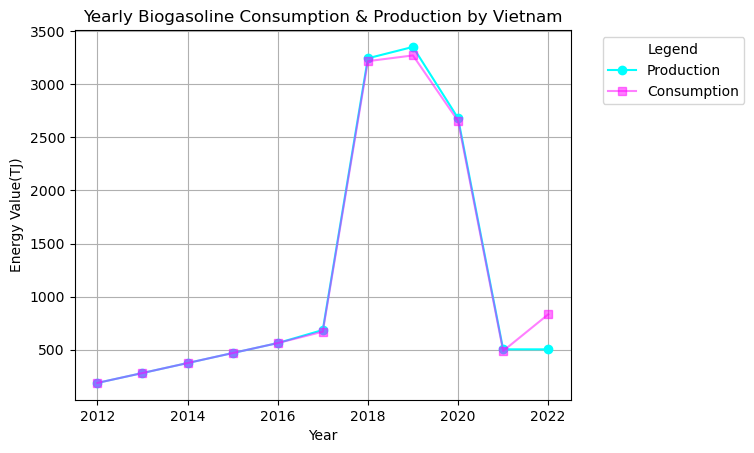

In [497]:
df_biogasoline_vietnam = df_production[(df_production['Area'] == 'Vietnam') & (df_production['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogasoline_vietnam_c = df_consumption[(df_consumption['Area'] == 'Vietnam') & (df_consumption['Item'] == 'Biogasoline')]         .pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogasoline_vietnam.index, df_biogasoline_vietnam.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogasoline_vietnam_c.index, df_biogasoline_vietnam_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogasoline Consumption & Production by Vietnam')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

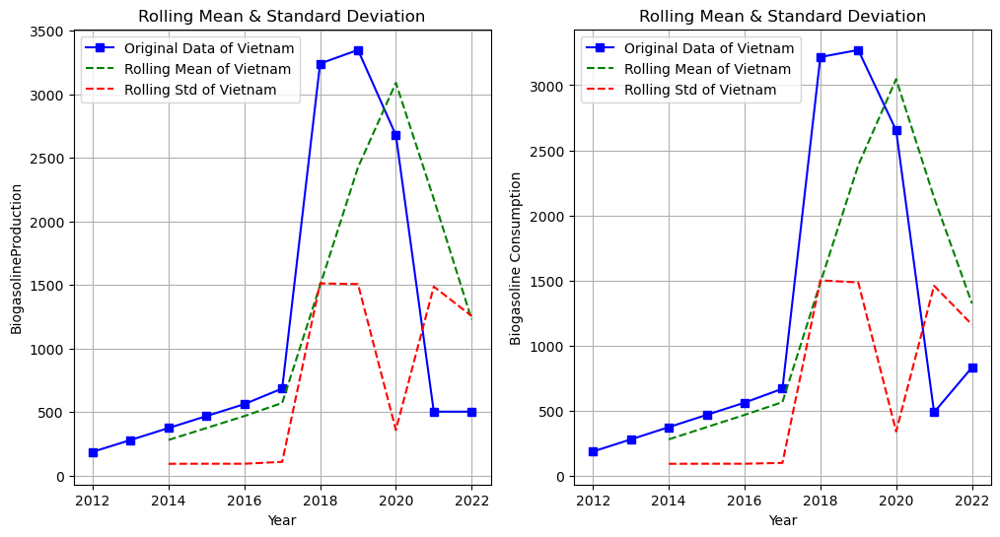

In [498]:
rolling_mean = df_biogasoline_vietnam.rolling(window=3).mean()
rolling_std = df_biogasoline_vietnam.rolling(window=3).std()
rolling_mean_c = df_biogasoline_vietnam_c.rolling(window=3).mean()
rolling_std_c = df_biogasoline_vietnam_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogasoline_vietnam, label='Original Data of Vietnam', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Vietnam', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Vietnam', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasolineProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogasoline_vietnam_c, label='Original Data of Vietnam', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Vietnam', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Vietnam', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogasoline Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [499]:
adf_statistic = adfuller(df_biogasoline_vietnam['Value'])[0]
p_value = adfuller(df_biogasoline_vietnam['Value'])[1]
critical_points = adfuller(df_biogasoline_vietnam['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.9296171843770007
p-value: 0.3182590561209495
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [500]:
df_biogasoline_vietnam['Differenced Production'] = df_biogasoline_vietnam['Value'].diff()
adf_statistic = adfuller(df_biogasoline_vietnam['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogasoline_vietnam['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogasoline_vietnam['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.4831603938389657
p-value: 0.5418245970657809
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [501]:
df_biogasoline_vietnam['Differenced Production 2'] = df_biogasoline_vietnam['Differenced Production'].diff()
adf_statistic = adfuller(df_biogasoline_vietnam['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_biogasoline_vietnam['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_biogasoline_vietnam['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.2128455057170453
p-value: 0.019253067843408505
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

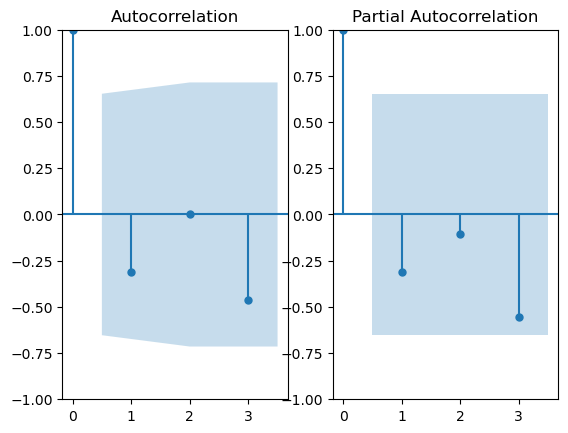

In [502]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_vietnam['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biogasoline_vietnam['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [503]:
arima_1 = ARIMA(df_biogasoline_vietnam['Value'], order=(1,2,3))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_vietnam['Value'], order=(3,2,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_vietnam['Value'], order=(1,2,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogasoline_vietnam['Value'], order=(3,2,1))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Lik

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 3)   Log Likelihood                 -75.837
Date:                Tue, 25 Mar 2025   AIC                            161.673
Time:                        00:39:40   BIC                            162.659
Sample:                             0   HQIC                           159.545
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.6994      2.484     -0.282      0.778      -5.568       4.169
ma.L1          0.2232      3.254      0.069      0.945      -6.155       6.602
ma.L2         -0.4872      1.020     -0.478      0.6

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Lik

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 2, 3)   Log Likelihood                 -75.204
Date:                Tue, 25 Mar 2025   AIC                            164.407
Time:                        00:39:41   BIC                            165.788
Sample:                             0   HQIC                           161.428
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1083      2.513      0.043      0.966      -4.818       5.035
ar.L2         -0.0293      9.641     -0.003      0.998     -18.926      18.867
ar.L3         -0.7134      4.778     -0.149      0.8

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


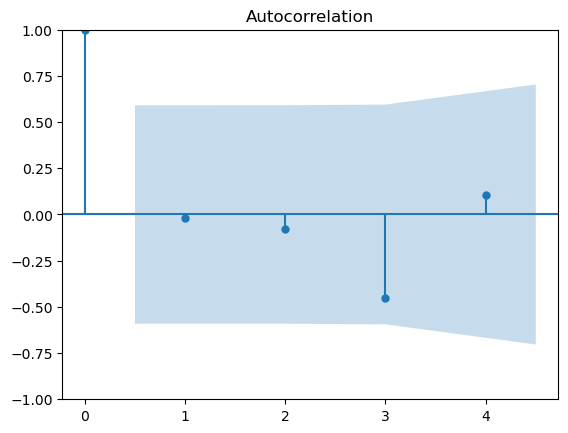

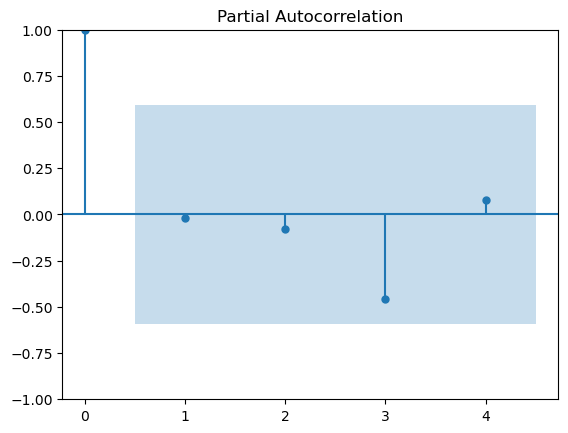

In [504]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


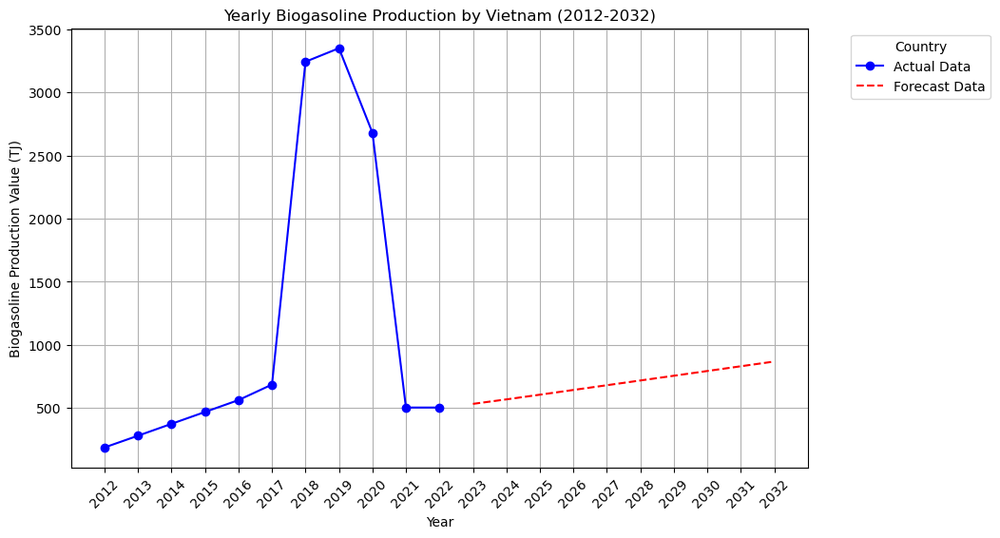

In [505]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_vietnam.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_vietnam.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_vietnam.index ,df_biogasoline_vietnam['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Production Value (TJ)')
plt.title('Yearly Biogasoline Production by Vietnam (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [506]:
adf_statistic = adfuller(df_biogasoline_vietnam_c['Value'])[0]
p_value = adfuller(df_biogasoline_vietnam_c['Value'])[1]
critical_points = adfuller(df_biogasoline_vietnam_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.5534106136633663
p-value: 0.5069441091090524
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Consumption to convert non stationary data to stationary</B>

In [507]:
df_biogasoline_vietnam_c['Differenced Consumption'] = df_biogasoline_vietnam_c['Value'].diff()

adf_statistic = adfuller(df_biogasoline_vietnam_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biogasoline_vietnam_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biogasoline_vietnam_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.4474446960505793
p-value: 0.5593312538597208
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


<B>Differencing 2nd time the Consumption to convert non stationary data to stationary</B>

In [508]:
df_biogasoline_vietnam_c['Differenced Consumption 2'] = df_biogasoline_vietnam_c['Differenced Consumption'].diff()

adf_statistic = adfuller(df_biogasoline_vietnam_c['Differenced Consumption 2'].dropna())[0]
p_value = adfuller(df_biogasoline_vietnam_c['Differenced Consumption 2'].dropna())[1]
critical_points = adfuller(df_biogasoline_vietnam_c['Differenced Consumption 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.3015286800492465
p-value: 0.01481028058173417
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

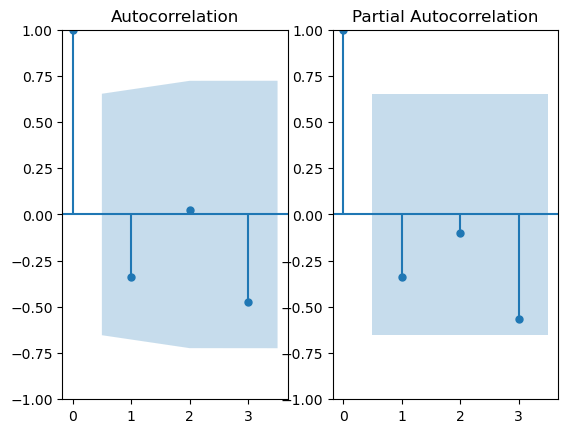

In [509]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogasoline_vietnam_c['Differenced Consumption 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biogasoline_vietnam_c['Differenced Consumption 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [510]:
arima_1 = ARIMA(df_biogasoline_vietnam_c['Value'], order=(1,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogasoline_vietnam_c['Value'], order=(3,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogasoline_vietnam_c['Value'], order=(1,2,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogasoline_vietnam_c['Value'], order=(3,2,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 1)   Log Likelihood                 -76.850
Date:                Tue, 25 Mar 2025   AIC                            159.701
Time:                        00:39:43   BIC                            160.292
Sample:                             0   HQIC                           158.424
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1409      0.514      0.274      0.784      -0.866       1.148
ma.L1         -0.9976      0.510     -1.955      0.051      -1.998       0.002
sigma2      1.316e+06   3.89e-07   3.38e+12      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 2, 1)   Log Likelihood                 -75.166
Date:                Tue, 25 Mar 2025   AIC                            160.333
Time:                        00:39:43   BIC                            161.319
Sample:                             0   HQIC                           158.204
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0151      0.549      0.027      0.978      -1.060       1.090
ar.L2         -0.2169      0.518     -0.419      0.675      -1.232       0.798
ar.L3         -0.6633      0.400     -1.660      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 2, 3)   Log Likelihood                 -75.081
Date:                Tue, 25 Mar 2025   AIC                            164.162
Time:                        00:39:43   BIC                            165.543
Sample:                             0   HQIC                           161.183
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0417      3.312      0.013      0.990      -6.449       6.533
ar.L2         -0.0476      8.269     -0.006      0.995     -16.255      16.160
ar.L3         -0.7401      3.974     -0.186      0.8

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


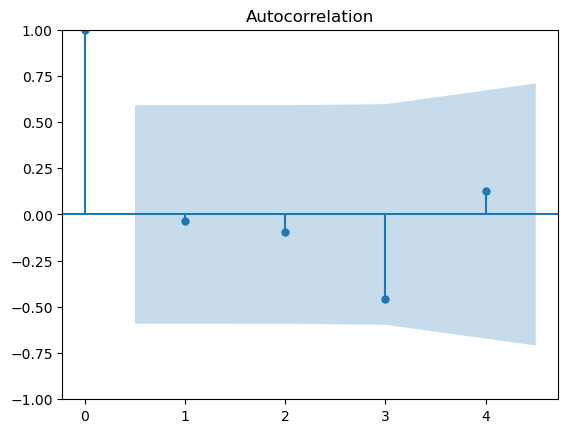

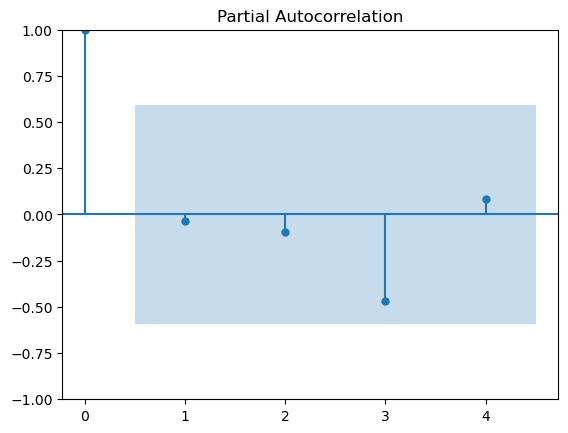

In [511]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


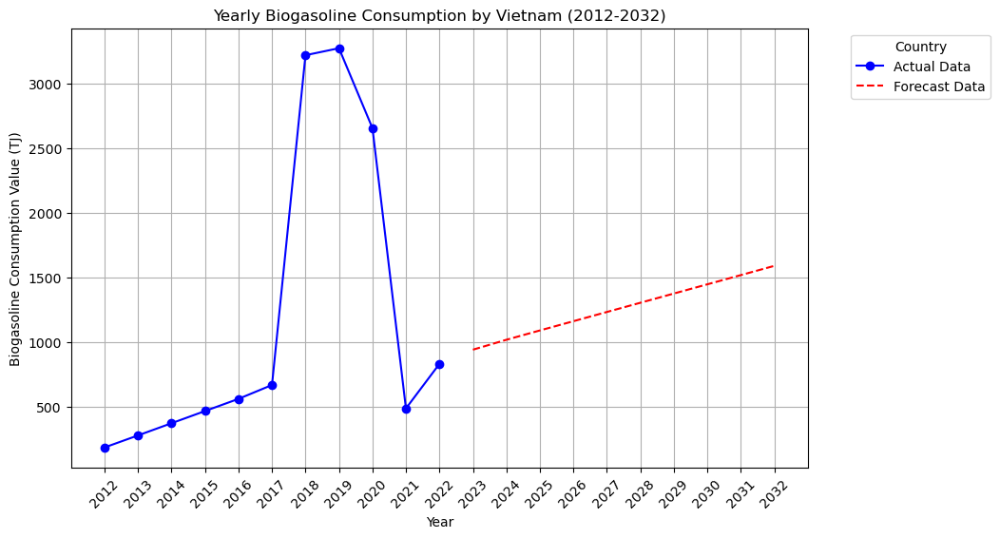

In [512]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogasoline_vietnam_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogasoline_vietnam_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogasoline_vietnam_c.index ,df_biogasoline_vietnam_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogasoline Consumption Value (TJ)')
plt.title('Yearly Biogasoline Consumption by Vietnam (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASOLINE PRODUCTION AND CONSUMPTION IN VIETNAM FORECAST

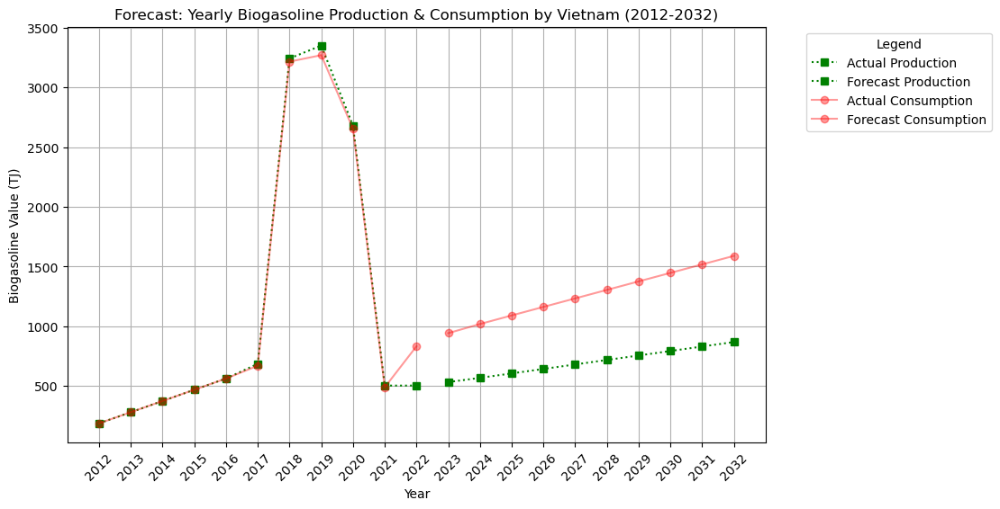

In [513]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogasoline_vietnam.index, df_biogasoline_vietnam['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogasoline_vietnam_c.index, df_biogasoline_vietnam_c['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogasoline Value (TJ)')
plt.title('Forecast: Yearly Biogasoline Production & Consumption by Vietnam (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogasoline_vietnam.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogasoline Forecast/Forecast of Yearly Biogasoline Production & Consumption by Vietnam (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogases Production in Thailand</B>

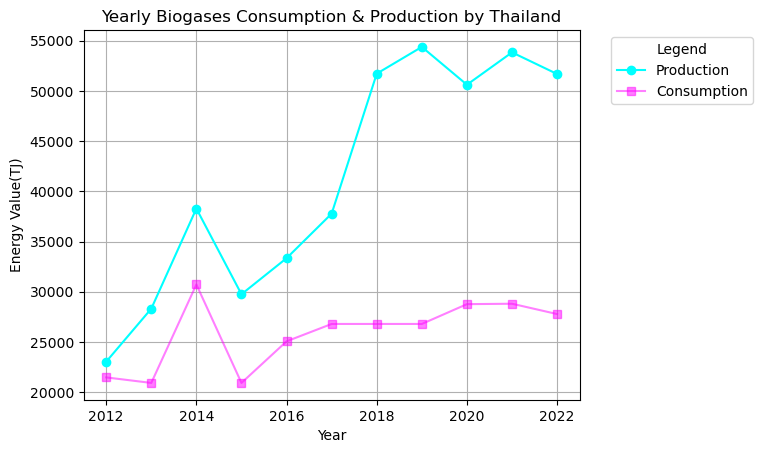

In [514]:
df_biogases_thailand = df_production[(df_production['Area'] == 'Thailand') & (df_production['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogases_thailand_c = df_consumption[(df_consumption['Area'] == 'Thailand') & (df_consumption['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogases_thailand.index, df_biogases_thailand.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogases_thailand_c.index, df_biogases_thailand_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogases Consumption & Production by Thailand')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

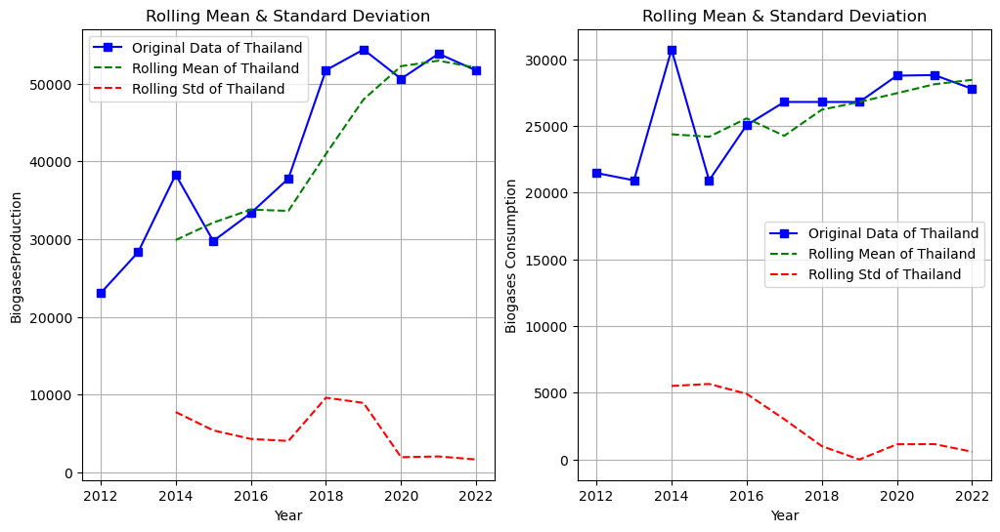

In [515]:
rolling_mean = df_biogases_thailand.rolling(window=3).mean()
rolling_std = df_biogases_thailand.rolling(window=3).std()
rolling_mean_c = df_biogases_thailand_c.rolling(window=3).mean()
rolling_std_c = df_biogases_thailand_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogases_thailand, label='Original Data of Thailand', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Thailand', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Thailand', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasesProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogases_thailand_c, label='Original Data of Thailand', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Thailand', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Thailand', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogases Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [516]:
adf_statistic = adfuller(df_biogases_thailand['Value'])[0]
p_value = adfuller(df_biogases_thailand['Value'])[1]
critical_points = adfuller(df_biogases_thailand['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.438245475942296
p-value: 0.5638097163588158
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [517]:
df_biogases_thailand['Differenced Production'] = df_biogases_thailand['Value'].diff()
adf_statistic = adfuller(df_biogases_thailand['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogases_thailand['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogases_thailand['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -24.327655668934394
p-value: 0.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

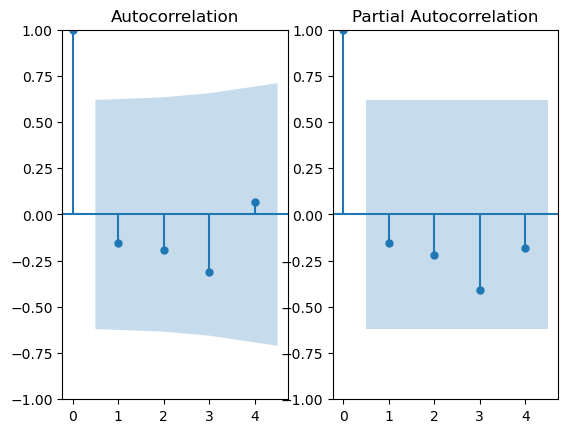

In [518]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogases_thailand['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogases_thailand['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [519]:
arima_1 = ARIMA(df_biogases_thailand['Value'], order=(3,1,3))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogases_thailand['Value'], order=(4,1,3))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 3)   Log Likelihood                 -99.946
Date:                Tue, 25 Mar 2025   AIC                            213.892
Time:                        00:39:48   BIC                            216.010
Sample:                             0   HQIC                           211.569
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0769      2.065     -0.037      0.970      -4.123       3.970
ar.L2          0.6765      1.044      0.648      0.517      -1.371       2.724
ar.L3          0.2845      1.027      0.277      0.7

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


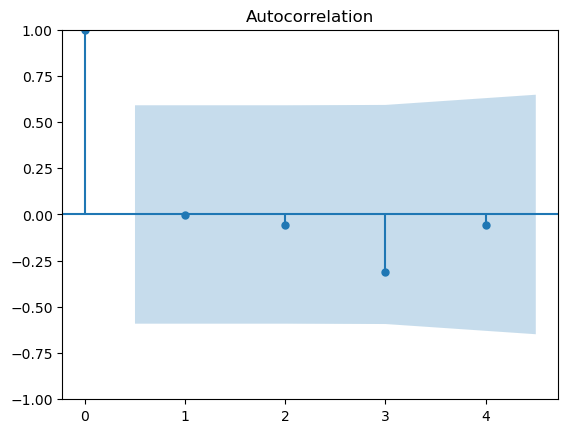

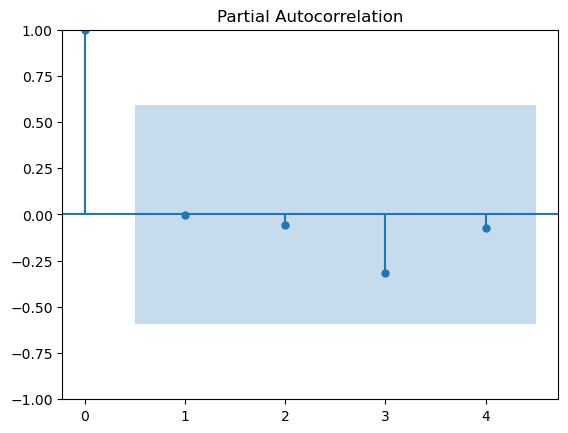

In [520]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


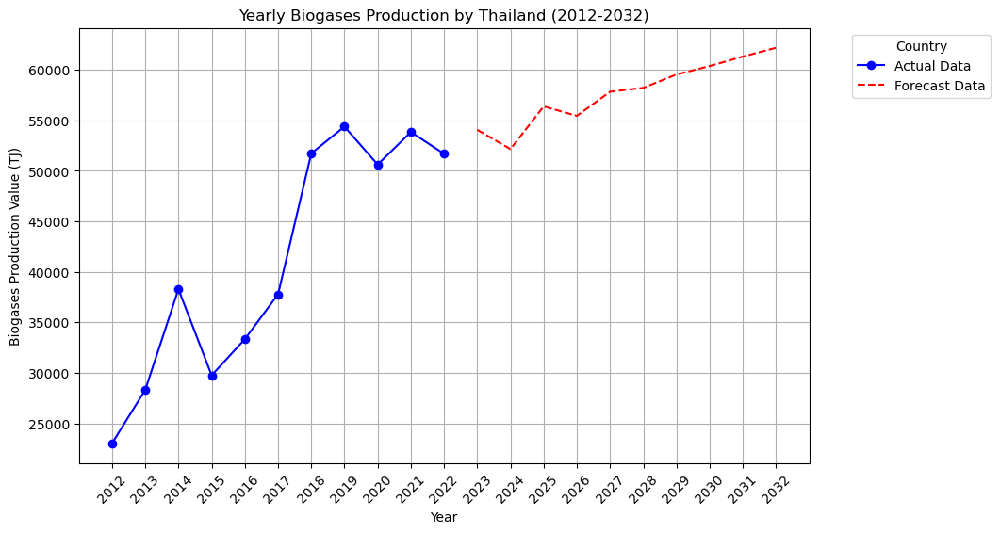

In [521]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogases_thailand.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogases_thailand.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogases_thailand.index ,df_biogases_thailand['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogases Production Value (TJ)')
plt.title('Yearly Biogases Production by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [522]:
adf_statistic = adfuller(df_biogases_thailand_c['Value'])[0]
p_value = adfuller(df_biogases_thailand_c['Value'])[1]
critical_points = adfuller(df_biogases_thailand_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.1868760745685396
p-value: 0.020757022706740846
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

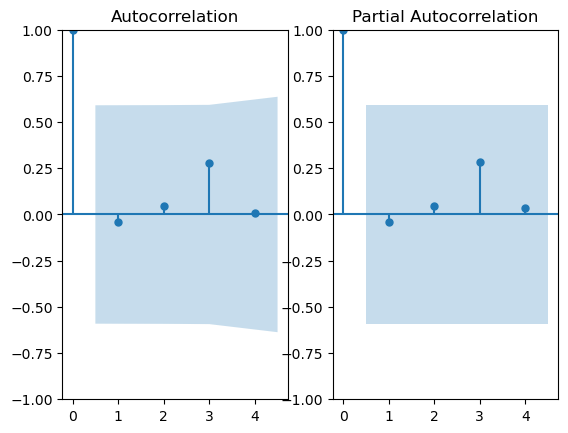

In [523]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogases_thailand_c['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogases_thailand_c['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [524]:
arima_1 = ARIMA(df_biogases_thailand_c['Value'], order=(1,0,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogases_thailand_c['Value'], order=(3,0,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogases_thailand_c['Value'], order=(1,0,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogases_thailand_c['Value'], order=(3,0,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. foreca

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -104.543
Date:                Tue, 25 Mar 2025   AIC                            217.085
Time:                        00:39:50   BIC                            218.677
Sample:                             0   HQIC                           216.082
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.588e+04   1073.483     24.107      0.000    2.38e+04     2.8e+04
ar.L1         -1.0000      0.026    -38.517      0.000      -1.051      -0.949
ma.L1          0.9999      0.771      1.298      0.1

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 3)   Log Likelihood                -102.729
Date:                Tue, 25 Mar 2025   AIC                            217.458
Time:                        00:39:50   BIC                            219.845
Sample:                             0   HQIC                           215.953
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.597e+04   1328.563     19.545      0.000    2.34e+04    2.86e+04
ar.L1         -0.4520      1.267     -0.357      0.721      -2.935       2.031
ma.L1          0.1865      4.397      0.042      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


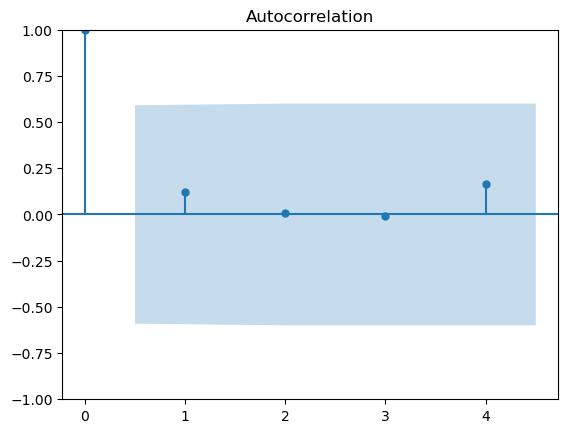

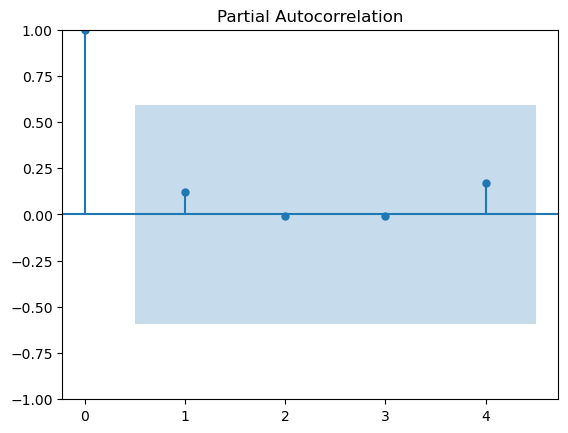

In [525]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


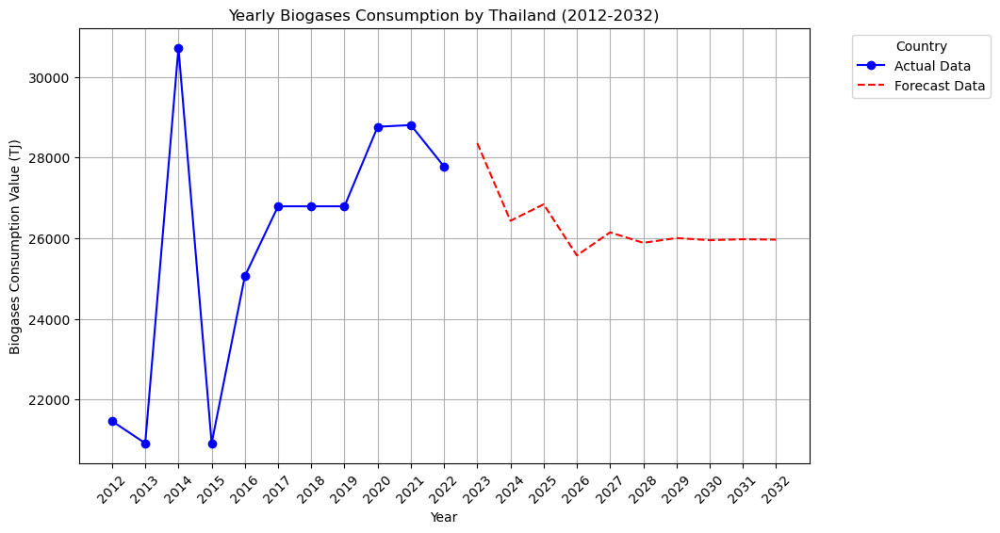

In [526]:
forecast_years = 10
forecast_c = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_biogases_thailand_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogases_thailand_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogases_thailand_c.index ,df_biogases_thailand_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogases Consumption Value (TJ)')
plt.title('Yearly Biogases Consumption by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASES PRODUCTION AND CONSUMPTION IN THAILAND FORECAST

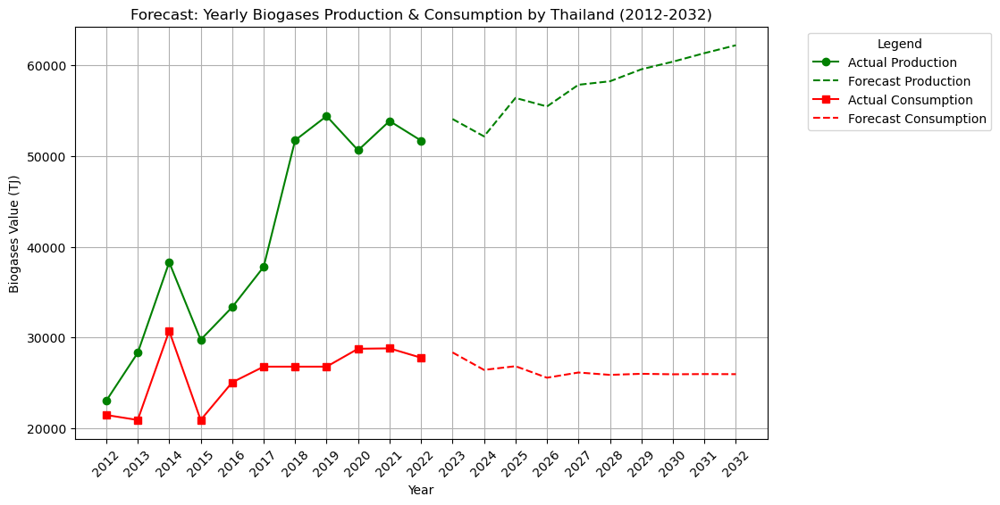

In [527]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogases_thailand.index, df_biogases_thailand['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogases_thailand_c.index, df_biogases_thailand_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogases Value (TJ)')
plt.title('Forecast: Yearly Biogases Production & Consumption by Thailand (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogases_thailand.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogases Forecast/Forecast of Yearly Biogases Production & Consumption by Thailand (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogases Production in Turkiye</B>

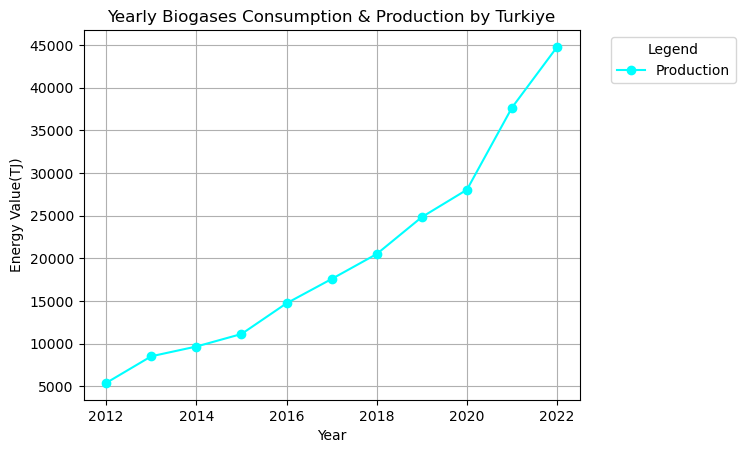

In [528]:
df_biogases_turkiye = df_production[(df_production['Area'] == 'Turkiye') & (df_production['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogases_turkiye_c = df_consumption[(df_consumption['Area'] == 'Turkiye') & (df_consumption['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogases_turkiye.index, df_biogases_turkiye.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogases_turkiye_c.index, df_biogases_turkiye_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogases Consumption & Production by Turkiye')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

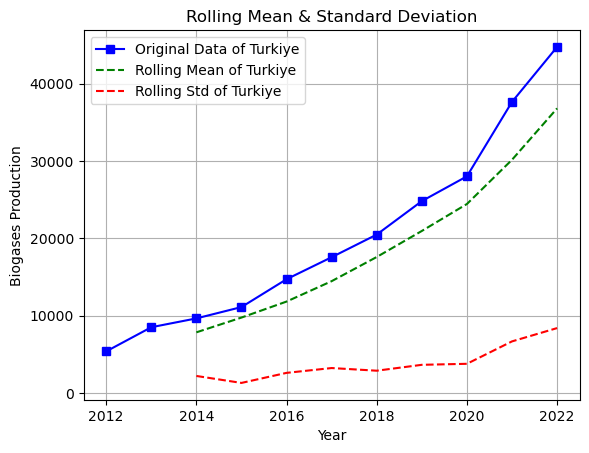

In [529]:
rolling_mean = df_biogases_turkiye.rolling(window=3).mean()
rolling_std = df_biogases_turkiye.rolling(window=3).std()

plt.plot(df_biogases_turkiye, label='Original Data of Turkiye', color='blue', marker='s')
plt.plot(rolling_mean, label='Rolling Mean of Turkiye', color='green', linestyle='--')
plt.plot(rolling_std, label='Rolling Std of Turkiye', color='red', linestyle='--')

plt.xlabel('Year')
plt.ylabel('Biogases Production')
plt.title('Rolling Mean & Standard Deviation')

plt.legend()
plt.grid()
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity)

In [530]:
adf_statistic = adfuller(df_biogases_turkiye['Value'])[0]
p_value = adfuller(df_biogases_turkiye['Value'])[1]
critical_points = adfuller(df_biogases_turkiye['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 3.710983521906479
p-value: 1.0
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


<B>Differencing the Production to convert non stationary data to stationary</B>

In [531]:
df_biogases_turkiye['Differenced Production'] = df_biogases_turkiye['Value'].diff()
adf_statistic = adfuller(df_biogases_turkiye['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogases_turkiye['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogases_turkiye['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 0.5617375431642674
p-value: 0.9866335558988273
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


<B>Differencing 2nd time the Production to convert non stationary data to stationary</B>

In [532]:
df_biogases_turkiye['Differenced Production 2'] = df_biogases_turkiye['Differenced Production'].diff()
adf_statistic = adfuller(df_biogases_turkiye['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_biogases_turkiye['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_biogases_turkiye['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.016188088467408
p-value: 2.0612901761009453e-05
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

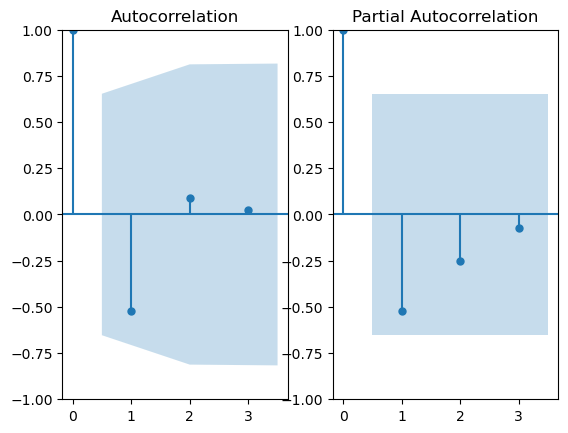

In [533]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogases_turkiye['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biogases_turkiye['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [534]:
arima_1 = ARIMA(df_biogases_turkiye['Value'], order=(1,2,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogases_turkiye['Value'], order=(2,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogases_turkiye['Value'], order=(3,2,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 1)   Log Likelihood                 -82.562
Date:                Tue, 25 Mar 2025   AIC                            171.124
Time:                        00:39:54   BIC                            171.715
Sample:                             0   HQIC                           169.847
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0844      2.244     -0.038      0.970      -4.482       4.313
ma.L1         -0.3743      1.630     -0.230      0.818      -3.570       2.821
sigma2      5.394e+06   3.25e+06      1.661      0.0

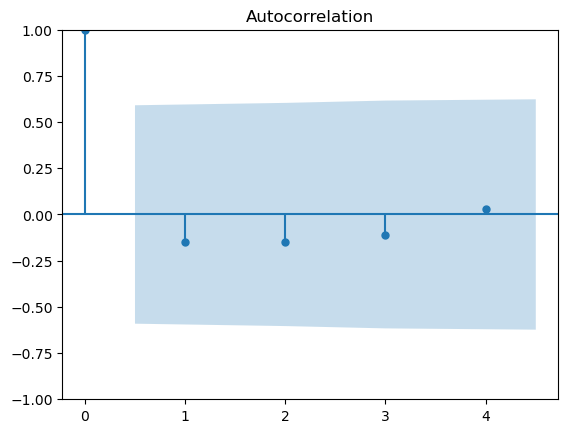

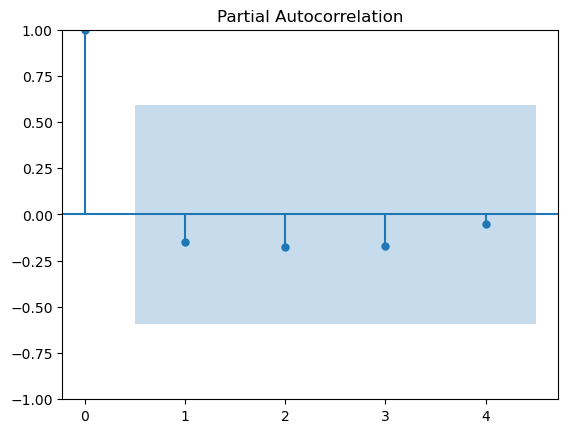

In [535]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


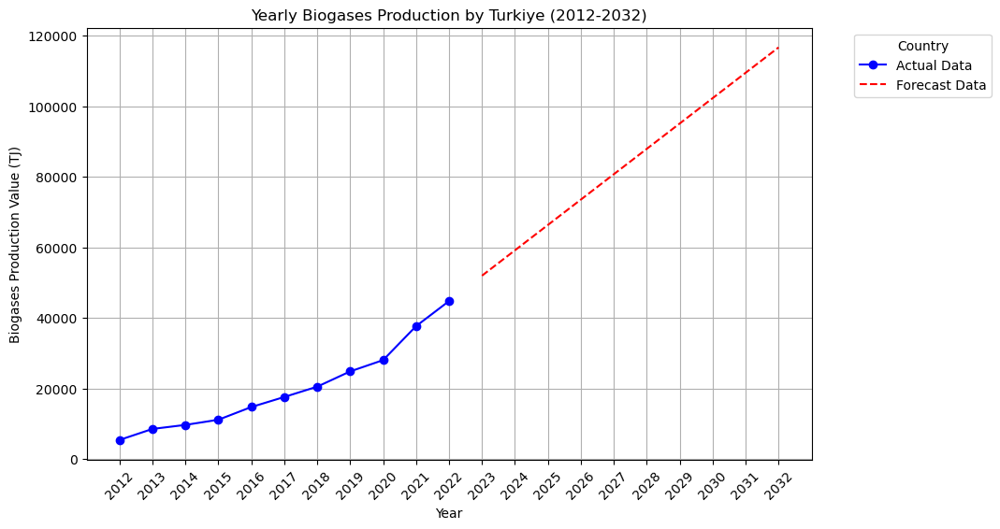

In [536]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogases_turkiye.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogases_turkiye.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogases_turkiye.index ,df_biogases_turkiye['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogases Production Value (TJ)')
plt.title('Yearly Biogases Production by Turkiye (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

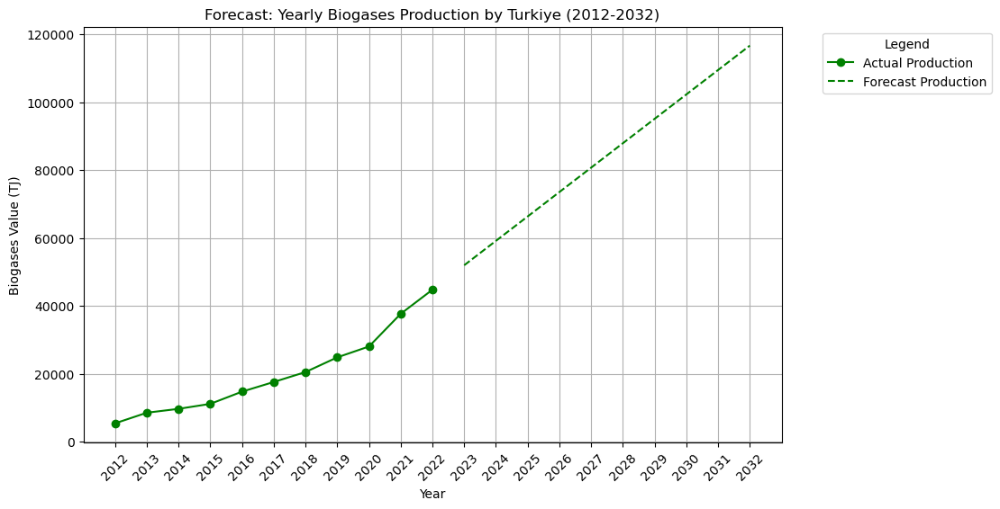

In [537]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogases_turkiye.index, df_biogases_turkiye['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogases Value (TJ)')
plt.title('Forecast: Yearly Biogases Production by Turkiye (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogases_turkiye.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Save the plot
plt.savefig('static/Biogases Forecast/Forecast of Yearly Biogases Production by Turkiye (2012-2032).png', bbox_inches='tight')

# Show the plot
plt.show()

## <B>Yearly Biogases Production in Nepal</B>

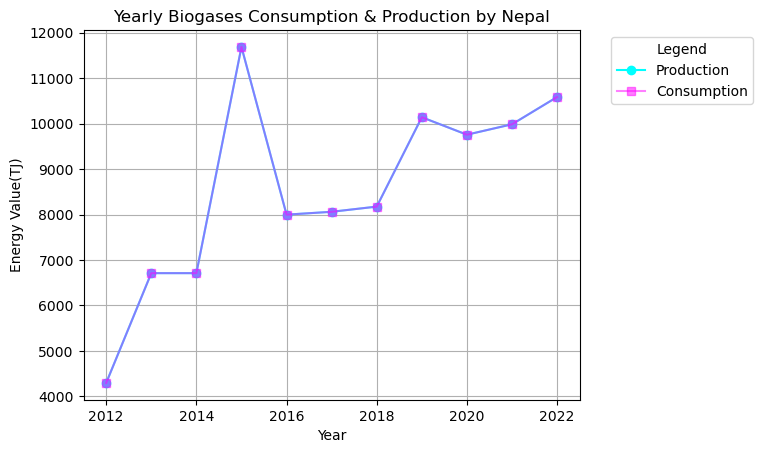

In [538]:
df_biogases_nepal = df_production[(df_production['Area'] == 'Nepal') & (df_production['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogases_nepal_c = df_consumption[(df_consumption['Area'] == 'Nepal') & (df_consumption['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogases_nepal.index, df_biogases_nepal.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogases_nepal_c.index, df_biogases_nepal_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogases Consumption & Production by Nepal')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

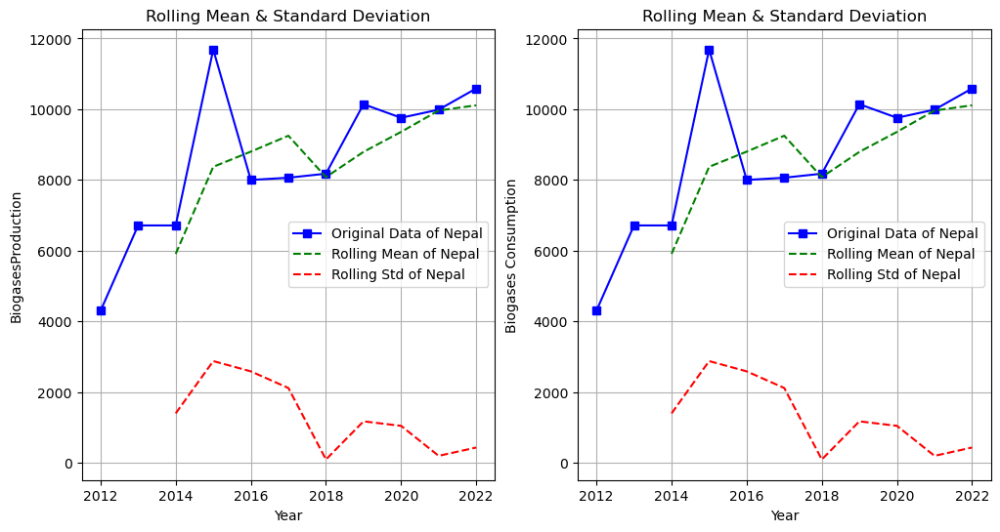

In [539]:
rolling_mean = df_biogases_nepal.rolling(window=3).mean()
rolling_std = df_biogases_nepal.rolling(window=3).std()
rolling_mean_c = df_biogases_nepal_c.rolling(window=3).mean()
rolling_std_c = df_biogases_nepal_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogases_nepal, label='Original Data of Nepal', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Nepal', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Nepal', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasesProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogases_nepal_c, label='Original Data of Nepal', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Nepal', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Nepal', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogases Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

In [540]:
adf_statistic = adfuller(df_biogases_nepal['Value'])[0]
p_value = adfuller(df_biogases_nepal['Value'])[1]
critical_points = adfuller(df_biogases_nepal['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 12.674633378048934
p-value: 1.0
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


In [541]:
df_biogases_nepal['Differenced Production'] = df_biogases_nepal['Value'].diff()
adf_statistic = adfuller(df_biogases_nepal['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogases_nepal['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogases_nepal['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 0.8720654828581101
p-value: 0.9927147270342767
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


In [542]:
df_biogases_nepal['Differenced Production 2'] = df_biogases_nepal['Differenced Production'].diff()
adf_statistic = adfuller(df_biogases_nepal['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_biogases_nepal['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_biogases_nepal['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -44.67334410397382
p-value: 0.0
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

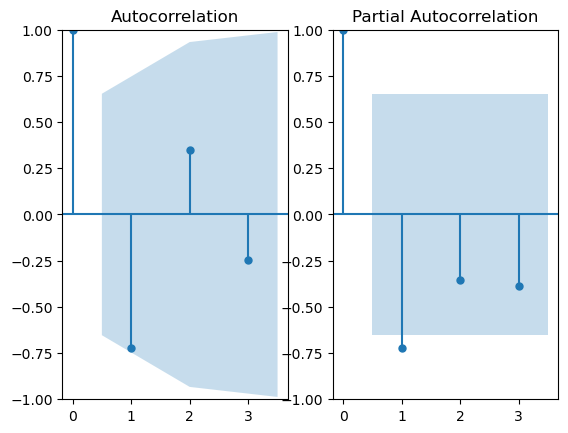

In [543]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogases_nepal['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_biogases_nepal['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [544]:
arima_1 = ARIMA(df_biogases_nepal['Value'], order=(1,2,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogases_nepal['Value'], order=(1,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogases_nepal['Value'], order=(1,2,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_biogases_nepal['Value'], order=(1,2,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 2, 0)   Log Likelihood                 -84.113
Date:                Tue, 25 Mar 2025   AIC                            172.226
Time:                        00:39:57   BIC                            172.620
Sample:                             0   HQIC                           171.375
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.6694      0.296     -2.260      0.024      -1.250      -0.089
sigma2      7.065e+06   5.89e+06      1.199      0.230   -4.48e+06    1.86e+07
Ljung-Box (L1) (Q):                   1.31   Jarque-

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All

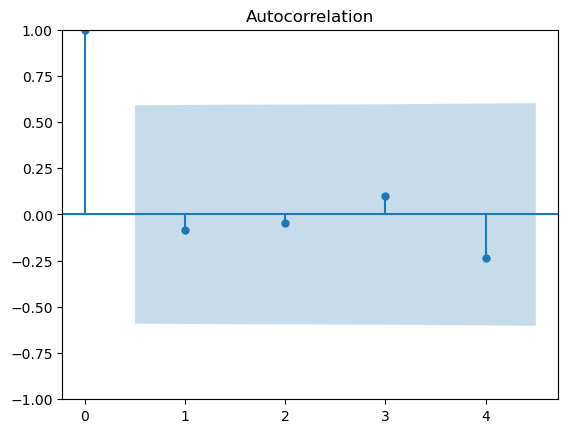

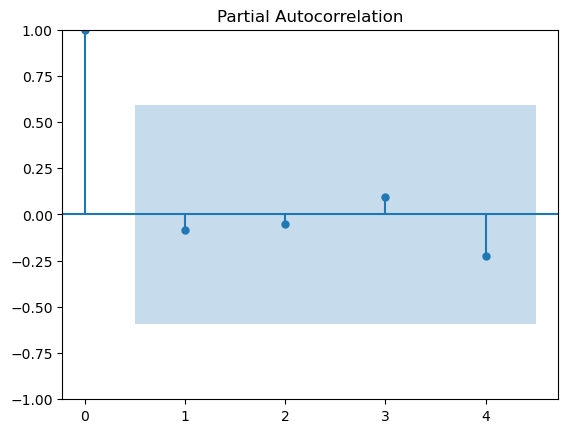

In [545]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


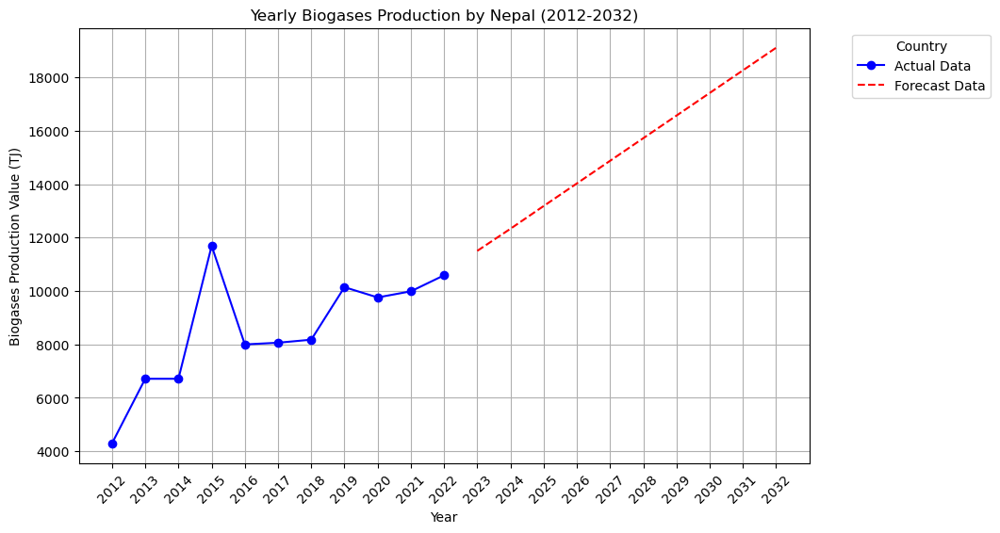

In [546]:
forecast_years = 10
forecast_p = arima_2_fit.forecast(steps=forecast_years)

last_year = int(df_biogases_nepal.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogases_nepal.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogases_nepal.index ,df_biogases_nepal['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogases Production Value (TJ)')
plt.title('Yearly Biogases Production by Nepal (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASES PRODUCTION AND CONSUMPTION IN NEPAL FORECAST

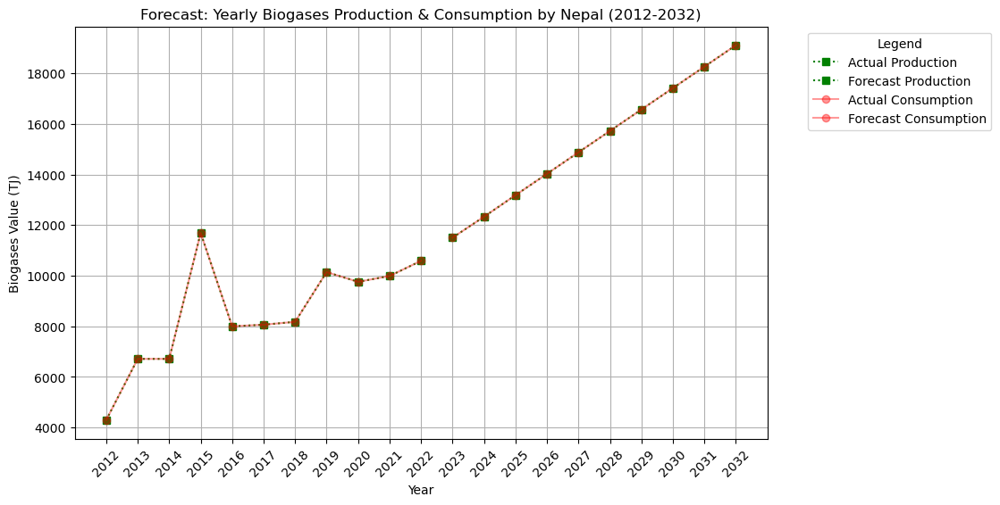

In [547]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogases_nepal.index, df_biogases_nepal['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogases_nepal.index, df_biogases_nepal['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogases Value (TJ)')
plt.title('Forecast: Yearly Biogases Production & Consumption by Nepal (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogases_nepal.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogases Forecast/Forecast of Yearly Biogases Production & Consumption by Nepal (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogases Production in Korea</B>

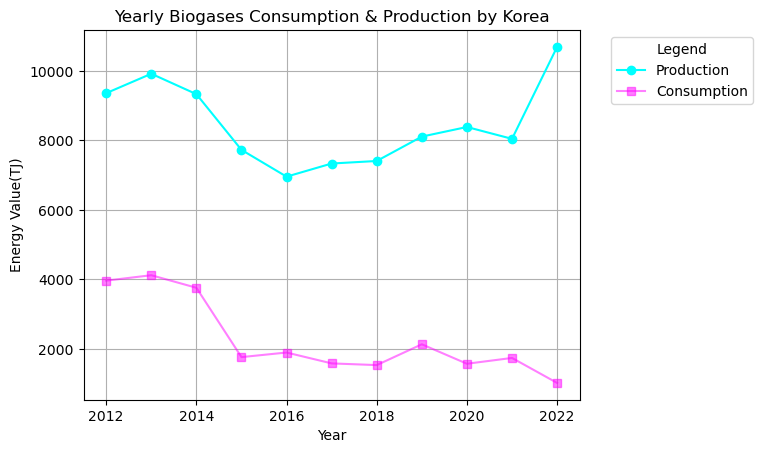

In [548]:
df_biogases_korea = df_production[(df_production['Area'] == 'Korea') & (df_production['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogases_korea_c = df_consumption[(df_consumption['Area'] == 'Korea') & (df_consumption['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogases_korea.index, df_biogases_korea.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogases_korea_c.index, df_biogases_korea_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogases Consumption & Production by Korea')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

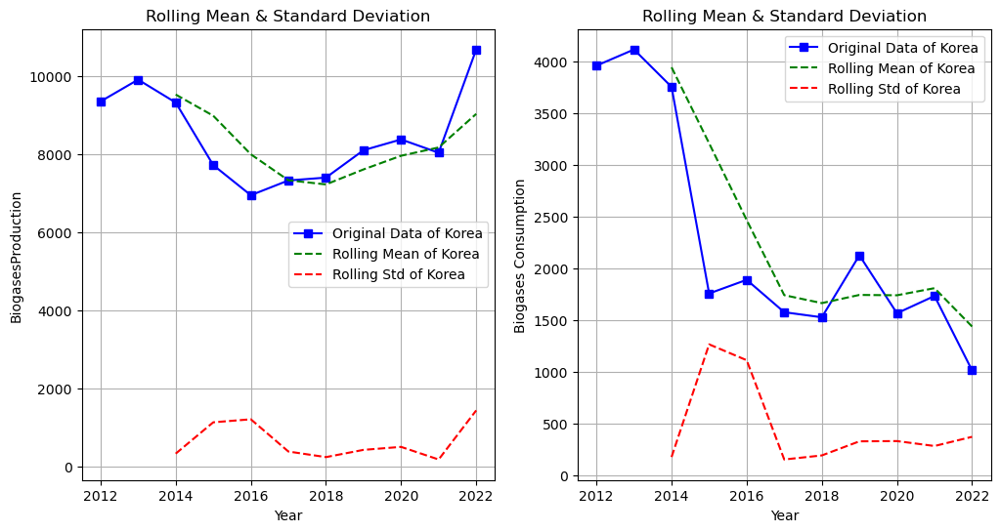

In [549]:
rolling_mean = df_biogases_korea.rolling(window=3).mean()
rolling_std = df_biogases_korea.rolling(window=3).std()
rolling_mean_c = df_biogases_korea_c.rolling(window=3).mean()
rolling_std_c = df_biogases_korea_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_biogases_korea, label='Original Data of Korea', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Korea', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Korea', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('BiogasesProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_biogases_korea_c, label='Original Data of Korea', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Korea', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Korea', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Biogases Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

In [550]:
adf_statistic = adfuller(df_biogases_korea['Value'])[0]
p_value = adfuller(df_biogases_korea['Value'])[1]
critical_points = adfuller(df_biogases_korea['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.0455463324901524
p-value: 0.7362921636157336
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


In [551]:
df_biogases_korea['Differenced Production'] = df_biogases_korea['Value'].diff()
adf_statistic = adfuller(df_biogases_korea['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogases_korea['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogases_korea['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.3232630803156389
p-value: 0.6184633743932848
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


In [552]:
df_biogases_korea['Differenced Production 2'] = df_biogases_korea['Differenced Production'].diff()
adf_statistic = adfuller(df_biogases_korea['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_biogases_korea['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_biogases_korea['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.5506653775459203
p-value: 0.10362832496012314
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


In [553]:
df_biogases_korea['Differenced Production 3'] = df_biogases_korea['Differenced Production 2'].diff()
adf_statistic = adfuller(df_biogases_korea['Differenced Production 3'].dropna())[0]
p_value = adfuller(df_biogases_korea['Differenced Production 3'].dropna())[1]
critical_points = adfuller(df_biogases_korea['Differenced Production 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.127990833775535
p-value: 0.23340929268248867
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


In [554]:
df_biogases_korea['Differenced Production 4'] = df_biogases_korea['Differenced Production 3'].diff()
adf_statistic = adfuller(df_biogases_korea['Differenced Production 4'].dropna())[0]
p_value = adfuller(df_biogases_korea['Differenced Production 4'].dropna())[1]
critical_points = adfuller(df_biogases_korea['Differenced Production 4'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.906205477580855
p-value: 0.3291475131758605
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


In [555]:
df_biogases_korea['Differenced Production 5'] = df_biogases_korea['Differenced Production 4'].diff()
adf_statistic = adfuller(df_biogases_korea['Differenced Production 5'].dropna())[0]
p_value = adfuller(df_biogases_korea['Differenced Production 5'].dropna())[1]
critical_points = adfuller(df_biogases_korea['Differenced Production 5'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -7.298428559116329
p-value: 1.3585316046999626e-10
critical points: {'1%': -7.355440625, '5%': -4.474365000000001, '10%': -3.1269325}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 5 (d=5)

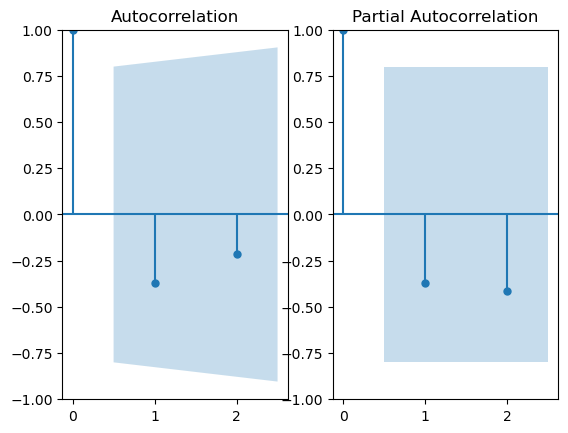

In [556]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogases_korea['Differenced Production 5'].dropna(), ax=ax[0], lags=2)
plot_pacf(df_biogases_korea['Differenced Production 5'].dropna(), ax=ax[1], lags=2)
plt.show()

In [557]:
arima_1 = ARIMA(df_biogases_korea['Value'], order=(2,5,0))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogases_korea['Value'], order=(2,5,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_biogases_korea['Value'], order=(2,5,2))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

# arima_4 = ARIMA(df_biogases_korea['Value'], order=(1,5,1))
# arima_4_fit = arima_4.fit()
# print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 5, 0)   Log Likelihood                 -55.197
Date:                Tue, 25 Mar 2025   AIC                            116.395
Time:                        00:40:01   BIC                            115.770
Sample:                             0   HQIC                           113.894
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8783      0.378     -2.326      0.020      -1.618      -0.138
ar.L2         -0.6228      0.210     -2.959      0.003      -1.035      -0.210
sigma2       3.48e+06    1.6e-08   2.17e+14      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


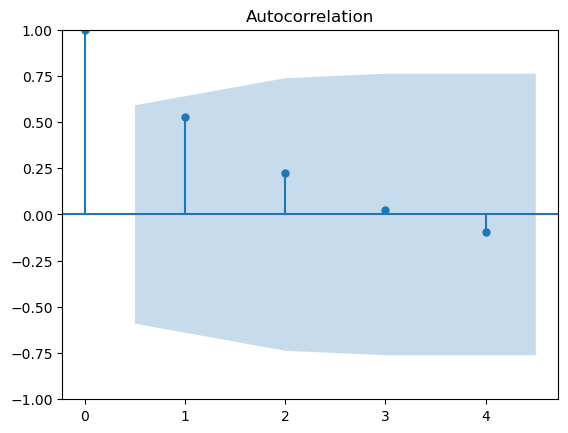

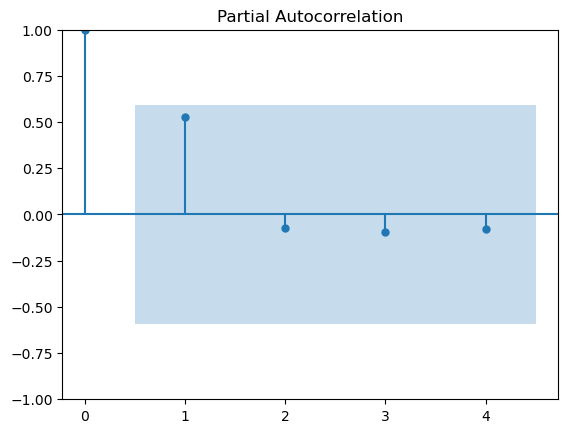

In [558]:
residuals = arima_2_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


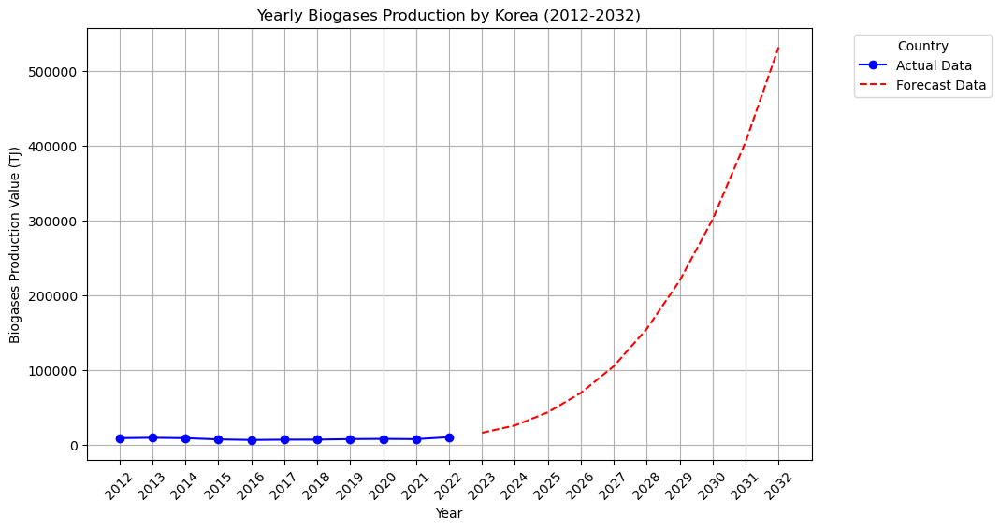

In [559]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_biogases_korea.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogases_korea.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogases_korea.index ,df_biogases_korea['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogases Production Value (TJ)')
plt.title('Yearly Biogases Production by Korea (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [560]:
adf_statistic = adfuller(df_biogases_korea_c['Value'])[0]
p_value = adfuller(df_biogases_korea_c['Value'])[1]
critical_points = adfuller(df_biogases_korea_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.3448098803985669
p-value: 0.6084307371316537
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


In [561]:
df_biogases_korea_c['Differenced Consumption'] = df_biogases_korea_c['Value'].diff()

adf_statistic = adfuller(df_biogases_korea_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_biogases_korea_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_biogases_korea_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.3716107830795976
p-value: 0.011965578386142291
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 10% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

<B>ACF and PACF PLOTS</B>

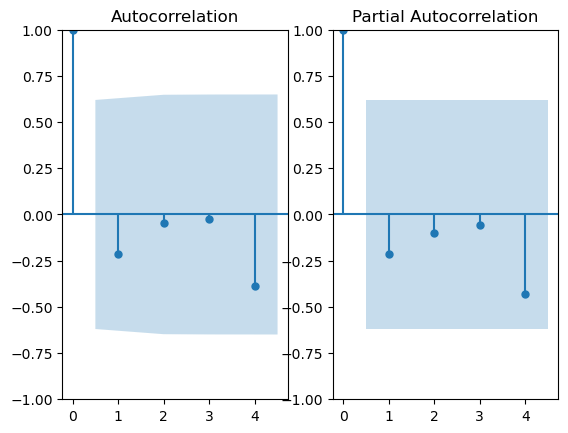

In [562]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogases_korea_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_biogases_korea_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [563]:
arima_1 = ARIMA(df_biogases_korea_c['Value'], order=(4,1,4))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(4, 1, 4)   Log Likelihood                 -77.513
Date:                Tue, 25 Mar 2025   AIC                            173.026
Time:                        00:40:04   BIC                            175.749
Sample:                             0   HQIC                           170.038
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9829      1.848     -0.532      0.595      -4.605       2.639
ar.L2         -0.0051      1.630     -0.003      0.997      -3.199       3.189
ar.L3         -0.0101      2.295     -0.004      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


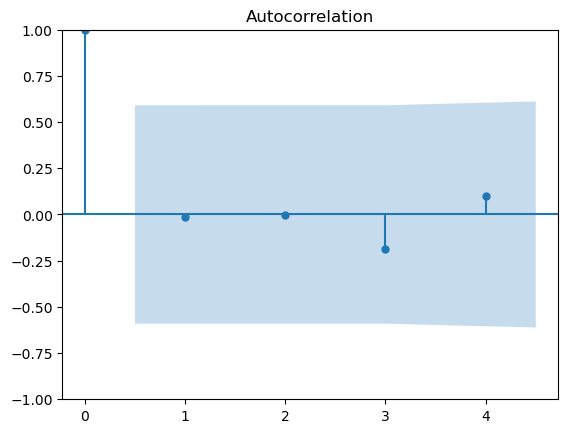

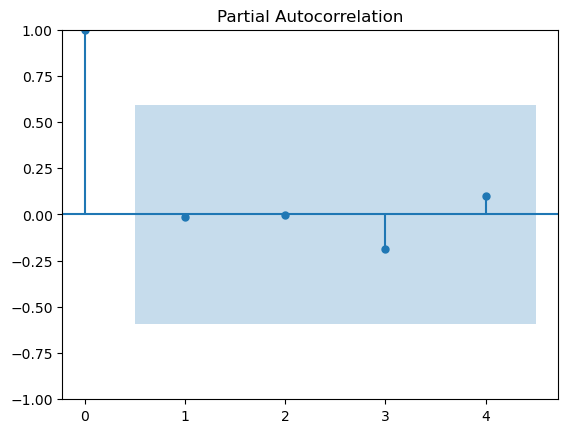

In [564]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


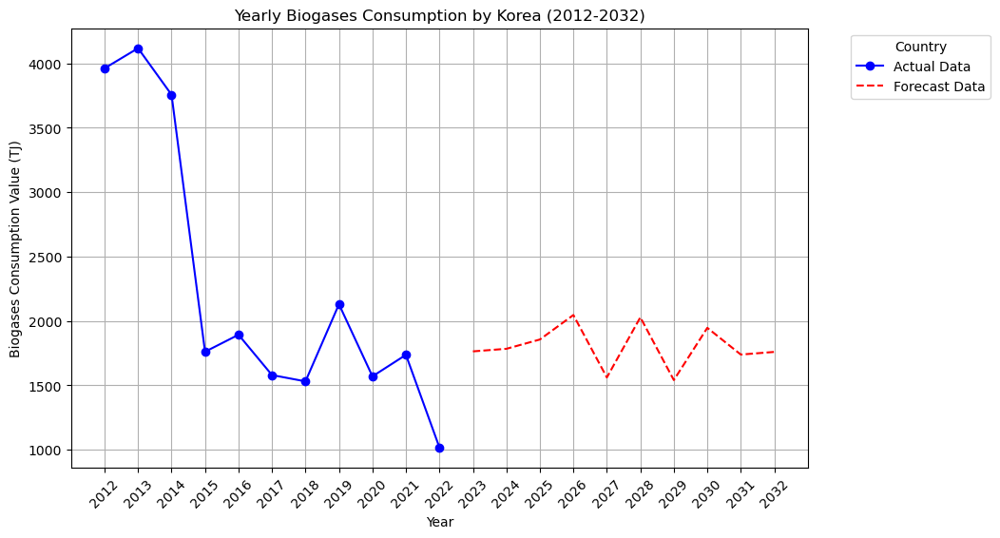

In [565]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogases_korea_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogases_korea_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogases_korea_c.index ,df_biogases_korea_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogases Consumption Value (TJ)')
plt.title('Yearly Biogases Consumption by Korea (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASES PRODUCTION AND CONSUMPTION IN KOREA FORECAST

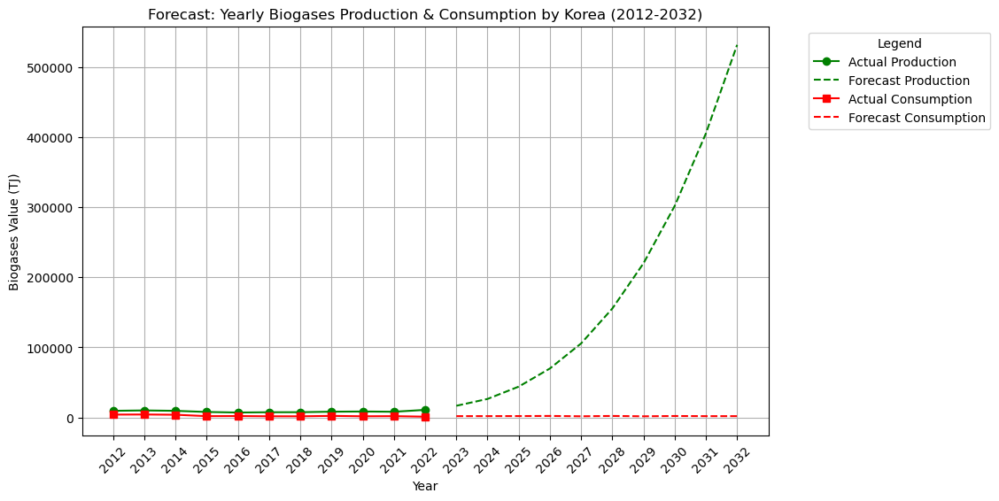

In [566]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogases_korea.index, df_biogases_korea['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_biogases_korea_c.index, df_biogases_korea_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogases Value (TJ)')
plt.title('Forecast: Yearly Biogases Production & Consumption by Korea (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogases_korea.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Biogases Forecast/Forecast of Yearly Biogases Production & Consumption by Korea (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Biogases Production in Malaysia</B>

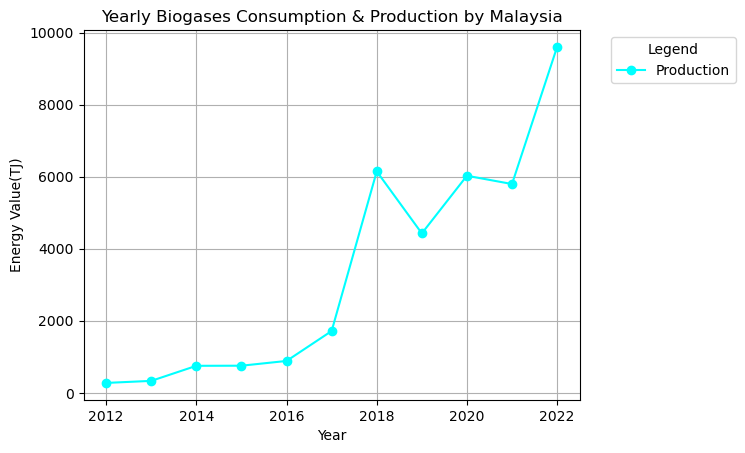

In [567]:
df_biogases_malaysia = df_production[(df_production['Area'] == 'Malaysia') & (df_production['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_biogases_malaysia_c = df_consumption[(df_consumption['Area'] == 'Malaysia') & (df_consumption['Item'] == 'Biogases')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_biogases_malaysia.index, df_biogases_malaysia.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_biogases_malaysia_c.index, df_biogases_malaysia_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Biogases Consumption & Production by Malaysia')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

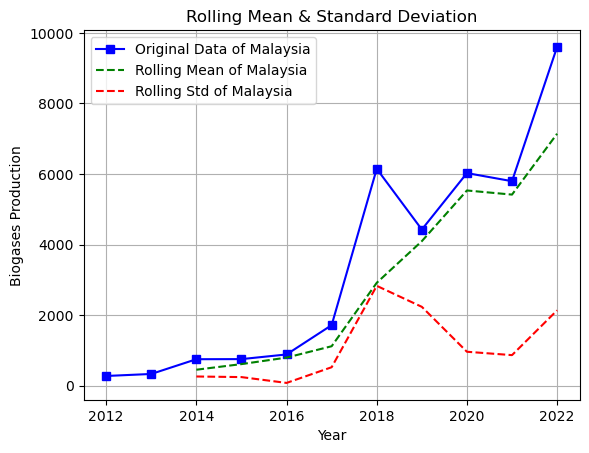

In [568]:
rolling_mean = df_biogases_malaysia.rolling(window=3).mean()
rolling_std = df_biogases_malaysia.rolling(window=3).std()

plt.plot(df_biogases_malaysia, label='Original Data of Malaysia', color='blue', marker='s')
plt.plot(rolling_mean, label='Rolling Mean of Malaysia', color='green', linestyle='--')
plt.plot(rolling_std, label='Rolling Std of Malaysia', color='red', linestyle='--')

plt.xlabel('Year')
plt.ylabel('Biogases Production')
plt.title('Rolling Mean & Standard Deviation')

plt.legend()
plt.grid()
plt.show()

In [569]:
adf_statistic = adfuller(df_biogases_malaysia['Value'])[0]
p_value = adfuller(df_biogases_malaysia['Value'])[1]
critical_points = adfuller(df_biogases_malaysia['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 0.47206623983713425
p-value: 0.9839988819502681
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


In [570]:
df_biogases_malaysia['Differenced Production'] = df_biogases_malaysia['Value'].diff()
adf_statistic = adfuller(df_biogases_malaysia['Differenced Production'].dropna())[0]
p_value = adfuller(df_biogases_malaysia['Differenced Production'].dropna())[1]
critical_points = adfuller(df_biogases_malaysia['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.1443707696784156
p-value: 0.22705103035617935
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


In [571]:
df_biogases_malaysia['Differenced Production 2'] = df_biogases_malaysia['Differenced Production'].diff()
adf_statistic = adfuller(df_biogases_malaysia['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_biogases_malaysia['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_biogases_malaysia['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.3380407696634538
p-value: 0.1599923390196653
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


In [572]:
df_biogases_malaysia['Differenced Production 3'] = df_biogases_malaysia['Differenced Production 2'].diff()
adf_statistic = adfuller(df_biogases_malaysia['Differenced Production 3'].dropna())[0]
p_value = adfuller(df_biogases_malaysia['Differenced Production 3'].dropna())[1]
critical_points = adfuller(df_biogases_malaysia['Differenced Production 3'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -2.0277014201840946
p-value: 0.27456060324429366
critical points: {'1%': -6.045114, '5%': -3.9292800000000003, '10%': -2.98681}


In [573]:
df_biogases_malaysia['Differenced Production 4'] = df_biogases_malaysia['Differenced Production 3'].diff()
adf_statistic = adfuller(df_biogases_malaysia['Differenced Production 4'].dropna())[0]
p_value = adfuller(df_biogases_malaysia['Differenced Production 4'].dropna())[1]
critical_points = adfuller(df_biogases_malaysia['Differenced Production 4'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -7.753710306094705
p-value: 9.864542728422726e-12
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 4 (d=4)

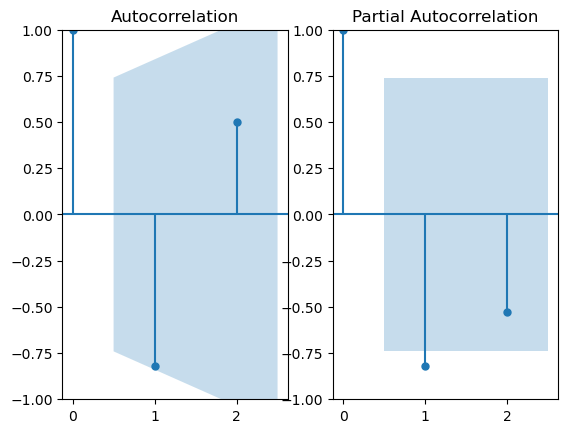

In [574]:
fig, ax = plt.subplots(1,2)
plot_acf(df_biogases_malaysia['Differenced Production 4'].dropna(), ax=ax[0], lags=2)
plot_pacf(df_biogases_malaysia['Differenced Production 4'].dropna(), ax=ax[1], lags=2)
plt.show()

In [575]:
arima_1 = ARIMA(df_biogases_malaysia['Value'], order=(1,4,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_biogases_malaysia['Value'], order=(1,4,2))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 4, 1)   Log Likelihood                 -67.194
Date:                Tue, 25 Mar 2025   AIC                            140.388
Time:                        00:40:07   BIC                            140.226
Sample:                             0   HQIC                           138.382
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8913      0.299     -2.985      0.003      -1.477      -0.306
ma.L1         -1.0000      0.505     -1.980      0.048      -1.990      -0.010
sigma2      1.103e+07   4.58e-08   2.41e+14      0.0

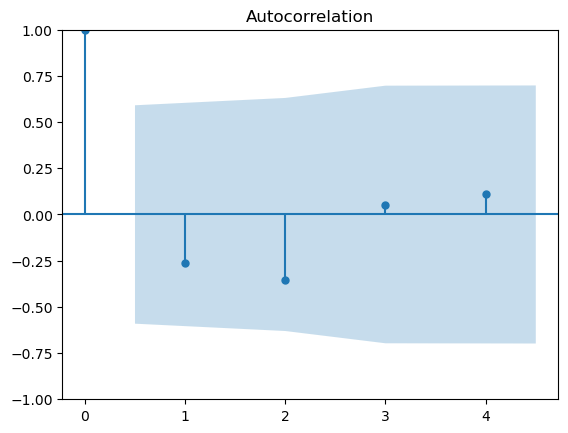

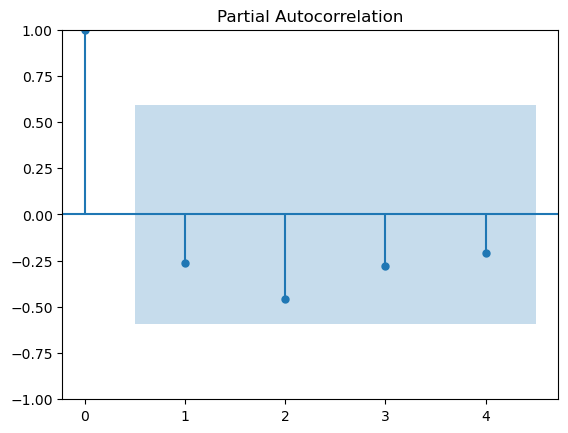

In [576]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


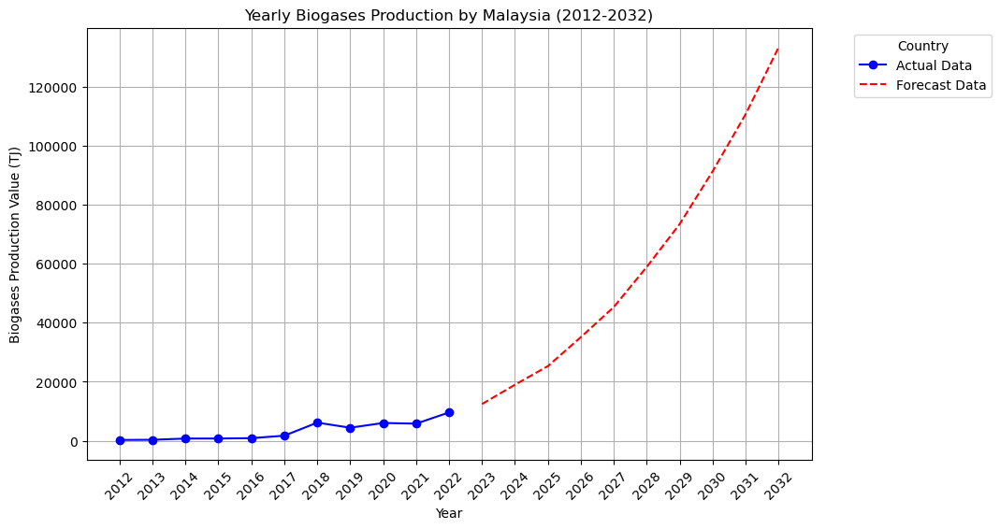

In [577]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_biogases_malaysia.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_biogases_malaysia.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_biogases_malaysia.index ,df_biogases_malaysia['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Biogases Production Value (TJ)')
plt.title('Yearly Biogases Production by Malaysia (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BIOGASES PRODUCTION AND CONSUMPTION IN MAlAYSIA FORECAST

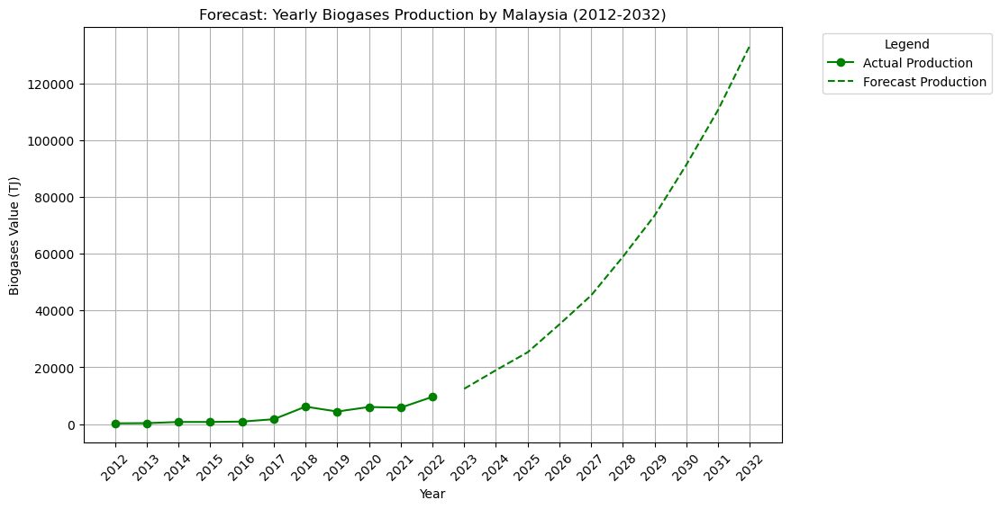

In [578]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_biogases_malaysia.index, df_biogases_malaysia['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Biogases Value (TJ)')
plt.title('Forecast: Yearly Biogases Production by Malaysia (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_biogases_malaysia.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Save the plot
plt.savefig('static/Biogases Forecast/Forecast of Yearly Biogases Production by Malaysia (2012-2032).png', bbox_inches='tight')

# Show the plot
plt.show()

## <B>Yearly Black Liquor Production in Japan</B>

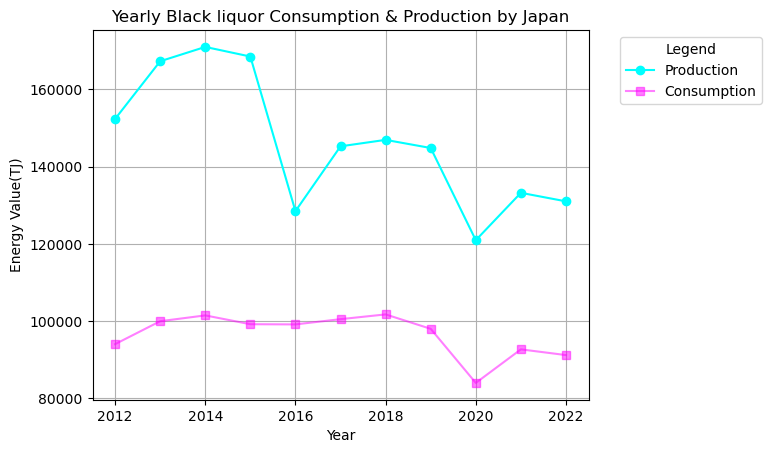

In [579]:
df_black_liquor_japan = df_production[(df_production['Area'] == 'Japan') & (df_production['Item'] == 'Black liquor')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_black_liquor_japan_c = df_consumption[(df_consumption['Area'] == 'Japan') & (df_consumption['Item'] == 'Black liquor')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_black_liquor_japan.index, df_black_liquor_japan.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_black_liquor_japan_c.index, df_black_liquor_japan_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Black liquor Consumption & Production by Japan')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

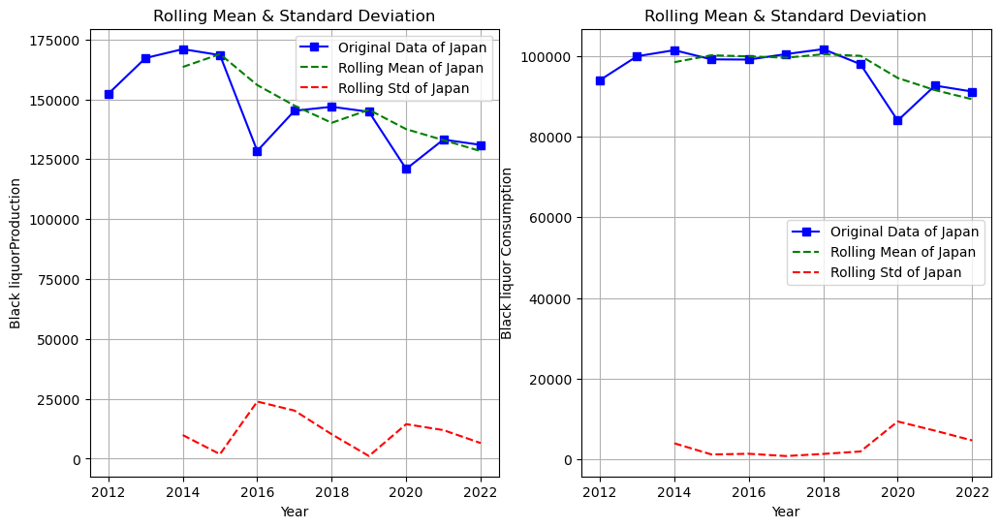

In [580]:
rolling_mean = df_black_liquor_japan.rolling(window=3).mean()
rolling_std = df_black_liquor_japan.rolling(window=3).std()
rolling_mean_c = df_black_liquor_japan_c.rolling(window=3).mean()
rolling_std_c = df_black_liquor_japan_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_black_liquor_japan, label='Original Data of Japan', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Japan', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Japan', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Black liquorProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_black_liquor_japan_c, label='Original Data of Japan', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Japan', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Japan', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Black liquor Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

In [581]:
adf_statistic = adfuller(df_black_liquor_japan['Value'])[0]
p_value = adfuller(df_black_liquor_japan['Value'])[1]
critical_points = adfuller(df_black_liquor_japan['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -6.169637816963156
p-value: 6.854925457605188e-08
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 0 (d=0)

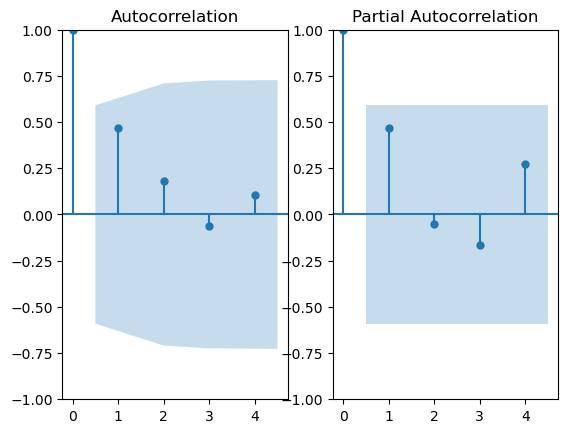

In [582]:
fig, ax = plt.subplots(1,2)
plot_acf(df_black_liquor_japan['Value'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_black_liquor_japan['Value'].dropna(), ax=ax[1], lags=4)
plt.show()

In [583]:
arima_1 = ARIMA(df_black_liquor_japan['Value'], order=(1,0,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_black_liquor_japan['Value'], order=(4,0,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -120.950
Date:                Tue, 25 Mar 2025   AIC                            249.900
Time:                        00:40:11   BIC                            251.492
Sample:                             0   HQIC                           248.897
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.463e+05   1.03e+04     14.164      0.000    1.26e+05    1.67e+05
ar.L1          0.4583      0.777      0.590      0.555      -1.064       1.981
ma.L1          0.0155      1.114      0.014      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

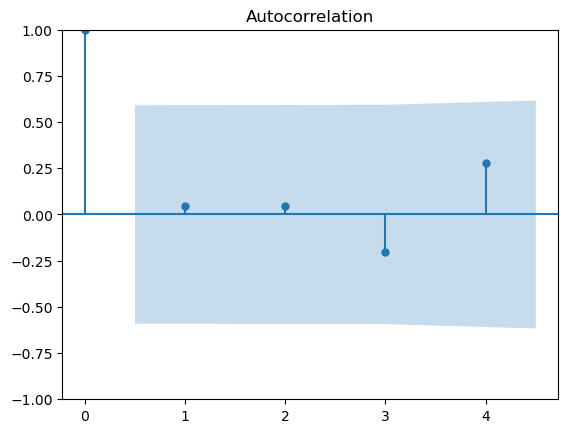

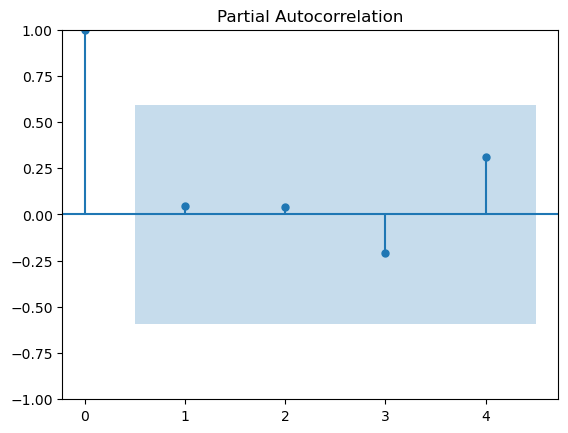

In [584]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


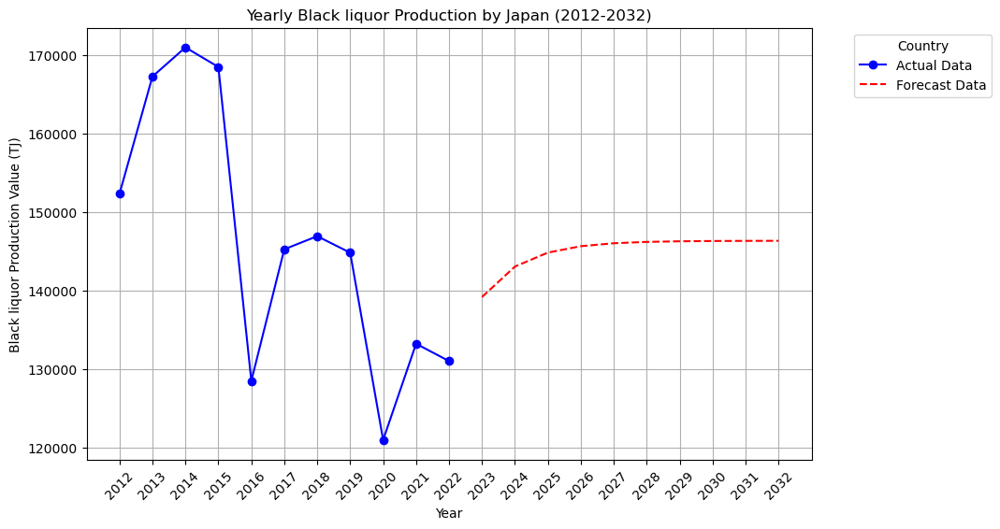

In [585]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_black_liquor_japan.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_black_liquor_japan.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_black_liquor_japan.index ,df_black_liquor_japan['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Black liquor Production Value (TJ)')
plt.title('Yearly Black liquor Production by Japan (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

<B> Augmented Dickey Fuller Test (Statistical Test of Stationarity) for Energy Consumption

In [586]:
adf_statistic = adfuller(df_black_liquor_japan_c['Value'])[0]
p_value = adfuller(df_black_liquor_japan_c['Value'])[1]
critical_points = adfuller(df_black_liquor_japan_c['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.695677482844772
p-value: 0.43334093262571954
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


In [587]:
df_black_liquor_japan_c['Differenced Consumption'] = df_black_liquor_japan_c['Value'].diff()

adf_statistic = adfuller(df_black_liquor_japan_c['Differenced Consumption'].dropna())[0]
p_value = adfuller(df_black_liquor_japan_c['Differenced Consumption'].dropna())[1]
critical_points = adfuller(df_black_liquor_japan_c['Differenced Consumption'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -3.645309681071628
p-value: 0.004951600348386425
critical points: {'1%': -4.473135048010974, '5%': -3.28988060356653, '10%': -2.7723823456790124}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 5% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

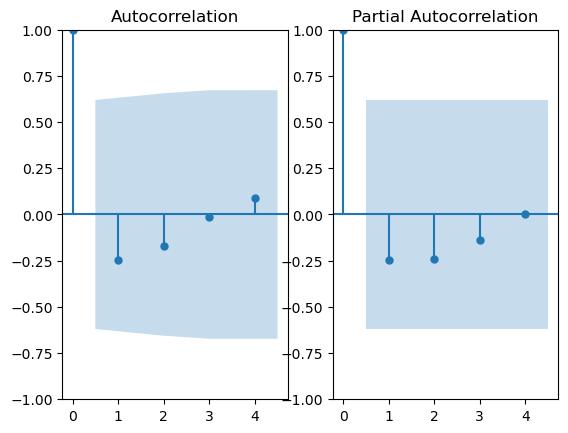

In [588]:
fig, ax = plt.subplots(1,2)
plot_acf(df_black_liquor_japan_c['Differenced Consumption'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_black_liquor_japan_c['Differenced Consumption'].dropna(), ax=ax[1], lags=4)
plt.show()

In [589]:
arima_1 = ARIMA(df_black_liquor_japan_c['Value'], order=(0,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_black_liquor_japan_c['Value'], order=(2,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_black_liquor_japan_c['Value'], order=(1,1,1))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(0, 1, 1)   Log Likelihood                -100.426
Date:                Tue, 25 Mar 2025   AIC                            204.853
Time:                        00:40:13   BIC                            205.458
Sample:                             0   HQIC                           204.189
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.0524      0.176      0.298      0.766      -0.293       0.398
sigma2      3.097e+07   1.09e-10   2.84e+17      0.000     3.1e+07     3.1e+07
Ljung-Box (L1) (Q):                   1.62   Jarque-

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


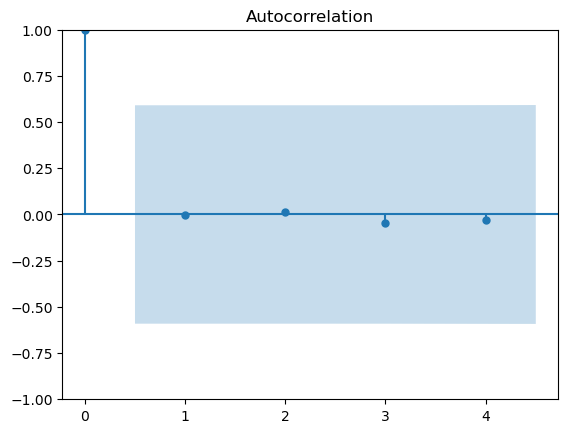

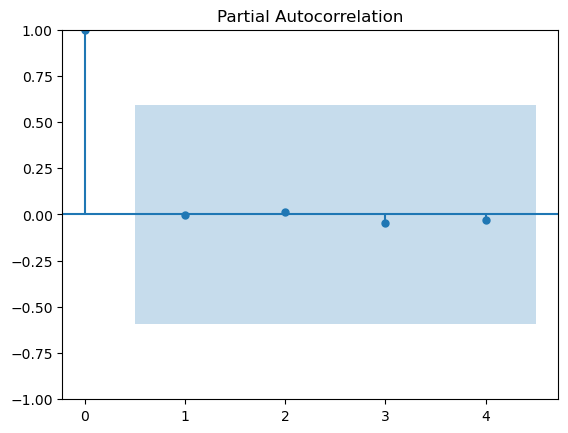

In [590]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


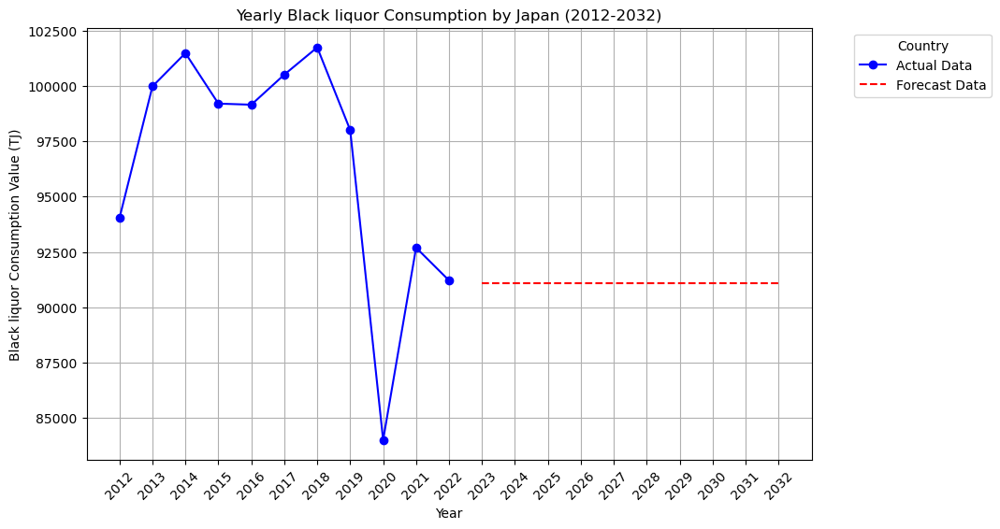

In [591]:
forecast_years = 10
forecast_c = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_black_liquor_japan_c.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_black_liquor_japan_c.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_black_liquor_japan_c.index ,df_black_liquor_japan_c['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_c, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Black liquor Consumption Value (TJ)')
plt.title('Yearly Black liquor Consumption by Japan (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BLACK LIQUOR PRODUCTION AND CONSUMPTION IN JAPAN FORECAST

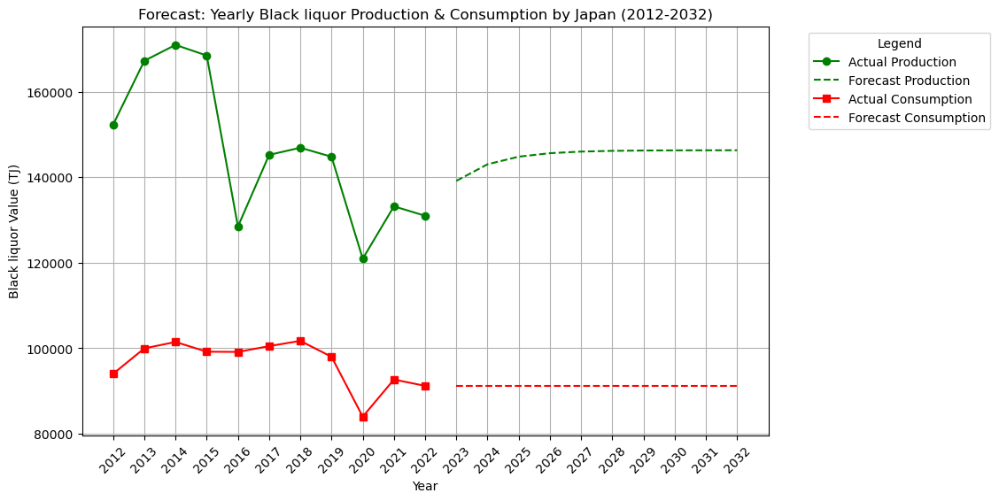

In [592]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_black_liquor_japan.index, df_black_liquor_japan['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_black_liquor_japan_c.index, df_black_liquor_japan_c['Value'], color='red', marker='s', linestyle='-', label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_c, color='red', linestyle='--', label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Black liquor Value (TJ)')
plt.title('Forecast: Yearly Black liquor Production & Consumption by Japan (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_black_liquor_japan.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Black Liquor Forecast/Forecast of Yearly Black liquor Production & Consumption by Japan (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Black Liquor Production in Thailand</B>

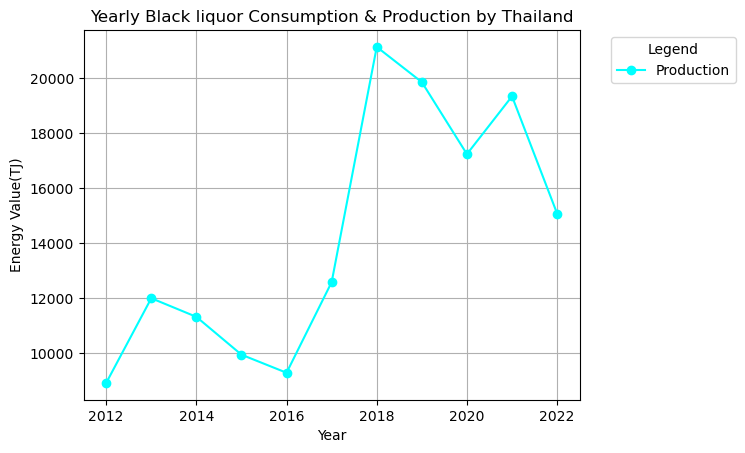

In [593]:
df_black_liquor_thailand = df_production[(df_production['Area'] == 'Thailand') & (df_production['Item'] == 'Black liquor')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_black_liquor_thailand_c = df_consumption[(df_consumption['Area'] == 'Thailand') & (df_consumption['Item'] == 'Black liquor')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_black_liquor_thailand.index, df_black_liquor_thailand.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_black_liquor_thailand_c.index, df_black_liquor_thailand_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Black liquor Consumption & Production by Thailand')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

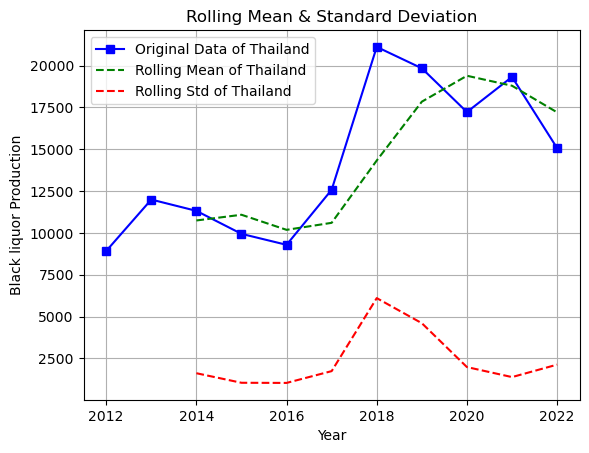

In [594]:
rolling_mean = df_black_liquor_thailand.rolling(window=3).mean()
rolling_std = df_black_liquor_thailand.rolling(window=3).std()

plt.plot(df_black_liquor_thailand, label='Original Data of Thailand', color='blue', marker='s')
plt.plot(rolling_mean, label='Rolling Mean of Thailand', color='green', linestyle='--')
plt.plot(rolling_std, label='Rolling Std of Thailand', color='red', linestyle='--')

plt.xlabel('Year')
plt.ylabel('Black liquor Production')
plt.title('Rolling Mean & Standard Deviation')

plt.legend()
plt.grid()
plt.show()

In [595]:
adf_statistic = adfuller(df_black_liquor_thailand['Value'])[0]
p_value = adfuller(df_black_liquor_thailand['Value'])[1]
critical_points = adfuller(df_black_liquor_thailand['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.5809834537008407
p-value: 0.49313871366363055
critical points: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}


In [596]:
df_black_liquor_thailand['Differenced Production'] = df_black_liquor_thailand['Value'].diff()
adf_statistic = adfuller(df_black_liquor_thailand['Differenced Production'].dropna())[0]
p_value = adfuller(df_black_liquor_thailand['Differenced Production'].dropna())[1]
critical_points = adfuller(df_black_liquor_thailand['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.663109505257657
p-value: 9.282177886384329e-07
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

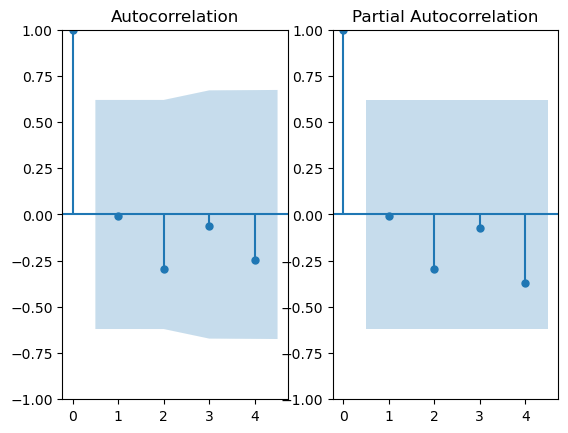

In [597]:
fig, ax = plt.subplots(1,2)
plot_acf(df_black_liquor_thailand['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_black_liquor_thailand['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [598]:
arima_1 = ARIMA(df_black_liquor_thailand['Value'], order=(2,1,4))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_black_liquor_thailand['Value'], order=(4,1,4))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Lik

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 1, 4)   Log Likelihood                 -94.004
Date:                Tue, 25 Mar 2025   AIC                            202.009
Time:                        00:40:17   BIC                            204.127
Sample:                             0   HQIC                           199.685
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3711      4.677     -0.079      0.937      -9.538       8.795
ar.L2         -0.6021      2.245     -0.268      0.789      -5.002       3.797
ma.L1          0.7744      4.387      0.177      0.8

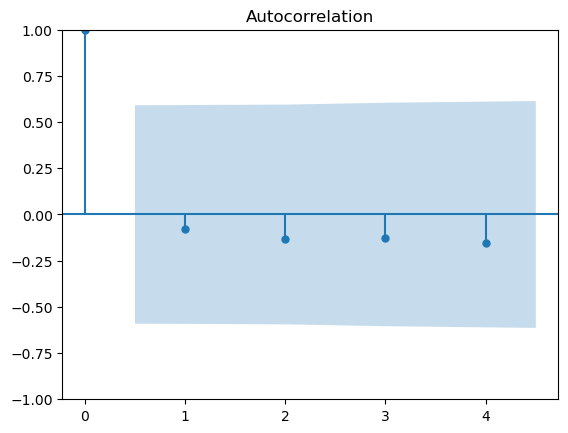

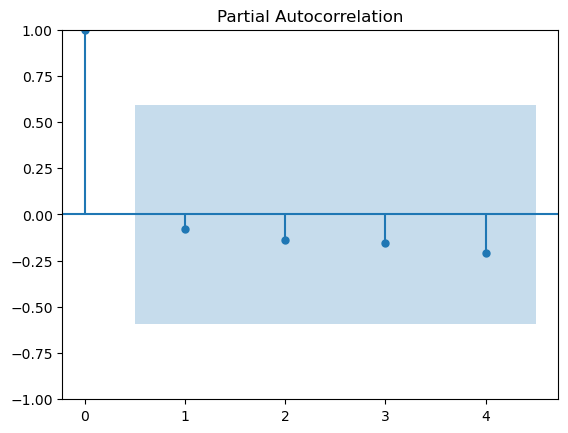

In [599]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


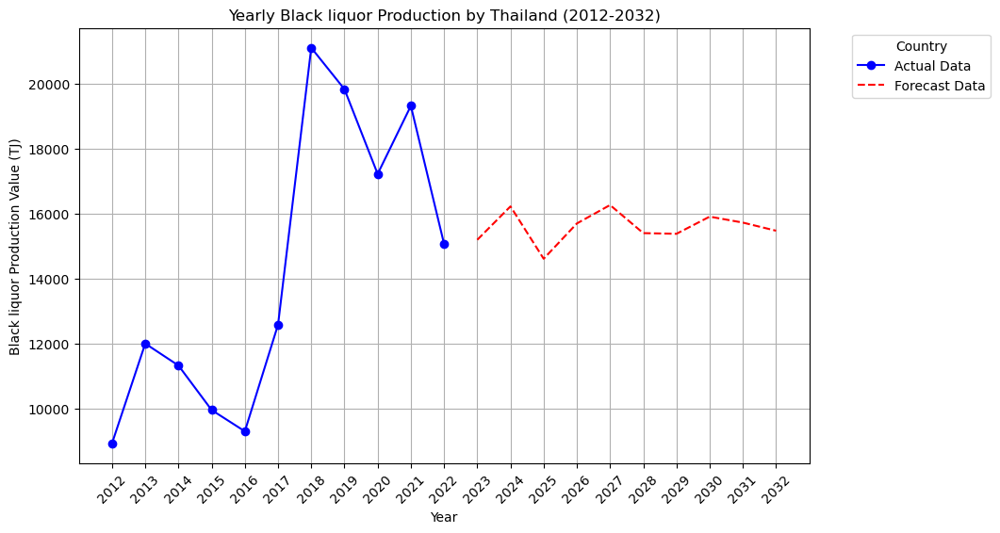

In [600]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_black_liquor_thailand.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_black_liquor_thailand.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_black_liquor_thailand.index ,df_black_liquor_thailand['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Black liquor Production Value (TJ)')
plt.title('Yearly Black liquor Production by Thailand (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BLACK LIQUOR PRODUCTION AND CONSUMPTION IN THAILAND FORECAST

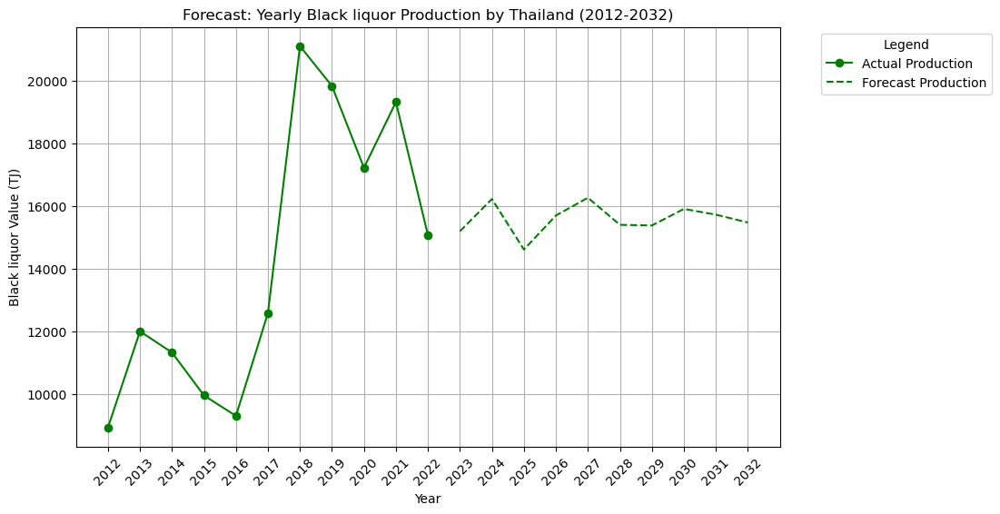

In [601]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_black_liquor_thailand.index, df_black_liquor_thailand['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Black liquor Value (TJ)')
plt.title('Forecast: Yearly Black liquor Production by Thailand (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_black_liquor_thailand.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Save the plot
plt.savefig('static/Black Liquor Forecast/Forecast of Yearly Black liquor Production by Thailand (2012-2032).png', bbox_inches='tight')

# Show the plot
plt.show()

## <B>Yearly Black Liquor Production in Korea</B>

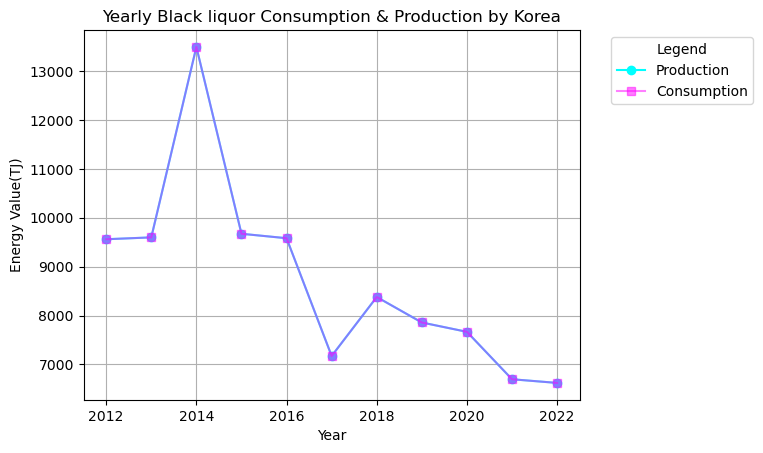

In [602]:
df_black_liquor_korea = df_production[(df_production['Area'] == 'Korea') & (df_production['Item'] == 'Black liquor')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_black_liquor_korea_c = df_consumption[(df_consumption['Area'] == 'Korea') & (df_consumption['Item'] == 'Black liquor')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_black_liquor_korea.index, df_black_liquor_korea.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_black_liquor_korea_c.index, df_black_liquor_korea_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Black liquor Consumption & Production by Korea')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

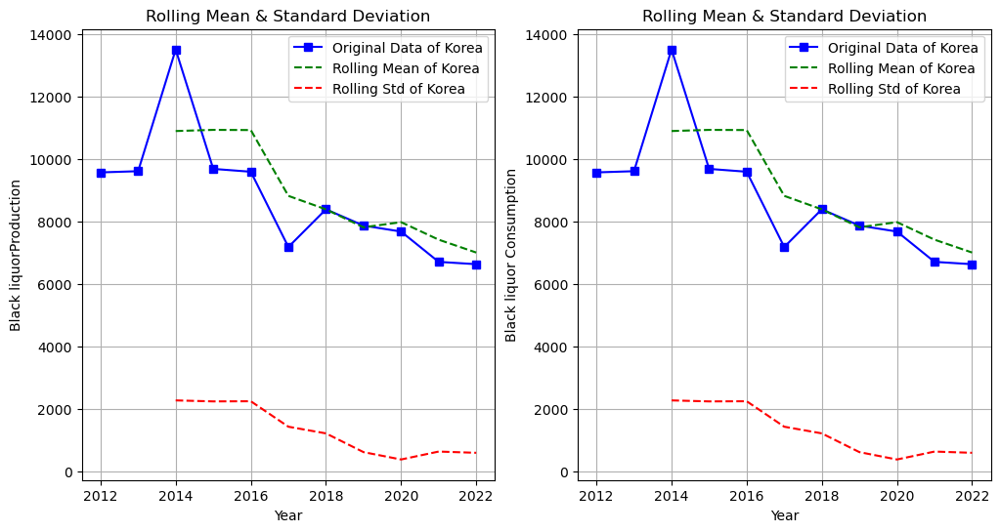

In [603]:
rolling_mean = df_black_liquor_korea.rolling(window=3).mean()
rolling_std = df_black_liquor_korea.rolling(window=3).std()
rolling_mean_c = df_black_liquor_korea_c.rolling(window=3).mean()
rolling_std_c = df_black_liquor_korea_c.rolling(window=3).std()

fig, ax = plt.subplots(1,2, figsize=(12,6))

ax[0].plot(df_black_liquor_korea, label='Original Data of Korea', color='blue', marker='s')
ax[0].plot(rolling_mean, label='Rolling Mean of Korea', color='green', ls='--')
ax[0].plot(rolling_std, label='Rolling Std of Korea', color='red', ls='--')
ax[0].set_xlabel('Year')
ax[0].set_ylabel('Black liquorProduction')
ax[0].set_title('Rolling Mean & Standard Deviation')
ax[0].legend()
ax[0].grid()

ax[1].plot(df_black_liquor_korea_c, label='Original Data of Korea', color='blue', marker='s')
ax[1].plot(rolling_mean_c, label='Rolling Mean of Korea', color='green', ls='--')
ax[1].plot(rolling_std_c, label='Rolling Std of Korea', color='red', ls='--')
ax[1].set_xlabel('Year')
ax[1].set_ylabel('Black liquor Consumption')
ax[1].set_title('Rolling Mean & Standard Deviation')
ax[1].legend()
ax[1].grid()
plt.show()

In [604]:
adf_statistic = adfuller(df_black_liquor_korea['Value'])[0]
p_value = adfuller(df_black_liquor_korea['Value'])[1]
critical_points = adfuller(df_black_liquor_korea['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -0.6199804480137254
p-value: 0.8664030501644913
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


In [605]:
df_black_liquor_korea['Differenced Production'] = df_black_liquor_korea['Value'].diff()
adf_statistic = adfuller(df_black_liquor_korea['Differenced Production'].dropna())[0]
p_value = adfuller(df_black_liquor_korea['Differenced Production'].dropna())[1]
critical_points = adfuller(df_black_liquor_korea['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -5.347755247963149
p-value: 4.356944224130375e-06
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

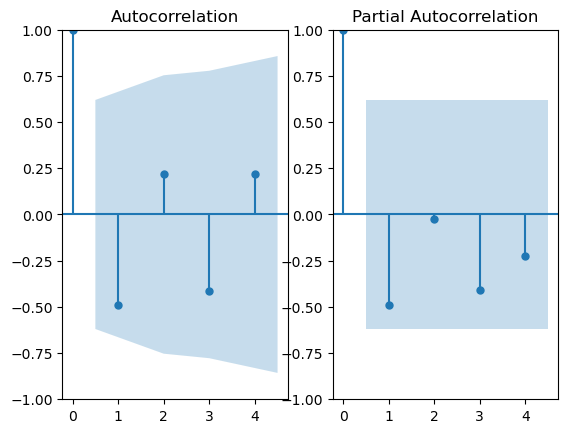

In [606]:
fig, ax = plt.subplots(1,2)
plot_acf(df_black_liquor_korea['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_black_liquor_korea['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [607]:
arima_1 = ARIMA(df_black_liquor_korea['Value'], order=(1,1,1))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_black_liquor_korea['Value'], order=(3,1,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

arima_3 = ARIMA(df_black_liquor_korea['Value'], order=(3,1,3))
arima_3_fit = arima_3.fit()
print(arima_3_fit.summary())

arima_4 = ARIMA(df_black_liquor_korea['Value'], order=(1,1,3))
arima_4_fit = arima_4.fit()
print(arima_4_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dat

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 -87.342
Date:                Tue, 25 Mar 2025   AIC                            180.683
Time:                        00:40:21   BIC                            181.591
Sample:                             0   HQIC                           179.687
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8996      0.250     -3.594      0.000      -1.390      -0.409
ma.L1          0.7413      0.426      1.741      0.082      -0.093       1.576
sigma2      2.289e+06   3.85e-08   5.95e+13      0.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 3)   Log Likelihood                 -80.106
Date:                Tue, 25 Mar 2025   AIC                            174.211
Time:                        00:40:22   BIC                            176.329
Sample:                             0   HQIC                           171.888
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2727      0.473      0.576      0.564      -0.655       1.200
ar.L2          0.3939      0.312      1.264      0.206      -0.217       1.005
ar.L3         -0.4087      0.274     -1.493      0.1

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


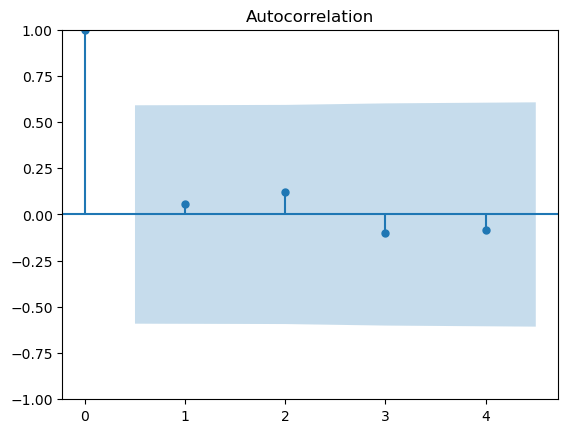

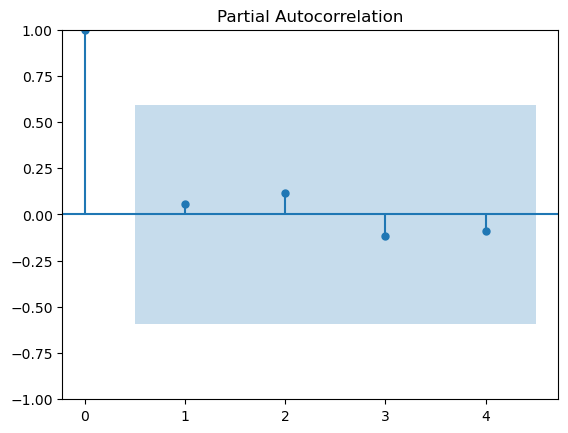

In [608]:
residuals = arima_3_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


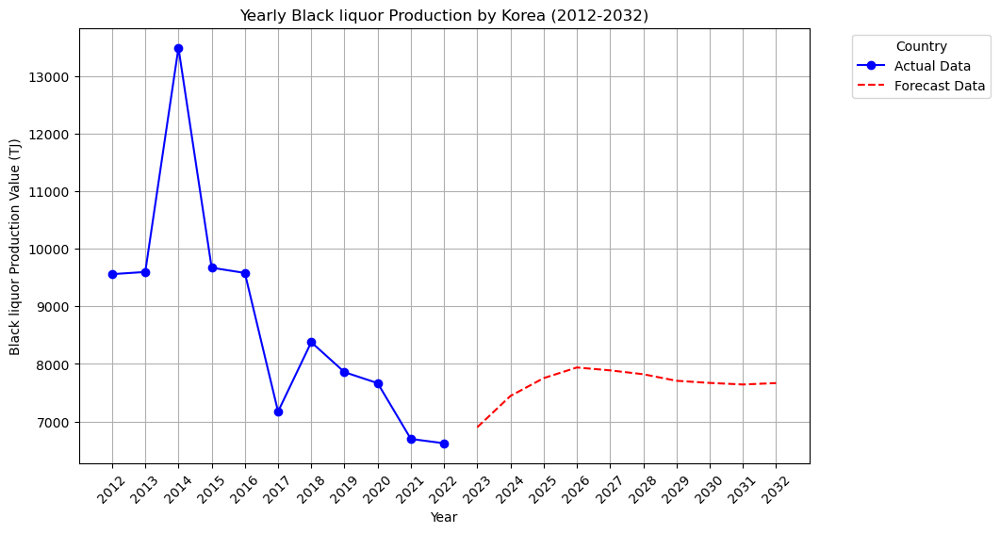

In [609]:
forecast_years = 10
forecast_p = arima_3_fit.forecast(steps=forecast_years)

last_year = int(df_black_liquor_korea.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_black_liquor_korea.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_black_liquor_korea.index ,df_black_liquor_korea['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Black liquor Production Value (TJ)')
plt.title('Yearly Black liquor Production by Korea (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER BLACK LIQUOR PRODUCTION AND CONSUMPTION IN KOREA FORECAST

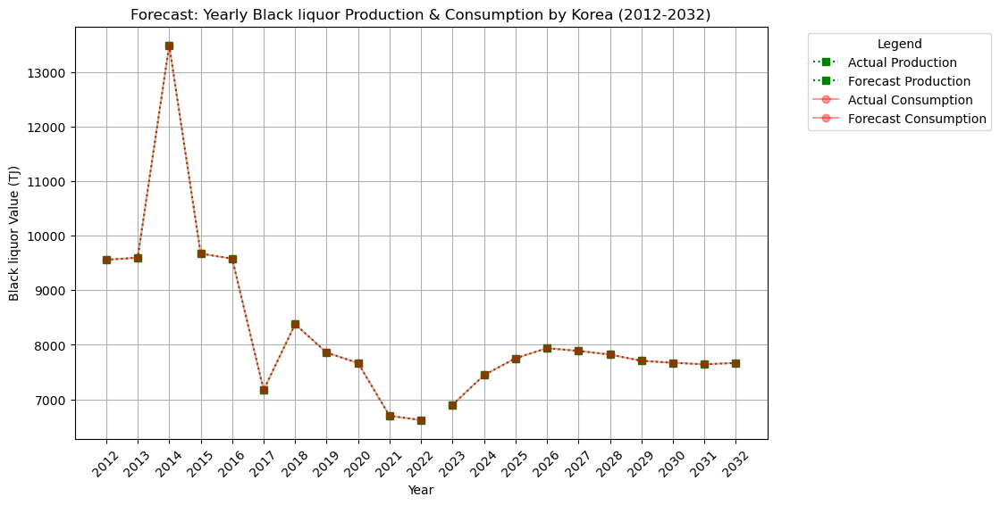

In [610]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_black_liquor_korea.index, df_black_liquor_korea['Value'], color='green',ls='dotted', marker='s', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green',ls='dotted', marker='s', label='Forecast Production')

# Plot actual consumption data
plt.plot(df_black_liquor_korea.index, df_black_liquor_korea['Value'], color='red', marker='o', alpha=0.4, label='Actual Consumption')

# Plot forecasted consumption data
plt.plot(forecast_index, forecast_p, color='red', marker='o', alpha=0.4, label='Forecast Consumption')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Black liquor Value (TJ)')
plt.title('Forecast: Yearly Black liquor Production & Consumption by Korea (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_black_liquor_korea.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)

plt.savefig('static/Black Liquor Forecast/Forecast of Yearly Black liquor Production & Consumption by Korea (2012-2032).png', bbox_inches='tight')
plt.show()

## <B>Yearly Other liquid biofuels Production in Korea</B>

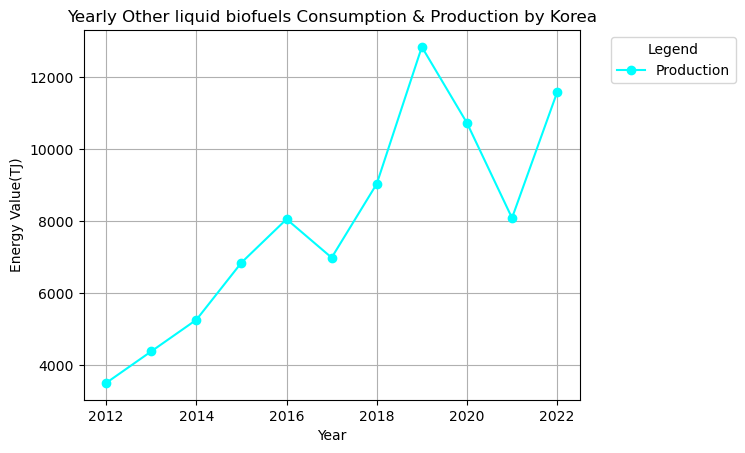

In [611]:
df_olb_korea = df_production[(df_production['Area'] == 'Korea') & (df_production['Item'] == 'Other liquid biofuels')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_olb_korea_c = df_consumption[(df_consumption['Area'] == 'Korea') & (df_consumption['Item'] == 'Other liquid biofuels')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_olb_korea.index, df_olb_korea.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_olb_korea_c.index, df_olb_korea_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Other liquid biofuels Consumption & Production by Korea')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

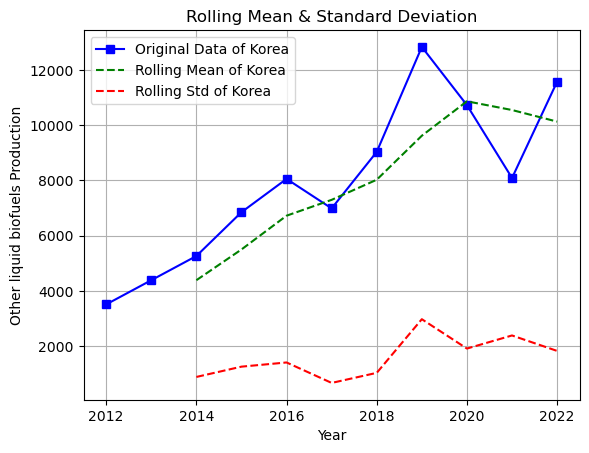

In [612]:
rolling_mean = df_olb_korea.rolling(window=3).mean()
rolling_std = df_olb_korea.rolling(window=3).std()

plt.plot(df_olb_korea, label='Original Data of Korea', color='blue', marker='s')
plt.plot(rolling_mean, label='Rolling Mean of Korea', color='green', linestyle='--')
plt.plot(rolling_std, label='Rolling Std of Korea', color='red', linestyle='--')

plt.xlabel('Year')
plt.ylabel('Other liquid biofuels Production')
plt.title('Rolling Mean & Standard Deviation')

plt.legend()
plt.grid()
plt.show()

In [613]:
adf_statistic = adfuller(df_olb_korea['Value'])[0]
p_value = adfuller(df_olb_korea['Value'])[1]
critical_points = adfuller(df_olb_korea['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.5824823879443326
p-value: 0.4923869358895848
critical points: {'1%': -4.6651863281249994, '5%': -3.3671868750000002, '10%': -2.802960625}


In [614]:
df_olb_korea['Differenced Production'] = df_olb_korea['Value'].diff()
adf_statistic = adfuller(df_olb_korea['Differenced Production'].dropna())[0]
p_value = adfuller(df_olb_korea['Differenced Production'].dropna())[1]
critical_points = adfuller(df_olb_korea['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -1.727810367357156
p-value: 0.4168436867429644
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


In [615]:
df_olb_korea['Differenced Production 2'] = df_olb_korea['Differenced Production'].diff()
adf_statistic = adfuller(df_olb_korea['Differenced Production 2'].dropna())[0]
p_value = adfuller(df_olb_korea['Differenced Production 2'].dropna())[1]
critical_points = adfuller(df_olb_korea['Differenced Production 2'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -8.677246708704457
p-value: 4.382346120424697e-14
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 2 (d=2)

<B>ACF and PACF PLOTS</B>

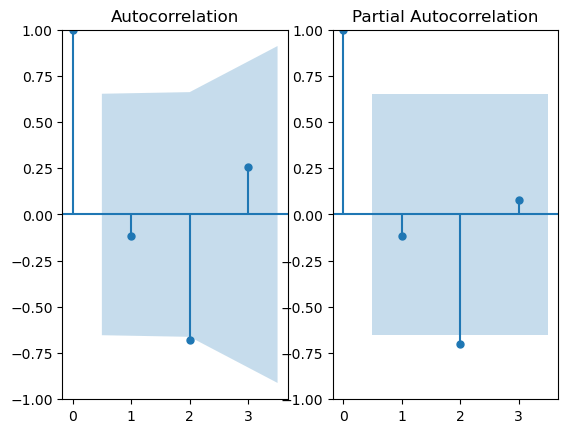

In [616]:
fig, ax = plt.subplots(1,2)
plot_acf(df_olb_korea['Differenced Production 2'].dropna(), ax=ax[0], lags=3)
plot_pacf(df_olb_korea['Differenced Production 2'].dropna(), ax=ax[1], lags=3)
plt.show()

In [617]:
arima_1 = ARIMA(df_olb_korea['Value'], order=(2,2,2))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

arima_2 = ARIMA(df_olb_korea['Value'], order=(2,2,1))
arima_2_fit = arima_2.fit()
print(arima_2_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using

                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(2, 2, 2)   Log Likelihood                -149.994
Date:                Tue, 25 Mar 2025   AIC                            309.989
Time:                        00:40:25   BIC                            310.975
Sample:                             0   HQIC                           307.861
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3394      0.013    -26.211      0.000      -0.365      -0.314
ar.L2         -0.9963      0.009   -110.604      0.000      -1.014      -0.979
ma.L1          0.0014     13.986   9.67e-05      1.0

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as star

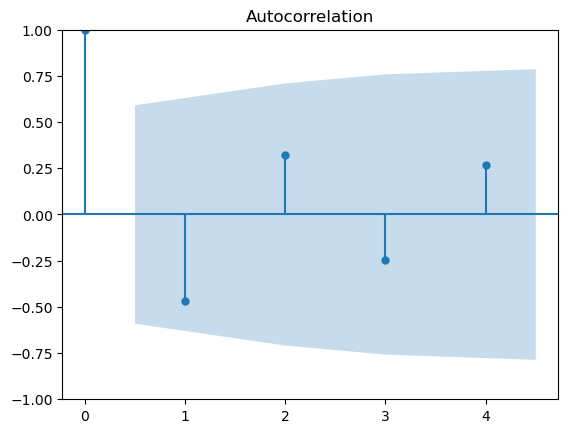

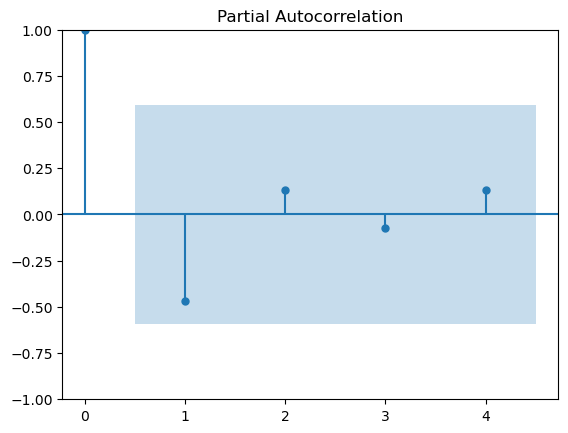

In [618]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


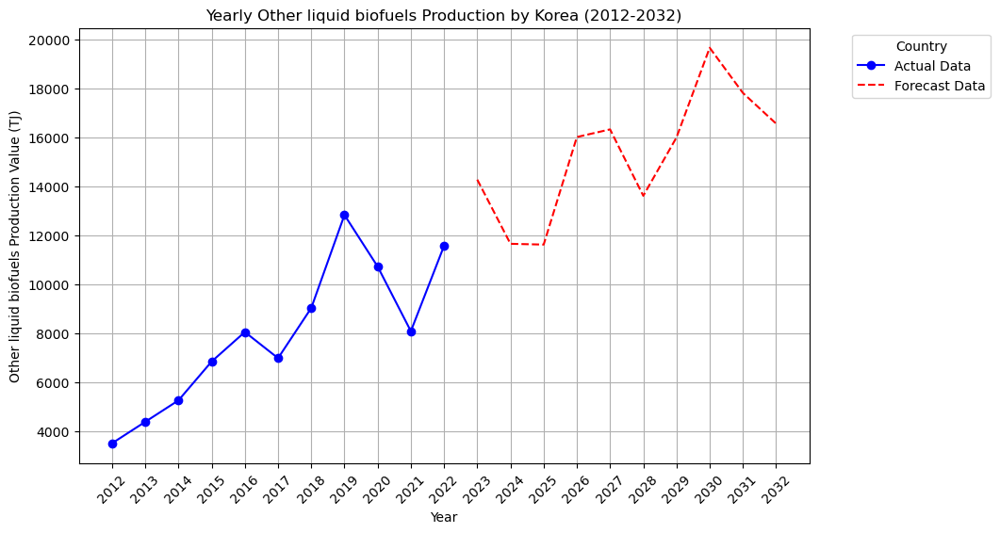

In [619]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_olb_korea.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_olb_korea.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_olb_korea.index ,df_olb_korea['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other liquid biofuels Production Value (TJ)')
plt.title('Yearly Other liquid biofuels Production by Korea (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

# YEARLY OTHER OTHER LIQUID BIOFUELS PRODUCTION AND CONSUMPTION IN KOREA FORECAST

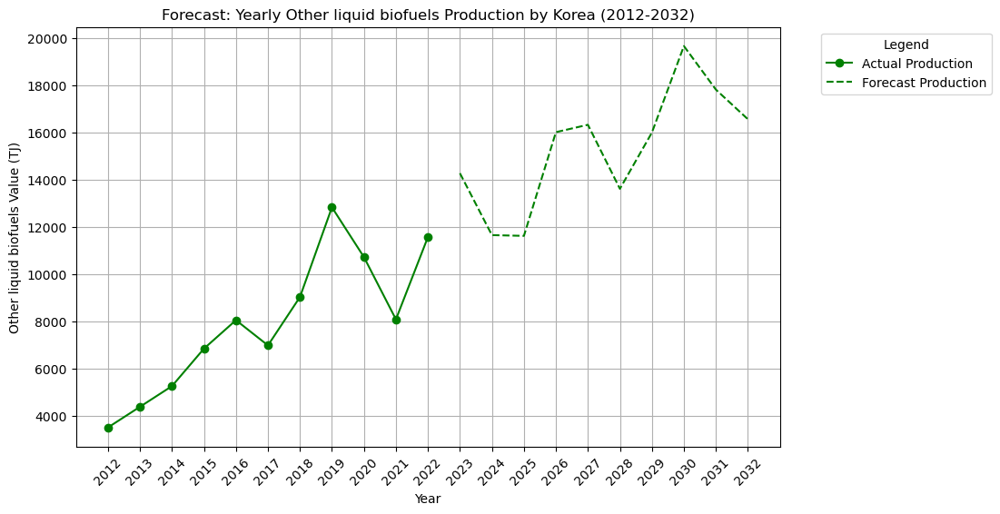

In [620]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_olb_korea.index, df_olb_korea['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Other liquid biofuels Value (TJ)')
plt.title('Forecast: Yearly Other liquid biofuels Production by Korea (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_olb_korea.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Save the plot
plt.savefig('static/Other Liquid Biofuels Forecast/Forecast of Yearly Other liquid biofuels Production by Korea (2012-2032).png', bbox_inches='tight')

# Show the plot
plt.show()

## <B>Yearly Other liquid biofuels Production in Turkiye</B>

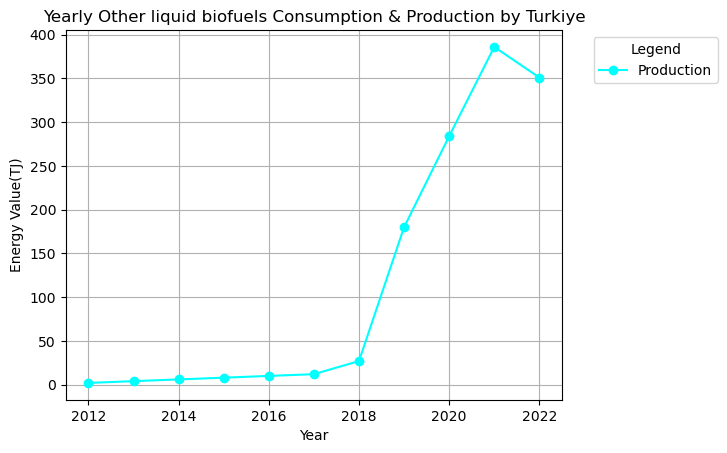

In [621]:
df_olb_turkiye = df_production[(df_production['Area'] == 'Turkiye') & (df_production['Item'] == 'Other liquid biofuels')].pivot_table(values='Value', index='Year', aggfunc='sum')

df_olb_turkiye_c = df_consumption[(df_consumption['Area'] == 'Turkiye') & (df_consumption['Item'] == 'Other liquid biofuels')].pivot_table(values='Value', index='Year', aggfunc='sum')

plt.plot(df_olb_turkiye.index, df_olb_turkiye.values, marker='o', linestyle='-', label='Production', color='cyan')
plt.plot(df_olb_turkiye_c.index, df_olb_turkiye_c.values, marker='s', linestyle='-', label='Consumption', color='magenta', alpha=0.5)

plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Other liquid biofuels Consumption & Production by Turkiye')
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

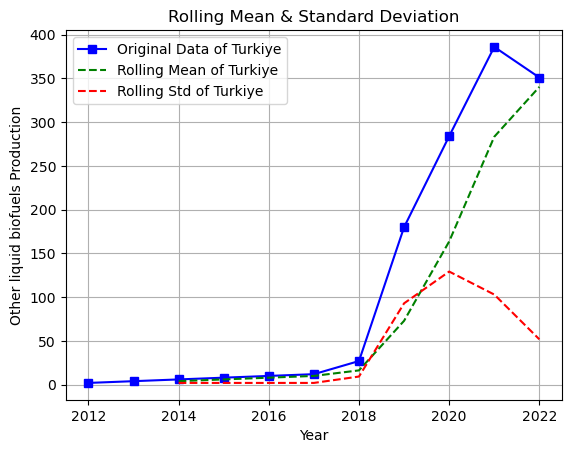

In [622]:
rolling_mean = df_olb_turkiye.rolling(window=3).mean()
rolling_std = df_olb_turkiye.rolling(window=3).std()

plt.plot(df_olb_turkiye, label='Original Data of Turkiye', color='blue', marker='s')
plt.plot(rolling_mean, label='Rolling Mean of Turkiye', color='green', linestyle='--')
plt.plot(rolling_std, label='Rolling Std of Turkiye', color='red', linestyle='--')

plt.xlabel('Year')
plt.ylabel('Other liquid biofuels Production')
plt.title('Rolling Mean & Standard Deviation')

plt.legend()
plt.grid()
plt.show()

In [623]:
adf_statistic = adfuller(df_olb_turkiye['Value'])[0]
p_value = adfuller(df_olb_turkiye['Value'])[1]
critical_points = adfuller(df_olb_turkiye['Value'])[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: 1.7926884722461676
p-value: 0.9983344050302791
critical points: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}


In [624]:
df_olb_turkiye['Differenced Production'] = df_olb_turkiye['Value'].diff()
adf_statistic = adfuller(df_olb_turkiye['Differenced Production'].dropna())[0]
p_value = adfuller(df_olb_turkiye['Differenced Production'].dropna())[1]
critical_points = adfuller(df_olb_turkiye['Differenced Production'].dropna())[4]
print('adf_statistic:', adf_statistic)
print('p-value:', p_value)
print('critical points:', critical_points)

adf_statistic: -12.435192216005241
p-value: 3.8611469750174713e-23
critical points: {'1%': -5.354256481481482, '5%': -3.6462381481481483, '10%': -2.901197777777778}


* p-value is << 0.05...hence the data is <B>STATIONARY</B>
* ADF statistic is less then 1% critical point hence <B>STATIONARITY is CONFIRMED</B>
* Differential parameter is 1 (d=1)

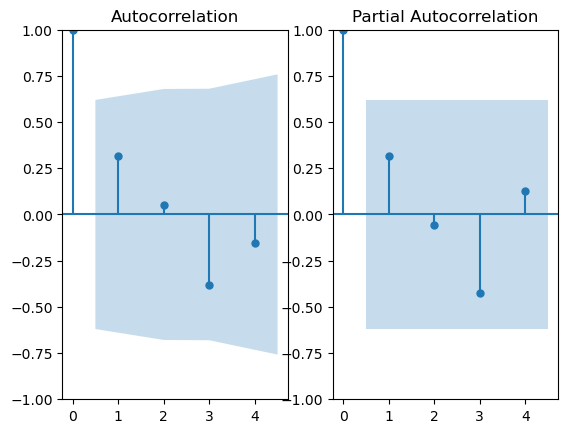

In [625]:
fig, ax = plt.subplots(1,2)
plot_acf(df_olb_turkiye['Differenced Production'].dropna(), ax=ax[0], lags=4)
plot_pacf(df_olb_turkiye['Differenced Production'].dropna(), ax=ax[1], lags=4)
plt.show()

In [626]:
arima_1 = ARIMA(df_olb_turkiye['Value'], order=(3,1,3))
arima_1_fit = arima_1.fit()
print(arima_1_fit.summary())

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Value   No. Observations:                   11
Model:                 ARIMA(3, 1, 3)   Log Likelihood                 -53.165
Date:                Tue, 25 Mar 2025   AIC                            120.329
Time:                        00:40:29   BIC                            122.447
Sample:                             0   HQIC                           118.006
                                 - 11                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1262    138.737      0.001      0.999    -271.794     272.047
ar.L2          0.0431     31.916      0.001      0.999     -62.511      62.598
ar.L3         -0.0430      8.091     -0.005      0.9

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


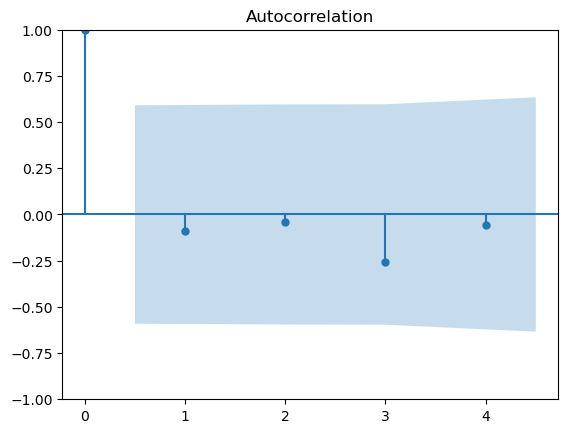

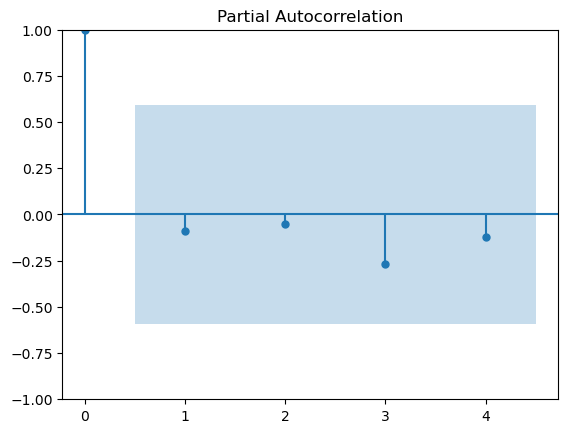

In [627]:
residuals = arima_1_fit.resid
sm.graphics.tsa.plot_acf(residuals, lags=4)
sm.graphics.tsa.plot_pacf(residuals, lags=4)
plt.show()

C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
C:\Users\HP\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


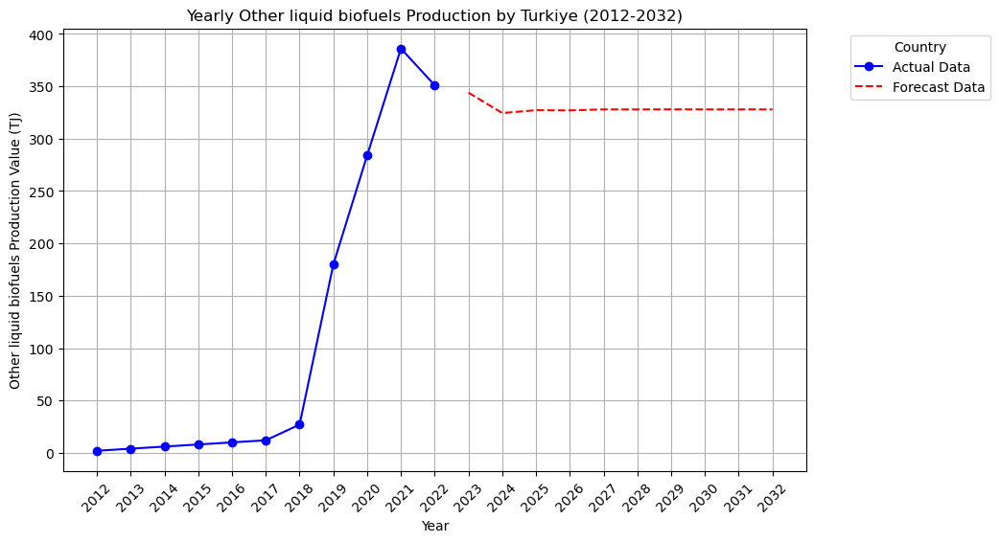

In [628]:
forecast_years = 10
forecast_p = arima_1_fit.forecast(steps=forecast_years)

last_year = int(df_olb_turkiye.index[-1])
forecast_index = [last_year + i for i in range(1, forecast_years + 1)]
all_years = list(df_olb_turkiye.index) + forecast_index

plt.figure(figsize=(10, 6))
plt.plot(df_olb_turkiye.index ,df_olb_turkiye['Value'], color='blue', marker='o', label='Actual Data')
plt.plot(forecast_index, forecast_p, color='red',ls='--', label = 'Forecast Data')
plt.xlabel('Year')
plt.ylabel('Other liquid biofuels Production Value (TJ)')
plt.title('Yearly Other liquid biofuels Production by Turkiye (2012-2032)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(all_years, rotation=45)
plt.grid(True)
plt.show()

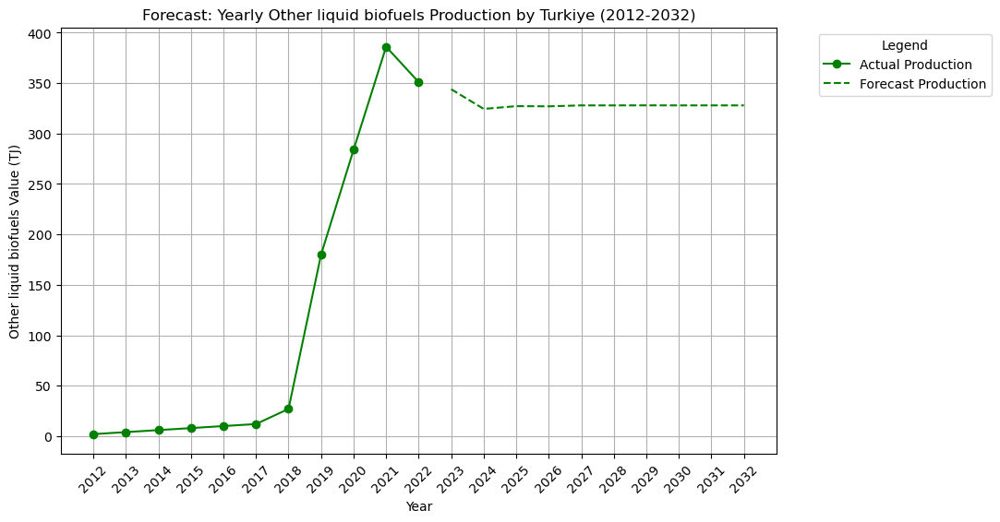

In [629]:
plt.figure(figsize=(10, 6))

# Plot actual production data
plt.plot(df_olb_turkiye.index, df_olb_turkiye['Value'], color='green', marker='o', linestyle='-', label='Actual Production')

# Plot forecasted production data
plt.plot(forecast_index, forecast_p, color='green', linestyle='--', label='Forecast Production')

# Labels and Title
plt.xlabel('Year')
plt.ylabel('Other liquid biofuels Value (TJ)')
plt.title('Forecast: Yearly Other liquid biofuels Production by Turkiye (2012-2032)')

# Ensure x-axis values are displayed as integers
all_years = list(df_olb_turkiye.index) + forecast_index
plt.xticks(ticks=all_years, labels=[int(year) for year in all_years], rotation=45)

# Legend & Grid
plt.legend(title='Legend', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Save the plot
plt.savefig('static/Other Liquid Biofuels Forecast/Forecast of Yearly Other liquid biofuels Production by Turkiye (2012-2032).png', bbox_inches='tight')

# Show the plot
plt.show()

# ************************************************************************************

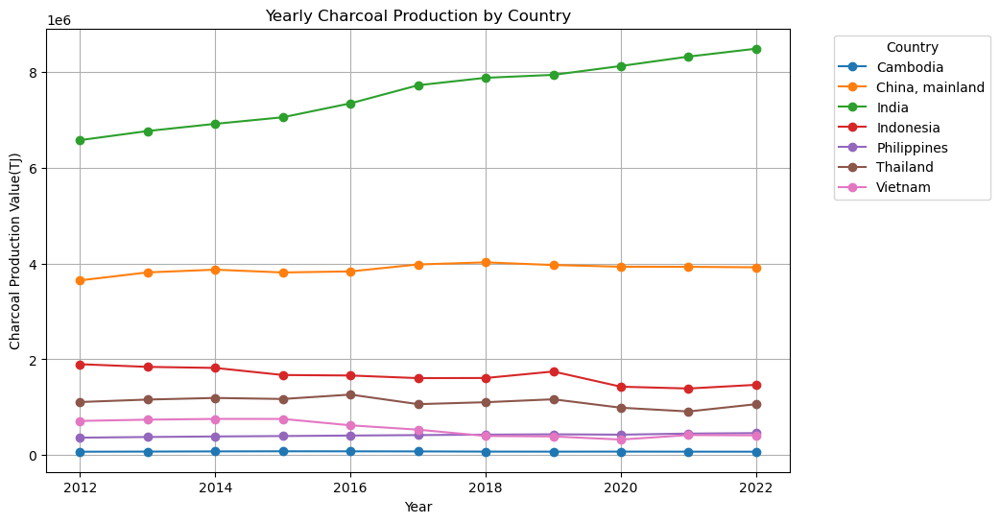

In [630]:
charcoal_areas = ['India', 'Thailand', 'Philippines', 'China, mainland', 'Indonesia', 'Vietnam', 'Cambodia']
df_charcoal_area = df_production[df_production['Area'].isin(charcoal_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_charcoal_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Charcoal Production Value(TJ)')
plt.title('Yearly Charcoal Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Charcoal Production by Country.png', bbox_inches='tight')
plt.show()

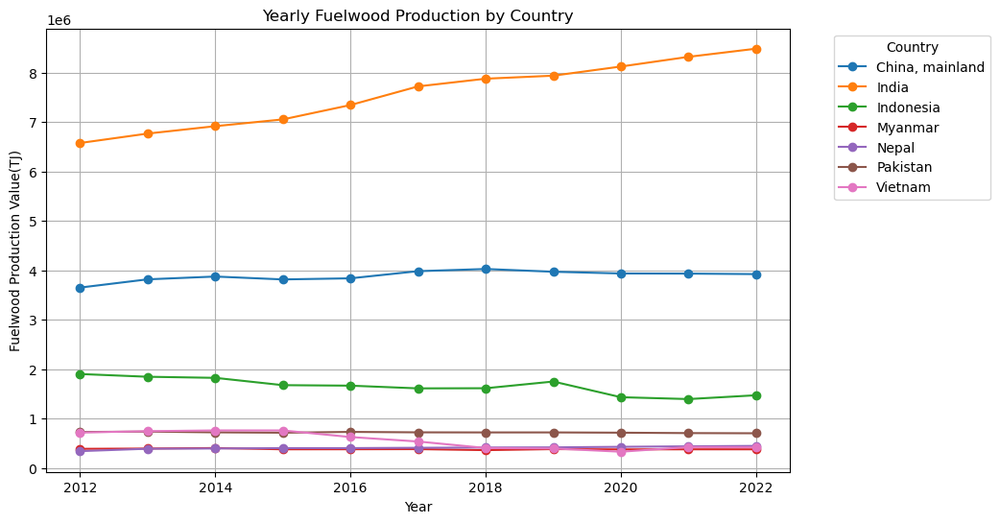

In [631]:
fuelwood_areas = ['India', 'China, mainland', 'Indonesia', 'Vietnam', 'Nepal', 'Myanmar', 'Pakistan']

df_fuelwood_area = df_production[df_production['Area'].isin(fuelwood_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_fuelwood_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Fuelwood Production Value(TJ)')
plt.title('Yearly Fuelwood Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Fuelwood Production by Country.png', bbox_inches='tight')
plt.show()

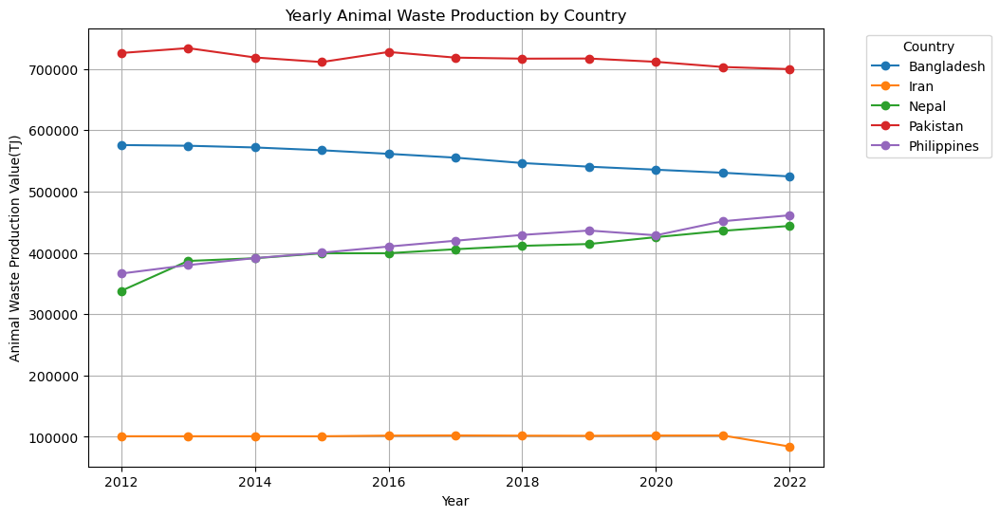

In [632]:
animal_waste_areas = ['Bangladesh', 'Nepal', 'Pakistan', 'Iran', 'Philippines']

df_animal_waste_area = df_production[df_production['Area'].isin(animal_waste_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_animal_waste_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Animal Waste Production Value(TJ)')
plt.title('Yearly Animal Waste Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Animal Waste Production by Country.png', bbox_inches='tight')
plt.show()

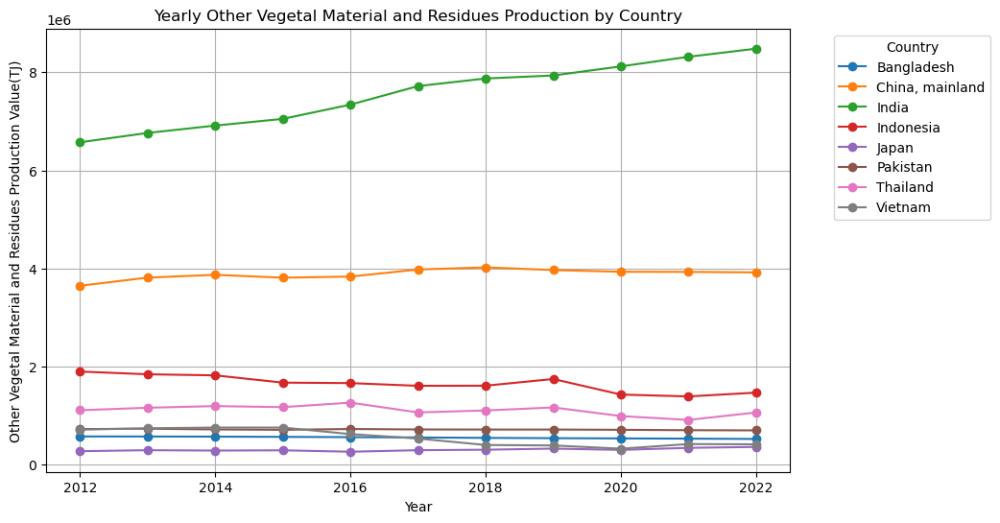

In [633]:
vegetal_areas = ['China, mainland', 'India', 'Indonesia', 'Thailand', 'Pakistan', 'Bangladesh', 'Vietnam', 'Japan']

df_vegetal_area = df_production[df_production['Area'].isin(vegetal_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_vegetal_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Other Vegetal Material and Residues Production Value(TJ)')
plt.title('Yearly Other Vegetal Material and Residues Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Other Vegetal Material and Residues Production by Country.png', bbox_inches='tight')
plt.show()

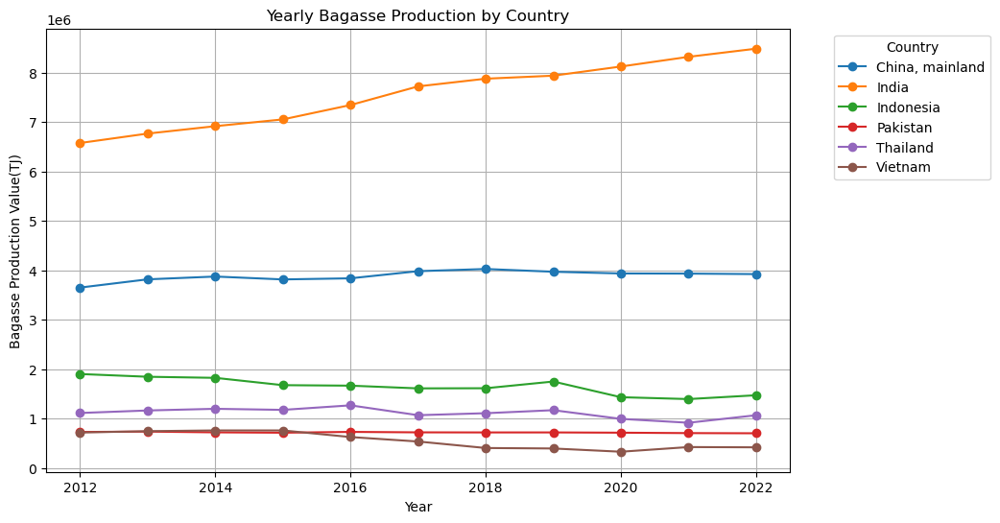

In [634]:
bagasse_areas = ['India', 'China, mainland', 'Thailand', 'Pakistan', 'Indonesia', 'Vietnam']

df_bagasse_area = df_production[df_production['Area'].isin(bagasse_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_bagasse_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Bagasse Production Value(TJ)')
plt.title('Yearly Bagasse Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Bagasse Production by Country.png', bbox_inches='tight')
plt.show()

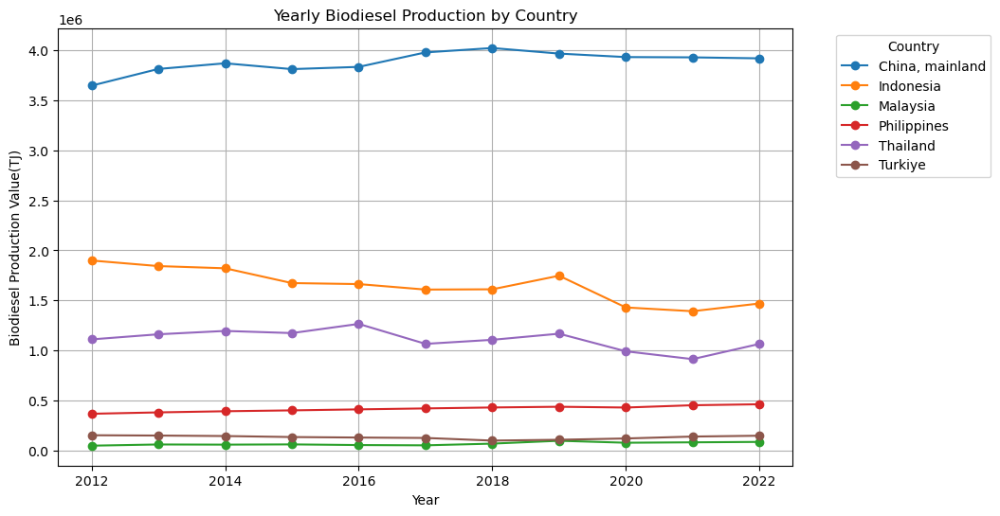

In [635]:
biodiesel_areas = ['China, mainland', 'Indonesia', 'Thailand', 'Malaysia', 'Republic of Korea', 'Philippines', 'Turkiye']

df_biodiesel_area = df_production[df_production['Area'].isin(biodiesel_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_biodiesel_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Biodiesel Production Value(TJ)')
plt.title('Yearly Biodiesel Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Biodiesel Production by Country.png', bbox_inches='tight')
plt.show()

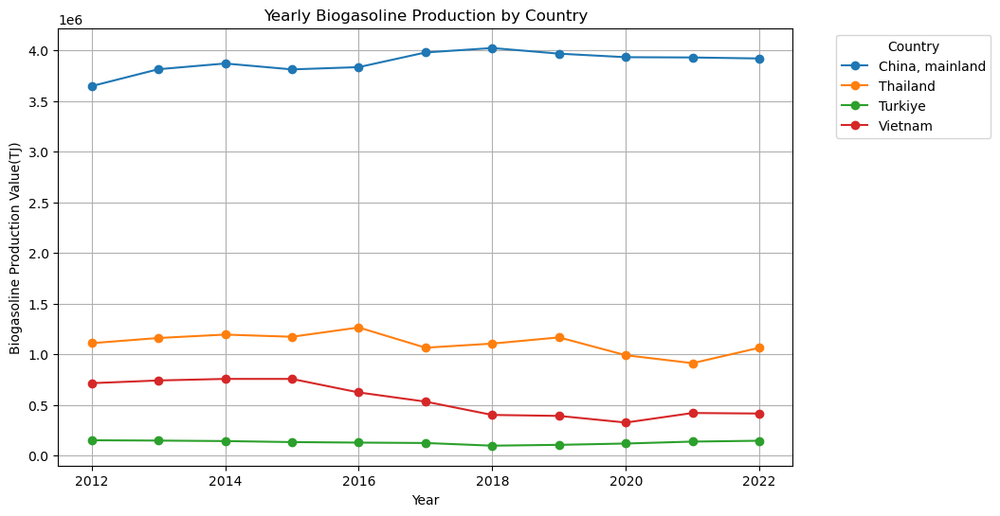

In [636]:
biogasoline_areas = ['China, mainland', 'Thailand', 'Phillipines', 'Turkiye', 'Vietnam']

df_biogasoline_area = df_production[df_production['Area'].isin(biogasoline_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_biogasoline_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Biogasoline Production Value(TJ)')
plt.title('Yearly Biogasoline Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Biogasoline Production by Country.png', bbox_inches='tight')
plt.show()

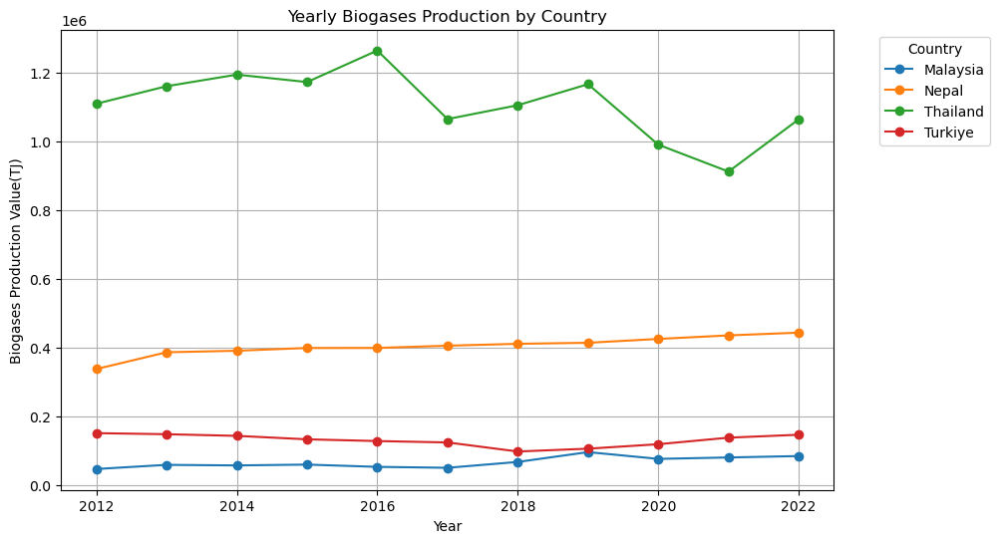

In [637]:
biogases_areas = ['Thailand', 'Turkiye', 'Nepal', 'Republic of Korea', 'Malaysia']

df_biogases_area = df_production[df_production['Area'].isin(biogases_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_biogases_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Biogases Production Value(TJ)')
plt.title('Yearly Biogases Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Biogases Production by Country.png', bbox_inches='tight')
plt.show()

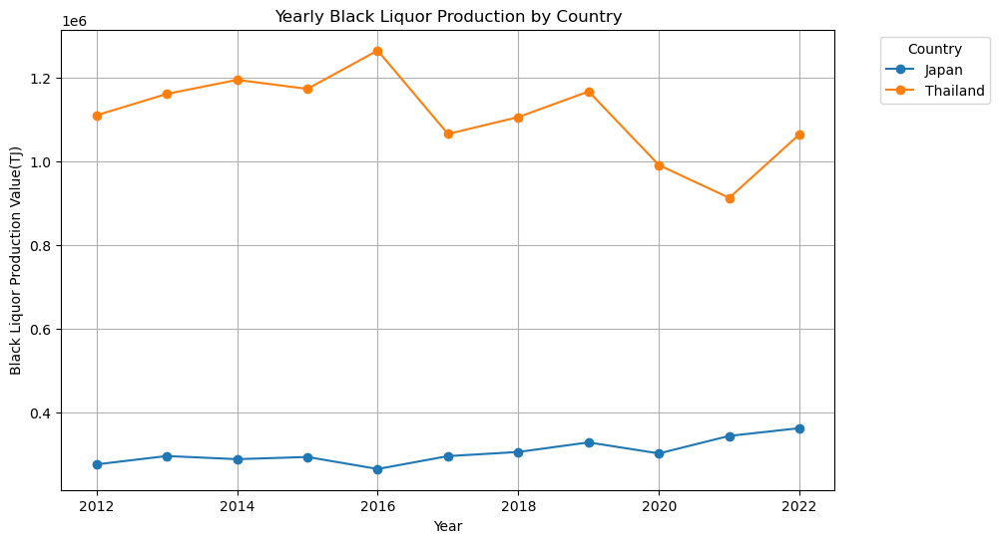

In [638]:
black_liquor_areas = ['Japan', 'Thailand', 'Republic of Korea']

df_black_liquor_area = df_production[df_production['Area'].isin(black_liquor_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_black_liquor_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Black Liquor Production Value(TJ)')
plt.title('Yearly Black Liquor Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Black Liquor Production by Country.png', bbox_inches='tight')
plt.show()

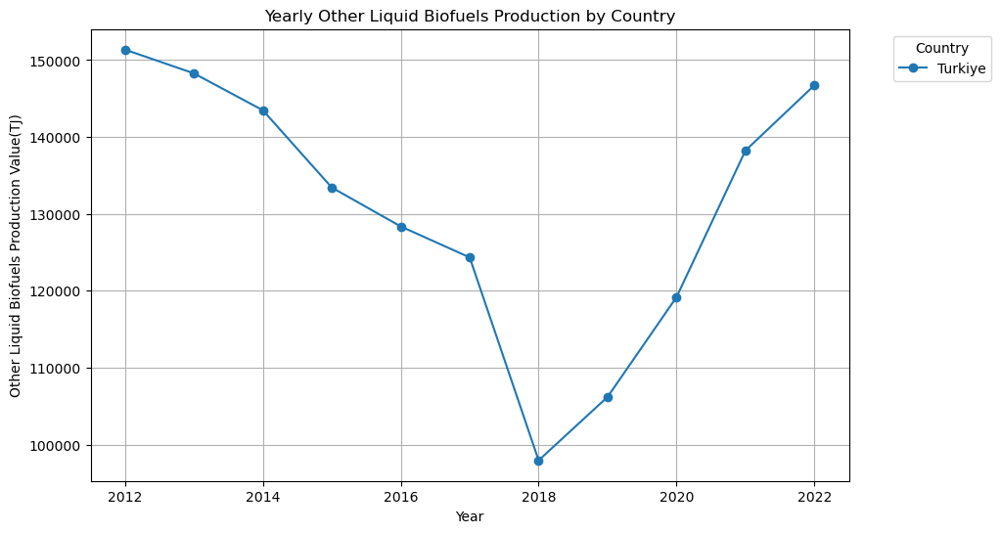

In [639]:
other_liquid_biofuels_areas = ['Republic of Korea', 'Turkiye']

df_other_liquid_biofuels_area = df_production[df_production['Area'].isin(other_liquid_biofuels_areas)].pivot_table(values='Value', index='Year', columns='Area', aggfunc='sum')

df_other_liquid_biofuels_area.plot(figsize=(10, 6), marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Other Liquid Biofuels Production Value(TJ)')
plt.title('Yearly Other Liquid Biofuels Production by Country')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.savefig('static/Top Item Producing Country/Yearly Other Liquid Biofuels Production by Country.png', bbox_inches='tight')
plt.show()

In [640]:
df_consumption.head(2)

,Area,Element,Item,Year,Value,Log Value
0,Afghanistan,Energy consumption,Charcoal,2012,3510,8.163656
1,Afghanistan,Energy consumption,Charcoal,2013,3611,8.192017


In [641]:
df_yearly_pivot = df.pivot_table(values='Value', index='Year', columns='Element', aggfunc='sum', fill_value=0)
df_yearly_pivot

Element,Energy consumption,Energy production
Year,,
2012,15592938,17480894
2013,15987892,17989676
2014,16178171,18271555
2015,15988873,18128677
2016,15698427,18369117
2017,15842865,18577728
2018,15938852,18682614
2019,16063913,18955060
2020,15753132,18498005


In [642]:
df_yearly_pivot.index

Index([2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022], dtype='int64', name='Year')

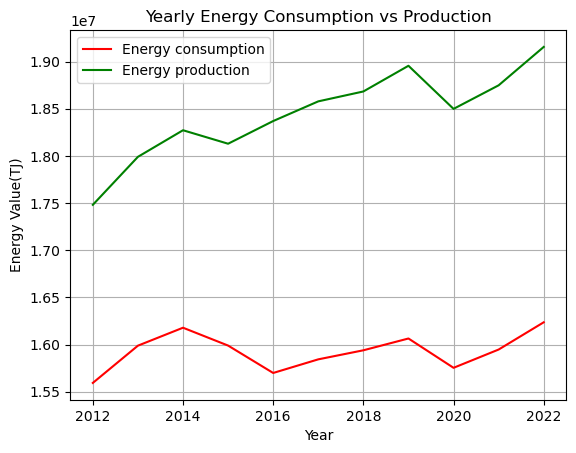

In [643]:
plt.plot(df_yearly_pivot.index, df_yearly_pivot['Energy consumption'], label='Energy Consumption', color='red')
plt.plot(df_yearly_pivot.index, df_yearly_pivot['Energy production'], label='Energy Production', color='green')
plt.xlabel('Year')
plt.ylabel('Energy Value(TJ)')
plt.title('Yearly Energy Consumption vs Production')
plt.legend(df_yearly_pivot.columns)
plt.grid()
plt.show()

In [644]:
for i in df['Item'].unique():
    print(i)

Charcoal
Fuelwood
Animal waste
Other vegetal material and residues
Bagasse
Biodiesel
Biogasoline
Biogases
Black liquor
Other liquid biofuels


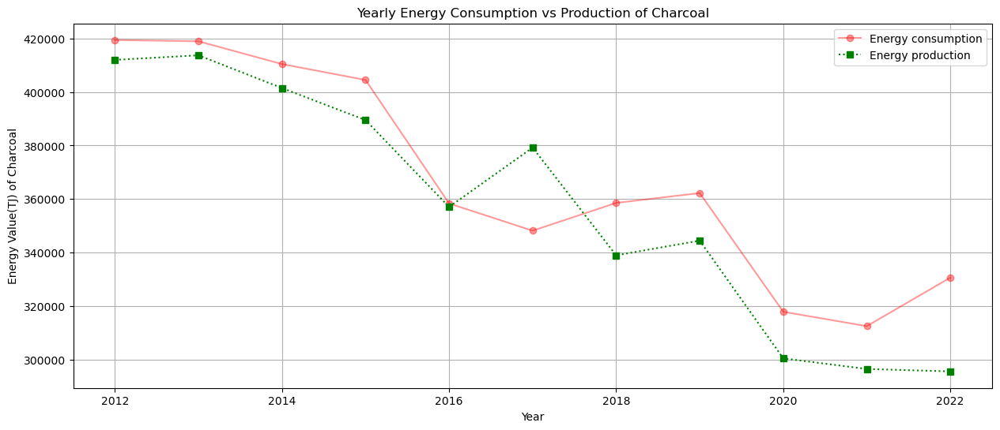

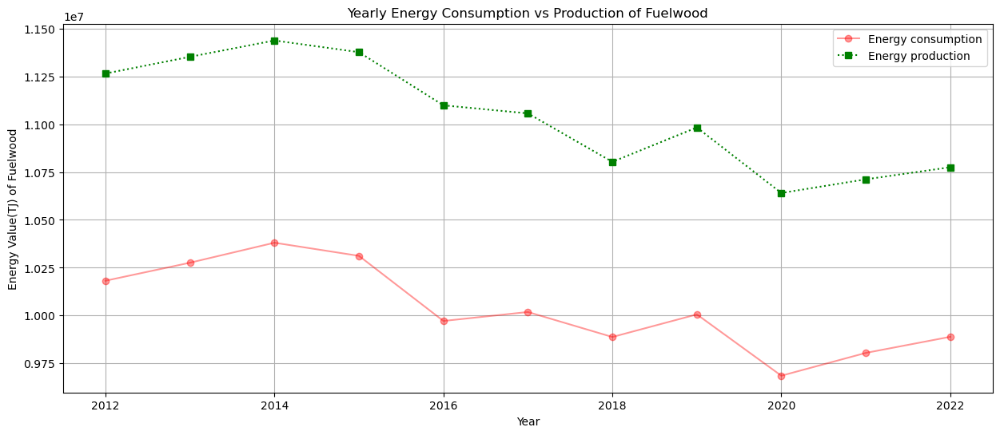

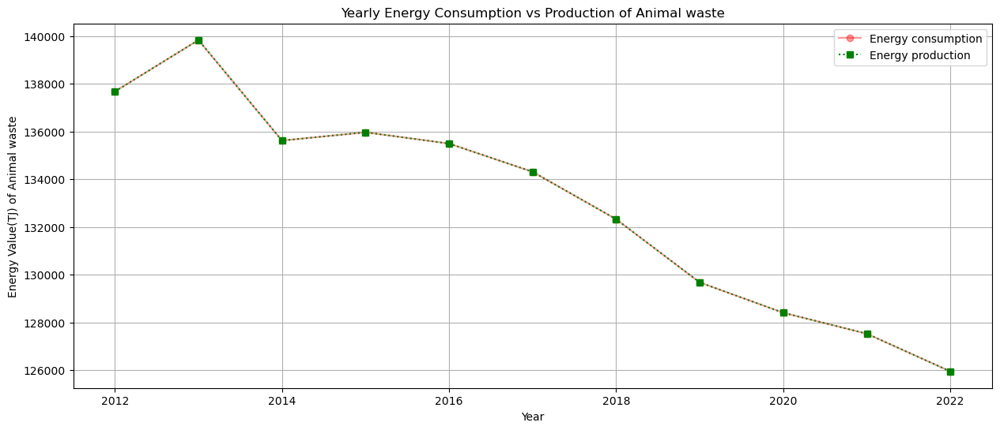

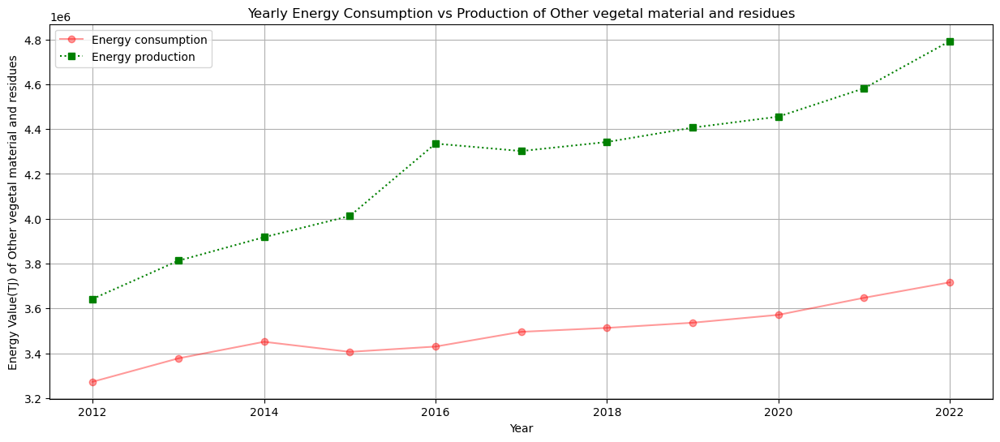

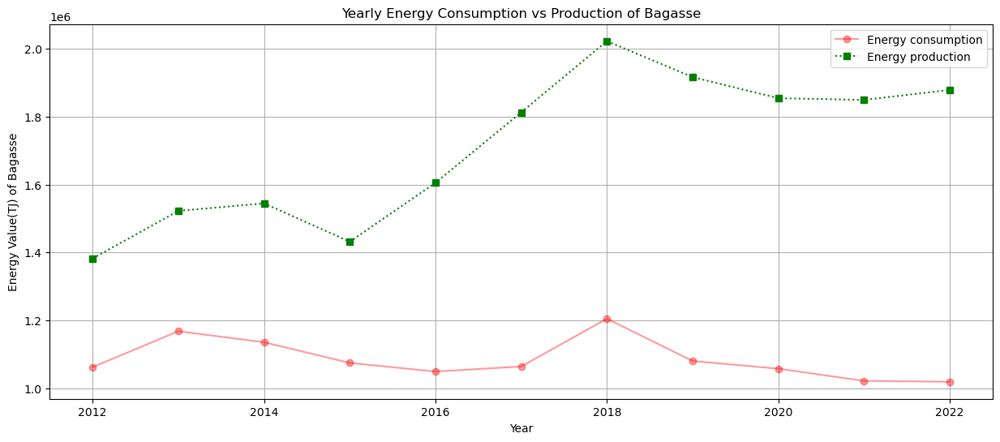

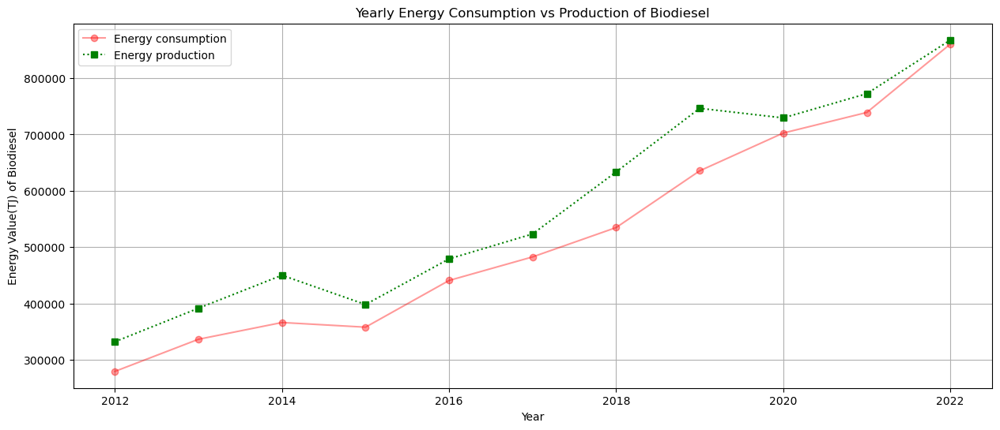

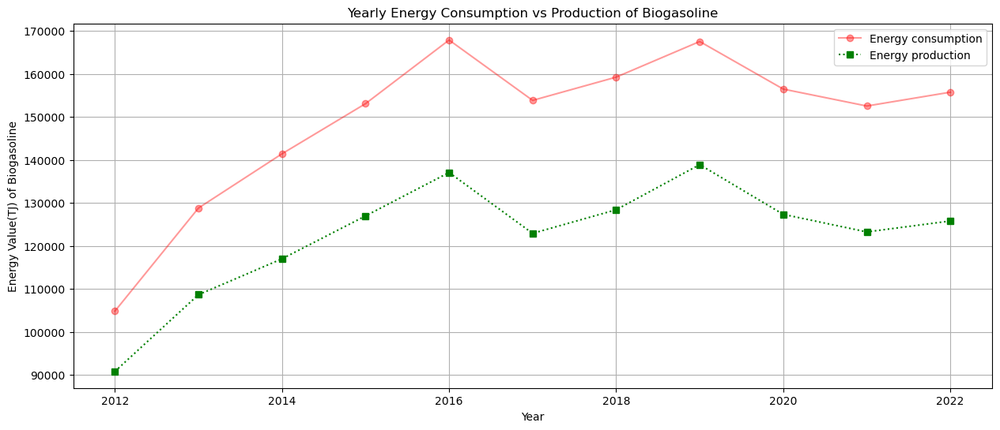

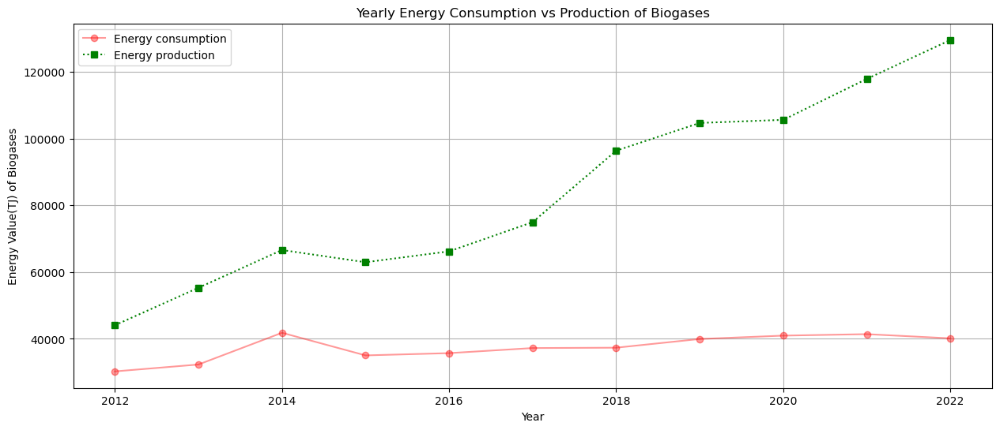

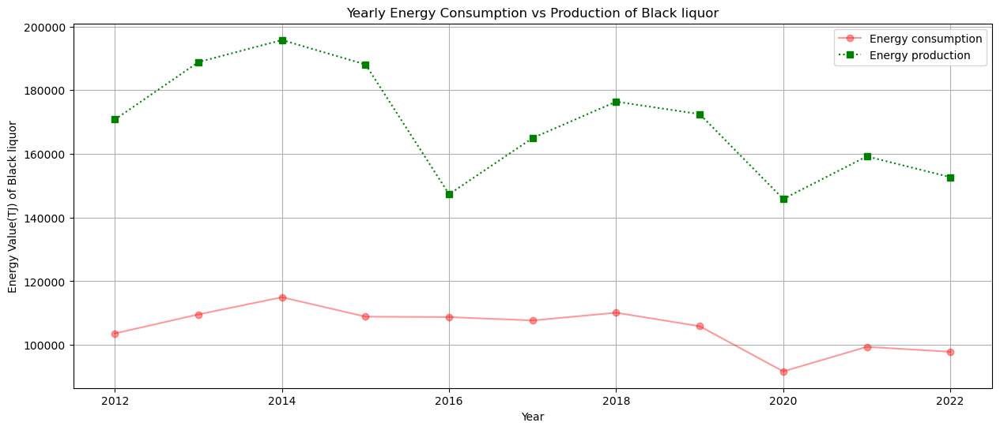

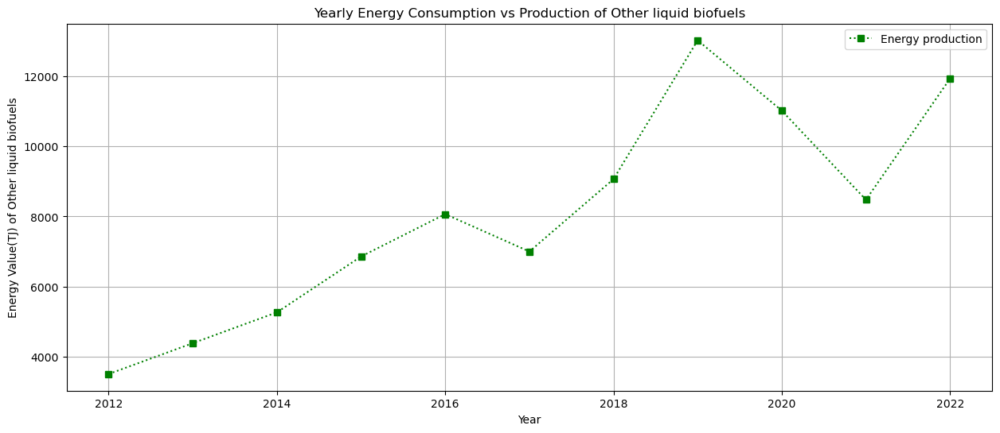

In [645]:
for i in df['Item'].unique():
    df_yearly_pivot = df[df['Item']==i].pivot_table(values='Value', index='Year', columns='Element', aggfunc='sum', fill_value=0)
    # df_yearly_pivot.columns = df_yearly_pivot.columns.str.lower()
    plt.figure(figsize=(15, 6))
    if 'Energy consumption' in df_yearly_pivot.columns:
        plt.plot(df_yearly_pivot.index, df_yearly_pivot['Energy consumption'], label='Energy Consumption', color='red', marker='o', alpha=0.4)
    if 'Energy production' in df_yearly_pivot.columns:
        plt.plot(df_yearly_pivot.index, df_yearly_pivot['Energy production'], label='Energy Production', color='green',ls='dotted', marker='s')
    plt.xlabel('Year')
    plt.ylabel(f'Energy Value(TJ) of {i}')
    plt.title(f'Yearly Energy Consumption vs Production of {i}')
    plt.legend(df_yearly_pivot.columns)
    plt.grid()
    plt.savefig(f'static/Consumption vs Production of Items/Yearly Energy Consumption vs Production of {i}.png', bbox_inches='tight')
    plt.show()